In [1]:
# importとconstの設定
import numpy as np
import numpy.linalg as LA
import matplotlib.pyplot as plt #to draw graphs

# const
ele_size = 1/2*0.02*0.02
poi = 0.2
e = 9800000000
th = 0.98
row = 2400
nmode = 10
delta_t = 0.0000004
total_time = 0.1
total_step = int(total_time/delta_t)
hc = 0.02 #減衰定数
load = 100*9.8 #外力最大値
load_time = 0.0001
load_step = int(load_time/delta_t)
load_diff = load/load_step
fixed_node_count = 50
alpha = 0.58332

In [2]:
# ファイル読み込み:nodeとeleの設定
node_path = "./one_hole_1_1.1.node"
ele_path = "./one_hole_1_1.1.ele"
# node_path = "~/src/github.com/shirafuji/graduation_thesis/vibration_simulation/one_hole_1_1.1.node"
# ele_path = '~/src/github.com/shirafuji/graduation_thesis/vibration_simulation/one_hole_1_1.1.ele'
with open(node_path) as f_node:
    s_line = f_node.readline()
    number_list = s_line.split()
    nnode_str = number_list[0]
    nnode = int(nnode_str)
    position = np.zeros((nnode, 2), dtype=np.float)
    for i in range(nnode):
        s_line = f_node.readline()
        number_list = s_line.split()
        x_str = number_list[1]
        y_str = number_list[2]
        x = float(x_str)
        y = float(y_str)
        position[i][0] = x*0.02
        position[i][1] = y*0.02
with open(ele_path) as f_ele:
    s_line = f_ele.readline()
    number_list = s_line.split()
    nele_str = number_list[0]
    nele = int(nele_str)
    eles = np.zeros((nele, 3), dtype=np.int64)
    for h in range(nele):
        s_line = f_ele.readline()
        number_list = s_line.split()
        i_str = number_list[1]
        j_str = number_list[2]
        k_str = number_list[3]
        i = int(i_str)
        j = int(j_str)
        k = k_str
        eles[h][0] = i
        eles[h][1] = j
        eles[h][2] = k

In [3]:
print(position)

[[0.   0.  ]
 [0.02 0.  ]
 [0.04 0.  ]
 ...
 [0.94 0.98]
 [0.96 0.98]
 [0.98 0.98]]


In [4]:
# 全体剛性行列と全体質量行列・全体集中質量行列の宣言(固定したものを抜いたものも)
kt = np.zeros((2*nnode, 2*nnode))
mt = np.zeros((2*nnode, 2*nnode))
imt = np.zeros((2*nnode, 2*nnode))
unfixed_kt = np.zeros((2*(nnode-fixed_node_count), 2*(nnode-fixed_node_count)))
unfixed_mt = np.zeros((2*(nnode-fixed_node_count), 2*(nnode-fixed_node_count)))
unfixed_imt = np.zeros((2*(nnode-fixed_node_count), 2*(nnode-fixed_node_count)))

In [5]:
# 剛性行列と質量行列計算の定義
def calc_ke(ele, position, kt):
    i = ele[0]
    j = ele[1]
    k = ele[2]
    xi = position[i-1][0]
    yi = position[i-1][1]
    xj = position[j-1][0]
    yj = position[j-1][1]
    xk = position[k-1][0]
    yk = position[k-1][1]
    # ひずみ-変位関係
    b = np.zeros((3, 6))
    b[0][0] = yj-yk
    b[0][2] = yk-yi
    b[0][4] = yi-yj
    b[1][1] = xk-xj
    b[1][3] = xi-xk
    b[1][5] = xj-xi
    b[2][0] = xk-xj
    b[2][1] = yj-yk
    b[2][2] = xi-xk
    b[2][3] = yk-yi
    b[2][4] = xj-xi
    b[2][5] = yi-yj
    # 応力-ひずみ関係
    d = np.zeros((3, 3))
    d[0][0] = 1
    d[0][1] = poi
    d[1][0] = poi
    d[1][1] = 1
    d[2][2] = (1-poi)/2
    d = d*e/(1+poi)/(1-poi)
    ke = th*ele_size*np.dot(np.dot(b.T, d), b)
    # 全体剛性行列への組み込み
    kt[2*i-1-1][2*i-1-1] += ke[1-1][1-1]
    kt[2*i-1-1][2*i-1] += ke[1-1][2-1]
    kt[2*i-1][2*i-1-1] += ke[2-1][1-1]
    kt[2*i-1][2*i-1] += ke[2-1][2-1]
    kt[2*i-1-1][2*j-1-1] += ke[1-1][3-1]
    kt[2*i-1-1][2*j-1] += ke[1-1][4-1]
    kt[2*i-1][2*j-1-1] += ke[2-1][3-1]
    kt[2*i-1][2*j-1] += ke[2-1][4-1]
    kt[2*i-1-1][2*k-1-1] += ke[1-1][5-1]
    kt[2*i-1-1][2*k-1] += ke[1-1][6-1]
    kt[2*i-1][2*k-1-1] += ke[2-1][5-1]
    kt[2*i-1][2*k-1] += ke[2-1][6-1]

    kt[2*j-1-1][2*i-1-1] += ke[3-1][1-1]
    kt[2*j-1-1][2*i-1] += ke[3-1][2-1]
    kt[2*j-1][2*i-1-1] += ke[4-1][1-1]
    kt[2*j-1][2*i-1] += ke[4-1][2-1]
    kt[2*j-1-1][2*j-1-1] += ke[3-1][3-1]
    kt[2*j-1-1][2*j-1] += ke[3-1][4-1]
    kt[2*j-1][2*j-1-1] += ke[4-1][3-1]
    kt[2*j-1][2*j-1] += ke[4-1][4-1]
    kt[2*j-1-1][2*k-1-1] += ke[3-1][5-1]
    kt[2*j-1-1][2*k-1] += ke[3-1][6-1]
    kt[2*j-1][2*k-1-1] += ke[4-1][5-1]
    kt[2*j-1][2*k-1] += ke[4-1][6-1]

    kt[2*k-1-1][2*i-1-1] += ke[5-1][1-1]
    kt[2*k-1-1][2*i-1] += ke[5-1][2-1]
    kt[2*k-1][2*i-1-1] += ke[6-1][1-1]
    kt[2*k-1][2*i-1] += ke[6-1][2-1]
    kt[2*k-1-1][2*j-1-1] += ke[5-1][3-1]
    kt[2*k-1-1][2*j-1] += ke[5-1][4-1]
    kt[2*k-1][2*j-1-1] += ke[6-1][3-1]
    kt[2*k-1][2*j-1] += ke[6-1][4-1]
    kt[2*k-1-1][2*k-1-1] += ke[5-1][5-1]
    kt[2*k-1-1][2*k-1] += ke[5-1][6-1]
    kt[2*k-1][2*k-1-1] += ke[6-1][5-1]
    kt[2*k-1][2*k-1] += ke[6-1][6-1]

    return kt

def calc_me(ele, mt):
    i = ele[0]
    j = ele[1]
    k = ele[2]
    me = np.zeros((6, 6))
    me[0][0] = 1/6
    me[0][2] = 1/12
    me[0][4] = 1/12
    me[1][1] = 1/6
    me[1][3] = 1/12
    me[1][5] = 1/12
    me[2][0] = 1/12
    me[2][2] = 1/6
    me[2][4] = 1/12
    me[3][1] = 1/12
    me[3][3] = 1/6
    me[3][5] = 1/12
    me[4][0] = 1/12
    me[4][2] = 1/12
    me[4][4] = 1/6
    me[5][1] = 1/12
    me[5][3] = 1/12
    me[5][5] = 1/6
    me = ele_size*th*row*me
    # 全体質量行列への組み込み
    mt[2*i-1-1][2*i-1-1] += me[1-1][1-1]
    mt[2*i-1-1][2*i-1] += me[1-1][2-1]
    mt[2*i-1][2*i-1-1] += me[2-1][1-1]
    mt[2*i-1][2*i-1] += me[2-1][2-1]
    mt[2*i-1-1][2*j-1-1] += me[1-1][3-1]
    mt[2*i-1-1][2*j-1] += me[1-1][4-1]
    mt[2*i-1][2*j-1-1] += me[2-1][3-1]
    mt[2*i-1][2*j-1] += me[2-1][4-1]
    mt[2*i-1-1][2*k-1-1] += me[1-1][5-1]
    mt[2*i-1-1][2*k-1] += me[1-1][6-1]
    mt[2*i-1][2*k-1-1] += me[2-1][5-1]
    mt[2*i-1][2*k-1] += me[2-1][6-1]

    mt[2*j-1-1][2*i-1-1] += me[3-1][1-1]
    mt[2*j-1-1][2*i-1] += me[3-1][2-1]
    mt[2*j-1][2*i-1-1] += me[4-1][1-1]
    mt[2*j-1][2*i-1] += me[4-1][2-1]
    mt[2*j-1-1][2*j-1-1] += me[3-1][3-1]
    mt[2*j-1-1][2*j-1] += me[3-1][4-1]
    mt[2*j-1][2*j-1-1] += me[4-1][3-1]
    mt[2*j-1][2*j-1] += me[4-1][4-1]
    mt[2*j-1-1][2*k-1-1] += me[3-1][5-1]
    mt[2*j-1-1][2*k-1] += me[3-1][6-1]
    mt[2*j-1][2*k-1-1] += me[4-1][5-1]
    mt[2*j-1][2*k-1] += me[4-1][6-1]

    mt[2*k-1-1][2*i-1-1] += me[5-1][1-1]
    mt[2*k-1-1][2*i-1] += me[5-1][2-1]
    mt[2*k-1][2*i-1-1] += me[6-1][1-1]
    mt[2*k-1][2*i-1] += me[6-1][2-1]
    mt[2*k-1-1][2*j-1-1] += me[5-1][3-1]
    mt[2*k-1-1][2*j-1] += me[5-1][4-1]
    mt[2*k-1][2*j-1-1] += me[6-1][3-1]
    mt[2*k-1][2*j-1] += me[6-1][4-1]
    mt[2*k-1-1][2*k-1-1] += me[5-1][5-1]
    mt[2*k-1-1][2*k-1] += me[5-1][6-1]
    mt[2*k-1][2*k-1-1] += me[6-1][5-1]
    mt[2*k-1][2*k-1] += me[6-1][6-1]

    return mt

def calc_ime(ele, imt):
    i = ele[0]
    j = ele[1]
    k = ele[2]
    ime = np.zeros((6, 6))
    for h in range(6):
        ime[h][h] = 1/3
    ime = ele_size*th*row*ime
    imt[2*i-1-1][2*i-1-1] += ime[1-1][1-1]
    imt[2*i-1][2*i-1] += ime[2-1][2-1]
    imt[2*j-1-1][2*j-1-1] += ime[3-1][3-1]
    imt[2*j-1][2*j-1] += ime[4-1][4-1]
    imt[2*k-1-1][2*k-1-1] += ime[5-1][5-1]
    imt[2*k-1][2*k-1] += ime[6-1][6-1]
    return imt

In [6]:
# 合成行列と質量行列の組み込み繰り返し
for h in range(nele):
    ele = eles[h]
    kt = calc_ke(ele, position, kt)
    mt = calc_me(ele, mt)
    imt = calc_ime(ele, imt)

In [7]:
for h in range(2*(nnode-fixed_node_count)):
    for hh in range(2*(nnode-fixed_node_count)):
        unfixed_kt[h][hh] = kt[h+2*fixed_node_count][hh+2*fixed_node_count]
        unfixed_mt[h][hh] = mt[h+2*fixed_node_count][hh+2*fixed_node_count]
        unfixed_imt[h][hh] = imt[h+2*fixed_node_count][hh+2*fixed_node_count]

In [8]:
print(unfixed_kt[0])

[ 2240.93333333   480.2        -1600.66666667 ...     0.
     0.             0.        ]


In [9]:
# サブスペース法定義
import time
def subspace(k,m,n,neig):
    start = time.time()
    loop_count = 0
    ramda = np.zeros((neig,1), dtype=complex) #初期固有値
    x = np.random.rand(n,neig) #初期固有ベクトル
    y = np.zeros((n, neig))
    k = np.matrix(k)
    k_inv = np.linalg.inv(k)
    for i in range(50):
        loop_count+=1
        ramold = ramda.copy()
        y = np.dot(np.dot(k_inv,m),x)
        kg = np.dot(np.dot(y.T, k), y)
        mg = np.dot(np.dot(y.T, m), y)
        mg_inv = np.linalg.inv(mg)
        w,v = LA.eig(np.dot(mg_inv, kg)) #w:固有値,v:固有ベクトル
        for i in range(neig):
            ramda[i][0] = w[i]
        p = v.T
        x = np.dot(y, p)
        for i in range(neig):
            max_val = 0
            for j in range(n):
                x_val = abs(x[j, i])
                if x_val > max_val:
                    max_val = x_val
            for j in range(n):
                x[j, i] = x[j, i]/max_val
        han = (ramda - ramold)/ramda
        print(han)
        max_mod = 0
        for i in range(neig):
            if abs(han[i][0]) > max_mod:
                max_mod = abs(han[i][0])
        print(max_mod)
        if max_mod < 0.001:
            break
    elapsed_time = time.time() - start
    print(elapsed_time)
    return ramda, x, loop_count

In [10]:
# subspace法実行

ramda, x, loop_count = subspace(unfixed_kt, unfixed_imt, 2*(nnode-fixed_node_count), nmode)

[[1.+0.j]
 [1.+0.j]
 [1.+0.j]
 [1.+0.j]
 [1.+0.j]
 [1.+0.j]
 [1.+0.j]
 [1.+0.j]
 [1.+0.j]
 [1.+0.j]]
1.0
[[-3.24899591+0.j]
 [-3.88271214+0.j]
 [-3.43957407+0.j]
 [-2.44751653+0.j]
 [-3.50343662+0.j]
 [-0.16141995+0.j]
 [-0.8408058 +0.j]
 [-0.79755242+0.j]
 [-2.52013685+0.j]
 [-4.56513187+0.j]]
4.565131867511523
[[-0.79987631+0.00000000e+00j]
 [ 0.80457716+3.04137307e+00j]
 [ 0.8258902 -2.70967743e+00j]
 [-0.27405722+0.00000000e+00j]
 [ 0.9920648 +1.97399423e-03j]
 [ 0.81516236-4.59810264e-02j]
 [-7.59771432+0.00000000e+00j]
 [-5.20170932+0.00000000e+00j]
 [-0.17206761+0.00000000e+00j]
 [-0.46726662+0.00000000e+00j]]
7.5977143166548595
[[ 0.89947566+0.25295246j]
 [ 1.26136435+0.1361395j ]
 [ 1.11989243-0.51211975j]
 [-0.02499425-0.21989897j]
 [ 4.21307462-2.48041384j]
 [-2.44052236+2.36520072j]
 [ 1.63903632+0.21109643j]
 [-0.41272845+1.6153361j ]
 [-3.10904821-2.12114746j]
 [-2.12128935-4.93269319j]]
5.36948140817578
[[-3.27079235+3.07939758j]
 [ 0.05494936+1.93622577j]
 [ 0.83255735+

[[ 0.71213712+0.7486613j ]
 [ 0.58380132+0.77395634j]
 [ 0.50508026+0.09196827j]
 [ 0.30434207+0.52278513j]
 [ 2.2379001 -0.27820862j]
 [ 1.58514011-0.30322136j]
 [-0.23421334+0.16541272j]
 [ 2.61260474-1.37003933j]
 [ 1.6111948 -1.81051753j]
 [ 2.22402346-1.55270044j]]
2.950035807474809
[[1.6404974 -1.11648539j]
 [0.01797168-1.33367633j]
 [1.12711345+0.45413847j]
 [1.11963848+0.68440765j]
 [0.32790898-0.0202462j ]
 [1.29471176+0.48439342j]
 [1.16666748-0.47932778j]
 [1.15019017-1.11817152j]
 [0.2966843 -0.34911106j]
 [0.77012643+1.05833155j]]
1.9843818558275244
[[0.77238374-0.47029774j]
 [1.17053353-0.38365107j]
 [0.24107983-1.0364384j ]
 [1.58022597+0.53434975j]
 [1.09346442+0.55322755j]
 [0.73013368+0.42346858j]
 [0.2322937 -0.65170667j]
 [1.17175155+0.25599619j]
 [1.37512279+0.18379108j]
 [0.85553895-0.04540663j]]
1.668125824295855
[[ 1.98148596-0.07239825j]
 [ 1.94387136+0.09461736j]
 [-1.28558634-0.04995308j]
 [ 2.41823532-0.86226747j]
 [-0.60500394-0.58377875j]
 [ 2.13601676+3.0

In [11]:
print(x)

[[-1.92336017e-03-0.01593428j  1.55890301e-02+0.00381874j
  -7.99289930e-03+0.01391813j ...  1.10350959e-03+0.01601196j
  -1.59172820e-02-0.00205932j -1.58230386e-02-0.00268926j]
 [-4.05841785e-03-0.03362239j  3.28938901e-02+0.0080578j
  -1.68655490e-02+0.02936817j ...  2.32847861e-03+0.0337863j
  -3.35865234e-02-0.0043453j  -3.33876635e-02-0.00567451j]
 [-1.50904996e-03-0.01250188j  1.22310036e-02+0.00299615j
  -6.27115219e-03+0.01092003j ...  8.65803047e-04+0.01256283j
  -1.24885469e-02-0.00161572j -1.24146044e-02-0.00210997j]
 ...
 [ 4.82838247e-02+0.40001248j -3.91345318e-01-0.0958653j
   2.00652875e-01-0.34939911j ... -2.77023847e-02-0.40196255j
   3.99585717e-01+0.05169688j  3.97219840e-01+0.06751083j]
 [-1.19802771e-01-0.9925188j   9.71013663e-01+0.23786285j
  -4.97863841e-01+0.86693591j ...  6.87356992e-02+0.99735734j
  -9.91459903e-01-0.12827132j -9.85589642e-01-0.16750919j]
 [ 5.05919561e-02+0.41913444j -4.10052958e-01-0.10044799j
   2.10244767e-01-0.36610158j ... -2.90266532

In [12]:
print(x[0])

[[-0.00192336-0.01593428j  0.01558903+0.00381874j -0.0079929 +0.01391813j
   0.01602965-0.0008068j  -0.00705357-0.01441693j  0.0024574 -0.0158607j
   0.01583044-0.00264532j  0.00110351+0.01601196j -0.01591728-0.00205932j
  -0.01582304-0.00268926j]]


In [13]:
print(x[-1])

[[ 0.05059196+0.41913444j -0.41005296-0.10044799j  0.21024477-0.36610158j
  -0.42164304+0.02122193j  0.18553682+0.37922199j -0.06463926+0.41719898j
  -0.41640307+0.06958237j -0.02902665-0.42117773j  0.41868728+0.05416817j
   0.4162083 +0.07073808j]]


In [14]:
print(ramda)

[[ 27.00633704+11.3901003j ]
 [-22.55383789 -2.93061869j]
 [  3.55613453-13.80411131j]
 [  1.14259873 +1.66311199j]
 [ -0.18397979 +1.26442542j]
 [  0.21760204 -1.52320673j]
 [  1.13975396 -0.05260193j]
 [ -0.82443419 -0.3548547j ]
 [ -0.15511676 +0.07081826j]
 [  0.2188149  -0.09248495j]]


In [15]:
# 正のラムダだけ利用する
positive_index = []
for h in range(len(ramda)):
    if ramda[h][0] > 0:
        positive_index.append(h)
positive_nmode = len(positive_index)
positive_ramda = np.zeros((positive_nmode, 1))
positive_x = np.zeros((2*(nnode-fixed_node_count), positive_nmode))
for h in range(positive_nmode):
    index = positive_index[h]
    positive_ramda[h][0] = ramda[index][0]
for h in range(2*(nnode-fixed_node_count)):
    for hh in range(positive_nmode):
        index = positive_index[hh]
        positive_x[h, hh] = x[h, nmode-index-1]

/opt/anaconda3/envs/graduation_thesis/lib/python3.7/site-packages/ipykernel_launcher.py:11: ComplexWarning: Casting complex values to real discards the imaginary part
  # This is added back by InteractiveShellApp.init_path()
/opt/anaconda3/envs/graduation_thesis/lib/python3.7/site-packages/ipykernel_launcher.py:15: ComplexWarning: Casting complex values to real discards the imaginary part
  from ipykernel import kernelapp as app


In [16]:
# 外力生成(線形の増減)(左辺中心4点に荷重がかかるとする)
ft = np.zeros((total_step, 2*(nnode-fixed_node_count), 1))
for i in range(load_step):
    ft[i+1][2300-100][0] = ft[i][2300-100][0] + load_diff
    ft[i+1][2400-100][0] = ft[i][2400-100][0] + load_diff
    ft[i+1][2500-100][0] = ft[i][2500-100][0] + load_diff
    ft[i+1][2600-100][0] = ft[i][2600-100][0] + load_diff
for i in range(load_step):
    ft[load_step+i+1][2300-100][0] = ft[load_step+i][2300-100][0] - load_diff
    ft[load_step+i+1][2400-100][0] = ft[load_step+i][2400-100][0] - load_diff
    ft[load_step+i+1][2500-100][0] = ft[load_step+i][2500-100][0] - load_diff
    ft[load_step+i+1][2600-100][0] = ft[load_step+i][2600-100][0] - load_diff

In [17]:
# デバッグ用変数コピー
s_kt = unfixed_kt.copy()
s_imt = unfixed_imt.copy()
s_ft = ft.copy()
s_positive_ramda = positive_ramda.copy()
s_positive_x = positive_x.copy()

In [18]:
s_q = np.zeros((positive_nmode, total_step+1, 2)) #一般化変位設定
s_omega = np.zeros((positive_nmode, 1), dtype=complex)
s_omega = np.sqrt(s_positive_ramda)
# xの並び順が逆になるバグがあるため並び替えるが後で直す
s_phi = s_positive_x#np.zeros((2*nnode, nmode))
# for i in range(2*nnode):
#     for j in range(nmode):
#         s_phi[i, j] = s_x[i, nmode-j-1]
s_kt_a = np.dot(np.dot(s_phi.T, s_kt), s_phi)
s_mt_a = np.dot(np.dot(s_phi.T, s_imt), s_phi)

In [19]:
for h in range(100):
    print(s_imt[h][h])
    print(s_kt[h][h])

0.4704
2240.9333333333334
0.4704
2240.9333333333334
0.784
3361.4
0.784
3361.4
0.6272
3361.4
0.6272
3361.3999999999996
0.9408000000000001
4481.866666666668
0.9408000000000001
4481.866666666667
0.9408000000000001
4481.866666666667
0.9408000000000001
4481.866666666669
0.784
4481.866666666667
0.784
4481.866666666666
1.0976000000000001
4481.866666666667
1.0976000000000001
4481.866666666668
0.9408000000000001
4481.866666666668
0.9408000000000001
4481.866666666668
0.9408000000000001
4481.866666666666
0.9408000000000001
4481.866666666663
0.9408000000000001
4481.866666666669
0.9408000000000001
4481.866666666668
0.9408000000000001
4481.866666666668
0.9408000000000001
4481.866666666668
0.9408000000000001
4481.866666666666
0.9408000000000001
4481.866666666663
0.9408000000000001
4481.866666666669
0.9408000000000001
4481.866666666668
0.9408000000000001
4481.8666666666695
0.9408000000000001
4481.866666666672
0.9408000000000001
4481.866666666666
0.9408000000000001
4481.866666666663
0.9408000000000001


In [20]:
print(s_kt_a.shape)
print(s_mt_a.shape)
print(s_phi)
for h in range(positive_nmode):
    print(s_mt_a[h][h])
    print(s_kt_a[h][h])

(6, 6)
(6, 6)
[[-1.58230386e-02  1.10350959e-03  1.58304432e-02 -7.05357440e-03
   1.60296517e-02 -1.92336017e-03]
 [-3.33876635e-02  2.32847861e-03  3.34032877e-02 -1.48835110e-02
   3.38236310e-02 -4.05841785e-03]
 [-1.24146044e-02  8.65803047e-04  1.24204140e-02 -5.53416687e-03
   1.25767111e-02 -1.50904996e-03]
 ...
 [ 3.97219840e-01 -2.77023847e-02 -3.97405725e-01  1.77072165e-01
  -4.02406635e-01  4.82838247e-02]
 [-9.85589642e-01  6.87356992e-02  9.86050864e-01 -4.39354921e-01
   9.98459218e-01 -1.19802771e-01]
 [ 4.16208302e-01 -2.90266532e-02 -4.16403074e-01  1.85536818e-01
  -4.21643043e-01  5.05919561e-02]]
765.6571603623028
231.5625822449857
3.7239753497830623
1.12626563539796
766.3739306355242
231.7793596539019
152.15039278963425
46.01581447665756
785.7832173695886
237.64943413155967
11.312948586388305
3.4214472522259562


In [21]:
# 各モードについて、タイムステップ毎のfiを求める
s_fit = np.zeros((positive_nmode, total_step, 1))
for i in range(positive_nmode):
    s_fi = np.zeros((total_step, 1))
    for j in range(total_step):
        s_fi[j][0] = np.dot(s_phi.T[i], s_ft[j])
    s_fit[i] = s_fi

In [ ]:
# 各行の処理
for i in range(positive_nmode):
    # i行目について
    s_omegai = s_omega[i][0]
    s_ki = s_kt_a[i][i]
    s_mi = s_mt_a[i][i]
    s_ci = s_mi * alpha
#     s_ci = 2*s_mi*hc*s_omegai
    s_fi = s_fit[i]
    s_qi = np.zeros((total_step+1, 2))
    # 振動方程式を解くloop
    for j in range(total_step):
        s_p_x = s_qi[j][0]
        s_p_v = s_qi[j][1]
        print((s_ci/s_mi)*s_p_v)
        print((s_ki/s_mi)*s_p_x)
        print(s_fi[j][0]/s_mi)
        dvdt = -(s_ci/s_mi)*s_p_v - (s_ki/s_mi)*s_p_x + s_fi[j][0]/s_mi
        s_qi[j+1][1] = s_p_v+dvdt*delta_t
        s_qi[j+1][0] = s_p_x+s_p_v*delta_t
    for j in range(total_step+1):
        s_q[i][j][0] = s_qi[j][0]
        s_q[i][j][1] = s_qi[j][1]

0.0
0.0
0.0
0.0
0.0
-0.009715143389702774
-2.2668149768325685e-09
0.0
-0.01943028677940555
-6.800444401586302e-09
-4.701140524326277e-16
-0.029145430169108325
-1.3600887745349808e-08
-1.8804561000397394e-15
-0.0388605735588111
-2.266814447921171e-08
-4.7011399758724215e-15
-0.04857571694851387
-3.400221407426064e-08
-9.402279403290996e-15
-0.05829086033821665
-4.760309600158526e-08
-1.645398799596502e-14
-0.06800600372791943
-6.347078973227423e-08
-2.6326379257873293e-14
-0.07772114711762221
-8.160529473741619e-08
-3.948956658330386e-14
-0.08743629050732497
-1.020066104880999e-07
-5.6413663256854e-14
-0.09715143389702775
-1.24674736455414e-07
-7.756878245343025e-14
-0.10686657728673055
-1.4960967211044725e-07
-1.034250372382484e-13
-0.11658172067643333
-1.768114169242884e-07
-1.3445254056683346e-13
-0.12629686406613608
-2.0627997036802614e-07
-1.7112140528501976e-13
-0.13601200745583886
-2.3801533191274922e-07
-2.1390174412895086e-13
-0.14572715084554164
-2.720175010295465e-07
-2.63263

0.0
-0.00014166744044527183
-7.550945737646952e-09
0.0
-0.00014166740738852943
-7.580326104022748e-09
0.0
-0.0001416673743317879
-7.609706463542919e-09
0.0
-0.00014166734127504723
-7.63908681620746e-09
0.0
-0.0001416673082183074
-7.668467162016375e-09
0.0
-0.00014166727516156844
-7.697847500969664e-09
0.0
-0.00014166724210483035
-7.727227833067324e-09
0.0
-0.0001416672090480931
-7.75660815830936e-09
0.0
-0.0001416671759913567
-7.785988476695768e-09
0.0
-0.0001416671429346212
-7.81536878822655e-09
0.0
-0.00014166710987788652
-7.844749092901706e-09
0.0
-0.0001416670768211527
-7.874129390721235e-09
0.0
-0.00014166704376441974
-7.90350968168514e-09
0.0
-0.00014166701070768766
-7.932889965793418e-09
0.0
-0.0001416669776509564
-7.962270243046073e-09
0.0
-0.00014166694459422603
-7.991650513443102e-09
0.0
-0.0001416669115374965
-8.021030776984505e-09
0.0
-0.00014166687848076785
-8.050411033670282e-09
0.0
-0.00014166684542404003
-8.079791283500435e-09
0.0
-0.00014166681236731308
-8.109171526474

-0.00014165643259748164
-1.7334228776494748e-08
0.0
-0.00014165639954102498
-1.736360685995642e-08
0.0
-0.00014165636648456916
-1.739298493656252e-08
0.0
-0.00014165633342811423
-1.7422363006313054e-08
0.0
-0.00014165630037166012
-1.745174106920802e-08
0.0
-0.0001416562673152069
-1.748111912524742e-08
0.0
-0.00014165623425875453
-1.751049717443125e-08
0.0
-0.00014165620120230301
-1.7539875216759516e-08
0.0
-0.00014165616814585234
-1.7569253252232212e-08
0.0
-0.00014165613508940254
-1.759863128084934e-08
0.0
-0.0001416561020329536
-1.7628009302610905e-08
0.0
-0.00014165606897650554
-1.76573873175169e-08
0.0
-0.0001416560359200583
-1.768676532556733e-08
0.0
-0.00014165600286361195
-1.771614332676219e-08
0.0
-0.00014165596980716643
-1.7745521321101487e-08
0.0
-0.00014165593675072178
-1.777489930858522e-08
0.0
-0.000141655903694278
-1.7804277289213382e-08
0.0
-0.00014165587063783505
-1.783365526298598e-08
0.0
-0.000141655837581393
-1.7863033229903016e-08
0.0
-0.00014165580452495176
-1.7892

0.0
-0.00014163990447624655
-3.202241527887643e-08
0.0
-0.00014163987142021918
-3.205178993457618e-08
0.0
-0.00014163983836419267
-3.208116458342045e-08
0.0
-0.00014163980530816704
-3.211053922540925e-08
0.0
-0.00014163977225214227
-3.2139913860542564e-08
0.0
-0.00014163973919611834
-3.21692884888204e-08
0.0
-0.00014163970614009528
-3.219866311024276e-08
0.0
-0.00014163967308407306
-3.222803772480964e-08
0.0
-0.00014163964002805173
-3.2257412332521036e-08
0.0
-0.00014163960697203122
-3.228678693337696e-08
0.0
-0.0001416395739160116
-3.231616152737741e-08
0.0
-0.00014163954085999285
-3.2345536114522377e-08
0.0
-0.0001416395078039749
-3.237491069481187e-08
0.0
-0.00014163947474795787
-3.240428526824588e-08
0.0
-0.0001416394416919417
-3.243365983482442e-08
0.0
-0.00014163940863592636
-3.246303439454748e-08
0.0
-0.0001416393755799119
-3.249240894741506e-08
0.0
-0.00014163934252389826
-3.252178349342717e-08
0.0
-0.0001416393094678855
-3.25511580325838e-08
0.0
-0.0001416392764118736
-3.25805

0.0
-0.00014162337656975282
-4.670888791140907e-08
0.0
-0.00014162334351415515
-4.673825913939144e-08
0.0
-0.0001416233104585583
-4.676763036051841e-08
0.0
-0.00014162327740296232
-4.679700157479e-08
0.0
-0.0001416232443473672
-4.6826372782206205e-08
0.0
-0.00014162321129177293
-4.685574398276701e-08
0.0
-0.00014162317823617954
-4.688511517647243e-08
0.0
-0.000141623145180587
-4.691448636332246e-08
0.0
-0.0001416231121249953
-4.694385754331711e-08
0.0
-0.0001416230790694045
-4.697322871645636e-08
0.0
-0.00014162304601381454
-4.7002599882740225e-08
0.0
-0.00014162301295822543
-4.70319710421687e-08
0.0
-0.0001416229799026372
-4.706134219474179e-08
0.0
-0.00014162294684704981
-4.7090713340459486e-08
0.0
-0.00014162291379146328
-4.712008447932179e-08
0.0
-0.00014162288073587761
-4.714945561132872e-08
0.0
-0.00014162284768029281
-4.717882673648026e-08
0.0
-0.00014162281462470886
-4.7208197854776405e-08
0.0
-0.00014162278156912576
-4.7237568966217164e-08
0.0
-0.00014162274851354354
-4.726694

0.0
-0.00014160684887817537
-6.139364669636932e-08
0.0
-0.00014160681582300766
-6.142301449667887e-08
0.0
-0.00014160678276784085
-6.145238229013313e-08
0.0
-0.00014160674971267487
-6.148175007673208e-08
0.0
-0.00014160671665750977
-6.151111785647574e-08
0.0
-0.0001416066836023455
-6.15404856293641e-08
0.0
-0.0001416066505471821
-6.156985339539715e-08
0.0
-0.00014160661749201958
-6.15992211545749e-08
0.0
-0.00014160658443685792
-6.162858890689735e-08
0.0
-0.0001416065513816971
-6.165795665236451e-08
0.0
-0.00014160651832653717
-6.168732439097637e-08
0.0
-0.00014160648527137808
-6.171669212273292e-08
0.0
-0.00014160645221621983
-6.174605984763417e-08
0.0
-0.00014160641916106248
-6.177542756568014e-08
0.0
-0.00014160638610590597
-6.18047952768708e-08
0.0
-0.00014160635305075032
-6.183416298120616e-08
0.0
-0.00014160631999559555
-6.186353067868621e-08
0.0
-0.0001416062869404416
-6.189289836931098e-08
0.0
-0.00014160625388528854
-6.192226605308045e-08
0.0
-0.00014160622083013633
-6.1951633

-0.00014158483432708495
-8.095108363916629e-08
0.0
-0.00014158480127249057
-8.098044687388494e-08
0.0
-0.00014158476821789706
-8.100981010174841e-08
0.0
-0.00014158473516330438
-8.103917332275671e-08
0.0
-0.00014158470210871258
-8.106853653690981e-08
0.0
-0.00014158466905412167
-8.109789974420776e-08
0.0
-0.00014158463599953157
-8.11272629446505e-08
0.0
-0.00014158460294494236
-8.115662613823808e-08
0.0
-0.000141584569890354
-8.118598932497046e-08
0.0
-0.00014158453683576653
-8.121535250484767e-08
0.0
-0.0001415845037811799
-8.124471567786969e-08
0.0
-0.00014158447072659414
-8.127407884403655e-08
0.0
-0.00014158443767200922
-8.13034420033482e-08
0.0
-0.0001415844046174252
-8.13328051558047e-08
0.0
-0.000141584371562842
-8.1362168301406e-08
0.0
-0.0001415843385082597
-8.139153144015213e-08
0.0
-0.00014158430545367824
-8.142089457204309e-08
0.0
-0.00014158427239909763
-8.145025769707885e-08
0.0
-0.0001415842393445179
-8.147962081525944e-08
0.0
-0.00014158420628993903
-8.150898392658486e-

-1.0050547992476429e-07
0.0
-0.00014156278710400702
-1.0053483859397128e-07
0.0
-0.00014156275404998743
-1.0056419725632321e-07
0.0
-0.0001415627209959687
-1.0059355591182007e-07
0.0
-0.00014156268794195085
-1.0062291456046187e-07
0.0
-0.00014156265488793386
-1.006522732022486e-07
0.0
-0.00014156262183391774
-1.0068163183718029e-07
0.0
-0.00014156258877990246
-1.007109904652569e-07
0.0
-0.00014156255572588805
-1.0074034908647846e-07
0.0
-0.0001415625226718745
-1.0076970770084495e-07
0.0
-0.00014156248961786182
-1.0079906630835638e-07
0.0
-0.00014156245656385
-1.0082842490901275e-07
0.0
-0.00014156242350983904
-1.0085778350281407e-07
0.0
-0.00014156239045582894
-1.0088714208976031e-07
0.0
-0.00014156235740181973
-1.0091650066985151e-07
0.0
-0.00014156232434781133
-1.0094585924308764e-07
0.0
-0.00014156229129380383
-1.0097521780946871e-07
0.0
-0.00014156225823979717
-1.0100457636899472e-07
0.0
-0.0001415622251857914
-1.0103393492166566e-07
0.0
-0.00014156219213178644
-1.0106329346748155e

-0.00014154077331797045
-1.2008618970973357e-07
0.0
-0.00014154074026452544
-1.2011554380665324e-07
0.0
-0.00014154070721108126
-1.20144897896718e-07
0.0
-0.00014154067415763798
-1.2017425197992782e-07
0.0
-0.00014154064110419553
-1.2020360605628267e-07
0.0
-0.00014154060805075396
-1.202329601257826e-07
0.0
-0.00014154057499731325
-1.2026231418842758e-07
0.0
-0.00014154054194387338
-1.2029166824421761e-07
0.0
-0.0001415405088904344
-1.203210222931527e-07
0.0
-0.00014154047583699627
-1.2035037633523285e-07
0.0
-0.00014154044278355903
-1.2037973037045806e-07
0.0
-0.0001415404097301226
-1.2040908439882834e-07
0.0
-0.00014154037667668708
-1.2043843842034366e-07
0.0
-0.00014154034362325241
-1.2046779243500402e-07
0.0
-0.00014154031056981862
-1.2049714644280947e-07
0.0
-0.00014154027751638566
-1.2052650044375997e-07
0.0
-0.0001415402444629536
-1.205558544378555e-07
0.0
-0.00014154021140952238
-1.2058520842509614e-07
0.0
-0.00014154017835609202
-1.2061456240548182e-07
0.0
-0.00014154014530266

-1.3963450027402448e-07
0.0
-0.0001415187268619238
-1.3966384980559134e-07
0.0
-0.00014151869380905481
-1.3969319933030337e-07
0.0
-0.0001415186607561867
-1.3972254884816057e-07
0.0
-0.00014151862770331943
-1.3975189835916298e-07
0.0
-0.00014151859465045302
-1.3978124786331053e-07
0.0
-0.0001415185615975875
-1.398105973606033e-07
0.0
-0.00014151852854472284
-1.398399468510412e-07
0.0
-0.00014151849549185903
-1.398692963346243e-07
0.0
-0.0001415184624389961
-1.3989864581135257e-07
0.0
-0.00014151842938613403
-1.3992799528122602e-07
0.0
-0.0001415183963332728
-1.3995734474424464e-07
0.0
-0.00014151836328041246
-1.3998669420040847e-07
0.0
-0.00014151833022755297
-1.4001604364971744e-07
0.0
-0.00014151829717469434
-1.400453930921716e-07
0.0
-0.00014151826412183658
-1.4007474252777094e-07
0.0
-0.00014151823106897971
-1.4010409195651543e-07
0.0
-0.00014151819801612366
-1.4013344137840513e-07
0.0
-0.0001415181649632685
-1.4016279079344e-07
0.0
-0.00014151813191041421
-1.4019214020162004e-07
0

-0.00014149671384259567
-1.5920911530604682e-07
0.0
-0.00014149668079030248
-1.5923846026548563e-07
0.0
-0.00014149664773801014
-1.5926780521806975e-07
0.0
-0.00014149661468571868
-1.5929715016379914e-07
0.0
-0.0001414965816334281
-1.5932649510267384e-07
0.0
-0.00014149654858113835
-1.5935584003469385e-07
0.0
-0.0001414965155288495
-1.5938518495985914e-07
0.0
-0.00014149648247656149
-1.594145298781697e-07
0.0
-0.00014149644942427434
-1.594438747896256e-07
0.0
-0.0001414964163719881
-1.594732196942268e-07
0.0
-0.00014149638331970268
-1.5950256459197325e-07
0.0
-0.00014149635026741814
-1.5953190948286504e-07
0.0
-0.00014149631721513447
-1.595612543669021e-07
0.0
-0.00014149628416285166
-1.5959059924408447e-07
0.0
-0.0001414962511105697
-1.5961994411441213e-07
0.0
-0.00014149621805828862
-1.596492889778851e-07
0.0
-0.0001414961850060084
-1.5967863383450335e-07
0.0
-0.00014149615195372907
-1.5970797868426693e-07
0.0
-0.00014149611890145058
-1.5973732352717576e-07
0.0
-0.0001414960858491729

0.0
-0.00014147503172416915
-1.7845793604153257e-07
0.0
-0.0001414749986724437
-1.784872765043236e-07
0.0
-0.00014147496562071912
-1.7851661696026002e-07
0.0
-0.00014147493256899544
-1.7854595740934187e-07
0.0
-0.0001414748995172726
-1.7857529785156914e-07
0.0
-0.00014147486646555062
-1.7860463828694182e-07
0.0
-0.0001414748334138295
-1.786339787154599e-07
0.0
-0.00014147480036210926
-1.786633191371234e-07
0.0
-0.00014147476731038992
-1.786926595519323e-07
0.0
-0.00014147473425867138
-1.7872199995988661e-07
0.0
-0.00014147470120695374
-1.7875134036098638e-07
0.0
-0.00014147466815523697
-1.7878068075523154e-07
0.0
-0.00014147463510352106
-1.7881002114262208e-07
0.0
-0.00014147460205180603
-1.7883936152315808e-07
0.0
-0.00014147456900009186
-1.7886870189683948e-07
0.0
-0.00014147453594837853
-1.788980422636663e-07
0.0
-0.0001414745028966661
-1.7892738262363855e-07
0.0
-0.00014147446984495452
-1.7895672297675618e-07
0.0
-0.0001414744367932438
-1.7898606332301925e-07
0.0
-0.000141474403741

-1.9342068237777458e-07
0.0
-0.00014145814240533897
-1.934500193447495e-07
0.0
-0.00014145810935405623
-1.9347935630486992e-07
0.0
-0.00014145807630277433
-1.935086932581359e-07
0.0
-0.0001414580432514933
-1.9353803020454736e-07
0.0
-0.00014145801020021314
-1.9356736714410432e-07
0.0
-0.00014145797714893387
-1.9359670407680677e-07
0.0
-0.00014145794409765544
-1.9362604100265474e-07
0.0
-0.00014145791104637788
-1.9365537792164823e-07
0.0
-0.00014145787799510118
-1.936847148337872e-07
0.0
-0.00014145784494382535
-1.937140517390717e-07
0.0
-0.0001414578118925504
-1.937433886375017e-07
0.0
-0.00014145777884127633
-1.937727255290772e-07
0.0
-0.00014145774579000308
-1.938020624137982e-07
0.0
-0.00014145771273873072
-1.9383139929166473e-07
0.0
-0.00014145767968745923
-1.9386073616267674e-07
0.0
-0.0001414576466361886
-1.9389007302683427e-07
0.0
-0.00014145761358491885
-1.939194098841373e-07
0.0
-0.00014145758053364996
-1.9394874673458585e-07
0.0
-0.00014145754748238194
-1.939780835781799e-07


0.0
-0.0001414361304430077
-2.1298691690007898e-07
0.0
-0.00014143609739230244
-2.130162492951454e-07
0.0
-0.00014143606434159807
-2.1304558168335746e-07
0.0
-0.00014143603129089454
-2.1307491406471514e-07
0.0
-0.0001414359982401919
-2.1310424643921845e-07
0.0
-0.0001414359651894901
-2.1313357880686737e-07
0.0
-0.0001414359321387892
-2.1316291116766192e-07
0.0
-0.00014143589908808914
-2.1319224352160212e-07
0.0
-0.00014143586603738994
-2.1322157586868792e-07
0.0
-0.00014143583298669164
-2.1325090820891937e-07
0.0
-0.00014143579993599418
-2.1328024054229644e-07
0.0
-0.00014143576688529762
-2.1330957286881914e-07
0.0
-0.00014143573383460192
-2.1333890518848744e-07
0.0
-0.00014143570078390706
-2.1336823750130136e-07
0.0
-0.0001414356677332131
-2.133975698072609e-07
0.0
-0.00014143563468251998
-2.134269021063661e-07
0.0
-0.00014143560163182775
-2.1345623439861689e-07
0.0
-0.00014143556858113636
-2.1348556668401333e-07
0.0
-0.00014143553553044587
-2.1351489896255537e-07
0.0
-0.0001414355024

-2.3252077415596497e-07
0.0
-0.00014141408581537154
-2.3255010198605718e-07
0.0
-0.0001414140527652453
-2.3257942980929514e-07
0.0
-0.00014141401971511992
-2.3260875762567887e-07
0.0
-0.00014141398666499538
-2.3263808543520832e-07
0.0
-0.00014141395361487173
-2.3266741323788353e-07
0.0
-0.00014141392056474892
-2.3269674103370447e-07
0.0
-0.00014141388751462699
-2.3272606882267117e-07
0.0
-0.00014141385446450594
-2.327553966047836e-07
0.0
-0.00014141382141438574
-2.327847243800418e-07
0.0
-0.00014141378836426643
-2.328140521484457e-07
0.0
-0.000141413755314148
-2.3284337990999538e-07
0.0
-0.00014141372226403039
-2.328727076646908e-07
0.0
-0.00014141368921391368
-2.3290203541253196e-07
0.0
-0.00014141365616379784
-2.3293136315351887e-07
0.0
-0.00014141362311368287
-2.3296069088765154e-07
0.0
-0.00014141359006356876
-2.3299001861492997e-07
0.0
-0.00014141355701345555
-2.330193463353541e-07
0.0
-0.00014141352396334318
-2.33048674048924e-07
0.0
-0.00014141349091323168
-2.3307800175563965e-0

0.0
-0.00014139207462367625
-2.5208091443078656e-07
0.0
-0.00014139204157412872
-2.5211023768913035e-07
0.0
-0.00014139200852458206
-2.5213956094061995e-07
0.0
-0.0001413919754750363
-2.5216888418525547e-07
0.0
-0.0001413919424254914
-2.5219820742303684e-07
0.0
-0.00014139190937594734
-2.522275306539641e-07
0.0
-0.00014139187632640417
-2.522568538780372e-07
0.0
-0.00014139184327686187
-2.5228617709525615e-07
0.0
-0.00014139181022732045
-2.52315500305621e-07
0.0
-0.00014139177717777988
-2.5234482350913167e-07
0.0
-0.0001413917441282402
-2.523741467057882e-07
0.0
-0.0001413917110787014
-2.524034698955907e-07
0.0
-0.0001413916780291634
-2.5243279307853897e-07
0.0
-0.0001413916449796263
-2.524621162546331e-07
0.0
-0.00014139161193009008
-2.524914394238731e-07
0.0
-0.00014139157888055473
-2.5252076258625903e-07
0.0
-0.00014139154583102024
-2.5255008574179076e-07
0.0
-0.0001413915127814866
-2.525794088904684e-07
0.0
-0.00014139147973195386
-2.526087320322919e-07
0.0
-0.000141391446682422
-2.

-2.71608686682571e-07
0.0
-0.00014137003076866033
-2.7163800537610055e-07
0.0
-0.00014136999771969304
-2.716673240627761e-07
0.0
-0.00014136996467072662
-2.716966427425976e-07
0.0
-0.00014136993162176107
-2.7172596141556514e-07
0.0
-0.0001413698985727964
-2.717552800816786e-07
0.0
-0.00014136986552383259
-2.717845987409381e-07
0.0
-0.00014136983247486966
-2.718139173933436e-07
0.0
-0.00014136979942590757
-2.7184323603889503e-07
0.0
-0.00014136976637694638
-2.718725546775925e-07
0.0
-0.00014136973332798606
-2.719018733094359e-07
0.0
-0.00014136970027902657
-2.719311919344253e-07
0.0
-0.00014136966723006798
-2.7196051055256073e-07
0.0
-0.00014136963418111026
-2.719898291638421e-07
0.0
-0.0001413696011321534
-2.7201914776826947e-07
0.0
-0.00014136956808319745
-2.7204846636584285e-07
0.0
-0.00014136953503424233
-2.720777849565622e-07
0.0
-0.0001413695019852881
-2.721071035404275e-07
0.0
-0.00014136946893633474
-2.7213642211743883e-07
0.0
-0.00014136943588738225
-2.721657406875962e-07
0.0
-

0.0
-0.00014134802034925352
-2.911627329235014e-07
0.0
-0.0001413479873008662
-2.911920470454429e-07
0.0
-0.00014134795425247977
-2.9122136116053053e-07
0.0
-0.00014134792120409418
-2.912506752687642e-07
0.0
-0.0001413478881557095
-2.9127998937014404e-07
0.0
-0.00014134785510732566
-2.9130930346467e-07
0.0
-0.00014134782205894273
-2.91338617552342e-07
0.0
-0.00014134778901056064
-2.913679316331602e-07
0.0
-0.00014134775596217944
-2.913972457071244e-07
0.0
-0.00014134772291379908
-2.9142655977423483e-07
0.0
-0.00014134768986541962
-2.9145587383449125e-07
0.0
-0.00014134765681704102
-2.9148518788789385e-07
0.0
-0.0001413476237686633
-2.9151450193444253e-07
0.0
-0.00014134759072028643
-2.9154381597413733e-07
0.0
-0.00014134755767191044
-2.9157313000697826e-07
0.0
-0.00014134752462353534
-2.9160244403296527e-07
0.0
-0.0001413474915751611
-2.916317580520984e-07
0.0
-0.00014134745852678775
-2.916610720643776e-07
0.0
-0.00014134742547841525
-2.9169038606980294e-07
0.0
-0.00014134739243004362


-0.0001413285880479309
-3.0839825379975495e-07
0.0
-0.00014132855500005617
-3.0842756389163756e-07
0.0
-0.0001413285219521823
-3.0845687397666635e-07
0.0
-0.00014132848890430932
-3.0848618405484137e-07
0.0
-0.00014132845585643718
-3.0851549412616257e-07
0.0
-0.0001413284228085659
-3.0854480419063e-07
0.0
-0.00014132838976069553
-3.0857411424824366e-07
0.0
-0.00014132835671282605
-3.0860342429900356e-07
0.0
-0.0001413283236649574
-3.0863273434290964e-07
0.0
-0.00014132829061708964
-3.0866204437996195e-07
0.0
-0.00014132825756922273
-3.0869135441016044e-07
0.0
-0.00014132822452135672
-3.087206644335051e-07
0.0
-0.00014132819147349158
-3.08749974449996e-07
0.0
-0.0001413281584256273
-3.087792844596332e-07
0.0
-0.00014132812537776392
-3.0880859446241657e-07
0.0
-0.00014132809232990137
-3.088379044583461e-07
0.0
-0.00014132805928203973
-3.088672144474219e-07
0.0
-0.00014132802623417892
-3.088965244296439e-07
0.0
-0.000141327993186319
-3.089258344050121e-07
0.0
-0.00014132796013846
-3.089551

-0.00014130948652180613
-3.2533834402389835e-07
0.0
-0.0001413094534744357
-3.2536765015432136e-07
0.0
-0.00014130942042706618
-3.253969562778907e-07
0.0
-0.0001413093873796975
-3.2542626239460636e-07
0.0
-0.0001413093543323297
-3.2545556850446833e-07
0.0
-0.00014130932128496277
-3.2548487460747665e-07
0.0
-0.00014130928823759674
-3.255141807036313e-07
0.0
-0.00014130925519023155
-3.255434867929322e-07
0.0
-0.00014130922214286722
-3.255727928753794e-07
0.0
-0.0001413091890955038
-3.2560209895097304e-07
0.0
-0.00014130915604814126
-3.2563140501971294e-07
0.0
-0.00014130912300077956
-3.256607110815991e-07
0.0
-0.00014130908995341874
-3.256900171366316e-07
0.0
-0.0001413090569060588
-3.257193231848105e-07
0.0
-0.00014130902385869974
-3.2574862922613563e-07
0.0
-0.00014130899081134154
-3.257779352606071e-07
0.0
-0.0001413089577639842
-3.258072412882249e-07
0.0
-0.00014130892471662777
-3.25836547308989e-07
0.0
-0.0001413088916692722
-3.258658533228995e-07
0.0
-0.0001413088586219175
-3.25895

-3.3509690659793594e-07
0.0
-0.00014129844874864053
-3.351262104460922e-07
0.0
-0.00014129841570156176
-3.351555142873949e-07
0.0
-0.00014129838265448385
-3.3518481812184396e-07
0.0
-0.00014129834960740681
-3.3521412194943946e-07
0.0
-0.00014129831656033067
-3.3524342577018124e-07
0.0
-0.00014129828351325537
-3.3527272958406946e-07
0.0
-0.00014129825046618096
-3.353020333911041e-07
0.0
-0.00014129821741910745
-3.35331337191285e-07
0.0
-0.00014129818437203477
-3.353606409846123e-07
0.0
-0.00014129815132496296
-3.35389944771086e-07
0.0
-0.00014129811827789205
-3.3541924855070614e-07
0.0
-0.00014129808523082204
-3.354485523234726e-07
0.0
-0.00014129805218375286
-3.3547785608938547e-07
0.0
-0.00014129801913668455
-3.355071598484447e-07
0.0
-0.00014129798608961713
-3.3553646360065026e-07
0.0
-0.00014129795304255058
-3.3556576734600224e-07
0.0
-0.0001412979199954849
-3.355950710845006e-07
0.0
-0.00014129788694842012
-3.356243748161454e-07
0.0
-0.00014129785390135617
-3.356536785409365e-07
0.

-0.00014128288367123268
-3.489275611094911e-07
0.0
-0.00014128285062456542
-3.489568617227572e-07
0.0
-0.00014128281757789905
-3.4898616232916977e-07
0.0
-0.00014128278453123355
-3.4901546292872884e-07
0.0
-0.00014128275148456892
-3.490447635214343e-07
0.0
-0.00014128271843790518
-3.4907406410728627e-07
0.0
-0.00014128268539124228
-3.4910336468628467e-07
0.0
-0.00014128265234458027
-3.4913266525842963e-07
0.0
-0.00014128261929791913
-3.4916196582372103e-07
0.0
-0.0001412825862512589
-3.491912663821589e-07
0.0
-0.00014128255320459951
-3.4922056693374317e-07
0.0
-0.00014128252015794098
-3.4924986747847396e-07
0.0
-0.00014128248711128336
-3.492791680163512e-07
0.0
-0.0001412824540646266
-3.493084685473749e-07
0.0
-0.0001412824210179707
-3.4933776907154505e-07
0.0
-0.0001412823879713157
-3.4936706958886167e-07
0.0
-0.00014128235492466155
-3.493963700993248e-07
0.0
-0.0001412823218780083
-3.494256706029343e-07
0.0
-0.0001412822888313559
-3.494549710996903e-07
0.0
-0.00014128225578470438
-3.

-3.595046371570733e-07
0.0
-0.00014127092083481054
-3.59533935296224e-07
0.0
-0.0001412708877884598
-3.595632334285212e-07
0.0
-0.00014127085474210992
-3.59592531553965e-07
0.0
-0.00014127082169576092
-3.5962182967255523e-07
0.0
-0.0001412707886494128
-3.5965112778429203e-07
0.0
-0.00014127075560306556
-3.5968042588917533e-07
0.0
-0.0001412707225567192
-3.597097239872052e-07
0.0
-0.00014127068951037366
-3.597390220783816e-07
0.0
-0.00014127065646402903
-3.597683201627045e-07
0.0
-0.0001412706234176853
-3.597976182401739e-07
0.0
-0.0001412705903713424
-3.5982691631078983e-07
0.0
-0.0001412705573250004
-3.598562143745523e-07
0.0
-0.00014127052427865926
-3.598855124314613e-07
0.0
-0.00014127049123231902
-3.599148104815169e-07
0.0
-0.00014127045818597962
-3.59944108524719e-07
0.0
-0.00014127042513964114
-3.599734065610676e-07
0.0
-0.0001412703920933035
-3.600027045905628e-07
0.0
-0.00014127035904696673
-3.6003200261320446e-07
0.0
-0.00014127032600063085
-3.6006130062899265e-07
0.0
-0.00014

-0.00014125443081448017
-3.741528517654682e-07
0.0
-0.000141254397768566
-3.7418214647790524e-07
0.0
-0.00014125436472265271
-3.742114411834889e-07
0.0
-0.0001412543316767403
-3.742407358822192e-07
0.0
-0.00014125429863082875
-3.7427003057409604e-07
0.0
-0.00014125426558491807
-3.742993252591196e-07
0.0
-0.00014125423253900829
-3.743286199372897e-07
0.0
-0.00014125419949309937
-3.743579146086065e-07
0.0
-0.00014125416644719132
-3.743872092730698e-07
0.0
-0.00014125413340128416
-3.7441650393067984e-07
0.0
-0.00014125410035537787
-3.744457985814364e-07
0.0
-0.00014125406730947245
-3.7447509322533966e-07
0.0
-0.0001412540342635679
-3.745043878623895e-07
0.0
-0.00014125400121766423
-3.74533682492586e-07
0.0
-0.00014125396817176144
-3.7456297711592904e-07
0.0
-0.00014125393512585952
-3.745922717324188e-07
0.0
-0.00014125390207995849
-3.746215663420551e-07
0.0
-0.00014125386903405832
-3.746508609448381e-07
0.0
-0.00014125383598815903
-3.7468015554076764e-07
0.0
-0.00014125380294226062
-3.747

-0.00014123790796661292
-3.8879935302835683e-07
0.0
-0.00014123787492113655
-3.8882864431412553e-07
0.0
-0.00014123784187566107
-3.88857935593041e-07
0.0
-0.00014123780883018645
-3.8888722686510316e-07
0.0
-0.0001412377757847127
-3.8891651813031203e-07
0.0
-0.00014123774273923985
-3.889458093886676e-07
0.0
-0.00014123770969376787
-3.8897510064016997e-07
0.0
-0.00014123767664829675
-3.89004391884819e-07
0.0
-0.00014123764360282653
-3.8903368312261475e-07
0.0
-0.00014123761055735717
-3.890629743535571e-07
0.0
-0.00014123757751188866
-3.8909226557764625e-07
0.0
-0.00014123754446642106
-3.891215567948821e-07
0.0
-0.00014123751142095434
-3.8915084800526465e-07
0.0
-0.00014123747837548848
-3.891801392087939e-07
0.0
-0.0001412374453300235
-3.892094304054699e-07
0.0
-0.0001412374122845594
-3.8923872159529256e-07
0.0
-0.00014123737923909616
-3.89268012778262e-07
0.0
-0.00014123734619363382
-3.892973039543781e-07
0.0
-0.00014123731314817235
-3.8932659512364097e-07
0.0
-0.00014123728010271175
-3.

0.0
-0.00014122138533773475
-4.0344414096843606e-07
0.0
-0.00014122135229269653
-4.0347342882758194e-07
0.0
-0.00014122131924765917
-4.0350271667987463e-07
0.0
-0.00014122128620262274
-4.0353200452531414e-07
0.0
-0.00014122125315758715
-4.035612923639004e-07
0.0
-0.00014122122011255245
-4.035905801956335e-07
0.0
-0.00014122118706751862
-4.0361986802051345e-07
0.0
-0.00014122115402248568
-4.036491558385401e-07
0.0
-0.00014122112097745358
-4.0367844364971365e-07
0.0
-0.00014122108793242238
-4.0370773145403394e-07
0.0
-0.00014122105488739207
-4.0373701925150105e-07
0.0
-0.0001412210218423626
-4.037663070421149e-07
0.0
-0.00014122098879733403
-4.037955948258756e-07
0.0
-0.00014122095575230635
-4.038248826027831e-07
0.0
-0.00014122092270727954
-4.038541703728374e-07
0.0
-0.0001412208896622536
-4.0388345813603856e-07
0.0
-0.00014122085661722855
-4.0391274589238645e-07
0.0
-0.00014122082357220434
-4.0394203364188116e-07
0.0
-0.00014122079052718102
-4.0397132138452274e-07
0.0
-0.00014122075748

0.0
-0.00014120403681329045
-4.188193243667044e-07
0.0
-0.00014120400376871266
-4.188486086279452e-07
0.0
-0.00014120397072413577
-4.1887789288233287e-07
0.0
-0.00014120393767955974
-4.189071771298675e-07
0.0
-0.0001412039046349846
-4.18936461370549e-07
0.0
-0.00014120387159041032
-4.189657456043774e-07
0.0
-0.00014120383854583694
-4.1899502983135267e-07
0.0
-0.0001412038055012644
-4.1902431405147486e-07
0.0
-0.0001412037724566928
-4.190535982647439e-07
0.0
-0.00014120373941212204
-4.1908288247115995e-07
0.0
-0.00014120370636755216
-4.1911216667072285e-07
0.0
-0.00014120367332298315
-4.1914145086343256e-07
0.0
-0.00014120364027841504
-4.191707350492892e-07
0.0
-0.00014120360723384777
-4.1920001922829275e-07
0.0
-0.00014120357418928142
-4.1922930340044323e-07
0.0
-0.0001412035411447159
-4.1925858756574063e-07
0.0
-0.00014120350810015132
-4.192878717241849e-07
0.0
-0.00014120347505558757
-4.1931715587577603e-07
0.0
-0.00014120344201102472
-4.193464400205141e-07
0.0
-0.0001412034089664627

-0.00014118734941319914
-4.336070041710921e-07
0.0
-0.00014118731636906463
-4.336362849715382e-07
0.0
-0.00014118728332493098
-4.3366556576513126e-07
0.0
-0.00014118725028079823
-4.3369484655187136e-07
0.0
-0.00014118721723666635
-4.337241273317584e-07
0.0
-0.00014118718419253533
-4.3375340810479243e-07
0.0
-0.0001411871511484052
-4.337826888709735e-07
0.0
-0.00014118711810427595
-4.338119696303015e-07
0.0
-0.00014118708506014757
-4.338412503827765e-07
0.0
-0.00014118705201602007
-4.338705311283985e-07
0.0
-0.00014118701897189345
-4.3389981186716755e-07
0.0
-0.00014118698592776772
-4.339290925990835e-07
0.0
-0.00014118695288364285
-4.3395837332414646e-07
0.0
-0.00014118691983951888
-4.339876540423564e-07
0.0
-0.00014118688679539578
-4.340169347537134e-07
0.0
-0.00014118685375127355
-4.340462154582173e-07
0.0
-0.0001411868207071522
-4.340754961558682e-07
0.0
-0.00014118678766303174
-4.3410477684666615e-07
0.0
-0.00014118675461891216
-4.34134057530611e-07
0.0
-0.00014118672157479345
-4.3

0.0
-0.0001411669613491242
-4.5167195573429505e-07
0.0
-0.0001411669283055317
-4.517012323064669e-07
0.0
-0.00014116689526194013
-4.5173050887178587e-07
0.0
-0.0001411668622183494
-4.5175978543025195e-07
0.0
-0.00014116682917475956
-4.517890619818651e-07
0.0
-0.00014116679613117061
-4.5181833852662536e-07
0.0
-0.00014116676308758254
-4.5184761506453273e-07
0.0
-0.00014116673004399533
-4.518768915955872e-07
0.0
-0.00014116669700040902
-4.5190616811978877e-07
0.0
-0.00014116666395682357
-4.5193544463713744e-07
0.0
-0.00014116663091323902
-4.519647211476332e-07
0.0
-0.00014116659786965534
-4.5199399765127607e-07
0.0
-0.00014116656482607252
-4.5202327414806603e-07
0.0
-0.0001411665317824906
-4.520525506380031e-07
0.0
-0.00014116649873890954
-4.5208182712108724e-07
0.0
-0.00014116646569532938
-4.5211110359731855e-07
0.0
-0.0001411664326517501
-4.521403800666969e-07
0.0
-0.0001411663996081717
-4.521696565292224e-07
0.0
-0.00014116636656459416
-4.5219893298489495e-07
0.0
-0.000141166333521017

0.0
-0.00014114981184281308
-4.668655755219833e-07
0.0
-0.00014114977879967698
-4.6689484853752433e-07
0.0
-0.00014114974575654175
-4.6692412154621266e-07
0.0
-0.0001411497127134074
-4.6695339454804806e-07
0.0
-0.00014114967967027392
-4.669826675430307e-07
0.0
-0.00014114964662714134
-4.6701194053116054e-07
0.0
-0.00014114961358400964
-4.6704121351243755e-07
0.0
-0.0001411495805408788
-4.670704864868618e-07
0.0
-0.00014114954749774885
-4.670997594544332e-07
0.0
-0.00014114951445461977
-4.671290324151518e-07
0.0
-0.0001411494814114916
-4.6715830536901763e-07
0.0
-0.00014114944836836427
-4.6718757831603063e-07
0.0
-0.00014114941532523782
-4.672168512561908e-07
0.0
-0.0001411493822821123
-4.6724612418949824e-07
0.0
-0.0001411493492389876
-4.6727539711595285e-07
0.0
-0.00014114931619586382
-4.6730467003555464e-07
0.0
-0.00014114928315274092
-4.673339429483036e-07
0.0
-0.00014114925010961886
-4.673632158541998e-07
0.0
-0.00014114921706649772
-4.673924887532432e-07
0.0
-0.0001411491840233774

0.0
-0.00014113005220449404
-4.843696155756298e-07
0.0
-0.0001411300191618842
-4.843988844932256e-07
0.0
-0.0001411299861192753
-4.844281534039688e-07
0.0
-0.00014112995307666724
-4.844574223078591e-07
0.0
-0.00014112992003406007
-4.844866912048969e-07
0.0
-0.00014112988699145377
-4.845159600950819e-07
0.0
-0.00014112985394884836
-4.845452289784143e-07
0.0
-0.00014112982090624384
-4.84574497854894e-07
0.0
-0.0001411297878636402
-4.846037667245208e-07
0.0
-0.00014112975482103742
-4.846330355872951e-07
0.0
-0.0001411297217784355
-4.846623044432167e-07
0.0
-0.00014112968873583451
-4.846915732922856e-07
0.0
-0.00014112965569323436
-4.847208421345017e-07
0.0
-0.00014112962265063514
-4.847501109698652e-07
0.0
-0.00014112958960803677
-4.847793797983759e-07
0.0
-0.00014112955656543928
-4.848086486200341e-07
0.0
-0.00014112952352284265
-4.848379174348394e-07
0.0
-0.00014112949048024692
-4.848671862427921e-07
0.0
-0.00014112945743765208
-4.848964550438921e-07
0.0
-0.00014112942439505811
-4.84925

-0.00014111128414394817
-5.009932572995822e-07
0.0
-0.00014111125110183873
-5.010225223248758e-07
0.0
-0.00014111121805973016
-5.010517873433168e-07
0.0
-0.00014111118501762245
-5.010810523549052e-07
0.0
-0.0001411111519755156
-5.01110317359641e-07
0.0
-0.0001411111189334097
-5.011395823575242e-07
0.0
-0.00014111108589130465
-5.011688473485548e-07
0.0
-0.00014111105284920046
-5.011981123327329e-07
0.0
-0.00014111101980709718
-5.012273773100583e-07
0.0
-0.00014111098676499476
-5.012566422805311e-07
0.0
-0.00014111095372289323
-5.012859072441513e-07
0.0
-0.00014111092068079257
-5.01315172200919e-07
0.0
-0.0001411108876386928
-5.013444371508341e-07
0.0
-0.00014111085459659394
-5.013737020938967e-07
0.0
-0.0001411108215544959
-5.014029670301065e-07
0.0
-0.0001411107885123988
-5.014322319594638e-07
0.0
-0.00014111075547030256
-5.014614968819685e-07
0.0
-0.0001411107224282072
-5.014907617976207e-07
0.0
-0.0001411106893861127
-5.015200267064202e-07
0.0
-0.0001411106563440191
-5.01549291608367

0.0
-0.0001410933424082335
-5.168831576592619e-07
0.0
-0.0001410933093666028
-5.169124189636245e-07
0.0
-0.00014109327632497295
-5.169416802611346e-07
0.0
-0.000141093243283344
-5.169709415517922e-07
0.0
-0.00014109321024171595
-5.170002028355973e-07
0.0
-0.00014109317720008876
-5.1702946411255e-07
0.0
-0.00014109314415846247
-5.170587253826501e-07
0.0
-0.00014109311111683704
-5.170879866458977e-07
0.0
-0.0001410930780752125
-5.171172479022928e-07
0.0
-0.00014109304503358885
-5.171465091518356e-07
0.0
-0.0001410930119919661
-5.171757703945257e-07
0.0
-0.0001410929789503442
-5.172050316303634e-07
0.0
-0.00014109294590872317
-5.172342928593486e-07
0.0
-0.00014109291286710306
-5.172635540814812e-07
0.0
-0.00014109287982548381
-5.172928152967615e-07
0.0
-0.00014109284678386546
-5.173220765051891e-07
0.0
-0.00014109281374224798
-5.173513377067644e-07
0.0
-0.00014109278070063136
-5.17380598901487e-07
0.0
-0.00014109274765901564
-5.174098600893573e-07
0.0
-0.00014109271461740081
-5.1743912127

0.0
-0.0001410719316164994
-5.358430464199765e-07
0.0
-0.00014107189857544056
-5.358723032839618e-07
0.0
-0.0001410718655343826
-5.359015601410946e-07
0.0
-0.00014107183249332551
-5.35930816991375e-07
0.0
-0.0001410717994522693
-5.35960073834803e-07
0.0
-0.000141071766411214
-5.359893306713786e-07
0.0
-0.00014107173337015957
-5.36018587501102e-07
0.0
-0.00014107170032910603
-5.360478443239729e-07
0.0
-0.00014107166728805334
-5.360771011399915e-07
0.0
-0.00014107163424700156
-5.361063579491576e-07
0.0
-0.00014107160120595066
-5.361356147514714e-07
0.0
-0.00014107156816490064
-5.361648715469329e-07
0.0
-0.0001410715351238515
-5.36194128335542e-07
0.0
-0.00014107150208280328
-5.362233851172986e-07
0.0
-0.0001410714690417559
-5.362526418922029e-07
0.0
-0.0001410714360007094
-5.362818986602548e-07
0.0
-0.0001410714029596638
-5.363111554214544e-07
0.0
-0.00014107136991861908
-5.363404121758016e-07
0.0
-0.00014107133687757525
-5.363696689232965e-07
0.0
-0.0001410713038365323
-5.36398925663938

0.0
-0.00014105547727849115
-5.504121166863859e-07
0.0
-0.0001410554442378722
-5.50441370137911e-07
0.0
-0.0001410554111972541
-5.504706235825839e-07
0.0
-0.0001410553781566369
-5.504998770204045e-07
0.0
-0.0001410553451160206
-5.505291304513728e-07
0.0
-0.0001410553120754052
-5.505583838754888e-07
0.0
-0.00014105527903479065
-5.505876372927525e-07
0.0
-0.000141055245994177
-5.506168907031639e-07
0.0
-0.00014105521295356422
-5.50646144106723e-07
0.0
-0.00014105517991295233
-5.506753975034299e-07
0.0
-0.0001410551468723413
-5.507046508932844e-07
0.0
-0.0001410551138317312
-5.507339042762867e-07
0.0
-0.00014105508079112193
-5.507631576524368e-07
0.0
-0.0001410550477505136
-5.507924110217345e-07
0.0
-0.00014105501470990613
-5.5082166438418e-07
0.0
-0.00014105498166929953
-5.508509177397732e-07
0.0
-0.00014105494862869382
-5.50880171088514e-07
0.0
-0.000141054915588089
-5.509094244304027e-07
0.0
-0.00014105488254748507
-5.50938677765439e-07
0.0
-0.00014105484950688202
-5.509679310936231e-0

0.0
-0.00014103571914613654
-5.679044575517202e-07
0.0
-0.00014103568610604624
-5.679337069056123e-07
0.0
-0.00014103565306595683
-5.679629562526523e-07
0.0
-0.00014103562002586832
-5.679922055928402e-07
0.0
-0.00014103558698578067
-5.680214549261759e-07
0.0
-0.00014103555394569392
-5.680507042526594e-07
0.0
-0.00014103552090560806
-5.680799535722907e-07
0.0
-0.00014103548786552307
-5.681092028850698e-07
0.0
-0.00014103545482543897
-5.681384521909969e-07
0.0
-0.00014103542178535577
-5.681677014900717e-07
0.0
-0.00014103538874527343
-5.681969507822943e-07
0.0
-0.000141035355705192
-5.682262000676649e-07
0.0
-0.00014103532266511145
-5.682554493461832e-07
0.0
-0.00014103528962503177
-5.682846986178492e-07
0.0
-0.00014103525658495299
-5.683139478826633e-07
0.0
-0.0001410352235448751
-5.683431971406251e-07
0.0
-0.00014103519050479807
-5.683724463917347e-07
0.0
-0.00014103515746472192
-5.684016956359921e-07
0.0
-0.00014103512442464666
-5.684309448733974e-07
0.0
-0.0001410350913845723
-5.6846

0.0
-0.0001410178776261364
-5.836981114614139e-07
0.0
-0.00014101784458652396
-5.837273571151588e-07
0.0
-0.0001410178115469124
-5.837566027620518e-07
0.0
-0.0001410177785073017
-5.837858484020925e-07
0.0
-0.0001410177454676919
-5.838150940352813e-07
0.0
-0.00014101771242808298
-5.838443396616179e-07
0.0
-0.00014101767938847493
-5.838735852811025e-07
0.0
-0.00014101764634886777
-5.83902830893735e-07
0.0
-0.0001410176133092615
-5.839320764995154e-07
0.0
-0.00014101758026965612
-5.839613220984437e-07
0.0
-0.00014101754723005162
-5.839905676905199e-07
0.0
-0.000141017514190448
-5.840198132757441e-07
0.0
-0.00014101748115084525
-5.840490588541162e-07
0.0
-0.0001410174481112434
-5.840783044256363e-07
0.0
-0.00014101741507164246
-5.841075499903042e-07
0.0
-0.00014101738203204238
-5.841367955481202e-07
0.0
-0.0001410173489924432
-5.84166041099084e-07
0.0
-0.00014101731595284487
-5.841952866431958e-07
0.0
-0.00014101728291324747
-5.842245321804555e-07
0.0
-0.0001410172498736509
-5.842537777108

-5.984662946114669e-07
0.0
-0.00014100115969536183
-5.984955368049375e-07
0.0
-0.0001410011266561975
-5.98524778991556e-07
0.0
-0.00014100109361703402
-5.985540211713224e-07
0.0
-0.00014100106057787141
-5.98583263344237e-07
0.0
-0.00014100102753870973
-5.986125055102995e-07
0.0
-0.0001410009944995489
-5.9864174766951e-07
0.0
-0.00014100096146038896
-5.986709898218685e-07
0.0
-0.00014100092842122994
-5.987002319673752e-07
0.0
-0.00014100089538207178
-5.987294741060299e-07
0.0
-0.00014100086234291448
-5.987587162378324e-07
0.0
-0.0001410008293037581
-5.987879583627831e-07
0.0
-0.00014100079626460263
-5.988172004808816e-07
0.0
-0.00014100076322544802
-5.988464425921283e-07
0.0
-0.0001410007301862943
-5.988756846965231e-07
0.0
-0.00014100069714714146
-5.989049267940658e-07
0.0
-0.00014100066410798953
-5.989341688847566e-07
0.0
-0.00014100063106883845
-5.989634109685952e-07
0.0
-0.00014100059802968828
-5.989926530455822e-07
0.0
-0.00014100056499053898
-5.99021895115717e-07
0.0
-0.0001410005

-6.161273316872677e-07
0.0
-0.0001409812042014769
-6.161565697421743e-07
0.0
-0.00014098117116284788
-6.161858077902291e-07
0.0
-0.00014098113812421978
-6.162150458314319e-07
0.0
-0.00014098110508559256
-6.16244283865783e-07
0.0
-0.00014098107204696622
-6.162735218932821e-07
0.0
-0.00014098103900834079
-6.163027599139294e-07
0.0
-0.00014098100596971624
-6.163319979277248e-07
0.0
-0.00014098097293109257
-6.163612359346685e-07
0.0
-0.00014098093989246976
-6.163904739347603e-07
0.0
-0.00014098090685384787
-6.164197119280001e-07
0.0
-0.00014098087381522685
-6.164489499143881e-07
0.0
-0.00014098084077660672
-6.164781878939243e-07
0.0
-0.00014098080773798747
-6.165074258666085e-07
0.0
-0.00014098077469936913
-6.16536663832441e-07
0.0
-0.00014098074166075166
-6.165659017914215e-07
0.0
-0.0001409807086221351
-6.165951397435501e-07
0.0
-0.0001409806755835194
-6.166243776888269e-07
0.0
-0.0001409806425449046
-6.166536156272518e-07
0.0
-0.00014098060950629068
-6.166828535588248e-07
0.0
-0.0001409

-0.00014096164548829036
-6.334642955580479e-07
0.0
-0.0001409616124501866
-6.334935295498272e-07
0.0
-0.0001409615794120837
-6.335227635347548e-07
0.0
-0.0001409615463739817
-6.335519975128307e-07
0.0
-0.00014096151333588058
-6.335812314840548e-07
0.0
-0.00014096148029778036
-6.336104654484272e-07
0.0
-0.00014096144725968103
-6.336396994059477e-07
0.0
-0.0001409614142215826
-6.336689333566165e-07
0.0
-0.00014096138118348503
-6.336981673004335e-07
0.0
-0.00014096134814538833
-6.337274012373987e-07
0.0
-0.00014096131510729255
-6.337566351675122e-07
0.0
-0.00014096128206919764
-6.337858690907739e-07
0.0
-0.00014096124903110365
-6.33815103007184e-07
0.0
-0.00014096121599301053
-6.338443369167422e-07
0.0
-0.00014096118295491827
-6.338735708194487e-07
0.0
-0.00014096114991682694
-6.339028047153035e-07
0.0
-0.00014096111687873647
-6.339320386043065e-07
0.0
-0.00014096108384064688
-6.339612724864576e-07
0.0
-0.0001409610508025582
-6.33990506361757e-07
0.0
-0.00014096101776447042
-6.34019740230

0.0
-0.00014094611767736726
-6.47203516530561e-07
0.0
-0.00014094608463968082
-6.472327473020325e-07
0.0
-0.00014094605160199525
-6.472619780666523e-07
0.0
-0.00014094601856431057
-6.472912088244205e-07
0.0
-0.0001409459855266268
-6.473204395753369e-07
0.0
-0.0001409459524889439
-6.473496703194017e-07
0.0
-0.0001409459194512619
-6.473789010566149e-07
0.0
-0.0001409458864135808
-6.474081317869762e-07
0.0
-0.00014094585337590053
-6.47437362510486e-07
0.0
-0.00014094582033822122
-6.474665932271442e-07
0.0
-0.00014094578730054275
-6.474958239369505e-07
0.0
-0.0001409457542628652
-6.475250546399053e-07
0.0
-0.00014094572122518853
-6.475542853360084e-07
0.0
-0.0001409456881875127
-6.475835160252598e-07
0.0
-0.00014094565514983782
-6.476127467076594e-07
0.0
-0.0001409456221121638
-6.476419773832075e-07
0.0
-0.0001409455890744907
-6.47671208051904e-07
0.0
-0.00014094555603681846
-6.477004387137487e-07
0.0
-0.0001409455229991471
-6.477296693687417e-07
0.0
-0.00014094548996147665
-6.477589000168

-6.634547683289465e-07
0.0
-0.00014092771582359926
-6.634839952909149e-07
0.0
-0.0001409276827864078
-6.635132222460316e-07
0.0
-0.0001409276497492172
-6.635424491942969e-07
0.0
-0.00014092761671202753
-6.635716761357105e-07
0.0
-0.00014092758367483871
-6.636009030702725e-07
0.0
-0.0001409275506376508
-6.63630129997983e-07
0.0
-0.00014092751760046377
-6.636593569188419e-07
0.0
-0.00014092748456327763
-6.636885838328493e-07
0.0
-0.0001409274515260924
-6.637178107400051e-07
0.0
-0.00014092741848890802
-6.637470376403092e-07
0.0
-0.00014092738545172455
-6.637762645337618e-07
0.0
-0.00014092735241454197
-6.638054914203629e-07
0.0
-0.00014092731937736028
-6.638347183001123e-07
0.0
-0.0001409272863401795
-6.638639451730103e-07
0.0
-0.00014092725330299956
-6.638931720390566e-07
0.0
-0.00014092722026582053
-6.639223988982513e-07
0.0
-0.00014092718722864242
-6.639516257505945e-07
0.0
-0.00014092715419146518
-6.639808525960861e-07
0.0
-0.0001409271211542888
-6.640100794347263e-07
0.0
-0.00014092

-6.764016416940211e-07
0.0
-0.00014091308043483666
-6.764308656207606e-07
0.0
-0.00014091304739803916
-6.764600895406488e-07
0.0
-0.00014091301436124255
-6.764893134536854e-07
0.0
-0.00014091298132444684
-6.765185373598705e-07
0.0
-0.00014091294828765202
-6.765477612592042e-07
0.0
-0.00014091291525085808
-6.765769851516863e-07
0.0
-0.00014091288221406505
-6.76606209037317e-07
0.0
-0.0001409128491772729
-6.766354329160961e-07
0.0
-0.00014091281614048162
-6.766646567880238e-07
0.0
-0.00014091278310369125
-6.766938806531e-07
0.0
-0.00014091275006690177
-6.767231045113248e-07
0.0
-0.00014091271703011316
-6.767523283626979e-07
0.0
-0.00014091268399332545
-6.767815522072196e-07
0.0
-0.00014091265095653863
-6.768107760448898e-07
0.0
-0.0001409126179197527
-6.768399998757086e-07
0.0
-0.00014091258488296767
-6.768692236996758e-07
0.0
-0.00014091255184618353
-6.768984475167915e-07
0.0
-0.00014091251880940026
-6.769276713270559e-07
0.0
-0.0001409124857726179
-6.769568951304687e-07
0.0
-0.00014091

-0.0001408965951834564
-6.910127503440698e-07
0.0
-0.000140896562147103
-6.910419708450867e-07
0.0
-0.00014089652911075052
-6.910711913392522e-07
0.0
-0.00014089649607439893
-6.911004118265662e-07
0.0
-0.0001408964630380482
-6.91129632307029e-07
0.0
-0.0001408964300016984
-6.911588527806402e-07
0.0
-0.00014089639696534945
-6.911880732474002e-07
0.0
-0.0001408963639290014
-6.912172937073087e-07
0.0
-0.00014089633089265426
-6.912465141603658e-07
0.0
-0.000140896297856308
-6.912757346065715e-07
0.0
-0.00014089626481996264
-6.913049550459258e-07
0.0
-0.00014089623178361815
-6.913341754784287e-07
0.0
-0.00014089619874727455
-6.913633959040802e-07
0.0
-0.00014089616571093185
-6.913926163228804e-07
0.0
-0.00014089613267459004
-6.914218367348291e-07
0.0
-0.00014089609963824912
-6.914510571399264e-07
0.0
-0.0001408960666019091
-6.914802775381723e-07
0.0
-0.00014089603356556997
-6.915094979295669e-07
0.0
-0.00014089600052923172
-6.9153871831411e-07
0.0
-0.00014089596749289435
-6.915679386918017e

-0.0001408800771178637
-7.056221461443138e-07
0.0
-0.00014088004408195566
-7.056513632196542e-07
0.0
-0.0001408800110460485
-7.056805802881433e-07
0.0
-0.00014087997801014228
-7.057097973497811e-07
0.0
-0.0001408799449742369
-7.057390144045675e-07
0.0
-0.00014087991193833242
-7.057682314525028e-07
0.0
-0.00014087987890242884
-7.057974484935867e-07
0.0
-0.00014087984586652616
-7.058266655278193e-07
0.0
-0.00014087981283062435
-7.058558825552006e-07
0.0
-0.00014087977979472343
-7.058850995757305e-07
0.0
-0.00014087974675882343
-7.059143165894091e-07
0.0
-0.0001408797137229243
-7.059435335962365e-07
0.0
-0.00014087968068702606
-7.059727505962126e-07
0.0
-0.00014087964765112872
-7.060019675893372e-07
0.0
-0.00014087961461523227
-7.060311845756107e-07
0.0
-0.0001408795815793367
-7.060604015550328e-07
0.0
-0.00014087954854344204
-7.060896185276037e-07
0.0
-0.00014087951550754825
-7.061188354933232e-07
0.0
-0.00014087948247165535
-7.061480524521915e-07
0.0
-0.00014087944943576335
-7.061772694

-7.20755673764386e-07
0.0
-0.00014086293160139895
-7.207848872907743e-07
0.0
-0.00014086289856595356
-7.208141008103115e-07
0.0
-0.00014086286553050903
-7.208433143229973e-07
0.0
-0.0001408628324950654
-7.20872527828832e-07
0.0
-0.0001408627994596227
-7.209017413278154e-07
0.0
-0.00014086276642418086
-7.209309548199477e-07
0.0
-0.0001408627333887399
-7.209601683052288e-07
0.0
-0.00014086270035329988
-7.209893817836587e-07
0.0
-0.0001408626673178607
-7.210185952552373e-07
0.0
-0.00014086263428242244
-7.210478087199646e-07
0.0
-0.00014086260124698507
-7.210770221778409e-07
0.0
-0.0001408625682115486
-7.211062356288659e-07
0.0
-0.000140862535176113
-7.211354490730397e-07
0.0
-0.0001408625021406783
-7.211646625103622e-07
0.0
-0.00014086246910524448
-7.211938759408336e-07
0.0
-0.00014086243606981156
-7.212230893644538e-07
0.0
-0.00014086240303437956
-7.212523027812228e-07
0.0
-0.00014086236999894843
-7.212815161911406e-07
0.0
-0.00014086233696351819
-7.213107295942071e-07
0.0
-0.00014086230

0.0
-0.0001408470416551318
-7.348357992877584e-07
0.0
-0.00014084700862011551
-7.348650095118844e-07
0.0
-0.0001408469755851001
-7.348942197291594e-07
0.0
-0.0001408469425500856
-7.349234299395833e-07
0.0
-0.00014084690951507195
-7.34952640143156e-07
0.0
-0.0001408468764800592
-7.349818503398777e-07
0.0
-0.00014084684344504737
-7.350110605297482e-07
0.0
-0.00014084681041003644
-7.350402707127674e-07
0.0
-0.00014084677737502638
-7.350694808889357e-07
0.0
-0.00014084674434001722
-7.350986910582528e-07
0.0
-0.00014084671130500895
-7.351279012207187e-07
0.0
-0.00014084667827000155
-7.351571113763336e-07
0.0
-0.00014084664523499507
-7.351863215250974e-07
0.0
-0.0001408466121999895
-7.3521553166701e-07
0.0
-0.00014084657916498477
-7.352447418020716e-07
0.0
-0.00014084654612998097
-7.35273951930282e-07
0.0
-0.00014084651309497807
-7.353031620516413e-07
0.0
-0.00014084648005997604
-7.353323721661494e-07
0.0
-0.0001408464470249749
-7.353615822738064e-07
0.0
-0.00014084641398997465
-7.3539079237

-0.00014083270454192897
-7.475123928227321e-07
0.0
-0.00014083267150730012
-7.475416000734888e-07
0.0
-0.00014083263847267216
-7.475708073173943e-07
0.0
-0.0001408326054380451
-7.476000145544488e-07
0.0
-0.0001408325724034189
-7.476292217846523e-07
0.0
-0.00014083253936879363
-7.476584290080048e-07
0.0
-0.00014083250633416922
-7.476876362245062e-07
0.0
-0.00014083247329954574
-7.477168434341565e-07
0.0
-0.00014083244026492312
-7.477460506369559e-07
0.0
-0.00014083240723030142
-7.477752578329043e-07
0.0
-0.0001408323741956806
-7.478044650220015e-07
0.0
-0.00014083234116106066
-7.478336722042478e-07
0.0
-0.00014083230812644165
-7.47862879379643e-07
0.0
-0.0001408322750918235
-7.478920865481872e-07
0.0
-0.00014083224205720625
-7.479212937098803e-07
0.0
-0.0001408322090225899
-7.479505008647225e-07
0.0
-0.00014083217598797443
-7.479797080127135e-07
0.0
-0.0001408321429533599
-7.480089151538535e-07
0.0
-0.0001408321099187462
-7.480381222881425e-07
0.0
-0.00014083207688413344
-7.480673294155

-7.61969144308414e-07
0.0
-0.00014081631947567325
-7.619983481679278e-07
0.0
-0.00014081628644148751
-7.620275520205906e-07
0.0
-0.00014081625340730267
-7.620567558664025e-07
0.0
-0.00014081622037311872
-7.620859597053635e-07
0.0
-0.00014081618733893567
-7.621151635374736e-07
0.0
-0.00014081615430475348
-7.621443673627325e-07
0.0
-0.0001408161212705722
-7.621735711811407e-07
0.0
-0.00014081608823639184
-7.622027749926977e-07
0.0
-0.00014081605520221234
-7.62231978797404e-07
0.0
-0.00014081602216803375
-7.622611825952593e-07
0.0
-0.00014081598913385607
-7.622903863862635e-07
0.0
-0.00014081595609967925
-7.623195901704169e-07
0.0
-0.00014081592306550335
-7.623487939477193e-07
0.0
-0.00014081589003132834
-7.623779977181708e-07
0.0
-0.0001408158569971542
-7.624072014817713e-07
0.0
-0.000140815823962981
-7.624364052385208e-07
0.0
-0.00014081579092880867
-7.624656089884194e-07
0.0
-0.0001408157578946372
-7.624948127314672e-07
0.0
-0.00014081572486046668
-7.625240164676639e-07
0.0
-0.00014081

-7.737377447470045e-07
0.0
-0.0001408030067712289
-7.737669458456007e-07
0.0
-0.00014080297373740344
-7.737961469373459e-07
0.0
-0.00014080294070357887
-7.738253480222403e-07
0.0
-0.0001408029076697552
-7.738545491002837e-07
0.0
-0.00014080287463593243
-7.738837501714764e-07
0.0
-0.00014080284160211055
-7.739129512358181e-07
0.0
-0.00014080280856828956
-7.73942152293309e-07
0.0
-0.00014080277553446947
-7.739713533439489e-07
0.0
-0.00014080274250065028
-7.740005543877379e-07
0.0
-0.00014080270946683197
-7.740297554246762e-07
0.0
-0.00014080267643301457
-7.740589564547635e-07
0.0
-0.00014080264339919803
-7.740881574780001e-07
0.0
-0.0001408026103653824
-7.741173584943856e-07
0.0
-0.0001408025773315677
-7.741465595039203e-07
0.0
-0.00014080254429775385
-7.741757605066041e-07
0.0
-0.00014080251126394094
-7.742049615024371e-07
0.0
-0.00014080247823012888
-7.742341624914193e-07
0.0
-0.00014080244519631773
-7.742633634735506e-07
0.0
-0.00014080241216250748
-7.742925644488309e-07
0.0
-0.000140

-0.0001407833187698703
-7.91169581803657e-07
0.0
-0.00014078328573657807
-7.911987788123138e-07
0.0
-0.00014078325270328675
-7.912279758141198e-07
0.0
-0.00014078321966999631
-7.91257172809075e-07
0.0
-0.0001407831866367068
-7.912863697971794e-07
0.0
-0.00014078315360341816
-7.913155667784331e-07
0.0
-0.00014078312057013041
-7.91344763752836e-07
0.0
-0.00014078308753684356
-7.913739607203881e-07
0.0
-0.0001407830545035576
-7.914031576810895e-07
0.0
-0.00014078302147027256
-7.914323546349402e-07
0.0
-0.0001407829884369884
-7.9146155158194e-07
0.0
-0.00014078295540370512
-7.91490748522089e-07
0.0
-0.00014078292237042276
-7.915199454553875e-07
0.0
-0.00014078288933714128
-7.915491423818351e-07
0.0
-0.00014078285630386069
-7.915783393014319e-07
0.0
-0.00014078282327058102
-7.91607536214178e-07
0.0
-0.0001407827902373022
-7.916367331200733e-07
0.0
-0.00014078275720402433
-7.916659300191178e-07
0.0
-0.00014078272417074732
-7.916951269113116e-07
0.0
-0.00014078269113747122
-7.917243237966547e

0.0
-0.00014076805748420958
-8.046578702613758e-07
0.0
-0.00014076802445133106
-8.046870641049992e-07
0.0
-0.0001407679914184534
-8.047162579417721e-07
0.0
-0.00014076795838557669
-8.047454517716941e-07
0.0
-0.00014076792535270085
-8.047746455947656e-07
0.0
-0.0001407678923198259
-8.048038394109864e-07
0.0
-0.00014076785928695184
-8.048330332203564e-07
0.0
-0.0001407678262540787
-8.048622270228759e-07
0.0
-0.00014076779322120644
-8.048914208185446e-07
0.0
-0.00014076776018833508
-8.049206146073626e-07
0.0
-0.00014076772715546461
-8.049498083893301e-07
0.0
-0.00014076769412259504
-8.049790021644468e-07
0.0
-0.00014076766108972637
-8.050081959327127e-07
0.0
-0.00014076762805685858
-8.050373896941281e-07
0.0
-0.0001407675950239917
-8.050665834486927e-07
0.0
-0.00014076756199112573
-8.050957771964067e-07
0.0
-0.00014076752895826063
-8.0512497093727e-07
0.0
-0.00014076749592539643
-8.051541646712826e-07
0.0
-0.00014076746289253312
-8.051833583984446e-07
0.0
-0.00014076742985967073
-8.052125

-8.185825559429902e-07
0.0
-0.0001407522678704168
-8.186117465188612e-07
0.0
-0.00014075223483796657
-8.186409370878816e-07
0.0
-0.0001407522018055173
-8.186701276500514e-07
0.0
-0.00014075216877306888
-8.186993182053706e-07
0.0
-0.00014075213574062136
-8.187285087538393e-07
0.0
-0.00014075210270817474
-8.187576992954573e-07
0.0
-0.00014075206967572904
-8.187868898302248e-07
0.0
-0.00014075203664328423
-8.188160803581416e-07
0.0
-0.0001407520036108403
-8.188452708792079e-07
0.0
-0.00014075197057839727
-8.188744613934236e-07
0.0
-0.00014075193754595514
-8.189036519007886e-07
0.0
-0.00014075190451351391
-8.189328424013032e-07
0.0
-0.00014075187148107355
-8.18962032894967e-07
0.0
-0.00014075183844863414
-8.189912233817803e-07
0.0
-0.00014075180541619556
-8.19020413861743e-07
0.0
-0.0001407517723837579
-8.190496043348552e-07
0.0
-0.00014075173935132118
-8.190787948011166e-07
0.0
-0.00014075170631888532
-8.191079852605276e-07
0.0
-0.00014075167328645035
-8.191371757130879e-07
0.0
-0.0001407

0.0
-0.00014073337345533635
-8.353076332619046e-07
0.0
-0.00014073334042339914
-8.353368199124182e-07
0.0
-0.00014073330739146282
-8.353660065560812e-07
0.0
-0.00014073327435952738
-8.353951931928938e-07
0.0
-0.00014073324132759285
-8.354243798228559e-07
0.0
-0.0001407332082956592
-8.354535664459675e-07
0.0
-0.0001407331752637265
-8.354827530622285e-07
0.0
-0.00014073314223179466
-8.355119396716392e-07
0.0
-0.0001407331091998637
-8.355411262741993e-07
0.0
-0.00014073307616793368
-8.35570312869909e-07
0.0
-0.00014073304313600452
-8.355994994587681e-07
0.0
-0.00014073301010407628
-8.356286860407768e-07
0.0
-0.00014073297707214893
-8.356578726159351e-07
0.0
-0.00014073294404022248
-8.356870591842429e-07
0.0
-0.00014073291100829692
-8.357162457457e-07
0.0
-0.00014073287797637226
-8.357454323003068e-07
0.0
-0.0001407328449444485
-8.35774618848063e-07
0.0
-0.00014073281191252562
-8.358038053889688e-07
0.0
-0.00014073277888060367
-8.358329919230241e-07
0.0
-0.00014073274584868259
-8.358621784

-8.47682158758052e-07
0.0
-0.00014071933496287399
-8.477113425039773e-07
0.0
-0.00014071930193131822
-8.477405262430522e-07
0.0
-0.00014071926889976333
-8.477697099752768e-07
0.0
-0.00014071923586820936
-8.477988937006509e-07
0.0
-0.00014071920283665628
-8.478280774191746e-07
0.0
-0.00014071916980510407
-8.478572611308479e-07
0.0
-0.00014071913677355278
-8.478864448356708e-07
0.0
-0.0001407191037420024
-8.479156285336433e-07
0.0
-0.0001407190707104529
-8.479448122247654e-07
0.0
-0.0001407190376789043
-8.479739959090371e-07
0.0
-0.00014071900464735662
-8.480031795864584e-07
0.0
-0.0001407189716158098
-8.480323632570292e-07
0.0
-0.0001407189385842639
-8.480615469207498e-07
0.0
-0.0001407189055527189
-8.480907305776198e-07
0.0
-0.00014071887252117477
-8.481199142276396e-07
0.0
-0.00014071883948963158
-8.481490978708088e-07
0.0
-0.00014071880645808926
-8.481782815071278e-07
0.0
-0.00014071877342654784
-8.482074651365962e-07
0.0
-0.00014071874039500734
-8.482366487592143e-07
0.0
-0.00014071

-0.00014070440479119206
-8.609016943344071e-07
0.0
-0.00014070437176004225
-8.609308749771183e-07
0.0
-0.0001407043387288933
-8.609600556129794e-07
0.0
-0.00014070430569774526
-8.6098923624199e-07
0.0
-0.00014070427266659814
-8.610184168641503e-07
0.0
-0.0001407042396354519
-8.610475974794603e-07
0.0
-0.00014070420660430657
-8.610767780879199e-07
0.0
-0.00014070417357316212
-8.611059586895293e-07
0.0
-0.00014070414054201857
-8.611351392842883e-07
0.0
-0.00014070410751087595
-8.611643198721971e-07
0.0
-0.0001407040744797342
-8.611935004532555e-07
0.0
-0.00014070404144859335
-8.612226810274636e-07
0.0
-0.00014070400841745338
-8.612518615948214e-07
0.0
-0.00014070397538631433
-8.612810421553288e-07
0.0
-0.00014070394235517618
-8.613102227089858e-07
0.0
-0.00014070390932403894
-8.613394032557927e-07
0.0
-0.00014070387629290258
-8.613685837957492e-07
0.0
-0.00014070384326176713
-8.613977643288554e-07
0.0
-0.00014070381023063256
-8.614269448551112e-07
0.0
-0.0001407037771994989
-8.6145612537

-0.00014068597354924498
-8.771834284124034e-07
0.0
-0.0001406859405185967
-8.77212605232665e-07
0.0
-0.00014068590748794927
-8.772417820460766e-07
0.0
-0.0001406858744573028
-8.772709588526379e-07
0.0
-0.0001406858414266572
-8.77300135652349e-07
0.0
-0.0001406858083960125
-8.773293124452098e-07
0.0
-0.0001406857753653687
-8.773584892312204e-07
0.0
-0.00014068574233472582
-8.773876660103809e-07
0.0
-0.00014068570930408382
-8.774168427826911e-07
0.0
-0.00014068567627344272
-8.774460195481511e-07
0.0
-0.00014068564324280251
-8.77475196306761e-07
0.0
-0.00014068561021216323
-8.775043730585206e-07
0.0
-0.0001406855771815248
-8.7753354980343e-07
0.0
-0.0001406855441508873
-8.775627265414892e-07
0.0
-0.0001406855111202507
-8.775919032726982e-07
0.0
-0.00014068547808961503
-8.776210799970569e-07
0.0
-0.00014068544505898021
-8.776502567145655e-07
0.0
-0.0001406854120283463
-8.776794334252238e-07
0.0
-0.0001406853789977133
-8.77708610129032e-07
0.0
-0.0001406853459670812
-8.777377868259899e-07
0

-8.932004722906432e-07
0.0
-0.00014066780682848068
-8.932296453501644e-07
0.0
-0.00014066777379832714
-8.932588184028355e-07
0.0
-0.00014066774076817453
-8.932879914486566e-07
0.0
-0.00014066770773802278
-8.933171644876275e-07
0.0
-0.00014066767470787198
-8.933463375197485e-07
0.0
-0.00014066764167772205
-8.933755105450191e-07
0.0
-0.00014066760864757304
-8.934046835634397e-07
0.0
-0.0001406675756174249
-8.934338565750102e-07
0.0
-0.0001406675425872777
-8.934630295797307e-07
0.0
-0.00014066750955713138
-8.934922025776009e-07
0.0
-0.00014066747652698598
-8.93521375568621e-07
0.0
-0.00014066744349684144
-8.93550548552791e-07
0.0
-0.00014066741046669785
-8.935797215301109e-07
0.0
-0.00014066737743655513
-8.936088945005809e-07
0.0
-0.0001406673444064133
-8.936380674642006e-07
0.0
-0.00014066731137627237
-8.936672404209702e-07
0.0
-0.00014066727834613236
-8.936964133708896e-07
0.0
-0.00014066724531599324
-8.937255863139591e-07
0.0
-0.00014066721228585502
-8.937547592501783e-07
0.0
-0.000140

0.0
-0.00014064825313508266
-9.104988942065097e-07
0.0
-0.00014064822010546218
-9.105280632039465e-07
0.0
-0.00014064818707584258
-9.105572321945334e-07
0.0
-0.00014064815404622388
-9.105864011782702e-07
0.0
-0.0001406481210166061
-9.106155701551569e-07
0.0
-0.0001406480879869892
-9.106447391251937e-07
0.0
-0.00014064805495737323
-9.106739080883805e-07
0.0
-0.00014064802192775814
-9.107030770447173e-07
0.0
-0.00014064798889814394
-9.107322459942041e-07
0.0
-0.00014064795586853066
-9.107614149368408e-07
0.0
-0.00014064792283891828
-9.107905838726275e-07
0.0
-0.0001406478898093068
-9.108197528015643e-07
0.0
-0.00014064785677969622
-9.108489217236511e-07
0.0
-0.00014064782375008655
-9.108780906388878e-07
0.0
-0.00014064779072047777
-9.109072595472746e-07
0.0
-0.0001406477576908699
-9.109364284488114e-07
0.0
-0.00014064772466126292
-9.109655973434981e-07
0.0
-0.00014064769163165685
-9.109947662313349e-07
0.0
-0.00014064765860205165
-9.110239351123217e-07
0.0
-0.00014064762557244737
-9.1105

-9.27124111920526e-07
0.0
-0.00014062939336841445
-9.271532770134915e-07
0.0
-0.00014062936033930852
-9.271824420996071e-07
0.0
-0.00014062932731020352
-9.272116071788729e-07
0.0
-0.0001406292942810994
-9.272407722512887e-07
0.0
-0.00014062926125199622
-9.272699373168547e-07
0.0
-0.0001406292282228939
-9.272991023755708e-07
0.0
-0.0001406291951937925
-9.27328267427437e-07
0.0
-0.000140629162164692
-9.273574324724532e-07
0.0
-0.00014062912913559238
-9.273865975106196e-07
0.0
-0.0001406290961064937
-9.27415762541936e-07
0.0
-0.0001406290630773959
-9.274449275664026e-07
0.0
-0.000140629030048299
-9.274740925840193e-07
0.0
-0.000140628997019203
-9.275032575947861e-07
0.0
-0.0001406289639901079
-9.27532422598703e-07
0.0
-0.00014062893096101372
-9.275615875957701e-07
0.0
-0.00014062889793192042
-9.275907525859872e-07
0.0
-0.00014062886490282802
-9.276199175693544e-07
0.0
-0.00014062883187373654
-9.276490825458717e-07
0.0
-0.00014062879884464593
-9.276782475155392e-07
0.0
-0.00014062876581555

-0.00014061406796013714
-9.40685141185818e-07
0.0
-0.00014061403493144972
-9.407143030936021e-07
0.0
-0.0001406140019027632
-9.407434649945362e-07
0.0
-0.00014061396887407758
-9.407726268886206e-07
0.0
-0.00014061393584539284
-9.408017887758552e-07
0.0
-0.00014061390281670902
-9.408309506562398e-07
0.0
-0.0001406138697880261
-9.408601125297747e-07
0.0
-0.0001406138367593441
-9.408892743964599e-07
0.0
-0.00014061380373066296
-9.409184362562954e-07
0.0
-0.00014061377070198275
-9.409475981092808e-07
0.0
-0.00014061373767330343
-9.409767599554166e-07
0.0
-0.00014061370464462503
-9.410059217947025e-07
0.0
-0.0001406136716159475
-9.410350836271386e-07
0.0
-0.0001406136385872709
-9.410642454527248e-07
0.0
-0.0001406136055585952
-9.410934072714613e-07
0.0
-0.0001406135725299204
-9.41122569083348e-07
0.0
-0.0001406135395012465
-9.41151730888385e-07
0.0
-0.00014061350647257353
-9.41180892686572e-07
0.0
-0.00014061347344390142
-9.412100544779093e-07
0.0
-0.00014061344041523024
-9.412392162623967e

-9.56489890952306e-07
0.0
-0.00014059613351566418
-9.565190491475208e-07
0.0
-0.00014059610048746687
-9.56548207335886e-07
0.0
-0.00014059606745927042
-9.565773655174014e-07
0.0
-0.00014059603443107493
-9.566065236920671e-07
0.0
-0.0001405960014028803
-9.56635681859883e-07
0.0
-0.0001405959683746866
-9.566648400208493e-07
0.0
-0.0001405959353464938
-9.56693998174966e-07
0.0
-0.0001405959023183019
-9.567231563222327e-07
0.0
-0.0001405958692901109
-9.5675231446265e-07
0.0
-0.00014059583626192083
-9.567814725962176e-07
0.0
-0.00014059580323373162
-9.568106307229353e-07
0.0
-0.00014059577020554334
-9.568397888428035e-07
0.0
-0.00014059573717735595
-9.56868946955822e-07
0.0
-0.00014059570414916945
-9.568981050619906e-07
0.0
-0.00014059567112098388
-9.569272631613096e-07
0.0
-0.0001405956380927992
-9.569564212537788e-07
0.0
-0.00014059560506461544
-9.569855793393983e-07
0.0
-0.00014059557203643258
-9.57014737418168e-07
0.0
-0.0001405955390082506
-9.570438954900882e-07
0.0
-0.0001405955059800

0.0
-0.00014057806722661212
-9.72467555314654e-07
0.0
-0.00014057803419890896
-9.724967097562573e-07
0.0
-0.00014057800117120667
-9.725258641910108e-07
0.0
-0.0001405779681435053
-9.725550186189146e-07
0.0
-0.00014057793511580482
-9.725841730399688e-07
0.0
-0.00014057790208810527
-9.726133274541735e-07
0.0
-0.0001405778690604066
-9.726424818615285e-07
0.0
-0.00014057783603270885
-9.72671636262034e-07
0.0
-0.00014057780300501198
-9.727007906556898e-07
0.0
-0.00014057776997731603
-9.727299450424962e-07
0.0
-0.000140577736949621
-9.727590994224526e-07
0.0
-0.00014057770392192687
-9.727882537955597e-07
0.0
-0.00014057767089423363
-9.728174081618172e-07
0.0
-0.0001405776378665413
-9.72846562521225e-07
0.0
-0.00014057760483884984
-9.728757168737831e-07
0.0
-0.00014057757181115931
-9.729048712194919e-07
0.0
-0.0001405775387834697
-9.729340255583509e-07
0.0
-0.000140577505755781
-9.729631798903604e-07
0.0
-0.00014057747272809318
-9.7299233421552e-07
0.0
-0.00014057743970040626
-9.7302148853383

-0.0001405594727727374
-9.888804223146595e-07
0.0
-0.00014055943974554326
-9.889095728999646e-07
0.0
-0.00014055940671835
-9.8893872347842e-07
0.0
-0.00014055937369115767
-9.88967874050026e-07
0.0
-0.0001405593406639662
-9.889970246147826e-07
0.0
-0.00014055930763677568
-9.890261751726899e-07
0.0
-0.00014055927460958605
-9.890553257237473e-07
0.0
-0.00014055924158239732
-9.890844762679555e-07
0.0
-0.00014055920855520949
-9.89113626805314e-07
0.0
-0.00014055917552802257
-9.891427773358232e-07
0.0
-0.00014055914250083658
-9.891719278594828e-07
0.0
-0.00014055910947365145
-9.892010783762928e-07
0.0
-0.00014055907644646725
-9.892302288862535e-07
0.0
-0.00014055904341928396
-9.892593793893645e-07
0.0
-0.00014055901039210155
-9.89288529885626e-07
0.0
-0.00014055897736492008
-9.893176803750382e-07
0.0
-0.00014055894433773948
-9.893468308576008e-07
0.0
-0.0001405589113105598
-9.89375981333314e-07
0.0
-0.00014055887828338102
-9.894051318021776e-07
0.0
-0.00014055884525620316
-9.894342822641918e

0.0
-0.0001405408455788828
-1.0053202649646648e-06
0.0
-0.00014054081255219903
-1.005349411686882e-06
0.0
-0.00014054077952551614
-1.0053785584022497e-06
0.0
-0.0001405407464988342
-1.005407705110768e-06
0.0
-0.0001405407134721531
-1.005436851812437e-06
0.0
-0.00014054068044547295
-1.0054659985072565e-06
0.0
-0.00014054064741879368
-1.0054951451952267e-06
0.0
-0.00014054061439211534
-1.0055242918763476e-06
0.0
-0.0001405405813654379
-1.0055534385506189e-06
0.0
-0.00014054054833876134
-1.0055825852180409e-06
0.0
-0.00014054051531208573
-1.0056117318786136e-06
0.0
-0.000140540482285411
-1.0056408785323367e-06
0.0
-0.00014054044925873718
-1.0056700251792105e-06
0.0
-0.00014054041623206423
-1.005699171819235e-06
0.0
-0.00014054038320539223
-1.00572831845241e-06
0.0
-0.00014054035017872112
-1.0057574650787357e-06
0.0
-0.0001405403171520509
-1.005786611698212e-06
0.0
-0.00014054028412538162
-1.0058157583108388e-06
0.0
-0.00014054025109871323
-1.0058449049166163e-06
0.0
-0.0001405402180720457

0.0
-0.00014052416721881038
-1.0200384880344908e-06
0.0
-0.00014052413419258396
-1.020067631297788e-06
0.0
-0.00014052410116635844
-1.020096774554236e-06
0.0
-0.0001405240681401338
-1.0201259178038346e-06
0.0
-0.0001405240351139101
-1.020155061046584e-06
0.0
-0.0001405240020876873
-1.0201842042824839e-06
0.0
-0.0001405239690614654
-1.0202133475115347e-06
0.0
-0.00014052393603524441
-1.0202424907337361e-06
0.0
-0.0001405239030090243
-1.0202716339490885e-06
0.0
-0.00014052386998280513
-1.0203007771575913e-06
0.0
-0.00014052383695658686
-1.0203299203592448e-06
0.0
-0.0001405238039303695
-1.020359063554049e-06
0.0
-0.00014052377090415302
-1.020388206742004e-06
0.0
-0.00014052373787793747
-1.0204173499231096e-06
0.0
-0.00014052370485172281
-1.020446493097366e-06
0.0
-0.00014052367182550908
-1.0204756362647731e-06
0.0
-0.00014052363879929624
-1.020504779425331e-06
0.0
-0.0001405236057730843
-1.0205339225790394e-06
0.0
-0.00014052357274687327
-1.0205630657258985e-06
0.0
-0.0001405235397206631

0.0
-0.00014051013115422653
-1.0324237578163809e-06
0.0
-0.00014051009812838527
-1.032452898168743e-06
0.0
-0.00014051006510254493
-1.032482038514256e-06
0.0
-0.0001405100320767055
-1.0325111788529198e-06
0.0
-0.00014050999905086694
-1.0325403191847344e-06
0.0
-0.00014050996602502934
-1.0325694595096997e-06
0.0
-0.0001405099329991926
-1.0325985998278156e-06
0.0
-0.0001405098999733568
-1.0326277401390825e-06
0.0
-0.0001405098669475219
-1.0326568804435003e-06
0.0
-0.0001405098339216879
-1.0326860207410685e-06
0.0
-0.0001405098008958548
-1.0327151610317878e-06
0.0
-0.00014050976787002262
-1.0327443013156578e-06
0.0
-0.00014050973484419134
-1.0327734415926785e-06
0.0
-0.00014050970181836097
-1.03280258186285e-06
0.0
-0.0001405096687925315
-1.0328317221261723e-06
0.0
-0.00014050963576670296
-1.0328608623826457e-06
0.0
-0.00014050960274087528
-1.0328900026322695e-06
0.0
-0.00014050956971504855
-1.032919142875044e-06
0.0
-0.00014050953668922272
-1.0329482831109696e-06
0.0
-0.00014050950366339

0.0
-0.00014049239640798276
-1.048071141327501e-06
0.0
-0.00014049236338262855
-1.0481002780018598e-06
0.0
-0.00014049233035727524
-1.0481294146693694e-06
0.0
-0.00014049229733192285
-1.0481585513300297e-06
0.0
-0.00014049226430657135
-1.0481876879838411e-06
0.0
-0.00014049223128122077
-1.0482168246308032e-06
0.0
-0.0001404921982558711
-1.0482459612709164e-06
0.0
-0.00014049216523052233
-1.0482750979041803e-06
0.0
-0.00014049213220517447
-1.0483042345305953e-06
0.0
-0.00014049209917982753
-1.048333371150161e-06
0.0
-0.00014049206615448148
-1.0483625077628775e-06
0.0
-0.00014049203312913633
-1.048391644368745e-06
0.0
-0.0001404920001037921
-1.0484207809677633e-06
0.0
-0.00014049196707844878
-1.0484499175599325e-06
0.0
-0.00014049193405310634
-1.0484790541452528e-06
0.0
-0.00014049190102776484
-1.0485081907237239e-06
0.0
-0.00014049186800242424
-1.0485373272953458e-06
0.0
-0.00014049183497708454
-1.0485664638601186e-06
0.0
-0.00014049180195174575
-1.0485956004180422e-06
0.0
-0.0001404917

-0.00014047515729649724
-1.06327955399726e-06
0.0
-0.00014047512427161685
-1.0633086870964047e-06
0.0
-0.00014047509124673737
-1.0633378201887003e-06
0.0
-0.00014047505822185877
-1.063366953274147e-06
0.0
-0.0001404750251969811
-1.0633960863527446e-06
0.0
-0.00014047499217210435
-1.0634252194244933e-06
0.0
-0.0001404749591472285
-1.0634543524893928e-06
0.0
-0.00014047492612235355
-1.0634834855474435e-06
0.0
-0.0001404748930974795
-1.063512618598645e-06
0.0
-0.0001404748600726064
-1.0635417516429975e-06
0.0
-0.00014047482704773417
-1.063570884680501e-06
0.0
-0.00014047479402286284
-1.0636000177111558e-06
0.0
-0.00014047476099799246
-1.0636291507349611e-06
0.0
-0.00014047472797312294
-1.0636582837519178e-06
0.0
-0.00014047469494825438
-1.063687416762025e-06
0.0
-0.00014047466192338668
-1.0637165497652835e-06
0.0
-0.00014047462889851993
-1.063745682761693e-06
0.0
-0.00014047459587365405
-1.0637748157512535e-06
0.0
-0.00014047456284878908
-1.0638039487339649e-06
0.0
-0.00014047452982392505

0.0
-0.00014045765423721947
-1.0787191364187806e-06
0.0
-0.00014045762121282052
-1.0787482658879713e-06
0.0
-0.00014045758818842253
-1.0787773953503131e-06
0.0
-0.00014045755516402543
-1.0788065248058058e-06
0.0
-0.00014045752213962922
-1.0788356542544499e-06
0.0
-0.00014045748911523394
-1.0788647836962448e-06
0.0
-0.00014045745609083955
-1.0788939131311908e-06
0.0
-0.00014045742306644608
-1.078923042559288e-06
0.0
-0.0001404573900420535
-1.0789521719805363e-06
0.0
-0.00014045735701766183
-1.0789813013949357e-06
0.0
-0.0001404573239932711
-1.079010430802486e-06
0.0
-0.00014045729096888126
-1.0790395602031876e-06
0.0
-0.00014045725794449232
-1.0790686895970403e-06
0.0
-0.0001404572249201043
-1.0790978189840438e-06
0.0
-0.00014045719189571717
-1.0791269483641986e-06
0.0
-0.00014045715887133097
-1.0791560777375044e-06
0.0
-0.00014045712584694568
-1.0791852071039612e-06
0.0
-0.0001404570928225613
-1.0792143364635692e-06
0.0
-0.00014045705979817783
-1.0792434658163282e-06
0.0
-0.00014045702

0.0
-0.0001404383351191342
-1.095758705969111e-06
0.0
-0.00014043830209526718
-1.0957878314317157e-06
0.0
-0.00014043826907140104
-1.0958169568874716e-06
0.0
-0.00014043823604753582
-1.0958460823363786e-06
0.0
-0.0001404382030236715
-1.095875207778437e-06
0.0
-0.0001404381699998081
-1.0959043332136466e-06
0.0
-0.0001404381369759456
-1.0959334586420073e-06
0.0
-0.000140438103952084
-1.0959625840635192e-06
0.0
-0.0001404380709282233
-1.0959917094781824e-06
0.0
-0.00014043803790436357
-1.0960208348859968e-06
0.0
-0.0001404380048805047
-1.0960499602869622e-06
0.0
-0.00014043797185664676
-1.096079085681079e-06
0.0
-0.00014043793883278973
-1.0961082110683469e-06
0.0
-0.0001404379058089336
-1.0961373364487662e-06
0.0
-0.00014043787278507838
-1.0961664618223364e-06
0.0
-0.00014043783976122406
-1.096195587189058e-06
0.0
-0.00014043780673737066
-1.0962247125489308e-06
0.0
-0.00014043777371351818
-1.0962538379019547e-06
0.0
-0.0001404377406896666
-1.0962829632481297e-06
0.0
-0.0001404377076658159

-0.00014041680375092742
-1.114747054100673e-06
0.0
-0.00014041677072765371
-1.1147761750978941e-06
0.0
-0.00014041673770438096
-1.1148052960882664e-06
0.0
-0.00014041670468110907
-1.11483441707179e-06
0.0
-0.00014041667165783813
-1.114863538048465e-06
0.0
-0.00014041663863456809
-1.1148926590182913e-06
0.0
-0.00014041660561129896
-1.114921779981269e-06
0.0
-0.00014041657258803073
-1.1149509009373981e-06
0.0
-0.00014041653956476343
-1.1149800218866783e-06
0.0
-0.000140416506541497
-1.1150091428291098e-06
0.0
-0.00014041647351823152
-1.1150382637646926e-06
0.0
-0.00014041644049496695
-1.1150673846934269e-06
0.0
-0.00014041640747170328
-1.1150965056153123e-06
0.0
-0.00014041637444844052
-1.115125626530349e-06
0.0
-0.00014041634142517866
-1.1151547474385373e-06
0.0
-0.00014041630840191772
-1.1151838683398767e-06
0.0
-0.00014041627537865768
-1.1152129892343676e-06
0.0
-0.00014041624235539859
-1.1152421101220098e-06
0.0
-0.00014041620933214039
-1.1152712310028031e-06
0.0
-0.00014041617630888

0.0
-0.000140398740156226
-1.1306752168645169e-06
0.0
-0.00014039870713345056
-1.1307043341155345e-06
0.0
-0.00014039867411067605
-1.1307334513597037e-06
0.0
-0.00014039864108790243
-1.1307625685970244e-06
0.0
-0.00014039860806512974
-1.1307916858274964e-06
0.0
-0.00014039857504235796
-1.13082080305112e-06
0.0
-0.00014039854201958708
-1.1308499202678948e-06
0.0
-0.0001403985089968171
-1.130879037477821e-06
0.0
-0.00014039847597404806
-1.1309081546808986e-06
0.0
-0.00014039844295127992
-1.1309372718771276e-06
0.0
-0.0001403984099285127
-1.1309663890665084e-06
0.0
-0.00014039837690574638
-1.1309955062490402e-06
0.0
-0.00014039834388298098
-1.1310246234247236e-06
0.0
-0.00014039831086021647
-1.1310537405935583e-06
0.0
-0.0001403982778374529
-1.1310828577555445e-06
0.0
-0.00014039824481469021
-1.131111974910682e-06
0.0
-0.00014039821179192844
-1.1311410920589711e-06
0.0
-0.00014039817876916762
-1.1311702092004117e-06
0.0
-0.00014039814574640767
-1.1311993263350036e-06
0.0
-0.00014039811272

-1.1466013304705991e-06
0.0
-0.00014038064381190706
-1.1466304439754702e-06
0.0
-0.00014038061078963123
-1.1466595574734928e-06
0.0
-0.0001403805777673563
-1.146688670964667e-06
0.0
-0.00014038054474508228
-1.1467177844489924e-06
0.0
-0.00014038051172280915
-1.1467468979264695e-06
0.0
-0.00014038047870053695
-1.146776011397098e-06
0.0
-0.00014038044567826568
-1.1468051248608783e-06
0.0
-0.0001403804126559953
-1.14683423831781e-06
0.0
-0.00014038037963372583
-1.146863351767893e-06
0.0
-0.0001403803466114573
-1.146892465211128e-06
0.0
-0.00014038031358918964
-1.146921578647514e-06
0.0
-0.00014038028056692292
-1.1469506920770519e-06
0.0
-0.0001403802475446571
-1.146979805499741e-06
0.0
-0.00014038021452239218
-1.1470089189155818e-06
0.0
-0.0001403801815001282
-1.1470380323245742e-06
0.0
-0.0001403801484778651
-1.1470671457267182e-06
0.0
-0.00014038011545560296
-1.1470962591220135e-06
0.0
-0.00014038008243334168
-1.1471253725104605e-06
0.0
-0.00014038004941108135
-1.1471544858920589e-06
0.

-0.00014036277889392974
-1.162379846053237e-06
0.0
-0.00014036274587214751
-1.1624089558462595e-06
0.0
-0.0001403627128503662
-1.162438065632434e-06
0.0
-0.00014036267982858576
-1.16246717541176e-06
0.0
-0.00014036264680680627
-1.1624962851842376e-06
0.0
-0.00014036261378502768
-1.1625253949498669e-06
0.0
-0.00014036258076325001
-1.162554504708648e-06
0.0
-0.00014036254774147324
-1.1625836144605805e-06
0.0
-0.00014036251471969742
-1.1626127242056646e-06
0.0
-0.00014036248169792246
-1.1626418339439004e-06
0.0
-0.00014036244867614845
-1.1626709436752878e-06
0.0
-0.00014036241565437533
-1.1627000533998269e-06
0.0
-0.00014036238263260314
-1.1627291631175177e-06
0.0
-0.00014036234961083184
-1.1627582728283598e-06
0.0
-0.00014036231658906147
-1.1627873825323537e-06
0.0
-0.000140362283567292
-1.1628164922294994e-06
0.0
-0.00014036225054552348
-1.1628456019197965e-06
0.0
-0.00014036221752375584
-1.1628747116032452e-06
0.0
-0.00014036218450198912
-1.1629038212798458e-06
0.0
-0.00014036215148022

-0.00014034501330697463
-1.1780399254357551e-06
0.0
-0.00014034498028568366
-1.1780690315443785e-06
0.0
-0.00014034494726439362
-1.1780981376461537e-06
0.0
-0.0001403449142431045
-1.1781272437410804e-06
0.0
-0.00014034488122181626
-1.1781563498291588e-06
0.0
-0.00014034484820052895
-1.178185455910389e-06
0.0
-0.00014034481517924256
-1.1782145619847709e-06
0.0
-0.00014034478215795706
-1.1782436680523045e-06
0.0
-0.0001403447491366725
-1.1782727741129899e-06
0.0
-0.00014034471611538884
-1.1783018801668268e-06
0.0
-0.00014034468309410608
-1.1783309862138156e-06
0.0
-0.00014034465007282428
-1.178360092253956e-06
0.0
-0.00014034461705154336
-1.1783891982872482e-06
0.0
-0.00014034458403026337
-1.178418304313692e-06
0.0
-0.00014034455100898427
-1.1784474103332876e-06
0.0
-0.0001403445179877061
-1.178476516346035e-06
0.0
-0.00014034448496642881
-1.178505622351934e-06
0.0
-0.00014034445194515248
-1.1785347283509846e-06
0.0
-0.00014034441892387704
-1.1785638343431874e-06
0.0
-0.00014034438590260

-0.0001403285027754828
-1.1925921254289578e-06
0.0
-0.00014032846975464876
-1.192621228113467e-06
0.0
-0.00014032843673381565
-1.192650330791128e-06
0.0
-0.00014032840371298346
-1.192679433461941e-06
0.0
-0.00014032837069215216
-1.1927085361259056e-06
0.0
-0.0001403283376713218
-1.1927376387830222e-06
0.0
-0.0001403283046504923
-1.1927667414332906e-06
0.0
-0.00014032827162966378
-1.192795844076711e-06
0.0
-0.00014032823860883614
-1.1928249467132827e-06
0.0
-0.00014032820558800943
-1.1928540493430065e-06
0.0
-0.00014032817256718364
-1.192883151965882e-06
0.0
-0.00014032813954635874
-1.1929122545819095e-06
0.0
-0.00014032810652553476
-1.192941357191089e-06
0.0
-0.0001403280735047117
-1.1929704597934201e-06
0.0
-0.00014032804048388954
-1.192999562388903e-06
0.0
-0.00014032800746306833
-1.1930286649775377e-06
0.0
-0.00014032797444224802
-1.1930577675593243e-06
0.0
-0.0001403279414214286
-1.1930868701342626e-06
0.0
-0.00014032790840061012
-1.193115972702353e-06
0.0
-0.00014032787537979254
-

0.0
-0.00014030878950025918
-1.2099652097552698e-06
0.0
-0.00014030875647997118
-1.209994308351449e-06
0.0
-0.0001403087234596841
-1.21002340694078e-06
0.0
-0.00014030869043939794
-1.2100525055232631e-06
0.0
-0.00014030865741911268
-1.2100816040988981e-06
0.0
-0.00014030862439882834
-1.210110702667685e-06
0.0
-0.00014030859137854494
-1.210139801229624e-06
0.0
-0.00014030855835826242
-1.2101688997847148e-06
0.0
-0.0001403085253379808
-1.2101979983329579e-06
0.0
-0.00014030849231770013
-1.2102270968743524e-06
0.0
-0.00014030845929742037
-1.210256195408899e-06
0.0
-0.00014030842627714153
-1.2102852939365976e-06
0.0
-0.00014030839325686358
-1.210314392457448e-06
0.0
-0.00014030836023658659
-1.2103434909714505e-06
0.0
-0.00014030832721631048
-1.2103725894786048e-06
0.0
-0.00014030829419603528
-1.2104016879789113e-06
0.0
-0.00014030826117576102
-1.2104307864723695e-06
0.0
-0.00014030822815548765
-1.2104598849589796e-06
0.0
-0.0001403081951352152
-1.2104889834387415e-06
0.0
-0.000140308162114

0.0
-0.00014029125585612604
-1.2254156007053686e-06
0.0
-0.00014029122283632412
-1.2254446956652508e-06
0.0
-0.0001402911898165231
-1.225473790618285e-06
0.0
-0.00014029115679672303
-1.2255028855644714e-06
0.0
-0.00014029112377692384
-1.2255319805038098e-06
0.0
-0.0001402910907571256
-1.2255610754363002e-06
0.0
-0.00014029105773732825
-1.2255901703619426e-06
0.0
-0.00014029102471753183
-1.225619265280737e-06
0.0
-0.00014029099169773633
-1.2256483601926835e-06
0.0
-0.00014029095867794172
-1.2256774550977822e-06
0.0
-0.00014029092565814806
-1.2257065499960325e-06
0.0
-0.0001402908926383553
-1.2257356448874352e-06
0.0
-0.00014029085961856345
-1.22576473977199e-06
0.0
-0.00014029082659877253
-1.2257938346496966e-06
0.0
-0.00014029079357898253
-1.2258229295205551e-06
0.0
-0.00014029076055919342
-1.2258520243845659e-06
0.0
-0.00014029072753940524
-1.2258811192417286e-06
0.0
-0.00014029069451961798
-1.2259102140920434e-06
0.0
-0.0001402906614998316
-1.22593930893551e-06
0.0
-0.000140290628480

-1.2399331348238335e-06
0.0
-0.00014027474606943883
-1.2399622263666039e-06
0.0
-0.00014027471305009498
-1.2399913179025267e-06
0.0
-0.00014027468003075202
-1.2400204094316014e-06
0.0
-0.00014027464701141002
-1.2400495009538283e-06
0.0
-0.0001402746139920689
-1.2400785924692076e-06
0.0
-0.00014027458097272874
-1.2401076839777386e-06
0.0
-0.00014027454795338947
-1.240136775479422e-06
0.0
-0.00014027451493405112
-1.2401658669742578e-06
0.0
-0.00014027448191471367
-1.2401949584622453e-06
0.0
-0.00014027444889537713
-1.240224049943385e-06
0.0
-0.00014027441587604152
-1.2402531414176768e-06
0.0
-0.0001402743828567068
-1.2402822328851208e-06
0.0
-0.00014027434983737304
-1.240311324345717e-06
0.0
-0.00014027431681804016
-1.2403404157994652e-06
0.0
-0.0001402742837987082
-1.2403695072463655e-06
0.0
-0.00014027425077937718
-1.2403985986864181e-06
0.0
-0.00014027421776004707
-1.2404276901196227e-06
0.0
-0.0001402741847407179
-1.2404567815459795e-06
0.0
-0.0001402741517213896
-1.2404858729654886e

0.0
-0.00014026375067860335
-1.249649329293387e-06
0.0
-0.00014026371765956476
-1.2496784185489791e-06
0.0
-0.0001402636846405271
-1.2497075077977234e-06
0.0
-0.0001402636516214903
-1.2497365970396197e-06
0.0
-0.00014026361860245448
-1.2497656862746683e-06
0.0
-0.00014026358558341955
-1.249794775502869e-06
0.0
-0.00014026355256438556
-1.249823864724222e-06
0.0
-0.00014026351954535247
-1.2498529539387272e-06
0.0
-0.0001402634865263203
-1.2498820431463845e-06
0.0
-0.00014026345350728902
-1.2499111323471942e-06
0.0
-0.0001402634204882587
-1.249940221541156e-06
0.0
-0.00014026338746922926
-1.2499693107282702e-06
0.0
-0.00014026335445020078
-1.2499983999085361e-06
0.0
-0.0001402633214311732
-1.2500274890819544e-06
0.0
-0.00014026328841214652
-1.250056578248525e-06
0.0
-0.00014026325539312075
-1.2500856674082477e-06
0.0
-0.00014026322237409593
-1.2501147565611225e-06
0.0
-0.000140263189355072
-1.2501438457071497e-06
0.0
-0.00014026315633604901
-1.2501729348463293e-06
0.0
-0.00014026312331702

-1.2641640169907124e-06
0.0
-0.00014024724127372003
-1.2641931028292716e-06
0.0
-0.00014024720825514008
-1.2642221886609833e-06
0.0
-0.00014024717523656102
-1.2642512744858475e-06
0.0
-0.0001402471422179829
-1.2642803603038638e-06
0.0
-0.00014024710919940568
-1.2643094461150322e-06
0.0
-0.00014024707618082939
-1.264338531919353e-06
0.0
-0.00014024704316225402
-1.2643676177168263e-06
0.0
-0.00014024701014367954
-1.2643967035074516e-06
0.0
-0.00014024697712510602
-1.2644257892912292e-06
0.0
-0.00014024694410653342
-1.2644548750681593e-06
0.0
-0.0001402469110879617
-1.2644839608382416e-06
0.0
-0.00014024687806939092
-1.2645130466014762e-06
0.0
-0.00014024684505082108
-1.264542132357863e-06
0.0
-0.00014024681203225213
-1.2645712181074022e-06
0.0
-0.0001402467790136841
-1.2646003038500936e-06
0.0
-0.00014024674599511698
-1.2646293895859373e-06
0.0
-0.0001402467129765508
-1.2646584753149332e-06
0.0
-0.00014024667995798552
-1.2646875610370816e-06
0.0
-0.00014024664693942115
-1.264716646752382

-0.00014022525110273678
-1.283562750366777e-06
0.0
-0.00014022521808476827
-1.283591831637954e-06
0.0
-0.00014022518506680065
-1.2836209129022836e-06
0.0
-0.00014022515204883398
-1.2836499941597652e-06
0.0
-0.00014022511903086823
-1.2836790754103994e-06
0.0
-0.00014022508601290338
-1.283708156654186e-06
0.0
-0.00014022505299493944
-1.2837372378911252e-06
0.0
-0.00014022501997697646
-1.2837663191212166e-06
0.0
-0.00014022498695901437
-1.2837954003444605e-06
0.0
-0.0001402249539410532
-1.2838244815608568e-06
0.0
-0.00014022492092309293
-1.2838535627704055e-06
0.0
-0.0001402248879051336
-1.2838826439731065e-06
0.0
-0.00014022485488717517
-1.2839117251689602e-06
0.0
-0.00014022482186921767
-1.2839408063579662e-06
0.0
-0.0001402247888512611
-1.2839698875401246e-06
0.0
-0.00014022475583330544
-1.2839989687154353e-06
0.0
-0.00014022472281535072
-1.2840280498838985e-06
0.0
-0.0001402246897973969
-1.2840571310455142e-06
0.0
-0.000140224656779444
-1.2840862122002823e-06
0.0
-0.000140224623761492

-1.3029293606162553e-06
0.0
-0.00014020322832182112
-1.302958437326982e-06
0.0
-0.00014020319530446557
-1.302987514030861e-06
0.0
-0.00014020316228711095
-1.3030165907278928e-06
0.0
-0.00014020312926975726
-1.3030456674180773e-06
0.0
-0.00014020309625240447
-1.3030747441014143e-06
0.0
-0.0001402030632350526
-1.3031038207779036e-06
0.0
-0.00014020303021770167
-1.3031328974475456e-06
0.0
-0.00014020299720035161
-1.3031619741103402e-06
0.0
-0.0001402029641830025
-1.3031910507662872e-06
0.0
-0.00014020293116565432
-1.3032201274153868e-06
0.0
-0.00014020289814830705
-1.303249204057639e-06
0.0
-0.0001402028651309607
-1.3032782806930437e-06
0.0
-0.0001402028321136153
-1.303307357321601e-06
0.0
-0.00014020279909627076
-1.3033364339433107e-06
0.0
-0.00014020276607892718
-1.303365510558173e-06
0.0
-0.0001402027330615845
-1.3033945871661881e-06
0.0
-0.00014020270004424276
-1.3034236637673556e-06
0.0
-0.00014020266702690192
-1.3034527403616754e-06
0.0
-0.00014020263400956202
-1.3034818169491478e-0

-0.0001401812389667073
-1.3223220057843617e-06
0.0
-0.00014018120594996443
-1.3223510779278756e-06
0.0
-0.00014018117293322248
-1.322380150064542e-06
0.0
-0.00014018113991648144
-1.322409222194361e-06
0.0
-0.00014018110689974133
-1.3224382943173327e-06
0.0
-0.00014018107388300214
-1.3224673664334573e-06
0.0
-0.00014018104086626387
-1.3224964385427345e-06
0.0
-0.0001401810078495265
-1.322525510645164e-06
0.0
-0.00014018097483279007
-1.3225545827407465e-06
0.0
-0.00014018094181605456
-1.3225836548294816e-06
0.0
-0.00014018090879931998
-1.3226127269113696e-06
0.0
-0.0001401808757825863
-1.32264179898641e-06
0.0
-0.00014018084276585355
-1.322670871054603e-06
0.0
-0.00014018080974912173
-1.322699943115949e-06
0.0
-0.0001401807767323908
-1.3227290151704476e-06
0.0
-0.00014018074371566084
-1.3227580872180987e-06
0.0
-0.00014018071069893176
-1.3227871592589024e-06
0.0
-0.00014018067768220362
-1.3228162312928589e-06
0.0
-0.00014018064466547639
-1.3228453033199682e-06
0.0
-0.00014018061164875007

-1.3416825370664557e-06
0.0
-0.00014015921700370572
-1.3417116046496886e-06
0.0
-0.00014015918398757704
-1.3417406722260745e-06
0.0
-0.0001401591509714493
-1.3417697397956132e-06
0.0
-0.00014015911795532248
-1.3417988073583045e-06
0.0
-0.00014015908493919657
-1.3418278749141486e-06
0.0
-0.00014015905192307158
-1.3418569424631452e-06
0.0
-0.0001401590189069475
-1.3418860100052951e-06
0.0
-0.0001401589858908244
-1.3419150775405976e-06
0.0
-0.00014015895287470217
-1.3419441450690528e-06
0.0
-0.00014015891985858086
-1.341973212590661e-06
0.0
-0.00014015888684246048
-1.342002280105422e-06
0.0
-0.00014015885382634102
-1.3420313476133356e-06
0.0
-0.00014015882081022248
-1.342060415114402e-06
0.0
-0.00014015878779410486
-1.3420894826086213e-06
0.0
-0.0001401587547779882
-1.3421185500959936e-06
0.0
-0.00014015872176187242
-1.3421476175765184e-06
0.0
-0.00014015868874575757
-1.342176685050196e-06
0.0
-0.00014015865572964363
-1.3422057525170265e-06
0.0
-0.00014015862271353062
-1.34223481997701e-0

-1.3562154744980783e-06
0.0
-0.00014014270905433234
-1.3562445386577328e-06
0.0
-0.00014014267603866448
-1.35627360281054e-06
0.0
-0.00014014264302299756
-1.3563026669565e-06
0.0
-0.00014014261000733157
-1.3563317310956131e-06
0.0
-0.0001401425769916665
-1.3563607952278792e-06
0.0
-0.00014014254397600232
-1.3563898593532979e-06
0.0
-0.0001401425109603391
-1.3564189234718697e-06
0.0
-0.00014014247794467678
-1.3564479875835942e-06
0.0
-0.0001401424449290154
-1.3564770516884717e-06
0.0
-0.00014014241191335493
-1.3565061157865022e-06
0.0
-0.0001401423788976954
-1.3565351798776855e-06
0.0
-0.00014014234588203674
-1.3565642439620215e-06
0.0
-0.00014014231286637905
-1.3565933080395106e-06
0.0
-0.00014014227985072227
-1.3566223721101525e-06
0.0
-0.0001401422468350664
-1.3566514361739474e-06
0.0
-0.00014014221381941148
-1.356680500230895e-06
0.0
-0.0001401421808037575
-1.3567095642809958e-06
0.0
-0.00014014214778810437
-1.3567386283242493e-06
0.0
-0.0001401421147724522
-1.3567676923606556e-06
0

0.0
-0.0001401207208237881
-1.3755997481786625e-06
0.0
-0.00014012068780873462
-1.3756288077713376e-06
0.0
-0.00014012065479368204
-1.3756578673571656e-06
0.0
-0.00014012062177863038
-1.3756869269361466e-06
0.0
-0.00014012058876357967
-1.3757159865082805e-06
0.0
-0.00014012055574852988
-1.3757450460735673e-06
0.0
-0.000140120522733481
-1.3757741056320073e-06
0.0
-0.00014012048971843305
-1.3758031651836005e-06
0.0
-0.00014012045670338603
-1.3758322247283467e-06
0.0
-0.00014012042368833993
-1.375861284266246e-06
0.0
-0.00014012039067329475
-1.375890343797298e-06
0.0
-0.0001401203576582505
-1.3759194033215032e-06
0.0
-0.00014012032464320715
-1.3759484628388615e-06
0.0
-0.00014012029162816474
-1.3759775223493725e-06
0.0
-0.00014012025861312325
-1.3760065818530366e-06
0.0
-0.00014012022559808268
-1.3760356413498539e-06
0.0
-0.00014012019258304305
-1.3760647008398242e-06
0.0
-0.00014012015956800432
-1.3760937603229475e-06
0.0
-0.00014012012655296652
-1.376122819799224e-06
0.0
-0.000140120093

-1.3949519206797146e-06
0.0
-0.00014009869998817125
-1.3949809757123423e-06
0.0
-0.00014009866697373366
-1.395010030738123e-06
0.0
-0.000140098633959297
-1.3950390857570569e-06
0.0
-0.00014009860094486124
-1.3950681407691439e-06
0.0
-0.00014009856793042641
-1.395097195774384e-06
0.0
-0.00014009853491599254
-1.3951262507727775e-06
0.0
-0.00014009850190155955
-1.395155305764324e-06
0.0
-0.00014009846888712752
-1.3951843607490236e-06
0.0
-0.00014009843587269637
-1.3952134157268763e-06
0.0
-0.00014009840285826618
-1.3952424706978822e-06
0.0
-0.0001400983698438369
-1.3952715256620413e-06
0.0
-0.00014009833682940856
-1.3953005806193534e-06
0.0
-0.00014009830381498113
-1.3953296355698188e-06
0.0
-0.00014009827080055463
-1.3953586905134372e-06
0.0
-0.00014009823778612904
-1.395387745450209e-06
0.0
-0.00014009820477170438
-1.3954168003801337e-06
0.0
-0.00014009817175728064
-1.3954458553032116e-06
0.0
-0.00014009813874285785
-1.3954749102194428e-06
0.0
-0.00014009810572843595
-1.3955039651288268

0.0
-0.00014007671257738294
-1.4143301066901257e-06
0.0
-0.00014007667956356093
-1.4143591571559442e-06
0.0
-0.00014007664654973985
-1.414388207614916e-06
0.0
-0.00014007661353591968
-1.4144172580670408e-06
0.0
-0.00014007658052210046
-1.414446308512319e-06
0.0
-0.00014007654750828214
-1.4144753589507504e-06
0.0
-0.00014007651449446476
-1.4145044093823352e-06
0.0
-0.00014007648148064828
-1.4145334598070734e-06
0.0
-0.00014007644846683275
-1.4145625102249647e-06
0.0
-0.00014007641545301814
-1.4145915606360096e-06
0.0
-0.00014007638243920446
-1.4146206110402075e-06
0.0
-0.0001400763494253917
-1.4146496614375586e-06
0.0
-0.00014007631641157987
-1.4146787118280632e-06
0.0
-0.00014007628339776895
-1.4147077622117207e-06
0.0
-0.00014007625038395895
-1.4147368125885317e-06
0.0
-0.0001400762173701499
-1.414765862958496e-06
0.0
-0.00014007618435634176
-1.4147949133216134e-06
0.0
-0.00014007615134253455
-1.4148239636778843e-06
0.0
-0.00014007611832872826
-1.4148530140273084e-06
0.0
-0.0001400760

-1.433676200761307e-06
0.0
-0.00014005469256357162
-1.4337052466672484e-06
0.0
-0.00014005465955036674
-1.433734292566343e-06
0.0
-0.00014005462653716278
-1.433763338458591e-06
0.0
-0.00014005459352395974
-1.4337923843439924e-06
0.0
-0.00014005456051075765
-1.4338214302225473e-06
0.0
-0.00014005452749755646
-1.4338504760942556e-06
0.0
-0.0001400544944843562
-1.433879521959117e-06
0.0
-0.00014005446147115689
-1.433908567817132e-06
0.0
-0.00014005442845795848
-1.4339376136683006e-06
0.0
-0.000140054395444761
-1.4339666595126222e-06
0.0
-0.00014005436243156444
-1.4339957053500977e-06
0.0
-0.0001400543294183688
-1.4340247511807262e-06
0.0
-0.0001400542964051741
-1.4340537970045083e-06
0.0
-0.00014005426339198034
-1.4340828428214438e-06
0.0
-0.0001400542303787875
-1.4341118886315326e-06
0.0
-0.00014005419736559557
-1.4341409344347748e-06
0.0
-0.00014005416435240457
-1.4341699802311704e-06
0.0
-0.00014005413133921449
-1.4341990260207195e-06
0.0
-0.00014005409832602535
-1.434228071803422e-06


0.0
-0.0001400327059741745
-1.453048299328723e-06
0.0
-0.00014003267296158642
-1.4530773406680257e-06
0.0
-0.00014003263994899926
-1.453106382000482e-06
0.0
-0.00014003260693641305
-1.4531354233260916e-06
0.0
-0.00014003257392382776
-1.4531644646448548e-06
0.0
-0.00014003254091124337
-1.4531935059567717e-06
0.0
-0.00014003250789865995
-1.4532225472618423e-06
0.0
-0.00014003247488607743
-1.453251588560066e-06
0.0
-0.00014003244187349583
-1.4532806298514435e-06
0.0
-0.00014003240886091518
-1.4533096711359744e-06
0.0
-0.00014003237584833545
-1.4533387124136589e-06
0.0
-0.00014003234283575664
-1.4533677536844968e-06
0.0
-0.00014003230982317878
-1.4533967949484882e-06
0.0
-0.00014003227681060181
-1.4534258362056332e-06
0.0
-0.0001400322437980258
-1.4534548774559318e-06
0.0
-0.0001400322107854507
-1.4534839186993841e-06
0.0
-0.00014003217777287653
-1.4535129599359899e-06
0.0
-0.00014003214476030328
-1.453542001165749e-06
0.0
-0.00014003211174773095
-1.4535710423886618e-06
0.0
-0.000140032078

-1.47238831519711e-06
0.0
-0.00014001068678380654
-1.4724173519767059e-06
0.0
-0.00014001065377183683
-1.4724463887494556e-06
0.0
-0.00014001062075986802
-1.4724754255153588e-06
0.0
-0.00014001058774790016
-1.472504462274416e-06
0.0
-0.00014001055473593322
-1.4725334990266264e-06
0.0
-0.0001400105217239672
-1.472562535771991e-06
0.0
-0.0001400104887120021
-1.4725915725105087e-06
0.0
-0.00014001045570003796
-1.4726206092421803e-06
0.0
-0.0001400104226880747
-1.4726496459670057e-06
0.0
-0.0001400103896761124
-1.4726786826849846e-06
0.0
-0.00014001035666415105
-1.4727077193961171e-06
0.0
-0.0001400103236521906
-1.4727367561004033e-06
0.0
-0.00014001029064023108
-1.4727657927978433e-06
0.0
-0.00014001025762827248
-1.472794829488437e-06
0.0
-0.00014001022461631482
-1.472823866172184e-06
0.0
-0.00014001019160435807
-1.472852902849085e-06
0.0
-0.00014001015859240227
-1.4728819395191394e-06
0.0
-0.0001400101255804474
-1.4729109761823477e-06
0.0
-0.00014001009256849343
-1.4729400128387096e-06
0

0.0
-0.00013998949329015406
-1.4910575513802298e-06
0.0
-0.0001399894602787801
-1.4910865837576673e-06
0.0
-0.00013998942726740706
-1.4911156161282587e-06
0.0
-0.00013998939425603494
-1.491144648492004e-06
0.0
-0.00013998936124466377
-1.491173680848903e-06
0.0
-0.00013998932823329352
-1.4912027131989558e-06
0.0
-0.0001399892952219242
-1.4912317455421624e-06
0.0
-0.0001399892622105558
-1.4912607778785226e-06
0.0
-0.00013998922919918833
-1.4912898102080367e-06
0.0
-0.0001399891961878218
-1.4913188425307047e-06
0.0
-0.00013998916317645618
-1.4913478748465263e-06
0.0
-0.0001399891301650915
-1.4913769071555017e-06
0.0
-0.00013998909715372775
-1.4914059394576308e-06
0.0
-0.00013998906414236493
-1.4914349717529138e-06
0.0
-0.00013998903113100303
-1.4914640040413504e-06
0.0
-0.00013998899811964205
-1.491493036322941e-06
0.0
-0.00013998896510828202
-1.4915220685976855e-06
0.0
-0.0001399889320969229
-1.4915511008655837e-06
0.0
-0.00013998889908556472
-1.4915801331266355e-06
0.0
-0.00013998886607

0.0
-0.00013997219545744491
-1.5062695790521804e-06
0.0
-0.00013997216244655762
-1.5062986078422256e-06
0.0
-0.00013997212943567125
-1.5063276366254252e-06
0.0
-0.00013997209642478583
-1.5063566654017783e-06
0.0
-0.00013997206341390133
-1.5063856941712856e-06
0.0
-0.00013997203040301776
-1.5064147229339467e-06
0.0
-0.0001399719973921351
-1.5064437516897615e-06
0.0
-0.0001399719643812534
-1.5064727804387303e-06
0.0
-0.0001399719313703726
-1.5065018091808528e-06
0.0
-0.00013997189835949274
-1.5065308379161293e-06
0.0
-0.00013997186534861383
-1.5065598666445597e-06
0.0
-0.0001399718323377358
-1.506588895366144e-06
0.0
-0.00013997179932685874
-1.506617924080882e-06
0.0
-0.0001399717663159826
-1.5066469527887742e-06
0.0
-0.00013997173330510738
-1.50667598148982e-06
0.0
-0.00013997170029423313
-1.5067050101840199e-06
0.0
-0.00013997166728335977
-1.5067340388713736e-06
0.0
-0.00013997163427248733
-1.5067630675518812e-06
0.0
-0.00013997160126161585
-1.5067920962255427e-06
0.0
-0.00013997156825

-1.5207540946518738e-06
0.0
-0.00013995569012973812
-1.5207831200257306e-06
0.0
-0.00013995565711931554
-1.5208121453927412e-06
0.0
-0.00013995562410889392
-1.5208411707529062e-06
0.0
-0.00013995559109847324
-1.5208701961062247e-06
0.0
-0.00013995555808805348
-1.5208992214526971e-06
0.0
-0.00013995552507763465
-1.5209282467923238e-06
0.0
-0.00013995549206721674
-1.5209572721251044e-06
0.0
-0.00013995545905679977
-1.520986297451039e-06
0.0
-0.00013995542604638373
-1.5210153227701277e-06
0.0
-0.0001399553930359686
-1.5210443480823702e-06
0.0
-0.00013995536002555444
-1.5210733733877666e-06
0.0
-0.0001399553270151412
-1.521102398686317e-06
0.0
-0.00013995529400472886
-1.5211314239780216e-06
0.0
-0.00013995526099431748
-1.52116044926288e-06
0.0
-0.00013995522798390702
-1.5211894745408925e-06
0.0
-0.00013995519497349748
-1.521218499812059e-06
0.0
-0.0001399551619630889
-1.5212475250763796e-06
0.0
-0.0001399551289526812
-1.5212765503338538e-06
0.0
-0.00013995509594227445
-1.5213055755844821e-

-0.00013993462966915366
-1.5392999130548062e-06
0.0
-0.0001399345966593246
-1.5393289340540947e-06
0.0
-0.0001399345636494965
-1.539357955046537e-06
0.0
-0.0001399345306396693
-1.5393869760321337e-06
0.0
-0.00013993449762984307
-1.5394159970108843e-06
0.0
-0.00013993446462001776
-1.539445017982789e-06
0.0
-0.00013993443161019336
-1.539474038947848e-06
0.0
-0.00013993439860036992
-1.539503059906061e-06
0.0
-0.0001399343655905474
-1.5395320808574279e-06
0.0
-0.0001399343325807258
-1.539561101801949e-06
0.0
-0.00013993429957090512
-1.5395901227396245e-06
0.0
-0.00013993426656108538
-1.5396191436704538e-06
0.0
-0.00013993423355126658
-1.5396481645944372e-06
0.0
-0.00013993420054144871
-1.5396771855115749e-06
0.0
-0.00013993416753163177
-1.5397062064218666e-06
0.0
-0.00013993413452181576
-1.5397352273253124e-06
0.0
-0.0001399341015120007
-1.5397642482219122e-06
0.0
-0.00013993406850218654
-1.5397932691116662e-06
0.0
-0.00013993403549237331
-1.5398222899945744e-06
0.0
-0.000139934002482561
-

0.0
-0.00013991720060894057
-1.5546220482276306e-06
0.0
-0.00013991716759960312
-1.5546510656123116e-06
0.0
-0.00013991713459026662
-1.5546800829901469e-06
0.0
-0.00013991710158093104
-1.5547091003611362e-06
0.0
-0.0001399170685715964
-1.5547381177252798e-06
0.0
-0.0001399170355622627
-1.5547671350825775e-06
0.0
-0.00013991700255292994
-1.5547961524330294e-06
0.0
-0.0001399169695435981
-1.5548251697766359e-06
0.0
-0.00013991693653426718
-1.5548541871133962e-06
0.0
-0.00013991690352493718
-1.5548832044433108e-06
0.0
-0.00013991687051560813
-1.5549122217663796e-06
0.0
-0.00013991683750628
-1.5549412390826026e-06
0.0
-0.0001399168044969528
-1.5549702563919798e-06
0.0
-0.00013991677148762654
-1.554999273694511e-06
0.0
-0.0001399167384783012
-1.5550282909901968e-06
0.0
-0.00013991670546897682
-1.5550573082790365e-06
0.0
-0.00013991667245965336
-1.5550863255610306e-06
0.0
-0.00013991663945033084
-1.5551153428361788e-06
0.0
-0.00013991660644100925
-1.5551443601044814e-06
0.0
-0.00013991657343

-0.00013989914464049202
-1.5704935353637568e-06
0.0
-0.00013989911163166428
-1.570522549003816e-06
0.0
-0.00013989907862283749
-1.5705515626370296e-06
0.0
-0.00013989904561401162
-1.5705805762633975e-06
0.0
-0.00013989901260518667
-1.5706095898829198e-06
0.0
-0.00013989897959636264
-1.5706386034955962e-06
0.0
-0.0001398989465875396
-1.5706676171014271e-06
0.0
-0.00013989891357871743
-1.5706966307004123e-06
0.0
-0.00013989888056989622
-1.5707256442925517e-06
0.0
-0.00013989884756107594
-1.5707546578778455e-06
0.0
-0.0001398988145522566
-1.5707836714562935e-06
0.0
-0.00013989878154343818
-1.570812685027896e-06
0.0
-0.00013989874853462072
-1.5708416985926528e-06
0.0
-0.00013989871552580417
-1.5708707121505636e-06
0.0
-0.00013989868251698854
-1.570899725701629e-06
0.0
-0.00013989864950817387
-1.5709287392458486e-06
0.0
-0.00013989861649936012
-1.5709577527832225e-06
0.0
-0.0001398985834905473
-1.5709867663137507e-06
0.0
-0.00013989855048173543
-1.5710157798374333e-06
0.0
-0.000139898517472

0.0
-0.0001398787123544783
-1.5884516691859892e-06
0.0
-0.00013987867934622784
-1.5884806785886031e-06
0.0
-0.00013987864633797833
-1.5885096879843713e-06
0.0
-0.00013987861332972974
-1.588538697373294e-06
0.0
-0.00013987858032148208
-1.5885677067553712e-06
0.0
-0.00013987854731323536
-1.5885967161306028e-06
0.0
-0.00013987851430498957
-1.5886257254989888e-06
0.0
-0.00013987848129674472
-1.5886547348605292e-06
0.0
-0.0001398784482885008
-1.588683744215224e-06
0.0
-0.00013987841528025782
-1.5887127535630733e-06
0.0
-0.00013987838227201576
-1.588741762904077e-06
0.0
-0.00013987834926377463
-1.5887707722382352e-06
0.0
-0.00013987831625553445
-1.5887997815655477e-06
0.0
-0.00013987828324729518
-1.5888287908860146e-06
0.0
-0.00013987825023905687
-1.588857800199636e-06
0.0
-0.00013987821723081948
-1.588886809506412e-06
0.0
-0.00013987818422258303
-1.5889158188063423e-06
0.0
-0.00013987815121434754
-1.5889448280994272e-06
0.0
-0.00013987811820611297
-1.5889738373856662e-06
0.0
-0.000139878085

0.0
-0.00013986098705830332
-1.604028733207423e-06
0.0
-0.0001398609540505541
-1.6040577389339934e-06
0.0
-0.00013986092104280586
-1.604086744653718e-06
0.0
-0.00013986088803505853
-1.6041157503665973e-06
0.0
-0.00013986085502731211
-1.604144756072631e-06
0.0
-0.00013986082201956665
-1.6041737617718192e-06
0.0
-0.0001398607890118221
-1.604202767464162e-06
0.0
-0.00013986075600407852
-1.6042317731496595e-06
0.0
-0.00013986072299633585
-1.6042607788283113e-06
0.0
-0.00013986068998859413
-1.6042897845001177e-06
0.0
-0.00013986065698085332
-1.6043187901650787e-06
0.0
-0.00013986062397311345
-1.6043477958231941e-06
0.0
-0.00013986059096537452
-1.604376801474464e-06
0.0
-0.0001398605579576365
-1.6044058071188885e-06
0.0
-0.00013986052494989942
-1.6044348127564677e-06
0.0
-0.00013986049194216328
-1.6044638183872013e-06
0.0
-0.0001398604589344281
-1.6044928240110892e-06
0.0
-0.00013986042592669385
-1.604521829628132e-06
0.0
-0.0001398603929189605
-1.6045508352383291e-06
0.0
-0.0001398603599112

-0.00013984326203140234
-1.6196038232083793e-06
0.0
-0.00013984322902415477
-1.6196328252589616e-06
0.0
-0.00013984319601690815
-1.6196618273026985e-06
0.0
-0.00013984316300966245
-1.6196908293395901e-06
0.0
-0.00013984313000241767
-1.6197198313696365e-06
0.0
-0.00013984309699517384
-1.6197488333928373e-06
0.0
-0.00013984306398793096
-1.619777835409193e-06
0.0
-0.000139843030980689
-1.6198068374187033e-06
0.0
-0.000139842997973448
-1.619835839421368e-06
0.0
-0.0001398429649662079
-1.6198648414171874e-06
0.0
-0.00013984293195896876
-1.6198938434061616e-06
0.0
-0.0001398428989517305
-1.6199228453882904e-06
0.0
-0.00013984286594449324
-1.6199518473635737e-06
0.0
-0.00013984283293725687
-1.619980849332012e-06
0.0
-0.00013984279993002147
-1.6200098512936047e-06
0.0
-0.000139842766922787
-1.620038853248352e-06
0.0
-0.00013984273391555346
-1.6200678551962539e-06
0.0
-0.00013984270090832085
-1.6200968571373103e-06
0.0
-0.00013984266790108917
-1.6201258590715216e-06
0.0
-0.00013984263489385843


-1.6334660229983648e-06
0.0
-0.00013982745166682954
-1.633495021776886e-06
0.0
-0.00013982741866002977
-1.6335240205485618e-06
0.0
-0.00013982738565323092
-1.6335530193133923e-06
0.0
-0.00013982735264643303
-1.6335820180713775e-06
0.0
-0.00013982731963963605
-1.6336110168225175e-06
0.0
-0.00013982728663284002
-1.6336400155668121e-06
0.0
-0.00013982725362604494
-1.6336690143042616e-06
0.0
-0.0001398272206192508
-1.6336980130348658e-06
0.0
-0.00013982718761245755
-1.6337270117586247e-06
0.0
-0.00013982715460566527
-1.6337560104755385e-06
0.0
-0.0001398271215988739
-1.6337850091856066e-06
0.0
-0.00013982708859208349
-1.6338140078888298e-06
0.0
-0.00013982705558529402
-1.6338430065852075e-06
0.0
-0.00013982702257850547
-1.6338720052747401e-06
0.0
-0.00013982698957171785
-1.6339010039574275e-06
0.0
-0.00013982695656493117
-1.6339300026332695e-06
0.0
-0.00013982692355814542
-1.6339590013022662e-06
0.0
-0.00013982689055136061
-1.6339879999644177e-06
0.0
-0.00013982685754457676
-1.634016998619

0.0
-0.00013981174053588686
-1.647297663240258e-06
0.0
-0.0001398117075295324
-1.647326658753607e-06
0.0
-0.00013981167452317887
-1.647355654260111e-06
0.0
-0.00013981164151682628
-1.64738464975977e-06
0.0
-0.00013981160851047464
-1.6474136452525837e-06
0.0
-0.00013981157550412392
-1.6474426407385521e-06
0.0
-0.00013981154249777413
-1.6474716362176755e-06
0.0
-0.00013981150949142525
-1.6475006316899536e-06
0.0
-0.00013981147648507735
-1.6475296271553868e-06
0.0
-0.00013981144347873038
-1.6475586226139747e-06
0.0
-0.00013981141047238435
-1.6475876180657174e-06
0.0
-0.00013981137746603924
-1.6476166135106149e-06
0.0
-0.00013981134445969505
-1.6476456089486671e-06
0.0
-0.00013981131145335182
-1.647674604379874e-06
0.0
-0.00013981127844700953
-1.647703599804236e-06
0.0
-0.00013981124544066816
-1.647732595221753e-06
0.0
-0.00013981121243432774
-1.6477615906324246e-06
0.0
-0.00013981117942798822
-1.647790586036251e-06
0.0
-0.00013981114642164967
-1.647819581433232e-06
0.0
-0.0001398111134153

0.0
-0.00013979451134614544
-1.6624323903990386e-06
0.0
-0.00013979447834027965
-1.6624613823392315e-06
0.0
-0.00013979444533441482
-1.6624903742725794e-06
0.0
-0.00013979441232855094
-1.662519366199082e-06
0.0
-0.00013979437932268798
-1.6625483581187399e-06
0.0
-0.00013979434631682596
-1.6625773500315524e-06
0.0
-0.00013979431331096487
-1.66260634193752e-06
0.0
-0.00013979428030510473
-1.6626353338366425e-06
0.0
-0.0001397942472992455
-1.66266432572892e-06
0.0
-0.00013979421429338723
-1.6626933176143523e-06
0.0
-0.0001397941812875299
-1.6627223094929396e-06
0.0
-0.0001397941482816735
-1.6627513013646818e-06
0.0
-0.00013979411527581805
-1.662780293229579e-06
0.0
-0.00013979408226996352
-1.662809285087631e-06
0.0
-0.0001397940492641099
-1.662838276938838e-06
0.0
-0.00013979401625825724
-1.6628672687831998e-06
0.0
-0.00013979398325240553
-1.6628962606207165e-06
0.0
-0.00013979395024655476
-1.6629252524513882e-06
0.0
-0.0001397939172407049
-1.662954244275215e-06
0.0
-0.000139793884234856


-1.6773333452008825e-06
0.0
-0.00013977751344926452
-1.677362333622732e-06
0.0
-0.0001397774804438813
-1.6773913220377363e-06
0.0
-0.00013977744743849896
-1.6774203104458957e-06
0.0
-0.00013977741443311757
-1.6774492988472101e-06
0.0
-0.00013977738142773713
-1.6774782872416796e-06
0.0
-0.00013977734842235764
-1.677507275629304e-06
0.0
-0.00013977731541697905
-1.6775362640100836e-06
0.0
-0.00013977728241160143
-1.6775652523840183e-06
0.0
-0.00013977724940622473
-1.6775942407511078e-06
0.0
-0.00013977721640084895
-1.6776232291113526e-06
0.0
-0.00013977718339547415
-1.6776522174647524e-06
0.0
-0.00013977715039010028
-1.6776812058113067e-06
0.0
-0.00013977711738472732
-1.6777101941510164e-06
0.0
-0.0001397770843793553
-1.677739182483881e-06
0.0
-0.00013977705137398422
-1.6777681708099007e-06
0.0
-0.0001397770183686141
-1.6777971591290753e-06
0.0
-0.0001397769853632449
-1.677826147441405e-06
0.0
-0.00013977695235787663
-1.6778551357468898e-06
0.0
-0.00013977691935250933
-1.6778841240455296e

0.0
-0.0001397577103877875
-1.6947541525901158e-06
0.0
-0.00013975767738296684
-1.6947831368981693e-06
0.0
-0.00013975764437814715
-1.6948121211993783e-06
0.0
-0.00013975761137332838
-1.694841105493742e-06
0.0
-0.00013975757836851054
-1.6948700897812611e-06
0.0
-0.00013975754536369364
-1.6948990740619354e-06
0.0
-0.0001397575123588777
-1.6949280583357647e-06
0.0
-0.00013975747935406267
-1.6949570426027494e-06
0.0
-0.0001397574463492486
-1.694986026862889e-06
0.0
-0.00013975741334443546
-1.6950150111161837e-06
0.0
-0.00013975738033962325
-1.6950439953626335e-06
0.0
-0.00013975734733481196
-1.6950729796022387e-06
0.0
-0.00013975731433000165
-1.6951019638349988e-06
0.0
-0.00013975728132519226
-1.695130948060914e-06
0.0
-0.0001397572483203838
-1.6951599322799844e-06
0.0
-0.0001397572153155763
-1.6951889164922103e-06
0.0
-0.0001397571823107697
-1.695217900697591e-06
0.0
-0.0001397571493059641
-1.6952468848961269e-06
0.0
-0.0001397571163011594
-1.695275869087818e-06
0.0
-0.000139757083296355

-1.7092164718322493e-06
0.0
-0.00013974120809452065
-1.7092454527247424e-06
0.0
-0.0001397411750901692
-1.7092744336103904e-06
0.0
-0.00013974114208581873
-1.7093034144891937e-06
0.0
-0.00013974110908146917
-1.7093323953611524e-06
0.0
-0.00013974107607712057
-1.7093613762262664e-06
0.0
-0.0001397410430727729
-1.7093903570845353e-06
0.0
-0.00013974101006842616
-1.7094193379359598e-06
0.0
-0.00013974097706408037
-1.7094483187805394e-06
0.0
-0.0001397409440597355
-1.7094772996182742e-06
0.0
-0.0001397409110553916
-1.7095062804491644e-06
0.0
-0.00013974087805104863
-1.7095352612732096e-06
0.0
-0.0001397408450467066
-1.7095642420904102e-06
0.0
-0.0001397408120423655
-1.709593222900766e-06
0.0
-0.00013974077903802535
-1.709622203704277e-06
0.0
-0.0001397407460336861
-1.7096511845009434e-06
0.0
-0.00013974071302934782
-1.7096801652907649e-06
0.0
-0.0001397406800250105
-1.7097091460737417e-06
0.0
-0.00013974064702067409
-1.7097381268498736e-06
0.0
-0.0001397406140163386
-1.709767107619161e-06


-1.724546408053655e-06
0.0
-0.00013972374892375777
-1.724575385325296e-06
0.0
-0.00013972371591990316
-1.724604362590092e-06
0.0
-0.0001397236829160495
-1.7246333398480436e-06
0.0
-0.00013972364991219675
-1.7246623170991503e-06
0.0
-0.00013972361690834495
-1.7246912943434125e-06
0.0
-0.00013972358390449408
-1.7247202715808301e-06
0.0
-0.00013972355090064418
-1.724749248811403e-06
0.0
-0.0001397235178967952
-1.7247782260351313e-06
0.0
-0.00013972348489294716
-1.7248072032520147e-06
0.0
-0.00013972345188910008
-1.7248361804620534e-06
0.0
-0.0001397234188852539
-1.724865157665248e-06
0.0
-0.00013972338588140869
-1.7248941348615976e-06
0.0
-0.0001397233528775644
-1.7249231120511025e-06
0.0
-0.0001397233198737211
-1.7249520892337626e-06
0.0
-0.00013972328686987867
-1.7249810664095783e-06
0.0
-0.0001397232538660372
-1.7250100435785492e-06
0.0
-0.00013972322086219669
-1.7250390207406758e-06
0.0
-0.00013972318785835712
-1.7250679978959574e-06
0.0
-0.00013972315485451847
-1.7250969750443944e-06

-1.7404539005750993e-06
0.0
-0.00013970562994893991
-1.7404828740890518e-06
0.0
-0.0001397055969456013
-1.7405118475961594e-06
0.0
-0.00013970556394226363
-1.7405408210964225e-06
0.0
-0.0001397055309389269
-1.7405697945898407e-06
0.0
-0.00013970549793559112
-1.7405987680764147e-06
0.0
-0.00013970546493225625
-1.7406277415561443e-06
0.0
-0.00013970543192892235
-1.7406567150290292e-06
0.0
-0.00013970539892558937
-1.7406856884950695e-06
0.0
-0.00013970536592225734
-1.7407146619542652e-06
0.0
-0.00013970533291892626
-1.7407436354066164e-06
0.0
-0.0001397052999155961
-1.7407726088521233e-06
0.0
-0.0001397052669122669
-1.7408015822907853e-06
0.0
-0.0001397052339089386
-1.740830555722603e-06
0.0
-0.0001397052009056113
-1.740859529147576e-06
0.0
-0.0001397051679022849
-1.7408885025657044e-06
0.0
-0.00013970513489895947
-1.7409174759769882e-06
0.0
-0.00013970510189563495
-1.7409464493814276e-06
0.0
-0.00013970506889231138
-1.7409754227790225e-06
0.0
-0.00013970503588898875
-1.7410043961697727e-

-1.7548818634933961e-06
0.0
-0.00013968919440270059
-1.7549108335987855e-06
0.0
-0.0001396891613998304
-1.7549398036973305e-06
0.0
-0.00013968912839696114
-1.754968773789031e-06
0.0
-0.00013968909539409285
-1.7549977438738867e-06
0.0
-0.00013968906239122548
-1.7550267139518983e-06
0.0
-0.00013968902938835907
-1.7550556840230655e-06
0.0
-0.0001396889963854936
-1.755084654087388e-06
0.0
-0.00013968896338262905
-1.755113624144866e-06
0.0
-0.00013968893037976545
-1.7551425941954995e-06
0.0
-0.0001396888973769028
-1.7551715642392886e-06
0.0
-0.00013968886437404107
-1.755200534276233e-06
0.0
-0.0001396888313711803
-1.7552295043063333e-06
0.0
-0.00013968879836832046
-1.755258474329589e-06
0.0
-0.00013968876536546158
-1.7552874443460004e-06
0.0
-0.00013968873236260362
-1.7553164143555673e-06
0.0
-0.0001396886993597466
-1.7553453843582897e-06
0.0
-0.00013968866635689055
-1.7553743543541677e-06
0.0
-0.0001396886333540354
-1.7554033243432012e-06
0.0
-0.00013968860035118124
-1.7554322943253902e-06

0.0
-0.00013967285809703223
-1.7692501955451036e-06
0.0
-0.000139672825094628
-1.769279162255667e-06
0.0
-0.00013967279209222468
-1.7693081289593861e-06
0.0
-0.00013967275908982233
-1.769337095656261e-06
0.0
-0.0001396727260874209
-1.7693660623462913e-06
0.0
-0.00013967269308502045
-1.7693950290294774e-06
0.0
-0.0001396726600826209
-1.769423995705819e-06
0.0
-0.0001396726270802223
-1.7694529623753163e-06
0.0
-0.00013967259407782467
-1.7694819290379693e-06
0.0
-0.00013967256107542795
-1.769510895693778e-06
0.0
-0.0001396725280730322
-1.769539862342742e-06
0.0
-0.00013967249507063734
-1.769568828984862e-06
0.0
-0.00013967246206824348
-1.7695977956201375e-06
0.0
-0.00013967242906585053
-1.7696267622485687e-06
0.0
-0.0001396723960634585
-1.7696557288701554e-06
0.0
-0.00013967236306106746
-1.769684695484898e-06
0.0
-0.00013967233005867733
-1.769713662092796e-06
0.0
-0.00013967229705628815
-1.7697426286938498e-06
0.0
-0.00013967226405389992
-1.7697715952880593e-06
0.0
-0.00013967223105151264

-1.786455216191354e-06
0.0
-0.00013965322183295736
-1.786484178836403e-06
0.0
-0.00013965318883111364
-1.786513141474608e-06
0.0
-0.00013965315582927085
-1.7865421041059683e-06
0.0
-0.00013965312282742903
-1.7865710667304846e-06
0.0
-0.00013965308982558813
-1.7866000293481566e-06
0.0
-0.00013965305682374818
-1.7866289919589844e-06
0.0
-0.00013965302382190915
-1.786657954562968e-06
0.0
-0.0001396529908200711
-1.7866869171601073e-06
0.0
-0.00013965295781823397
-1.7867158797504022e-06
0.0
-0.0001396529248163978
-1.7867448423338532e-06
0.0
-0.00013965289181456253
-1.7867738049104599e-06
0.0
-0.00013965285881272825
-1.7868027674802221e-06
0.0
-0.00013965282581089488
-1.7868317300431401e-06
0.0
-0.00013965279280906247
-1.786860692599214e-06
0.0
-0.000139652759807231
-1.7868896551484436e-06
0.0
-0.00013965272680540046
-1.7869186176908291e-06
0.0
-0.0001396526938035709
-1.7869475802263704e-06
0.0
-0.00013965266080174225
-1.786976542755067e-06
0.0
-0.00013965262779991452
-1.7870055052769198e-06

-1.8015727862246355e-06
0.0
-0.00013963599499872232
-1.8016017452970165e-06
0.0
-0.00013963596199737075
-1.8016307043625534e-06
0.0
-0.0001396359289960201
-1.8016596634212464e-06
0.0
-0.00013963589599467043
-1.801688622473095e-06
0.0
-0.00013963586299332168
-1.8017175815180995e-06
0.0
-0.00013963582999197387
-1.80174654055626e-06
0.0
-0.00013963579699062702
-1.8017754995875762e-06
0.0
-0.00013963576398928111
-1.8018044586120484e-06
0.0
-0.00013963573098793613
-1.8018334176296765e-06
0.0
-0.00013963569798659212
-1.8018623766404604e-06
0.0
-0.00013963566498524904
-1.8018913356444e-06
0.0
-0.0001396356319839069
-1.8019202946414955e-06
0.0
-0.0001396355989825657
-1.8019492536317471e-06
0.0
-0.00013963556598122544
-1.8019782126151545e-06
0.0
-0.00013963553297988612
-1.8020071715917177e-06
0.0
-0.00013963549997854778
-1.8020361305614366e-06
0.0
-0.00013963546697721033
-1.8020650895243115e-06
0.0
-0.00013963543397587386
-1.8020940484803423e-06
0.0
-0.0001396354009745383
-1.802123007429529e-06

-1.8171517785141434e-06
0.0
-0.00013961824040785643
-1.8171807339044053e-06
0.0
-0.00013961820740701248
-1.8172096892878233e-06
0.0
-0.00013961817440616948
-1.8172386446643971e-06
0.0
-0.00013961814140532743
-1.817267600034127e-06
0.0
-0.0001396181084044863
-1.8172965553970129e-06
0.0
-0.00013961807540364613
-1.8173255107530546e-06
0.0
-0.00013961804240280692
-1.8173544661022525e-06
0.0
-0.00013961800940196864
-1.817383421444606e-06
0.0
-0.00013961797640113128
-1.8174123767801156e-06
0.0
-0.0001396179434002949
-1.8174413321087814e-06
0.0
-0.00013961791039945946
-1.817470287430603e-06
0.0
-0.00013961787739862495
-1.8174992427455806e-06
0.0
-0.00013961784439779138
-1.817528198053714e-06
0.0
-0.00013961781139695877
-1.8175571533550034e-06
0.0
-0.0001396177783961271
-1.8175861086494491e-06
0.0
-0.00013961774539529635
-1.8176150639370504e-06
0.0
-0.00013961771239446658
-1.8176440192178078e-06
0.0
-0.00013961767939363773
-1.8176729744917212e-06
0.0
-0.00013961764639280986
-1.8177019297587906

0.0
-0.00013960375312813353
-1.829891489235267e-06
0.0
-0.00013960372012770408
-1.8299204416141726e-06
0.0
-0.0001396036871272756
-1.8299493939862339e-06
0.0
-0.00013960365412684806
-1.8299783463514514e-06
0.0
-0.00013960362112642145
-1.8300072987098249e-06
0.0
-0.0001396035881259958
-1.8300362510613546e-06
0.0
-0.0001396035551255711
-1.8300652034060402e-06
0.0
-0.00013960352212514734
-1.8300941557438818e-06
0.0
-0.00013960348912472453
-1.8301231080748796e-06
0.0
-0.00013960345612430263
-1.8301520603990336e-06
0.0
-0.00013960342312388171
-1.8301810127163436e-06
0.0
-0.00013960339012346172
-1.8302099650268096e-06
0.0
-0.0001396033571230427
-1.8302389173304317e-06
0.0
-0.00013960332412262457
-1.8302678696272098e-06
0.0
-0.00013960329112220742
-1.830296821917144e-06
0.0
-0.00013960325812179122
-1.8303257742002343e-06
0.0
-0.00013960322512137597
-1.8303547264764806e-06
0.0
-0.00013960319212096163
-1.830383678745883e-06
0.0
-0.00013960315912054828
-1.8304126310084414e-06
0.0
-0.000139603126

0.0
-0.00013958725303127566
-1.844366824909451e-06
0.0
-0.00013958722003131865
-1.8443957738664066e-06
0.0
-0.0001395871870313626
-1.8444247228165183e-06
0.0
-0.0001395871540314075
-1.8444536717597863e-06
0.0
-0.00013958712103145332
-1.8444826206962102e-06
0.0
-0.0001395870880315001
-1.8445115696257903e-06
0.0
-0.00013958705503154786
-1.8445405185485268e-06
0.0
-0.0001395870220315965
-1.8445694674644192e-06
0.0
-0.00013958698903164613
-1.8445984163734677e-06
0.0
-0.0001395869560316967
-1.8446273652756723e-06
0.0
-0.0001395869230317482
-1.8446563141710331e-06
0.0
-0.00013958689003180065
-1.8446852630595501e-06
0.0
-0.00013958685703185404
-1.8447142119412233e-06
0.0
-0.0001395868240319084
-1.8447431608160527e-06
0.0
-0.0001395867910319637
-1.844772109684038e-06
0.0
-0.00013958675803201994
-1.8448010585451795e-06
0.0
-0.0001395867250320771
-1.8448300073994775e-06
0.0
-0.00013958669203213524
-1.8448589562469314e-06
0.0
-0.0001395866590321943
-1.8448879050875412e-06
0.0
-0.00013958662603225

-1.8588115040789887e-06
0.0
-0.0001395707531707204
-1.858840449620887e-06
0.0
-0.00013957072017123617
-1.8588693951559419e-06
0.0
-0.0001395706871717529
-1.8588983406841526e-06
0.0
-0.00013957065417227055
-1.8589272862055196e-06
0.0
-0.00013957062117278917
-1.858956231720043e-06
0.0
-0.00013957058817330874
-1.8589851772277225e-06
0.0
-0.00013957055517382924
-1.8590141227285583e-06
0.0
-0.0001395705221743507
-1.8590430682225504e-06
0.0
-0.0001395704891748731
-1.859072013709699e-06
0.0
-0.00013957045617539644
-1.8591009591900034e-06
0.0
-0.00013957042317592073
-1.8591299046634641e-06
0.0
-0.00013957039017644597
-1.8591588501300813e-06
0.0
-0.00013957035717697216
-1.8591877955898547e-06
0.0
-0.00013957032417749932
-1.8592167410427842e-06
0.0
-0.00013957029117802738
-1.85924568648887e-06
0.0
-0.0001395702581785564
-1.859274631928112e-06
0.0
-0.00013957022517908636
-1.8593035773605102e-06
0.0
-0.0001395701921796173
-1.8593325227860647e-06
0.0
-0.00013957015918014914
-1.8593614682047756e-06


0.0
-0.0001395529995848835
-1.8744121588847014e-06
0.0
-0.00013955296658590835
-1.8744411007378455e-06
0.0
-0.00013955293358693417
-1.8744700425841459e-06
0.0
-0.00013955290058796093
-1.8744989844236026e-06
0.0
-0.00013955286758898864
-1.8745279262562155e-06
0.0
-0.0001395528345900173
-1.874556868081985e-06
0.0
-0.0001395528015910469
-1.8745858099009107e-06
0.0
-0.00013955276859207747
-1.8746147517129926e-06
0.0
-0.00013955273559310898
-1.8746436935182309e-06
0.0
-0.0001395527025941414
-1.8746726353166258e-06
0.0
-0.0001395526695951748
-1.874701577108177e-06
0.0
-0.00013955263659620913
-1.8747305188928845e-06
0.0
-0.00013955260359724443
-1.8747594606707484e-06
0.0
-0.00013955257059828066
-1.8747884024417687e-06
0.0
-0.00013955253759931785
-1.874817344205945e-06
0.0
-0.00013955250460035597
-1.874846285963278e-06
0.0
-0.00013955247160139504
-1.8748752277137672e-06
0.0
-0.00013955243860243506
-1.8749041694574128e-06
0.0
-0.00013955240560347603
-1.8749331111942149e-06
0.0
-0.00013955237260

-0.00013953778715774438
-1.8877536275553338e-06
0.0
-0.0001395377541592058
-1.8877825662535773e-06
0.0
-0.00013953772116066817
-1.887811504944977e-06
0.0
-0.0001395376881621315
-1.8878404436295333e-06
0.0
-0.00013953765516359575
-1.887869382307246e-06
0.0
-0.00013953762216506097
-1.8878983209781153e-06
0.0
-0.00013953758916652713
-1.8879272596421408e-06
0.0
-0.00013953755616799422
-1.8879561982993231e-06
0.0
-0.00013953752316946228
-1.8879851369496616e-06
0.0
-0.00013953749017093126
-1.8880140755931565e-06
0.0
-0.00013953745717240122
-1.888043014229808e-06
0.0
-0.0001395374241738721
-1.888071952859616e-06
0.0
-0.00013953739117534392
-1.8881008914825802e-06
0.0
-0.00013953735817681673
-1.8881298300987011e-06
0.0
-0.00013953732517829045
-1.8881587687079782e-06
0.0
-0.00013953729217976515
-1.888187707310412e-06
0.0
-0.00013953725918124078
-1.888216645906002e-06
0.0
-0.00013953722618271737
-1.8882455844947485e-06
0.0
-0.0001395371931841949
-1.8882745230766514e-06
0.0
-0.0001395371601856733

-1.9030033730105825e-06
0.0
-0.0001395203640611999
-1.9030323081022988e-06
0.0
-0.00013952033106316166
-1.9030612431871716e-06
0.0
-0.0001395202980651244
-1.903090178265201e-06
0.0
-0.00013952026506708806
-1.903119113336387e-06
0.0
-0.0001395202320690527
-1.9031480484007297e-06
0.0
-0.00013952019907101826
-1.9031769834582286e-06
0.0
-0.00013952016607298476
-1.9032059185088842e-06
0.0
-0.00013952013307495223
-1.9032348535526961e-06
0.0
-0.00013952010007692065
-1.9032637885896647e-06
0.0
-0.00013952006707889002
-1.90329272361979e-06
0.0
-0.00013952003408086033
-1.9033216586430717e-06
0.0
-0.00013952000108283157
-1.9033505936595101e-06
0.0
-0.00013951996808480378
-1.9033795286691051e-06
0.0
-0.00013951993508677692
-1.9034084636718565e-06
0.0
-0.000139519902088751
-1.9034373986677648e-06
0.0
-0.00013951986909072604
-1.9034663336568292e-06
0.0
-0.00013951983609270202
-1.90349526863905e-06
0.0
-0.00013951980309467898
-1.9035242036144276e-06
0.0
-0.00013951977009665686
-1.9035531385829619e-06

-0.0001395015553331843
-1.919524196717321e-06
0.0
-0.00013950152233568666
-1.9195531279014575e-06
0.0
-0.00013950148933818994
-1.919582059078751e-06
0.0
-0.0001395014563406942
-1.9196109902492005e-06
0.0
-0.00013950142334319938
-1.919639921412807e-06
0.0
-0.00013950139034570554
-1.9196688525695705e-06
0.0
-0.00013950135734821262
-1.9196977837194902e-06
0.0
-0.00013950132435072067
-1.919726714862567e-06
0.0
-0.00013950129135322965
-1.9197556459988002e-06
0.0
-0.0001395012583557396
-1.91978457712819e-06
0.0
-0.0001395012253582505
-1.9198135082507367e-06
0.0
-0.00013950119236076235
-1.9198424393664397e-06
0.0
-0.00013950115936327514
-1.9198713704752996e-06
0.0
-0.0001395011263657889
-1.9199003015773162e-06
0.0
-0.00013950109336830359
-1.9199292326724893e-06
0.0
-0.00013950106037081923
-1.919958163760819e-06
0.0
-0.00013950102737333582
-1.919987094842306e-06
0.0
-0.00013950099437585336
-1.920016025916949e-06
0.0
-0.00013950096137837188
-1.920044956984749e-06
0.0
-0.00013950092838089132
-1.

0.0
-0.00013948238394695836
-1.936332061672598e-06
0.0
-0.0001394823509500122
-1.936360988880787e-06
0.0
-0.00013948231795306697
-1.9363899160821326e-06
0.0
-0.0001394822849561227
-1.9364188432766347e-06
0.0
-0.0001394822519591794
-1.936447770464294e-06
0.0
-0.000139482218962237
-1.9364766976451097e-06
0.0
-0.0001394821859652956
-1.9365056248190826e-06
0.0
-0.00013948215296835512
-1.936534551986212e-06
0.0
-0.00013948211997141558
-1.936563479146498e-06
0.0
-0.000139482086974477
-1.936592406299941e-06
0.0
-0.0001394820539775394
-1.936621333446541e-06
0.0
-0.00013948202098060272
-1.936650260586297e-06
0.0
-0.00013948198798366697
-1.9366791877192106e-06
0.0
-0.00013948195498673222
-1.936708114845281e-06
0.0
-0.0001394819219897984
-1.9367370419645076e-06
0.0
-0.00013948188899286552
-1.936765969076891e-06
0.0
-0.0001394818559959336
-1.9367948961824318e-06
0.0
-0.00013948182299900264
-1.936823823281129e-06
0.0
-0.0001394817900020726
-1.936852750372983e-06
0.0
-0.00013948175700514352
-1.93688

-1.9542366946384453e-06
0.0
-0.00013946192602260363
-1.9542656176107147e-06
0.0
-0.00013946189302624647
-1.954294540576141e-06
0.0
-0.00013946186002989025
-1.954323463534724e-06
0.0
-0.00013946182703353498
-1.9543523864864643e-06
0.0
-0.00013946179403718066
-1.954381309431361e-06
0.0
-0.00013946176104082732
-1.954410232369415e-06
0.0
-0.0001394617280444749
-1.9544391553006257e-06
0.0
-0.00013946169504812345
-1.9544680782249933e-06
0.0
-0.00013946166205177295
-1.9544970011425176e-06
0.0
-0.00013946162905542338
-1.9545259240531993e-06
0.0
-0.00013946159605907478
-1.9545548469570373e-06
0.0
-0.00013946156306272713
-1.9545837698540326e-06
0.0
-0.0001394615300663804
-1.9546126927441847e-06
0.0
-0.00013946149707003464
-1.9546416156274936e-06
0.0
-0.00013946146407368983
-1.9546705385039594e-06
0.0
-0.00013946143107734598
-1.9546994613735823e-06
0.0
-0.00013946139808100307
-1.954728384236362e-06
0.0
-0.00013946136508466114
-1.9547573070922988e-06
0.0
-0.00013946133208832013
-1.9547862299413922

-1.968726246650649e-06
0.0
-0.00013944539496673573
-1.9687551661945477e-06
0.0
-0.0001394453619708549
-1.9687840857316034e-06
0.0
-0.00013944532897497503
-1.968813005261816e-06
0.0
-0.0001394452959790961
-1.9688419247851853e-06
0.0
-0.00013944526298321816
-1.9688708443017123e-06
0.0
-0.00013944522998734113
-1.9688997638113957e-06
0.0
-0.00013944519699146508
-1.9689286833142364e-06
0.0
-0.00013944516399558995
-1.9689576028102343e-06
0.0
-0.00013944513099971577
-1.9689865222993886e-06
0.0
-0.00013944509800384257
-1.9690154417817e-06
0.0
-0.0001394450650079703
-1.969044361257169e-06
0.0
-0.000139445032012099
-1.9690732807257946e-06
0.0
-0.00013944499901622864
-1.9691022001875774e-06
0.0
-0.00013944496602035923
-1.969131119642517e-06
0.0
-0.00013944493302449077
-1.9691600390906136e-06
0.0
-0.00013944490002862326
-1.9691889585318673e-06
0.0
-0.00013944486703275672
-1.969217877966278e-06
0.0
-0.0001394448340368911
-1.9692467973938453e-06
0.0
-0.00013944480104102647
-1.9692757168145703e-06
0.

0.0
-0.0001394274783434466
-1.9844574678522344e-06
0.0
-0.00013942744534808246
-1.9844863836735674e-06
0.0
-0.00013942741235271924
-1.984515299488057e-06
0.0
-0.000139427379357357
-1.984544215295704e-06
0.0
-0.0001394273463619957
-1.984573131096508e-06
0.0
-0.00013942731336663534
-1.9846020468904693e-06
0.0
-0.00013942728037127594
-1.9846309626775873e-06
0.0
-0.00013942724737591749
-1.9846598784578626e-06
0.0
-0.00013942721438056
-1.984688794231295e-06
0.0
-0.00013942718138520345
-1.9847177099978844e-06
0.0
-0.00013942714838984787
-1.984746625757631e-06
0.0
-0.00013942711539449324
-1.9847755415105353e-06
0.0
-0.00013942708239913953
-1.984804457256596e-06
0.0
-0.0001394270494037868
-1.9848333729958143e-06
0.0
-0.00013942701640843501
-1.9848622887281894e-06
0.0
-0.0001394269834130842
-1.9848912044537214e-06
0.0
-0.00013942695041773432
-1.984920120172411e-06
0.0
-0.00013942691742238538
-1.9849490358842574e-06
0.0
-0.0001394268844270374
-1.9849779515892607e-06
0.0
-0.00013942685143169037
-

-1.999955366956871e-06
0.0
-0.0001394097599699181
-1.9999842791104384e-06
0.0
-0.0001394097269750653
-2.0000131912571634e-06
0.0
-0.00013940969398021344
-2.0000421033970453e-06
0.0
-0.00013940966098536253
-2.0000710155300848e-06
0.0
-0.0001394096279905126
-2.000099927656281e-06
0.0
-0.00013940959499566358
-2.0001288397756347e-06
0.0
-0.00013940956200081555
-2.0001577518881455e-06
0.0
-0.00013940952900596846
-2.0001866639938135e-06
0.0
-0.00013940949601112232
-2.000215576092639e-06
0.0
-0.00013940946301627713
-2.000244488184621e-06
0.0
-0.0001394094300214329
-2.0002734002697607e-06
0.0
-0.00013940939702658962
-2.0003023123480578e-06
0.0
-0.0001394093640317473
-2.0003312244195116e-06
0.0
-0.00013940933103690593
-2.0003601364841227e-06
0.0
-0.0001394092980420655
-2.0003890485418915e-06
0.0
-0.00013940926504722604
-2.000417960592817e-06
0.0
-0.0001394092320523875
-2.0004468726369e-06
0.0
-0.00013940919905754994
-2.00047578467414e-06
0.0
-0.00013940916606271334
-2.0005046967045377e-06
0.0
-

-2.012965144772154e-06
0.0
-0.00013939491238241342
-2.012994053846485e-06
0.0
-0.00013939487938798944
-2.0130229629139732e-06
0.0
-0.00013939484639356639
-2.0130518719746184e-06
0.0
-0.0001393948133991443
-2.0130807810284212e-06
0.0
-0.00013939478040472317
-2.0131096900753817e-06
0.0
-0.00013939474741030301
-2.013138599115499e-06
0.0
-0.00013939471441588378
-2.0131675081487736e-06
0.0
-0.0001393946814214655
-2.013196417175206e-06
0.0
-0.00013939464842704818
-2.013225326194795e-06
0.0
-0.00013939461543263182
-2.0132542352075417e-06
0.0
-0.0001393945824382164
-2.0132831442134456e-06
0.0
-0.00013939454944380194
-2.013312053212507e-06
0.0
-0.00013939451644938842
-2.0133409622047253e-06
0.0
-0.00013939448345497588
-2.0133698711901014e-06
0.0
-0.00013939445046056426
-2.0133987801686344e-06
0.0
-0.00013939441746615362
-2.013427689140325e-06
0.0
-0.00013939438447174393
-2.0134565981051725e-06
0.0
-0.00013939435147733518
-2.0134855070631776e-06
0.0
-0.0001393943184829274
-2.01351441601434e-06
0

-2.0286328598491355e-06
0.0
-0.00013937702954439914
-2.0286617652147502e-06
0.0
-0.00013937699655049198
-2.028690670573522e-06
0.0
-0.00013937696355658579
-2.0287195759254514e-06
0.0
-0.00013937693056268057
-2.0287484812705382e-06
0.0
-0.00013937689756877628
-2.0287773866087828e-06
0.0
-0.00013937686457487296
-2.028806291940184e-06
0.0
-0.0001393768315809706
-2.028835197264743e-06
0.0
-0.00013937679858706914
-2.02886410258246e-06
0.0
-0.0001393767655931687
-2.0288930078933338e-06
0.0
-0.00013937673259926917
-2.028921913197365e-06
0.0
-0.00013937669960537063
-2.028950818494554e-06
0.0
-0.00013937666661147303
-2.0289797237848995e-06
0.0
-0.00013937663361757638
-2.029008629068403e-06
0.0
-0.0001393766006236807
-2.029037534345064e-06
0.0
-0.00013937656762978595
-2.029066439614882e-06
0.0
-0.00013937653463589217
-2.029095344877858e-06
0.0
-0.00013937650164199934
-2.029124250133991e-06
0.0
-0.00013937646864810746
-2.0291531553832816e-06
0.0
-0.00013937643565421653
-2.0291820606257296e-06
0.0

-0.0001393610606048743
-2.0426511590604336e-06
0.0
-0.00013936102761142902
-2.042680061107412e-06
0.0
-0.0001393609946179847
-2.042708963147548e-06
0.0
-0.00013936096162454136
-2.042737865180842e-06
0.0
-0.00013936092863109899
-2.042766767207293e-06
0.0
-0.00013936089563765754
-2.0427956692269015e-06
0.0
-0.00013936086264421704
-2.042824571239668e-06
0.0
-0.00013936082965077752
-2.0428534732455913e-06
0.0
-0.00013936079665733894
-2.0428823752446723e-06
0.0
-0.00013936076366390131
-2.0429112772369114e-06
0.0
-0.00013936073067046464
-2.0429401792223073e-06
0.0
-0.00013936069767702894
-2.042969081200861e-06
0.0
-0.00013936066468359418
-2.042997983172572e-06
0.0
-0.00013936063169016038
-2.0430268851374406e-06
0.0
-0.00013936059869672752
-2.0430557870954667e-06
0.0
-0.00013936056570329564
-2.0430846890466506e-06
0.0
-0.0001393605327098647
-2.0431135909909916e-06
0.0
-0.0001393604997164347
-2.0431424929284904e-06
0.0
-0.00013936046672300567
-2.0431713948591463e-06
0.0
-0.0001393604337295776


0.0
-0.00013934298033998937
-2.0584884552698545e-06
0.0
-0.00013934294734706747
-2.0585173535671724e-06
0.0
-0.00013934291435414652
-2.0585462518576484e-06
0.0
-0.00013934288136122652
-2.0585751501412816e-06
0.0
-0.00013934284836830747
-2.0586040484180725e-06
0.0
-0.00013934281537538937
-2.0586329466880207e-06
0.0
-0.00013934278238247224
-2.058661844951127e-06
0.0
-0.00013934274938955606
-2.058690743207391e-06
0.0
-0.00013934271639664083
-2.058719641456812e-06
0.0
-0.00013934268340372658
-2.0587485396993907e-06
0.0
-0.00013934265041081327
-2.0587774379351272e-06
0.0
-0.0001393426174179009
-2.0588063361640214e-06
0.0
-0.0001393425844249895
-2.058835234386073e-06
0.0
-0.00013934255143207904
-2.0588641326012827e-06
0.0
-0.00013934251843916956
-2.0588930308096494e-06
0.0
-0.00013934248544626102
-2.058921929011174e-06
0.0
-0.00013934245245335344
-2.0589508272058567e-06
0.0
-0.00013934241946044683
-2.0589797253936964e-06
0.0
-0.00013934238646754114
-2.0590086235746942e-06
0.0
-0.000139342353

-0.00013932394358285346
-2.0751616357874195e-06
0.0
-0.00013932391059048304
-2.0751905301367105e-06
0.0
-0.00013932387759811357
-2.075219424479159e-06
0.0
-0.00013932384460574508
-2.0752483188147654e-06
0.0
-0.0001393238116133775
-2.0752772131435294e-06
0.0
-0.0001393237786210109
-2.0753061074654515e-06
0.0
-0.00013932374562864526
-2.0753350017805308e-06
0.0
-0.0001393237126362806
-2.075363896088768e-06
0.0
-0.00013932367964391686
-2.0753927903901632e-06
0.0
-0.0001393236466515541
-2.075421684684716e-06
0.0
-0.00013932361365919226
-2.0754505789724264e-06
0.0
-0.0001393235806668314
-2.075479473253295e-06
0.0
-0.00013932354767447148
-2.0755083675273206e-06
0.0
-0.00013932351468211256
-2.0755372617945044e-06
0.0
-0.00013932348168975455
-2.075566156054846e-06
0.0
-0.00013932344869739752
-2.075595050308345e-06
0.0
-0.00013932341570504144
-2.075623944555002e-06
0.0
-0.0001393233827126863
-2.0756528387948164e-06
0.0
-0.00013932334972033216
-2.075681733027789e-06
0.0
-0.00013932331672797895
-2

-0.0001393076124764296
-2.0894635021193897e-06
0.0
-0.00013930757948453265
-2.0894923930817775e-06
0.0
-0.00013930754649263665
-2.0895212840373234e-06
0.0
-0.00013930751350074163
-2.089550174986027e-06
0.0
-0.00013930748050884755
-2.0895790659278882e-06
0.0
-0.00013930744751695443
-2.0896079568629075e-06
0.0
-0.00013930741452506228
-2.0896368477910845e-06
0.0
-0.00013930738153317105
-2.0896657387124196e-06
0.0
-0.00013930734854128082
-2.089694629626912e-06
0.0
-0.00013930731554939152
-2.0897235205345623e-06
0.0
-0.0001393072825575032
-2.089752411435371e-06
0.0
-0.0001393072495656158
-2.089781302329337e-06
0.0
-0.0001393072165737294
-2.089810193216461e-06
0.0
-0.00013930718358184395
-2.089839084096743e-06
0.0
-0.00013930715058995945
-2.0898679749701824e-06
0.0
-0.0001393071175980759
-2.0898968658367797e-06
0.0
-0.0001393070846061933
-2.089925756696535e-06
0.0
-0.00013930705161431167
-2.089954647549448e-06
0.0
-0.000139307018622431
-2.0899835383955188e-06
0.0
-0.00013930698563055128
-2.0

-2.1050058515158857e-06
0.0
-0.0001392898299827489
-2.10503473879721e-06
0.0
-0.0001392897969913679
-2.105063626071692e-06
0.0
-0.00013928976399998788
-2.1050925133393322e-06
0.0
-0.0001392897310086088
-2.10512140060013e-06
0.0
-0.00013928969801723067
-2.1051502878540857e-06
0.0
-0.0001392896650258535
-2.1051791751012e-06
0.0
-0.0001392896320344773
-2.105208062341471e-06
0.0
-0.00013928959904310206
-2.105236949574901e-06
0.0
-0.00013928956605172775
-2.1052658368014886e-06
0.0
-0.00013928953306035442
-2.105294724021234e-06
0.0
-0.00013928950006898206
-2.1053236112341375e-06
0.0
-0.00013928946707761063
-2.105352498440199e-06
0.0
-0.00013928943408624017
-2.1053813856394183e-06
0.0
-0.00013928940109487066
-2.1054102728317954e-06
0.0
-0.00013928936810350212
-2.1054391600173307e-06
0.0
-0.00013928933511213454
-2.1054680471960236e-06
0.0
-0.0001392893021207679
-2.1054969343678746e-06
0.0
-0.00013928926912940224
-2.1055258215328836e-06
0.0
-0.0001392892361380375
-2.1055547086910504e-06
0.0
-0.

-2.1237811412215033e-06
0.0
-0.0001392683857871466
-2.1238100240555224e-06
0.0
-0.00013926835279638833
-2.1238389068826996e-06
0.0
-0.00013926831980563102
-2.1238677897030344e-06
0.0
-0.00013926828681487468
-2.123896672516528e-06
0.0
-0.00013926825382411928
-2.123925555323179e-06
0.0
-0.00013926822083336484
-2.1239544381229884e-06
0.0
-0.00013926818784261137
-2.1239833209159556e-06
0.0
-0.00013926815485185888
-2.124012203702081e-06
0.0
-0.00013926812186110731
-2.1240410864813642e-06
0.0
-0.00013926808887035672
-2.1240699692538057e-06
0.0
-0.00013926805587960708
-2.1240988520194053e-06
0.0
-0.0001392680228888584
-2.1241277347781625e-06
0.0
-0.00013926798989811069
-2.1241566175300783e-06
0.0
-0.00013926795690736391
-2.124185500275152e-06
0.0
-0.00013926792391661812
-2.124214383013384e-06
0.0
-0.00013926789092587327
-2.1242432657447737e-06
0.0
-0.00013926785793512937
-2.124272148469322e-06
0.0
-0.00013926782494438645
-2.1243010311870276e-06
0.0
-0.00013926779195364448
-2.124329913897892e-

-2.139347996742686e-06
0.0
-0.00013925060390745106
-2.1393768758889266e-06
0.0
-0.0001392505709172096
-2.1394057550283252e-06
0.0
-0.00013925053792696913
-2.1394346341608823e-06
0.0
-0.00013925050493672963
-2.139463513286597e-06
0.0
-0.00013925047194649105
-2.13949239240547e-06
0.0
-0.00013925043895625348
-2.1395212715175013e-06
0.0
-0.00013925040596601682
-2.139550150622691e-06
0.0
-0.00013925037297578114
-2.1395790297210384e-06
0.0
-0.00013925033998554644
-2.139607908812544e-06
0.0
-0.00013925030699531266
-2.1396367878972077e-06
0.0
-0.00013925027400507985
-2.1396656669750296e-06
0.0
-0.00013925024101484802
-2.13969454604601e-06
0.0
-0.00013925020802461714
-2.1397234251101484e-06
0.0
-0.0001392501750343872
-2.1397523041674445e-06
0.0
-0.00013925014204415825
-2.139781183217899e-06
0.0
-0.00013925010905393024
-2.1398100622615122e-06
0.0
-0.00013925007606370318
-2.139838941298283e-06
0.0
-0.0001392500430734771
-2.1398678203282123e-06
0.0
-0.00013925001008325197
-2.1398966993512997e-06
0

-0.00013923285529615818
-2.1549128645667476e-06
0.0
-0.000139232822306433
-2.154941740025267e-06
0.0
-0.0001392327893167088
-2.154970615476945e-06
0.0
-0.00013923275632698554
-2.1549994909217812e-06
0.0
-0.00013923272333726325
-2.155028366359776e-06
0.0
-0.00013923269034754192
-2.155057241790928e-06
0.0
-0.00013923265735782154
-2.155086117215239e-06
0.0
-0.00013923262436810213
-2.1551149926327083e-06
0.0
-0.0001392325913783837
-2.1551438680433357e-06
0.0
-0.00013923255838866618
-2.1551727434471216e-06
0.0
-0.00013923252539894967
-2.1552016188440657e-06
0.0
-0.00013923249240923409
-2.1552304942341678e-06
0.0
-0.00013923245941951947
-2.1552593696174284e-06
0.0
-0.00013923242642980584
-2.155288244993847e-06
0.0
-0.00013923239344009315
-2.1553171203634243e-06
0.0
-0.00013923236045038141
-2.1553459957261597e-06
0.0
-0.00013923232746067062
-2.1553748710820535e-06
0.0
-0.00013923229447096084
-2.1554037464311054e-06
0.0
-0.00013923226148125197
-2.1554326217733155e-06
0.0
-0.0001392322284915440

0.0
-0.0001392157007686409
-2.169927179778671e-06
0.0
-0.0001392156677794151
-2.1699560516795185e-06
0.0
-0.0001392156347901903
-2.1699849235735243e-06
0.0
-0.0001392156018009664
-2.1700137954606882e-06
0.0
-0.0001392155688117435
-2.170042667341011e-06
0.0
-0.00013921553582252154
-2.170071539214492e-06
0.0
-0.00013921550283330054
-2.1701004110811315e-06
0.0
-0.00013921546984408049
-2.170129282940929e-06
0.0
-0.00013921543685486144
-2.170158154793885e-06
0.0
-0.0001392154038656433
-2.1701870266399996e-06
0.0
-0.00013921537087642616
-2.1702158984792723e-06
0.0
-0.00013921533788720998
-2.1702447703117034e-06
0.0
-0.00013921530489799475
-2.170273642137293e-06
0.0
-0.00013921527190878047
-2.1703025139560413e-06
0.0
-0.00013921523891956717
-2.1703313857679476e-06
0.0
-0.00013921520593035481
-2.170360257573012e-06
0.0
-0.00013921517294114344
-2.1703891293712353e-06
0.0
-0.000139215139951933
-2.1704180011626168e-06
0.0
-0.00013921510696272355
-2.1704468729471567e-06
0.0
-0.00013921507397351505

-0.00013919801868139147
-2.1854015376857513e-06
0.0
-0.0001391979856926808
-2.185430405919516e-06
0.0
-0.0001391979527039711
-2.1854592741464397e-06
0.0
-0.00013919791971526234
-2.1854881423665214e-06
0.0
-0.00013919788672655454
-2.1855170105797616e-06
0.0
-0.00013919785373784773
-2.1855458787861604e-06
0.0
-0.00013919782074914186
-2.1855747469857176e-06
0.0
-0.00013919778776043696
-2.1856036151784334e-06
0.0
-0.00013919775477173302
-2.1856324833643077e-06
0.0
-0.00013919772178303002
-2.1856613515433405e-06
0.0
-0.000139197688794328
-2.185690219715532e-06
0.0
-0.00013919765580562696
-2.1857190878808816e-06
0.0
-0.00013919762281692686
-2.1857479560393896e-06
0.0
-0.0001391975898282277
-2.185776824191056e-06
0.0
-0.00013919755683952954
-2.1858056923358814e-06
0.0
-0.00013919752385083232
-2.185834560473865e-06
0.0
-0.00013919749086213607
-2.185863428605007e-06
0.0
-0.0001391974578734408
-2.1858922967293078e-06
0.0
-0.00013919742488474647
-2.1859211648467668e-06
0.0
-0.0001391973918960531


-0.00013917974308298904
-2.201393491206471e-06
0.0
-0.0001391797100948112
-2.2014223556500653e-06
0.0
-0.00013917967710663431
-2.201451220086818e-06
0.0
-0.0001391796441184584
-2.2014800845167293e-06
0.0
-0.00013917961113028347
-2.2015089489397994e-06
0.0
-0.00013917957814210948
-2.2015378133560277e-06
0.0
-0.00013917954515393647
-2.201566677765415e-06
0.0
-0.0001391795121657644
-2.201595542167961e-06
0.0
-0.0001391794791775933
-2.2016244065636653e-06
0.0
-0.00013917944618942315
-2.201653270952528e-06
0.0
-0.000139179413201254
-2.2016821353345498e-06
0.0
-0.00013917938021308578
-2.2017109997097296e-06
0.0
-0.0001391793472249185
-2.2017398640780683e-06
0.0
-0.00013917931423675222
-2.201768728439566e-06
0.0
-0.0001391792812485869
-2.2017975927942217e-06
0.0
-0.00013917924826042254
-2.2018264571420364e-06
0.0
-0.00013917921527225913
-2.201855321483009e-06
0.0
-0.0001391791822840967
-2.201884185817141e-06
0.0
-0.00013917914929593522
-2.201913050144431e-06
0.0
-0.0001391791163077747
-2.2019

0.0
-0.00013915846590818252
-2.2200096364416076e-06
0.0
-0.00013915843292062558
-2.220038496472535e-06
0.0
-0.00013915839993306958
-2.2200673564966212e-06
0.0
-0.00013915836694551457
-2.2200962165138665e-06
0.0
-0.00013915833395796053
-2.22012507652427e-06
0.0
-0.00013915830097040744
-2.220153936527832e-06
0.0
-0.0001391582679828553
-2.2201827965245533e-06
0.0
-0.00013915823499530415
-2.2202116565144335e-06
0.0
-0.00013915820200775396
-2.220240516497472e-06
0.0
-0.00013915816902020472
-2.2202693764736693e-06
0.0
-0.00013915813603265642
-2.2202982364430254e-06
0.0
-0.00013915810304510913
-2.22032709640554e-06
0.0
-0.00013915807005756276
-2.2203559563612137e-06
0.0
-0.00013915803707001737
-2.2203848163100458e-06
0.0
-0.00013915800408247295
-2.2204136762520368e-06
0.0
-0.00013915797109492948
-2.2204425361871863e-06
0.0
-0.000139157938107387
-2.220471396115495e-06
0.0
-0.00013915790511984547
-2.220500256036962e-06
0.0
-0.0001391578721323049
-2.2205291159515877e-06
0.0
-0.000139157839144765

0.0
-0.00013914246705612685
-2.2340059484843056e-06
0.0
-0.00013914243406903717
-2.2340348051972363e-06
0.0
-0.00013914240108194845
-2.2340636619033256e-06
0.0
-0.00013914236809486067
-2.234092518602574e-06
0.0
-0.00013914233510777386
-2.234121375294981e-06
0.0
-0.000139142302120688
-2.2341502319805466e-06
0.0
-0.00013914226913360313
-2.2341790886592712e-06
0.0
-0.00013914223614651923
-2.2342079453311548e-06
0.0
-0.00013914220315943627
-2.2342368019961973e-06
0.0
-0.0001391421701723543
-2.2342656586543983e-06
0.0
-0.00013914213718527326
-2.234294515305758e-06
0.0
-0.0001391421041981932
-2.234323371950277e-06
0.0
-0.0001391420712111141
-2.234352228587955e-06
0.0
-0.00013914203822403597
-2.234381085218791e-06
0.0
-0.00013914200523695882
-2.2344099418427865e-06
0.0
-0.00013914197224988261
-2.2344387984599407e-06
0.0
-0.00013914193926280738
-2.2344676550702534e-06
0.0
-0.0001391419062757331
-2.234496511673725e-06
0.0
-0.0001391418732886598
-2.2345253682703556e-06
0.0
-0.0001391418403015874

-0.0001391266003772629
-2.247885237661524e-06
0.0
-0.0001391265673906369
-2.247914091083869e-06
0.0
-0.0001391265344040119
-2.247942944499373e-06
0.0
-0.00013912650141738783
-2.247971797908036e-06
0.0
-0.00013912646843076474
-2.2480006513098576e-06
0.0
-0.00013912643544414263
-2.2480295047048383e-06
0.0
-0.00013912640245752146
-2.248058358092978e-06
0.0
-0.00013912636947090127
-2.2480872114742766e-06
0.0
-0.00013912633648428203
-2.2481160648487337e-06
0.0
-0.00013912630349766376
-2.2481449182163502e-06
0.0
-0.00013912627051104645
-2.2481737715771252e-06
0.0
-0.0001391262375244301
-2.2482026249310596e-06
0.0
-0.00013912620453781474
-2.2482314782781525e-06
0.0
-0.00013912617155120032
-2.2482603316184047e-06
0.0
-0.00013912613856458688
-2.2482891849518155e-06
0.0
-0.00013912610557797442
-2.2483180382783856e-06
0.0
-0.0001391260725913629
-2.248346891598114e-06
0.0
-0.00013912603960475233
-2.2483757449110018e-06
0.0
-0.00013912600661814274
-2.2484045982170483e-06
0.0
-0.00013912597363153413

0.0
-0.00013910581899403212
-2.266061538288582e-06
0.0
-0.00013910578600801398
-2.266090387401082e-06
0.0
-0.0001391057530219968
-2.266119236506742e-06
0.0
-0.0001391057200359806
-2.2661480856055604e-06
0.0
-0.00013910568704996536
-2.266176934697538e-06
0.0
-0.00013910565406395108
-2.2662057837826744e-06
0.0
-0.00013910562107793777
-2.26623463286097e-06
0.0
-0.00013910558809192544
-2.2662634819324247e-06
0.0
-0.00013910555510591405
-2.2662923309970384e-06
0.0
-0.00013910552211990364
-2.266321180054811e-06
0.0
-0.00013910548913389419
-2.2663500291057427e-06
0.0
-0.0001391054561478857
-2.2663788781498336e-06
0.0
-0.00013910542316187817
-2.2664077271870835e-06
0.0
-0.0001391053901758716
-2.2664365762174924e-06
0.0
-0.00013910535718986603
-2.26646542524106e-06
0.0
-0.0001391053242038614
-2.2664942742577873e-06
0.0
-0.0001391052912178577
-2.2665231232676734e-06
0.0
-0.00013910525823185502
-2.2665519722707184e-06
0.0
-0.0001391052252458533
-2.2665808212669228e-06
0.0
-0.0001391051922598525
-

0.0
-0.00013908777578628892
-2.2818409812643296e-06
0.0
-0.00013908774280079898
-2.2818698266348547e-06
0.0
-0.00013908770981531002
-2.281898671998539e-06
0.0
-0.000139087676829822
-2.2819275173553823e-06
0.0
-0.00013908764384433495
-2.281956362705385e-06
0.0
-0.0001390876108588489
-2.281985208048547e-06
0.0
-0.00013908757787336378
-2.2820140533848676e-06
0.0
-0.0001390875448878796
-2.2820428987143477e-06
0.0
-0.00013908751190239643
-2.2820717440369867e-06
0.0
-0.00013908747891691421
-2.282100589352785e-06
0.0
-0.00013908744593143298
-2.2821294346617428e-06
0.0
-0.00013908741294595272
-2.282158279963859e-06
0.0
-0.00013908737996047338
-2.282187125259135e-06
0.0
-0.00013908734697499505
-2.2822159705475696e-06
0.0
-0.00013908731398951766
-2.282244815829164e-06
0.0
-0.00013908728100404125
-2.282273661103917e-06
0.0
-0.0001390872480185658
-2.28230250637183e-06
0.0
-0.0001390872150330913
-2.2823313516329014e-06
0.0
-0.00013908718204761776
-2.2823601968871323e-06
0.0
-0.00013908714906214523


-0.0001390695019728739
-2.2978202686525996e-06
0.0
-0.00013906946898791935
-2.297849110233324e-06
0.0
-0.00013906943600296574
-2.2978779518072082e-06
0.0
-0.0001390694030180131
-2.2979067933742514e-06
0.0
-0.00013906937003306145
-2.297935634934454e-06
0.0
-0.00013906933704811077
-2.2979644764878153e-06
0.0
-0.00013906930406316104
-2.2979933180343366e-06
0.0
-0.00013906927107821228
-2.2980221595740167e-06
0.0
-0.00013906923809326447
-2.2980510011068563e-06
0.0
-0.00013906920510831764
-2.298079842632855e-06
0.0
-0.00013906917212337178
-2.298108684152013e-06
0.0
-0.00013906913913842687
-2.2981375256643306e-06
0.0
-0.00013906910615348294
-2.298166367169807e-06
0.0
-0.00013906907316853999
-2.298195208668443e-06
0.0
-0.000139069040183598
-2.2982240501602384e-06
0.0
-0.00013906900719865697
-2.2982528916451926e-06
0.0
-0.0001390689742137169
-2.298281733123306e-06
0.0
-0.0001390689412287778
-2.2983105745945787e-06
0.0
-0.00013906890824383965
-2.298339416059011e-06
0.0
-0.0001390688752589025
-2.

0.0
-0.00013904835881536117
-2.316306318733411e-06
0.0
-0.0001390483258310266
-2.316335155929263e-06
0.0
-0.00013904829284669295
-2.3163639931182743e-06
0.0
-0.0001390482598623603
-2.3163928303004447e-06
0.0
-0.00013904822687802864
-2.316421667475775e-06
0.0
-0.0001390481938936979
-2.3164505046442645e-06
0.0
-0.00013904816090936817
-2.3164793418059134e-06
0.0
-0.0001390481279250394
-2.3165081789607217e-06
0.0
-0.00013904809494071156
-2.3165370161086894e-06
0.0
-0.00013904806195638473
-2.3165658532498164e-06
0.0
-0.00013904802897205884
-2.3165946903841027e-06
0.0
-0.00013904799598773394
-2.3166235275115485e-06
0.0
-0.00013904796300341
-2.316652364632154e-06
0.0
-0.00013904793001908702
-2.3166812017459185e-06
0.0
-0.00013904789703476502
-2.3167100388528423e-06
0.0
-0.00013904786405044399
-2.3167388759529255e-06
0.0
-0.0001390478310661239
-2.316767713046168e-06
0.0
-0.0001390477980818048
-2.31679655013257e-06
0.0
-0.00013904776509748667
-2.3168253872121312e-06
0.0
-0.0001390477321131695
-

-0.0001390333510430888
-2.3294265363166296e-06
0.0
-0.00013903331805919465
-2.329455370400024e-06
0.0
-0.00013903328507530144
-2.329484204476578e-06
0.0
-0.0001390332520914092
-2.3295130385462917e-06
0.0
-0.00013903321910751796
-2.3295418726091647e-06
0.0
-0.00013903318612362765
-2.3295707066651974e-06
0.0
-0.00013903315313973833
-2.3295995407143894e-06
0.0
-0.00013903312015584997
-2.329628374756741e-06
0.0
-0.0001390330871719626
-2.329657208792252e-06
0.0
-0.00013903305418807617
-2.3296860428209226e-06
0.0
-0.00013903302120419072
-2.3297148768427525e-06
0.0
-0.00013903298822030624
-2.3297437108577423e-06
0.0
-0.0001390329552364227
-2.3297725448658913e-06
0.0
-0.00013903292225254016
-2.3298013788671994e-06
0.0
-0.00013903288926865858
-2.3298302128616676e-06
0.0
-0.00013903285628477798
-2.329859046849295e-06
0.0
-0.00013903282330089833
-2.3298878808300817e-06
0.0
-0.00013903279031701965
-2.329916714804028e-06
0.0
-0.00013903275733314195
-2.329945548771134e-06
0.0
-0.0001390327243492652


-2.3454284009790635e-06
0.0
-0.00013901501214736488
-2.3454572312660007e-06
0.0
-0.00013901497916400928
-2.3454860615460974e-06
0.0
-0.00013901494618065465
-2.3455148918193533e-06
0.0
-0.00013901491319730098
-2.345543722085769e-06
0.0
-0.0001390148802139483
-2.3455725523453446e-06
0.0
-0.00013901484723059657
-2.34560138259808e-06
0.0
-0.00013901481424724582
-2.3456302128439747e-06
0.0
-0.00013901478126389605
-2.345659043083029e-06
0.0
-0.00013901474828054722
-2.345687873315243e-06
0.0
-0.00013901471529719937
-2.345716703540616e-06
0.0
-0.0001390146823138525
-2.345745533759149e-06
0.0
-0.0001390146493305066
-2.3457743639708415e-06
0.0
-0.00013901461634716164
-2.345803194175694e-06
0.0
-0.00013901458336381767
-2.3458320243737056e-06
0.0
-0.00013901455038047467
-2.3458608545648773e-06
0.0
-0.00013901451739713265
-2.3458896847492084e-06
0.0
-0.00013901448441379157
-2.3459185149266992e-06
0.0
-0.00013901445143045147
-2.3459473450973495e-06
0.0
-0.00013901441844711235
-2.345976175261159e-06


-0.00013899360615340665
-2.364166644684294e-06
0.0
-0.00013899357317068026
-2.3641954705250084e-06
0.0
-0.0001389935401879548
-2.3642242963588826e-06
0.0
-0.00013899350720523033
-2.364253122185916e-06
0.0
-0.00013899347422250685
-2.3642819480061093e-06
0.0
-0.0001389934412397843
-2.3643107738194624e-06
0.0
-0.00013899340825706275
-2.3643395996259753e-06
0.0
-0.00013899337527434216
-2.364368425425648e-06
0.0
-0.00013899334229162252
-2.3643972512184808e-06
0.0
-0.0001389933093089039
-2.3644260770044726e-06
0.0
-0.0001389932763261862
-2.3644549027836246e-06
0.0
-0.00013899324334346947
-2.364483728555936e-06
0.0
-0.00013899321036075373
-2.364512554321407e-06
0.0
-0.00013899317737803898
-2.364541380080038e-06
0.0
-0.00013899314439532517
-2.3645702058318287e-06
0.0
-0.00013899311141261233
-2.3645990315767792e-06
0.0
-0.00013899307842990048
-2.3646278573148895e-06
0.0
-0.00013899304544718957
-2.3646566830461596e-06
0.0
-0.00013899301246447966
-2.364685508770589e-06
0.0
-0.0001389929794817707


-0.00013897711491122657
-2.378578711721016e-06
0.0
-0.00013897708192898528
-2.3786075341416167e-06
0.0
-0.00013897704894674494
-2.3786363565553776e-06
0.0
-0.0001389770159645056
-2.3786651789622975e-06
0.0
-0.00013897698298226724
-2.378694001362378e-06
0.0
-0.00013897695000002983
-2.378722823755618e-06
0.0
-0.00013897691701779343
-2.3787516461420175e-06
0.0
-0.00013897688403555794
-2.3787804685215773e-06
0.0
-0.00013897685105332346
-2.378809290894297e-06
0.0
-0.00013897681807108995
-2.378838113260176e-06
0.0
-0.00013897678508885741
-2.378866935619215e-06
0.0
-0.00013897675210662583
-2.378895757971414e-06
0.0
-0.00013897671912439522
-2.378924580316773e-06
0.0
-0.0001389766861421656
-2.3789534026552915e-06
0.0
-0.00013897665315993694
-2.37898222498697e-06
0.0
-0.00013897662017770923
-2.379011047311808e-06
0.0
-0.00013897658719548252
-2.3790398696298064e-06
0.0
-0.00013897655421325677
-2.3790686919409645e-06
0.0
-0.000138976521231032
-2.379097514245282e-06
0.0
-0.00013897648824880818
-2.3

0.0
-0.00013896062391169676
-2.3929890687135e-06
0.0
-0.00013896059092994095
-2.3930178877140377e-06
0.0
-0.0001389605579481861
-2.3930467067077346e-06
0.0
-0.00013896052496643223
-2.393075525694592e-06
0.0
-0.00013896049198467933
-2.3931043446746093e-06
0.0
-0.00013896045900292742
-2.3931331636477864e-06
0.0
-0.00013896042602117646
-2.393161982614123e-06
0.0
-0.00013896039303942648
-2.3931908015736202e-06
0.0
-0.00013896036005767748
-2.3932196205262775e-06
0.0
-0.00013896032707592942
-2.393248439472094e-06
0.0
-0.00013896029409418237
-2.3932772584110713e-06
0.0
-0.00013896026111243626
-2.393306077343208e-06
0.0
-0.00013896022813069113
-2.3933348962685048e-06
0.0
-0.00013896019514894698
-2.3933637151869614e-06
0.0
-0.0001389601621672038
-2.3933925340985777e-06
0.0
-0.0001389601291854616
-2.393421353003354e-06
0.0
-0.00013896009620372035
-2.3934501719012907e-06
0.0
-0.0001389600632219801
-2.3934789907923865e-06
0.0
-0.0001389600302402408
-2.393507809676643e-06
0.0
-0.0001389599972585024

0.0
-0.00013894255005512514
-2.408780855836614e-06
0.0
-0.00013894251707390182
-2.40880967108882e-06
0.0
-0.00013894248409267943
-2.408838486334186e-06
0.0
-0.00013894245111145806
-2.4088673015727122e-06
0.0
-0.00013894241813023763
-2.408896116804398e-06
0.0
-0.00013894238514901817
-2.4089249320292444e-06
0.0
-0.0001389423521677997
-2.4089537472472504e-06
0.0
-0.0001389423191865822
-2.4089825624584166e-06
0.0
-0.00013894228620536567
-2.409011377662743e-06
0.0
-0.0001389422532241501
-2.4090401928602287e-06
0.0
-0.00013894222024293551
-2.409069008050875e-06
0.0
-0.0001389421872617219
-2.4090978232346813e-06
0.0
-0.00013894215428050924
-2.409126638411648e-06
0.0
-0.00013894212129929756
-2.4091554535817742e-06
0.0
-0.00013894208831808687
-2.40918426874506e-06
0.0
-0.00013894205533687714
-2.4092130839015068e-06
0.0
-0.0001389420223556684
-2.4092418990511136e-06
0.0
-0.0001389419893744606
-2.4092707141938797e-06
0.0
-0.0001389419563932538
-2.4092995293298065e-06
0.0
-0.00013894192341204795
-

-0.00013892216784447718
-2.4265873776478418e-06
0.0
-0.00013892213486385482
-2.4266161886729876e-06
0.0
-0.0001389221018832334
-2.4266449996912933e-06
0.0
-0.000138922068902613
-2.4266738107027587e-06
0.0
-0.00013892203592199355
-2.426702621707385e-06
0.0
-0.0001389220029413751
-2.4267314327051707e-06
0.0
-0.0001389219699607576
-2.426760243696117e-06
0.0
-0.00013892193698014107
-2.4267890546802235e-06
0.0
-0.00013892190399952554
-2.42681786565749e-06
0.0
-0.00013892187101891096
-2.4268466766279167e-06
0.0
-0.00013892183803829736
-2.4268754875915036e-06
0.0
-0.00013892180505768474
-2.4269042985482507e-06
0.0
-0.00013892177207707309
-2.426933109498158e-06
0.0
-0.00013892173909646238
-2.426961920441225e-06
0.0
-0.00013892170611585269
-2.426990731377453e-06
0.0
-0.00013892167313524394
-2.4270195423068404e-06
0.0
-0.00013892164015463616
-2.4270483532293886e-06
0.0
-0.0001389216071740294
-2.4270771641450965e-06
0.0
-0.00013892157419342357
-2.4271059750539647e-06
0.0
-0.0001389215412128187
-2

0.0
-0.0001389001699855196
-2.4458028122260023e-06
0.0
-0.00013890013700554644
-2.4458316186890195e-06
0.0
-0.00013890010402557428
-2.4458604251451963e-06
0.0
-0.0001389000710456031
-2.445889231594533e-06
0.0
-0.00013890003806563286
-2.4459180380370303e-06
0.0
-0.00013890000508566362
-2.4459468444726883e-06
0.0
-0.00013889997210569536
-2.4459756509015064e-06
0.0
-0.00013889993912572806
-2.4460044573234844e-06
0.0
-0.00013889990614576172
-2.446033263738623e-06
0.0
-0.0001388998731657964
-2.446062070146922e-06
0.0
-0.000138899840185832
-2.446090876548381e-06
0.0
-0.0001388998072058686
-2.4461196829430007e-06
0.0
-0.00013889977422590618
-2.44614848933078e-06
0.0
-0.00013889974124594472
-2.4461772957117206e-06
0.0
-0.00013889970826598425
-2.446206102085821e-06
0.0
-0.00013889967528602472
-2.4462349084530813e-06
0.0
-0.0001388996423060662
-2.446263714813502e-06
0.0
-0.00013889960932610864
-2.4462925211670837e-06
0.0
-0.00013889957634615204
-2.446321327513825e-06
0.0
-0.00013889954336619644


-0.00013887820553911721
-2.464986401986149e-06
0.0
-0.00013887817255979292
-2.465015203893966e-06
0.0
-0.0001388781395804696
-2.465044005794943e-06
0.0
-0.00013887810660114726
-2.465072807689081e-06
0.0
-0.0001388780736218259
-2.465101609576379e-06
0.0
-0.00013887804064250552
-2.4651304114568377e-06
0.0
-0.0001388780076631861
-2.4651592133304562e-06
0.0
-0.00013887797468386767
-2.465188015197236e-06
0.0
-0.0001388779417045502
-2.4652168170571756e-06
0.0
-0.0001388779087252337
-2.465245618910276e-06
0.0
-0.0001388778757459182
-2.4652744207565367e-06
0.0
-0.00013887784276660363
-2.465303222595958e-06
0.0
-0.00013887780978729007
-2.465332024428539e-06
0.0
-0.00013887777680797749
-2.465360826254281e-06
0.0
-0.00013887774382866585
-2.4653896280731834e-06
0.0
-0.00013887771084935521
-2.4654184298852464e-06
0.0
-0.00013887767787004553
-2.4654472316904696e-06
0.0
-0.00013887764489073685
-2.465476033488853e-06
0.0
-0.00013887761191142914
-2.465504835280397e-06
0.0
-0.00013887757893212238
-2.465

0.0
-0.00013885620854637705
-2.484195755365803e-06
0.0
-0.00013885617556770323
-2.48422455271167e-06
0.0
-0.00013885614258903032
-2.484253350050698e-06
0.0
-0.00013885610961035841
-2.4842821473828862e-06
0.0
-0.00013885607663168751
-2.4843109447082356e-06
0.0
-0.00013885604365301753
-2.484339742026745e-06
0.0
-0.00013885601067434856
-2.4843685393384153e-06
0.0
-0.00013885597769568056
-2.484397336643246e-06
0.0
-0.00013885594471701353
-2.484426133941237e-06
0.0
-0.00013885591173834748
-2.484454931232389e-06
0.0
-0.0001388558787596824
-2.4844837285167015e-06
0.0
-0.0001388558457810183
-2.4845125257941744e-06
0.0
-0.0001388558128023552
-2.484541323064808e-06
0.0
-0.00013885577982369304
-2.484570120328602e-06
0.0
-0.00013885574684503187
-2.484598917585557e-06
0.0
-0.00013885571386637168
-2.484627714835672e-06
0.0
-0.00013885568088771246
-2.4846565120789476e-06
0.0
-0.00013885564790905422
-2.4846853093153843e-06
0.0
-0.00013885561493039695
-2.4847141065449812e-06
0.0
-0.00013885558195174066

-0.00013883424496570306
-2.5033732731642778e-06
0.0
-0.0001388342119876793
-2.503402065955125e-06
0.0
-0.00013883417900965647
-2.503430858739133e-06
0.0
-0.00013883414603163463
-2.5034596515163014e-06
0.0
-0.00013883411305361376
-2.5034884442866307e-06
0.0
-0.0001388340800755939
-2.5035172370501206e-06
0.0
-0.00013883404709757498
-2.5035460298067716e-06
0.0
-0.00013883401411955706
-2.503574822556583e-06
0.0
-0.0001388339811415401
-2.5036036152995546e-06
0.0
-0.00013883394816352414
-2.5036324080356875e-06
0.0
-0.00013883391518550913
-2.5036612007649806e-06
0.0
-0.00013883388220749512
-2.5036899934874347e-06
0.0
-0.00013883384922948206
-2.5037187862030495e-06
0.0
-0.00013883381625147
-2.503747578911825e-06
0.0
-0.00013883378327345891
-2.503776371613761e-06
0.0
-0.00013883375029544878
-2.503805164308858e-06
0.0
-0.00013883371731743965
-2.5038339569971157e-06
0.0
-0.00013883368433943147
-2.5038627496785345e-06
0.0
-0.0001388336513614243
-2.5038915423531135e-06
0.0
-0.00013883361838341808
-

0.0
-0.00013881224884080203
-2.522576545585111e-06
0.0
-0.0001388122158634299
-2.5226053338141884e-06
0.0
-0.00013881218288605874
-2.5226341220364268e-06
0.0
-0.00013881214990868856
-2.5226629102518266e-06
0.0
-0.00013881211693131935
-2.5226916984603867e-06
0.0
-0.00013881208395395112
-2.5227204866621074e-06
0.0
-0.00013881205097658386
-2.5227492748569896e-06
0.0
-0.00013881201799921758
-2.5227780630450325e-06
0.0
-0.0001388119850218523
-2.522806851226236e-06
0.0
-0.00013881195204448797
-2.5228356394006e-06
0.0
-0.00013881191906712462
-2.522864427568125e-06
0.0
-0.00013881188608976227
-2.5228932157288114e-06
0.0
-0.00013881185311240087
-2.522922003882658e-06
0.0
-0.00013881182013504047
-2.522950792029666e-06
0.0
-0.00013881178715768105
-2.5229795801698346e-06
0.0
-0.0001388117541803226
-2.5230083683031638e-06
0.0
-0.0001388117212029651
-2.523037156429654e-06
0.0
-0.0001388116882256086
-2.5230659445493053e-06
0.0
-0.00013881165524825309
-2.523094732662117e-06
0.0
-0.00013881162227089854

-2.5369410221257308e-06
0.0
-0.0001387957602766977
-2.536969806942089e-06
0.0
-0.00013879572729981446
-2.536998591751609e-06
0.0
-0.0001387956943229322
-2.537027376554289e-06
0.0
-0.0001387956613460509
-2.5370561613501303e-06
0.0
-0.0001387956283691706
-2.5370849461391324e-06
0.0
-0.00013879559539229128
-2.5371137309212956e-06
0.0
-0.00013879556241541292
-2.5371425156966194e-06
0.0
-0.00013879552943853554
-2.5371713004651046e-06
0.0
-0.00013879549646165915
-2.537200085226751e-06
0.0
-0.00013879546348478372
-2.537228869981558e-06
0.0
-0.00013879543050790928
-2.5372576547295264e-06
0.0
-0.00013879539753103583
-2.537286439470655e-06
0.0
-0.00013879536455416335
-2.537315224204945e-06
0.0
-0.00013879533157729184
-2.537344008932396e-06
0.0
-0.00013879529860042131
-2.5373727936530077e-06
0.0
-0.00013879526562355176
-2.5374015783667806e-06
0.0
-0.00013879523264668318
-2.537430363073714e-06
0.0
-0.00013879519966981558
-2.5374591477738086e-06
0.0
-0.00013879516669294896
-2.5374879324670642e-06
0

-0.00013877524884428076
-2.5548726376357677e-06
0.0
-0.00013877521586800617
-2.554901418191428e-06
0.0
-0.00013877518289173255
-2.5549301987402487e-06
0.0
-0.00013877514991545993
-2.554958979282231e-06
0.0
-0.00013877511693918828
-2.554987759817374e-06
0.0
-0.00013877508396291762
-2.555016540345678e-06
0.0
-0.00013877505098664793
-2.5550453208671434e-06
0.0
-0.0001387750180103792
-2.55507410138177e-06
0.0
-0.00013877498503411147
-2.555102881889557e-06
0.0
-0.00013877495205784473
-2.5551316623905057e-06
0.0
-0.00013877491908157897
-2.555160442884615e-06
0.0
-0.00013877488610531416
-2.5551892233718857e-06
0.0
-0.00013877485312905035
-2.5552180038523175e-06
0.0
-0.0001387748201527875
-2.55524678432591e-06
0.0
-0.00013877478717652563
-2.555275564792664e-06
0.0
-0.00013877475420026475
-2.5553043452525788e-06
0.0
-0.00013877472122400484
-2.5553331257056544e-06
0.0
-0.00013877468824774594
-2.5553619061518914e-06
0.0
-0.00013877465527148799
-2.555390686591289e-06
0.0
-0.00013877462229523103
-2

-0.00013876281685816042
-2.5657224224047027e-06
0.0
-0.000138762783882255
-2.565751200382097e-06
0.0
-0.00013876275090635054
-2.5657799783526525e-06
0.0
-0.0001387627179304471
-2.565808756316369e-06
0.0
-0.0001387626849545446
-2.565837534273247e-06
0.0
-0.0001387626519786431
-2.565866312223286e-06
0.0
-0.00013876261900274257
-2.5658950901664856e-06
0.0
-0.00013876258602684306
-2.5659238681028464e-06
0.0
-0.0001387625530509445
-2.5659526460323686e-06
0.0
-0.00013876252007504692
-2.5659814239550514e-06
0.0
-0.0001387624870991503
-2.566010201870896e-06
0.0
-0.0001387624541232547
-2.5660389797799015e-06
0.0
-0.00013876242114736005
-2.5660677576820683e-06
0.0
-0.0001387623881714664
-2.5660965355773962e-06
0.0
-0.00013876235519557373
-2.5661253134658856e-06
0.0
-0.00013876232221968202
-2.566154091347536e-06
0.0
-0.0001387622892437913
-2.566182869222347e-06
0.0
-0.00013876225626790158
-2.5662116470903192e-06
0.0
-0.00013876222329201282
-2.5662404249514524e-06
0.0
-0.00013876219031612504
-2.56

-0.00013874632902767414
-2.5801105579579034e-06
0.0
-0.00013874629605225864
-2.580139332515892e-06
0.0
-0.0001387462630768441
-2.580168107067041e-06
0.0
-0.00013874623010143056
-2.580196881611352e-06
0.0
-0.000138746197126018
-2.5802256561488235e-06
0.0
-0.0001387461641506064
-2.5802544306794565e-06
0.0
-0.00013874613117519582
-2.5802832052032507e-06
0.0
-0.0001387460981997862
-2.580311979720206e-06
0.0
-0.00013874606522437755
-2.580340754230323e-06
0.0
-0.00013874603224896988
-2.580369528733601e-06
0.0
-0.00013874599927356322
-2.580398303230041e-06
0.0
-0.00013874596629815753
-2.5804270777196415e-06
0.0
-0.00013874593332275278
-2.5804558522024032e-06
0.0
-0.00013874590034734904
-2.5804846266783265e-06
0.0
-0.00013874586737194628
-2.5805134011474103e-06
0.0
-0.00013874583439654452
-2.580542175609656e-06
0.0
-0.0001387458014211437
-2.5805709500650625e-06
0.0
-0.0001387457684457439
-2.5805997245136304e-06
0.0
-0.00013874573547034507
-2.5806284989553597e-06
0.0
-0.0001387457024949472
-2.5

-2.5992728991785324e-06
0.0
-0.00013872433464331345
-2.5993016691819506e-06
0.0
-0.00013872430166855205
-2.5993304391785306e-06
0.0
-0.00013872426869379162
-2.5993592091682718e-06
0.0
-0.0001387242357190322
-2.599387979151174e-06
0.0
-0.00013872420274427372
-2.599416749127238e-06
0.0
-0.00013872416976951624
-2.599445519096463e-06
0.0
-0.00013872413679475972
-2.5994742890588494e-06
0.0
-0.0001387241038200042
-2.5995030590143975e-06
0.0
-0.00013872407084524965
-2.5995318289631066e-06
0.0
-0.0001387240378704961
-2.5995605989049773e-06
0.0
-0.00013872400489574351
-2.5995893688400094e-06
0.0
-0.00013872397192099192
-2.5996181387682026e-06
0.0
-0.00013872393894624128
-2.5996469086895576e-06
0.0
-0.00013872390597149164
-2.5996756786040738e-06
0.0
-0.00013872387299674298
-2.5997044485117514e-06
0.0
-0.00013872384002199532
-2.5997332184125905e-06
0.0
-0.0001387238070472486
-2.5997619883065906e-06
0.0
-0.0001387237740725029
-2.5997907581937522e-06
0.0
-0.00013872374109775813
-2.5998195280740753e

-0.00013870237366953644
-2.618460972534551e-06
0.0
-0.00013870234069542872
-2.618489737976651e-06
0.0
-0.000138702307721322
-2.618518503411913e-06
0.0
-0.00013870227474721626
-2.6185472688403354e-06
0.0
-0.0001387022417731115
-2.6185760342619203e-06
0.0
-0.00013870220879900772
-2.6186047996766666e-06
0.0
-0.00013870217582490492
-2.618633565084574e-06
0.0
-0.00013870214285080311
-2.6186623304856433e-06
0.0
-0.0001387021098767023
-2.618691095879874e-06
0.0
-0.00013870207690260244
-2.6187198612672664e-06
0.0
-0.00013870204392850356
-2.61874862664782e-06
0.0
-0.0001387020109544057
-2.618777392021535e-06
0.0
-0.00013870197798030877
-2.6188061573884116e-06
0.0
-0.00013870194500621285
-2.6188349227484502e-06
0.0
-0.0001387019120321179
-2.61886368810165e-06
0.0
-0.00013870187905802394
-2.618892453448011e-06
0.0
-0.00013870184608393097
-2.618921218787534e-06
0.0
-0.00013870181310983898
-2.618949984120218e-06
0.0
-0.000138701780135748
-2.618978749446064e-06
0.0
-0.00013870174716165795
-2.6190075

0.0
-0.0001386852272660725
-2.6334180796455383e-06
0.0
-0.0001386851942924756
-2.6334468415316517e-06
0.0
-0.0001386851613188797
-2.6334756034109257e-06
0.0
-0.00013868512834528478
-2.6335043652833617e-06
0.0
-0.00013868509537169084
-2.6335331271489595e-06
0.0
-0.00013868506239809788
-2.633561889007719e-06
0.0
-0.00013868502942450593
-2.6335906508596396e-06
0.0
-0.00013868499645091495
-2.6336194127047227e-06
0.0
-0.00013868496347732494
-2.6336481745429665e-06
0.0
-0.00013868493050373591
-2.633676936374372e-06
0.0
-0.0001386848975301479
-2.6337056981989392e-06
0.0
-0.00013868486455656084
-2.6337344600166687e-06
0.0
-0.00013868483158297476
-2.6337632218275592e-06
0.0
-0.00013868479860938967
-2.6337919836316116e-06
0.0
-0.00013868476563580557
-2.6338207454288255e-06
0.0
-0.00013868473266222242
-2.633849507219201e-06
0.0
-0.00013868469968864028
-2.6338782690027378e-06
0.0
-0.00013868466671505914
-2.6339070307794365e-06
0.0
-0.00013868463374147897
-2.6339357925492968e-06
0.0
-0.000138684600

-0.0001386641903110107
-2.6517667734141854e-06
0.0
-0.00013866415733804105
-2.6517955309374506e-06
0.0
-0.0001386641243650724
-2.6518242884538777e-06
0.0
-0.00013866409139210473
-2.6518530459634663e-06
0.0
-0.00013866405841913806
-2.651881803466217e-06
0.0
-0.00013866402544617236
-2.6519105609621292e-06
0.0
-0.00013866399247320765
-2.651939318451203e-06
0.0
-0.0001386639595002439
-2.6519680759334385e-06
0.0
-0.00013866392652728114
-2.6519968334088357e-06
0.0
-0.0001386638935543194
-2.6520255908773953e-06
0.0
-0.0001386638605813586
-2.6520543483391164e-06
0.0
-0.0001386638276083988
-2.6520831057939994e-06
0.0
-0.00013866379463544
-2.652111863242044e-06
0.0
-0.00013866376166248216
-2.65214062068325e-06
0.0
-0.0001386637286895253
-2.6521693781176184e-06
0.0
-0.00013866369571656945
-2.652198135545148e-06
0.0
-0.00013866366274361457
-2.6522268929658394e-06
0.0
-0.00013866362977066067
-2.6522556503796925e-06
0.0
-0.00013866359679770774
-2.6522844077867076e-06
0.0
-0.00013866356382475582
-2.6

-0.0001386474401691296
-2.6663747146207265e-06
0.0
-0.0001386474071966598
-2.666403468670185e-06
0.0
-0.00013864737422419096
-2.6664322227128055e-06
0.0
-0.00013864734125172313
-2.666460976748588e-06
0.0
-0.0001386473082792563
-2.666489730777532e-06
0.0
-0.00013864727530679043
-2.666518484799638e-06
0.0
-0.00013864724233432556
-2.6665472388149057e-06
0.0
-0.00013864720936186166
-2.6665759928233357e-06
0.0
-0.00013864717638939874
-2.6666047468249267e-06
0.0
-0.00013864714341693682
-2.66663350081968e-06
0.0
-0.00013864711044447587
-2.6666622548075954e-06
0.0
-0.0001386470774720159
-2.6666910087886726e-06
0.0
-0.00013864704449955694
-2.6667197627629117e-06
0.0
-0.00013864701152709895
-2.6667485167303123e-06
0.0
-0.00013864697855464197
-2.666777270690875e-06
0.0
-0.00013864694558218593
-2.6668060246445996e-06
0.0
-0.0001386469126097309
-2.6668347785914863e-06
0.0
-0.00013864687963727686
-2.6668635325315344e-06
0.0
-0.00013864684666482378
-2.666892286464744e-06
0.0
-0.00013864681369237173
-

0.0
-0.00013862854710527841
-2.68284966434448e-06
0.0
-0.00013862851413337283
-2.682878414475712e-06
0.0
-0.00013862848116146821
-2.682907164600106e-06
0.0
-0.0001386284481895646
-2.682935914717662e-06
0.0
-0.00013862841521766197
-2.68296466482838e-06
0.0
-0.00013862838224576031
-2.68299341493226e-06
0.0
-0.00013862834927385966
-2.6830221650293016e-06
0.0
-0.00013862831630195998
-2.683050915119506e-06
0.0
-0.0001386282833300613
-2.683079665202871e-06
0.0
-0.0001386282503581636
-2.6831084152793992e-06
0.0
-0.00013862821738626688
-2.6831371653490888e-06
0.0
-0.00013862818441437113
-2.6831659154119406e-06
0.0
-0.00013862815144247639
-2.683194665467954e-06
0.0
-0.00013862811847058262
-2.6832234155171296e-06
0.0
-0.00013862808549868985
-2.683252165559467e-06
0.0
-0.00013862805252679806
-2.683280915594967e-06
0.0
-0.00013862801955490724
-2.683309665623628e-06
0.0
-0.00013862798658301743
-2.6833384156454517e-06
0.0
-0.00013862795361112857
-2.683367165660437e-06
0.0
-0.00013862792063924073
-2.

-2.699897291905801e-06
0.0
-0.00013860896196689744
-2.699926037982115e-06
0.0
-0.00013860892899557721
-2.699954784051591e-06
0.0
-0.00013860889602425796
-2.6999835301142293e-06
0.0
-0.00013860886305293971
-2.70001227617003e-06
0.0
-0.00013860883008162247
-2.7000410222189922e-06
0.0
-0.0001386087971103062
-2.7000697682611168e-06
0.0
-0.0001386087641389909
-2.700098514296403e-06
0.0
-0.0001386087311676766
-2.700127260324852e-06
0.0
-0.00013860869819636327
-2.7001560063464626e-06
0.0
-0.00013860866522505093
-2.7001847523612356e-06
0.0
-0.0001386086322537396
-2.7002134983691705e-06
0.0
-0.00013860859928242924
-2.7002422443702677e-06
0.0
-0.00013860856631111985
-2.700270990364527e-06
0.0
-0.00013860853333981147
-2.7002997363519482e-06
0.0
-0.00013860850036850406
-2.7003284823325316e-06
0.0
-0.00013860846739719766
-2.7003572283062772e-06
0.0
-0.0001386084344258922
-2.700385974273185e-06
0.0
-0.00013860840145458775
-2.7004147202332543e-06
0.0
-0.0001386083684832843
-2.700443466186486e-06
0.0


-2.7144131902561076e-06
0.0
-0.00013859231157567695
-2.7144419328793022e-06
0.0
-0.00013859227860485478
-2.7144706754956587e-06
0.0
-0.00013859224563403358
-2.7144994181051776e-06
0.0
-0.0001385922126632134
-2.7145281607078588e-06
0.0
-0.00013859217969239417
-2.714556903303702e-06
0.0
-0.00013859214672157593
-2.7145856458927077e-06
0.0
-0.00013859211375075867
-2.7146143884748754e-06
0.0
-0.0001385920807799424
-2.714643131050205e-06
0.0
-0.00013859204780912712
-2.7146718736186974e-06
0.0
-0.00013859201483831283
-2.7147006161803517e-06
0.0
-0.00013859198186749953
-2.7147293587351683e-06
0.0
-0.00013859194889668722
-2.7147581012831472e-06
0.0
-0.0001385919159258759
-2.714786843824288e-06
0.0
-0.00013859188295506554
-2.7148155863585912e-06
0.0
-0.00013859184998425619
-2.7148443288860567e-06
0.0
-0.0001385918170134478
-2.7148730714066845e-06
0.0
-0.00013859178404264044
-2.7149018139204743e-06
0.0
-0.00013859175107183401
-2.7149305564274263e-06
0.0
-0.00013859171810102862
-2.7149592989275403

0.0
-0.00013857051807747764
-2.7334393107697548e-06
0.0
-0.0001385704851073079
-2.7334680488663647e-06
0.0
-0.0001385704521371391
-2.7334967869561365e-06
0.0
-0.0001385704191669713
-2.7335255250390714e-06
0.0
-0.0001385703861968045
-2.7335542631151683e-06
0.0
-0.0001385703532266387
-2.7335830011844275e-06
0.0
-0.00013857032025647384
-2.733611739246849e-06
0.0
-0.00013857028728631
-2.733640477302433e-06
0.0
-0.00013857025431614713
-2.7336692153511794e-06
0.0
-0.00013857022134598527
-2.733697953393088e-06
0.0
-0.0001385701883758244
-2.7337266914281588e-06
0.0
-0.0001385701554056645
-2.7337554294563915e-06
0.0
-0.00013857012243550558
-2.7337841674777874e-06
0.0
-0.00013857008946534767
-2.733812905492345e-06
0.0
-0.00013857005649519074
-2.7338416435000653e-06
0.0
-0.0001385700235250348
-2.733870381500948e-06
0.0
-0.00013856999055487985
-2.733899119494993e-06
0.0
-0.00013856995758472588
-2.7339278574822e-06
0.0
-0.0001385699246145729
-2.7339565954625696e-06
0.0
-0.00013856989164442088
-2.73

-2.7513418201462613e-06
0.0
-0.00013854994488353536
-2.751370553983041e-06
0.0
-0.00013854991191398203
-2.7513992878129823e-06
0.0
-0.00013854987894442968
-2.7514280216360865e-06
0.0
-0.00013854984597487833
-2.7514567554523526e-06
0.0
-0.00013854981300532795
-2.751485489261782e-06
0.0
-0.00013854978003577858
-2.7515142230643735e-06
0.0
-0.0001385497470662302
-2.7515429568601275e-06
0.0
-0.00013854971409668282
-2.7515716906490437e-06
0.0
-0.0001385496811271364
-2.7516004244311227e-06
0.0
-0.00013854964815759099
-2.751629158206364e-06
0.0
-0.00013854961518804655
-2.751657891974768e-06
0.0
-0.0001385495822185031
-2.751686625736334e-06
0.0
-0.00013854954924896065
-2.7517153594910633e-06
0.0
-0.0001385495162794192
-2.7517440932389544e-06
0.0
-0.0001385494833098787
-2.7517728269800078e-06
0.0
-0.00013854945034033923
-2.7518015607142235e-06
0.0
-0.00013854941737080073
-2.751830294441602e-06
0.0
-0.00013854938440126323
-2.751859028162143e-06
0.0
-0.00013854935143172667
-2.7518877618758463e-06


-0.00013853207553056492
-2.7669432873574675e-06
0.0
-0.00013853204256154746
-2.7669720174814895e-06
0.0
-0.000138532009592531
-2.767000747598674e-06
0.0
-0.00013853197662351552
-2.7670294777090212e-06
0.0
-0.000138531943654501
-2.767058207812531e-06
0.0
-0.0001385319106854875
-2.7670869379092036e-06
0.0
-0.000138531877716475
-2.7671156679990384e-06
0.0
-0.00013853184474746347
-2.7671443980820356e-06
0.0
-0.00013853181177845292
-2.767173128158196e-06
0.0
-0.00013853177880944337
-2.7672018582275187e-06
0.0
-0.0001385317458404348
-2.767230588290004e-06
0.0
-0.00013853171287142723
-2.767259318345652e-06
0.0
-0.00013853167990242067
-2.767288048394462e-06
0.0
-0.00013853164693341505
-2.7673167784364353e-06
0.0
-0.00013853161396441046
-2.767345508471571e-06
0.0
-0.00013853158099540685
-2.7673742384998688e-06
0.0
-0.0001385315480264042
-2.7674029685213294e-06
0.0
-0.00013853151505740255
-2.7674316985359524e-06
0.0
-0.00013853148208840192
-2.767460428543738e-06
0.0
-0.00013853144911940226
-2.76

-0.00013851315147723472
-2.783433254129689e-06
0.0
-0.0001385131185087852
-2.7834619803290577e-06
0.0
-0.00013851308554033666
-2.783490706521589e-06
0.0
-0.0001385130525718891
-2.7835194327072834e-06
0.0
-0.00013851301960344256
-2.7835481588861397e-06
0.0
-0.00013851298663499701
-2.783576885058159e-06
0.0
-0.00013851295366655242
-2.7836056112233406e-06
0.0
-0.00013851292069810885
-2.783634337381685e-06
0.0
-0.00013851288772966626
-2.7836630635331925e-06
0.0
-0.00013851285476122464
-2.7836917896778626e-06
0.0
-0.00013851282179278403
-2.7837205158156954e-06
0.0
-0.0001385127888243444
-2.7837492419466905e-06
0.0
-0.00013851275585590576
-2.783777968070849e-06
0.0
-0.00013851272288746812
-2.78380669418817e-06
0.0
-0.00013851268991903147
-2.7838354202986533e-06
0.0
-0.00013851265695059582
-2.7838641464023e-06
0.0
-0.00013851262398216114
-2.7838928724991088e-06
0.0
-0.00013851259101372744
-2.7839215985890804e-06
0.0
-0.00013851255804529477
-2.7839503246722144e-06
0.0
-0.00013851252507686304
-

-2.8004379680701652e-06
0.0
-0.0001384936013604591
-2.800466690221878e-06
0.0
-0.0001384935683925968
-2.8004954123667543e-06
0.0
-0.00013849353542473548
-2.8005241345047933e-06
0.0
-0.00013849350245687513
-2.8005528566359947e-06
0.0
-0.0001384934694890158
-2.8005815787603593e-06
0.0
-0.00013849343652115747
-2.800610300877886e-06
0.0
-0.0001384934035533001
-2.8006390229885758e-06
0.0
-0.00013849337058544374
-2.800667745092429e-06
0.0
-0.00013849333761758835
-2.8006964671894446e-06
0.0
-0.00013849330464973396
-2.8007251892796233e-06
0.0
-0.00013849327168188058
-2.8007539113629643e-06
0.0
-0.00013849323871402818
-2.800782633439468e-06
0.0
-0.00013849320574617677
-2.8008113555091347e-06
0.0
-0.00013849317277832634
-2.8008400775719644e-06
0.0
-0.00013849313981047692
-2.800868799627957e-06
0.0
-0.00013849310684262847
-2.800897521677112e-06
0.0
-0.00013849307387478102
-2.80092624371943e-06
0.0
-0.00013849304090693458
-2.8009549657549113e-06
0.0
-0.00013849300793908911
-2.8009836877835548e-06


0.0
-0.00013847626040170005
-2.8155735943859234e-06
0.0
-0.000138476227434359
-2.815602312934463e-06
0.0
-0.00013847619446701897
-2.815631031476166e-06
0.0
-0.0001384761614996799
-2.8156597500110316e-06
0.0
-0.00013847612853234184
-2.8156884685390603e-06
0.0
-0.00013847609556500476
-2.815717187060252e-06
0.0
-0.00013847606259766867
-2.8157459055746064e-06
0.0
-0.00013847602963033357
-2.8157746240821237e-06
0.0
-0.0001384759966629995
-2.815803342582804e-06
0.0
-0.00013847596369566636
-2.815832061076647e-06
0.0
-0.00013847593072833424
-2.8158607795636536e-06
0.0
-0.00013847589776100312
-2.8158894980438228e-06
0.0
-0.00013847586479367297
-2.8159182165171543e-06
0.0
-0.00013847583182634383
-2.8159469349836494e-06
0.0
-0.00013847579885901569
-2.8159756534433073e-06
0.0
-0.00013847576589168852
-2.816004371896128e-06
0.0
-0.00013847573292436233
-2.8160330903421117e-06
0.0
-0.00013847569995703715
-2.816061808781258e-06
0.0
-0.00013847566698971296
-2.816090527213567e-06
0.0
-0.00013847563402238

-0.00013845878784995522
-2.830793466660168e-06
0.0
-0.0001384587548831398
-2.8308221815850808e-06
0.0
-0.00013845872191632535
-2.8308508965031567e-06
0.0
-0.0001384586889495119
-2.8308796114143953e-06
0.0
-0.00013845865598269947
-2.8309083263187976e-06
0.0
-0.000138458623015888
-2.8309370412163626e-06
0.0
-0.00013845859004907755
-2.8309657561070903e-06
0.0
-0.00013845855708226806
-2.8309944709909817e-06
0.0
-0.00013845852411545958
-2.8310231858680354e-06
0.0
-0.0001384584911486521
-2.8310519007382526e-06
0.0
-0.0001384584581818456
-2.8310806156016322e-06
0.0
-0.0001384584252150401
-2.8311093304581754e-06
0.0
-0.00013845839224823557
-2.831138045307882e-06
0.0
-0.00013845835928143205
-2.831166760150751e-06
0.0
-0.00013845832631462953
-2.831195474986783e-06
0.0
-0.00013845829334782798
-2.8312241898159782e-06
0.0
-0.00013845826038102744
-2.8312529046383365e-06
0.0
-0.00013845822741422788
-2.8312816194538574e-06
0.0
-0.0001384581944474293
-2.8313103342625416e-06
0.0
-0.00013845816148063173


0.0
-0.00013843960133115267
-2.84750439703153e-06
0.0
-0.00013843956836491486
-2.8475331079773568e-06
0.0
-0.00013843953539867805
-2.8475618189163463e-06
0.0
-0.00013843950243244222
-2.8475905298484995e-06
0.0
-0.00013843946946620738
-2.8476192407738154e-06
0.0
-0.00013843943649997356
-2.847647951692295e-06
0.0
-0.00013843940353374073
-2.8476766626039376e-06
0.0
-0.00013843937056750888
-2.8477053735087426e-06
0.0
-0.00013843933760127804
-2.847734084406711e-06
0.0
-0.00013843930463504817
-2.847762795297843e-06
0.0
-0.0001384392716688193
-2.8477915061821383e-06
0.0
-0.00013843923870259143
-2.8478202170595964e-06
0.0
-0.00013843920573636454
-2.8478489279302173e-06
0.0
-0.00013843917277013866
-2.8478776387940018e-06
0.0
-0.00013843913980391375
-2.847906349650949e-06
0.0
-0.00013843910683768984
-2.84793506050106e-06
0.0
-0.00013843907387146693
-2.8479637713443338e-06
0.0
-0.00013843904090524503
-2.847992482180771e-06
0.0
-0.00013843900793902408
-2.848021193010371e-06
0.0
-0.0001384389749728

-2.8626341178918663e-06
0.0
-0.00013842219529576198
-2.862662825234697e-06
0.0
-0.0001384221623300486
-2.8626915325706913e-06
0.0
-0.00013842212936433622
-2.8627202398998492e-06
0.0
-0.0001384220963986248
-2.86274894722217e-06
0.0
-0.00013842206343291444
-2.8627776545376537e-06
0.0
-0.000138422030467205
-2.862806361846301e-06
0.0
-0.0001384219975014966
-2.8628350691481117e-06
0.0
-0.00013842196453578922
-2.862863776443085e-06
0.0
-0.0001384219315700828
-2.862892483731222e-06
0.0
-0.00013842189860437736
-2.8629211910125226e-06
0.0
-0.00013842186563867292
-2.862949898286986e-06
0.0
-0.00013842183267296948
-2.8629786055546128e-06
0.0
-0.00013842179970726705
-2.863007312815403e-06
0.0
-0.0001384217667415656
-2.8630360200693565e-06
0.0
-0.00013842173377586514
-2.8630647273164738e-06
0.0
-0.00013842170081016566
-2.8630934345567538e-06
0.0
-0.0001384216678444672
-2.863122141790197e-06
0.0
-0.0001384216348787697
-2.8631508490168037e-06
0.0
-0.00013842160191307324
-2.8631795562365737e-06
0.0
-0

0.0
-0.0001384038665124663
-2.878623049211457e-06
0.0
-0.00013840383354730556
-2.878651752746251e-06
0.0
-0.00013840380058214585
-2.8786804562742078e-06
0.0
-0.0001384037676169871
-2.8787091597953283e-06
0.0
-0.00013840373465182936
-2.8787378633096124e-06
0.0
-0.0001384037016866726
-2.8787665668170598e-06
0.0
-0.00013840366872151685
-2.8787952703176702e-06
0.0
-0.0001384036357563621
-2.878823973811444e-06
0.0
-0.00013840360279120836
-2.8788526772983816e-06
0.0
-0.00013840356982605556
-2.8788813807784824e-06
0.0
-0.0001384035368609038
-2.8789100842517465e-06
0.0
-0.000138403503895753
-2.8789387877181737e-06
0.0
-0.0001384034709306032
-2.878967491177765e-06
0.0
-0.00013840343796545443
-2.878996194630519e-06
0.0
-0.00013840340500030662
-2.8790248980764365e-06
0.0
-0.00013840337203515984
-2.879053601515517e-06
0.0
-0.00013840333907001403
-2.879082304947762e-06
0.0
-0.0001384033061048692
-2.8791110083731695e-06
0.0
-0.0001384032731397254
-2.8791397117917406e-06
0.0
-0.00013840324017458256
-

0.0
-0.00013838425241760065
-2.895700444285097e-06
0.0
-0.0001383842194530318
-2.8957291437521293e-06
0.0
-0.00013838418648846394
-2.8957578432123257e-06
0.0
-0.0001383841535238971
-2.8957865426656853e-06
0.0
-0.00013838412055933123
-2.8958152421122085e-06
0.0
-0.00013838408759476637
-2.895843941551895e-06
0.0
-0.00013838405463020248
-2.895872640984745e-06
0.0
-0.00013838402166563963
-2.8959013404107588e-06
0.0
-0.00013838398870107775
-2.895930039829936e-06
0.0
-0.00013838395573651687
-2.8959587392422762e-06
0.0
-0.000138383922771957
-2.8959874386477806e-06
0.0
-0.0001383838898073981
-2.896016138046448e-06
0.0
-0.0001383838568428402
-2.896044837438279e-06
0.0
-0.0001383838238782833
-2.896073536823274e-06
0.0
-0.00013838379091372742
-2.8961022362014322e-06
0.0
-0.0001383837579491725
-2.8961309355727537e-06
0.0
-0.0001383837249846186
-2.896159634937239e-06
0.0
-0.0001383836920200657
-2.896188334294887e-06
0.0
-0.00013838365905551376
-2.8962170336456993e-06
0.0
-0.00013838362609096283
-2.

0.0
-0.00013836931956981972
-2.9087006029457094e-06
0.0
-0.00013836928660570185
-2.9087292993158233e-06
0.0
-0.00013836925364158495
-2.908757995679101e-06
0.0
-0.00013836922067746906
-2.9087866920355424e-06
0.0
-0.00013836918771335414
-2.908815388385147e-06
0.0
-0.00013836915474924025
-2.9088440847279154e-06
0.0
-0.00013836912178512734
-2.9088727810638473e-06
0.0
-0.00013836908882101543
-2.908901477392943e-06
0.0
-0.0001383690558569045
-2.908930173715202e-06
0.0
-0.0001383690228927946
-2.9089588700306246e-06
0.0
-0.00013836898992868567
-2.9089875663392113e-06
0.0
-0.00013836895696457774
-2.9090162626409608e-06
0.0
-0.0001383689240004708
-2.9090449589358743e-06
0.0
-0.00013836889103636488
-2.9090736552239518e-06
0.0
-0.00013836885807225993
-2.909102351505192e-06
0.0
-0.00013836882510815597
-2.9091310477795963e-06
0.0
-0.00013836879214405303
-2.909159744047164e-06
0.0
-0.00013836875917995107
-2.9091884403078952e-06
0.0
-0.0001383687262158501
-2.9092171365617903e-06
0.0
-0.000138368693251

-2.91817003396962e-06
0.0
-0.00013835840850119106
-2.918198728083727e-06
0.0
-0.00013835837553740284
-2.9182274221909983e-06
0.0
-0.00013835834257361563
-2.918256116291433e-06
0.0
-0.00013835830960982938
-2.918284810385031e-06
0.0
-0.00013835827664604417
-2.9183135044717926e-06
0.0
-0.00013835824368225994
-2.9183421985517183e-06
0.0
-0.0001383582107184767
-2.9183708926248077e-06
0.0
-0.00013835817775469447
-2.9183995866910606e-06
0.0
-0.00013835814479091322
-2.9184282807504767e-06
0.0
-0.00013835811182713297
-2.9184569748030568e-06
0.0
-0.00013835807886335372
-2.9184856688488005e-06
0.0
-0.00013835804589957547
-2.9185143628877078e-06
0.0
-0.0001383580129357982
-2.918543056919779e-06
0.0
-0.00013835797997202194
-2.918571750945014e-06
0.0
-0.00013835794700824667
-2.9186004449634125e-06
0.0
-0.0001383579140444724
-2.9186291389749747e-06
0.0
-0.00013835788108069913
-2.9186578329797004e-06
0.0
-0.00013835784811692684
-2.9186865269775897e-06
0.0
-0.00013835781515315556
-2.918715220968643e-06

-0.0001383401796784017
-2.934065525991955e-06
0.0
-0.00013834014671516463
-2.9340942163187565e-06
0.0
-0.00013834011375192854
-2.934122906638721e-06
0.0
-0.00013834008078869345
-2.93415159695185e-06
0.0
-0.00013834004782545937
-2.934180287258142e-06
0.0
-0.00013834001486222626
-2.9342089775575985e-06
0.0
-0.00013833998189899418
-2.9342376678502184e-06
0.0
-0.00013833994893576308
-2.9342663581360023e-06
0.0
-0.00013833991597253298
-2.9342950484149494e-06
0.0
-0.00013833988300930385
-2.9343237386870605e-06
0.0
-0.00013833985004607573
-2.9343524289523357e-06
0.0
-0.0001383398170828486
-2.9343811192107744e-06
0.0
-0.0001383397841196225
-2.9344098094623768e-06
0.0
-0.00013833975115639738
-2.934438499707143e-06
0.0
-0.00013833971819317325
-2.934467189945073e-06
0.0
-0.0001383396852299501
-2.9344958801761667e-06
0.0
-0.00013833965226672798
-2.9345245704004242e-06
0.0
-0.00013833961930350685
-2.9345532606178454e-06
0.0
-0.00013833958634028673
-2.93458195082843e-06
0.0
-0.00013833955337706758
-

0.0
-0.00013832333559419407
-2.948725392196206e-06
0.0
-0.0001383233026314666
-2.9487540790297173e-06
0.0
-0.00013832326966874018
-2.9487827658563928e-06
0.0
-0.00013832323670601472
-2.9488114526762326e-06
0.0
-0.00013832320374329026
-2.948840139489236e-06
0.0
-0.0001383231707805668
-2.948868826295403e-06
0.0
-0.00013832313781784433
-2.948897513094734e-06
0.0
-0.00013832310485512289
-2.9489261998872286e-06
0.0
-0.00013832307189240241
-2.9489548866728877e-06
0.0
-0.00013832303892968297
-2.9489835734517105e-06
0.0
-0.0001383230059669645
-2.949012260223697e-06
0.0
-0.00013832297300424702
-2.949040946988847e-06
0.0
-0.00013832294004153056
-2.9490696337471615e-06
0.0
-0.00013832290707881508
-2.9490983204986395e-06
0.0
-0.0001383228741161006
-2.9491270072432815e-06
0.0
-0.00013832284115338712
-2.9491556939810875e-06
0.0
-0.00013832280819067462
-2.949184380712057e-06
0.0
-0.00013832277522796314
-2.949213067436191e-06
0.0
-0.00013832274226525267
-2.9492417541534884e-06
0.0
-0.00013832270930254

0.0
-0.0001383047118121892
-2.964932363935935e-06
0.0
-0.00013830467885002568
-2.9649610469070663e-06
0.0
-0.00013830464588786314
-2.9649897298713613e-06
0.0
-0.0001383046129257016
-2.9650184128288208e-06
0.0
-0.00013830457996354104
-2.9650470957794438e-06
0.0
-0.0001383045470013815
-2.9650757787232313e-06
0.0
-0.00013830451403922295
-2.9651044616601823e-06
0.0
-0.00013830448107706543
-2.965133144590298e-06
0.0
-0.00013830444811490888
-2.965161827513577e-06
0.0
-0.00013830441515275333
-2.96519051043002e-06
0.0
-0.00013830438219059879
-2.9652191933396272e-06
0.0
-0.00013830434922844522
-2.965247876242399e-06
0.0
-0.00013830431626629265
-2.965276559138334e-06
0.0
-0.00013830428330414112
-2.9653052420274332e-06
0.0
-0.00013830425034199056
-2.9653339249096965e-06
0.0
-0.000138304217379841
-2.9653626077851237e-06
0.0
-0.00013830418441769244
-2.9653912906537146e-06
0.0
-0.00013830415145554487
-2.96541997351547e-06
0.0
-0.00013830411849339832
-2.9654486563703888e-06
0.0
-0.0001383040855312527

-0.000138286121310516
-2.9811084743337472e-06
0.0
-0.0001382860883489158
-2.9811371534494002e-06
0.0
-0.0001382860553873166
-2.9811658325582172e-06
0.0
-0.0001382860224257184
-2.9811945116601987e-06
0.0
-0.00013828598946412121
-2.9812231907553437e-06
0.0
-0.00013828595650252503
-2.9812518698436532e-06
0.0
-0.00013828592354092983
-2.9812805489251267e-06
0.0
-0.00013828589057933563
-2.9813092279997643e-06
0.0
-0.00013828585761774243
-2.981337907067566e-06
0.0
-0.00013828582465615026
-2.981366586128532e-06
0.0
-0.00013828579169455907
-2.9813952651826614e-06
0.0
-0.00013828575873296885
-2.9814239442299555e-06
0.0
-0.00013828572577137966
-2.981452623270414e-06
0.0
-0.00013828569280979145
-2.9814813023040364e-06
0.0
-0.00013828565984820427
-2.9815099813308225e-06
0.0
-0.00013828562688661806
-2.981538660350773e-06
0.0
-0.00013828559392503286
-2.9815673393638876e-06
0.0
-0.00013828556096344866
-2.9815960183701662e-06
0.0
-0.00013828552800186544
-2.9816246973696093e-06
0.0
-0.000138285495040283

-2.9984007403443978e-06
0.0
-0.00013826621268601488
-2.998429415338043e-06
0.0
-0.00013826617972501846
-2.9984580903248524e-06
0.0
-0.00013826614676402306
-2.9984867653048263e-06
0.0
-0.00013826611380302864
-2.9985154402779643e-06
0.0
-0.00013826608084203522
-2.9985441152442667e-06
0.0
-0.0001382660478810428
-2.998572790203733e-06
0.0
-0.0001382660149200514
-2.998601465156364e-06
0.0
-0.00013826598195906098
-2.998630140102159e-06
0.0
-0.00013826594899807158
-2.9986588150411183e-06
0.0
-0.00013826591603708315
-2.998687489973242e-06
0.0
-0.00013826588307609575
-2.998716164898529e-06
0.0
-0.00013826585011510935
-2.998744839816981e-06
0.0
-0.00013826581715412393
-2.998773514728597e-06
0.0
-0.0001382657841931395
-2.998802189633377e-06
0.0
-0.00013826575123215612
-2.9988308645313215e-06
0.0
-0.0001382657182711737
-2.9988595394224302e-06
0.0
-0.0001382656853101923
-2.998888214306703e-06
0.0
-0.00013826565234921186
-2.9989168891841403e-06
0.0
-0.00013826561938823245
-2.9989455640547415e-06
0.0

0.0
-0.00013824795244722892
-3.0143143109261633e-06
0.0
-0.00013824791948678674
-3.014342982125987e-06
0.0
-0.00013824788652634556
-3.0143716533189755e-06
0.0
-0.00013824785356590538
-3.0144003245051287e-06
0.0
-0.0001382478206054662
-3.0144289956844464e-06
0.0
-0.00013824778764502804
-3.014457666856928e-06
0.0
-0.00013824775468459087
-3.014486338022574e-06
0.0
-0.00013824772172415468
-3.0145150091813843e-06
0.0
-0.0001382476887637195
-3.014543680333359e-06
0.0
-0.00013824765580328533
-3.014572351478498e-06
0.0
-0.00013824762284285217
-3.0146010226168018e-06
0.0
-0.00013824758988242
-3.0146296937482693e-06
0.0
-0.00013824755692198884
-3.0146583648729016e-06
0.0
-0.00013824752396155866
-3.0146870359906976e-06
0.0
-0.0001382474910011295
-3.0147157071016584e-06
0.0
-0.00013824745804070132
-3.0147443782057836e-06
0.0
-0.00013824742508027415
-3.0147730493030733e-06
0.0
-0.000138247392119848
-3.014801720393527e-06
0.0
-0.00013824735915942283
-3.0148303914771452e-06
0.0
-0.0001382473261989986

-0.00013822998915463694
-3.0299391015183556e-06
0.0
-0.00013822995619474038
-3.029967768992778e-06
0.0
-0.00013822992323484485
-3.029996436460365e-06
0.0
-0.0001382298902749503
-3.0300251039211165e-06
0.0
-0.00013822985731505678
-3.030053771375033e-06
0.0
-0.00013822982435516426
-3.0300824388221133e-06
0.0
-0.0001382297913952727
-3.030111106262358e-06
0.0
-0.0001382297584353822
-3.0301397736957674e-06
0.0
-0.00013822972547549266
-3.030168441122341e-06
0.0
-0.00013822969251560413
-3.0301971085420794e-06
0.0
-0.00013822965955571662
-3.030225775954982e-06
0.0
-0.0001382296265958301
-3.030254443361049e-06
0.0
-0.00013822959363594457
-3.030283110760281e-06
0.0
-0.00013822956067606004
-3.030311778152677e-06
0.0
-0.00013822952771617652
-3.0303404455382374e-06
0.0
-0.000138229494756294
-3.0303691129169627e-06
0.0
-0.0001382294617964125
-3.030397780288852e-06
0.0
-0.00013822942883653198
-3.0304264476539066e-06
0.0
-0.00013822939587665247
-3.030455115012125e-06
0.0
-0.00013822936291677397
-3.030

-0.0001382130808592728
-3.044644618203665e-06
0.0
-0.00013821304789989023
-3.0446732821714815e-06
0.0
-0.00013821301494050867
-3.0447019461324627e-06
0.0
-0.0001382129819811281
-3.0447306100866084e-06
0.0
-0.00013821294902174855
-3.0447592740339185e-06
0.0
-0.00013821291606236997
-3.044787937974393e-06
0.0
-0.00013821288310299242
-3.0448166019080325e-06
0.0
-0.00013821285014361588
-3.0448452658348363e-06
0.0
-0.0001382128171842403
-3.0448739297548047e-06
0.0
-0.00013821278422486576
-3.044902593667938e-06
0.0
-0.0001382127512654922
-3.0449312575742354e-06
0.0
-0.00013821271830611966
-3.0449599214736975e-06
0.0
-0.00013821268534674813
-3.0449885853663244e-06
0.0
-0.00013821265238737757
-3.045017249252116e-06
0.0
-0.00013821261942800804
-3.0450459131310716e-06
0.0
-0.0001382125864686395
-3.045074577003192e-06
0.0
-0.00013821255350927197
-3.045103240868477e-06
0.0
-0.00013821252054990542
-3.045131904726927e-06
0.0
-0.00013821248759053988
-3.045160568578541e-06
0.0
-0.00013821245463117537
-

-0.0001381937338741261
-3.0614691916854533e-06
0.0
-0.0001381937009153321
-3.0614978516409043e-06
0.0
-0.00013819366795653906
-3.06152651158952e-06
0.0
-0.00013819363499774703
-3.0615551715313007e-06
0.0
-0.00013819360203895604
-3.0615838314662463e-06
0.0
-0.00013819356908016602
-3.0616124913943567e-06
0.0
-0.00013819353612137703
-3.061641151315631e-06
0.0
-0.000138193503162589
-3.0616698112300704e-06
0.0
-0.00013819347020380202
-3.0616984711376745e-06
0.0
-0.00013819343724501601
-3.061727131038443e-06
0.0
-0.000138193404286231
-3.061755790932377e-06
0.0
-0.00013819337132744703
-3.0617844508194753e-06
0.0
-0.00013819333836866403
-3.061813110699738e-06
0.0
-0.00013819330540988206
-3.0618417705731653e-06
0.0
-0.00013819327245110106
-3.0618704304397574e-06
0.0
-0.0001381932394923211
-3.0618990902995144e-06
0.0
-0.00013819320653354214
-3.0619277501524362e-06
0.0
-0.00013819317357476415
-3.061956409998523e-06
0.0
-0.00013819314061598717
-3.0619850698377736e-06
0.0
-0.0001381931076572112
-3.

-3.077689633544608e-06
0.0
-0.00013817504639890608
-3.0777182896313046e-06
0.0
-0.00013817501344068098
-3.077746945711166e-06
0.0
-0.0001381749804824569
-3.0777756017841923e-06
0.0
-0.00013817494752423385
-3.0778042578503835e-06
0.0
-0.00013817491456601179
-3.077832913909739e-06
0.0
-0.00013817488160779073
-3.0778615699622604e-06
0.0
-0.00013817484864957067
-3.077890226007946e-06
0.0
-0.00013817481569135162
-3.0779188820467968e-06
0.0
-0.00013817478273313354
-3.0779475380788123e-06
0.0
-0.0001381747497749165
-3.0779761941039926e-06
0.0
-0.00013817471681670045
-3.0780048501223374e-06
0.0
-0.0001381746838584854
-3.078033506133847e-06
0.0
-0.00013817465090027137
-3.0780621621385216e-06
0.0
-0.00013817461794205833
-3.078090818136361e-06
0.0
-0.0001381745849838463
-3.0781194741273653e-06
0.0
-0.00013817455202563527
-3.078148130111534e-06
0.0
-0.00013817451906742524
-3.0781767860888676e-06
0.0
-0.00013817448610921622
-3.078205442059366e-06
0.0
-0.0001381744531510082
-3.0782340980230294e-06
0

-0.00013815474432245172
-3.0953691401113064e-06
0.0
-0.00013815471136484524
-3.0953977919807267e-06
0.0
-0.00013815467840723976
-3.0954264438433123e-06
0.0
-0.00013815464544963531
-3.0954550956990623e-06
0.0
-0.00013815461249203184
-3.0954837475479772e-06
0.0
-0.00013815457953442938
-3.095512399390057e-06
0.0
-0.00013815454657682794
-3.0955410512253025e-06
0.0
-0.0001381545136192275
-3.095569703053712e-06
0.0
-0.00013815448066162805
-3.095598354875287e-06
0.0
-0.00013815444770402962
-3.095627006690027e-06
0.0
-0.0001381544147464322
-3.0956556584979314e-06
0.0
-0.00013815438178883577
-3.095684310299001e-06
0.0
-0.00013815434883124035
-3.0957129620932355e-06
0.0
-0.00013815431587364593
-3.095741613880635e-06
0.0
-0.00013815428291605252
-3.0957702656611995e-06
0.0
-0.0001381542499584601
-3.0957989174349292e-06
0.0
-0.0001381542170008687
-3.0958275692018234e-06
0.0
-0.0001381541840432783
-3.095856220961883e-06
0.0
-0.0001381541510856889
-3.0958848727151068e-06
0.0
-0.0001381541181281005
-3

-3.109808815917718e-06
0.0
-0.000138138100859063
-3.1098374643422905e-06
0.0
-0.00013813806790196402
-3.1098661127600282e-06
0.0
-0.00013813803494486606
-3.109894761170931e-06
0.0
-0.00013813800198776913
-3.1099234095749988e-06
0.0
-0.0001381379690306732
-3.1099520579722315e-06
0.0
-0.00013813793607357825
-3.1099807063626296e-06
0.0
-0.00013813790311648433
-3.110009354746192e-06
0.0
-0.0001381378701593914
-3.1100380031229203e-06
0.0
-0.00013813783720229952
-3.110066651492813e-06
0.0
-0.00013813780424520858
-3.1100952998558714e-06
0.0
-0.0001381377712881187
-3.1101239482120942e-06
0.0
-0.0001381377383310298
-3.1101525965614823e-06
0.0
-0.0001381377053739419
-3.1101812449040353e-06
0.0
-0.000138137672416855
-3.1102098932397536e-06
0.0
-0.00013813763945976914
-3.1102385415686368e-06
0.0
-0.00013813760650268427
-3.1102671898906848e-06
0.0
-0.00013813757354560037
-3.110295838205898e-06
0.0
-0.0001381375405885175
-3.1103244865142763e-06
0.0
-0.00013813750763143565
-3.1103531348158197e-06
0.0

-3.126853420705255e-06
0.0
-0.00013811849156289137
-3.1268820650630617e-06
0.0
-0.00013811845860639083
-3.126910709414034e-06
0.0
-0.00013811842564989132
-3.1269393537581707e-06
0.0
-0.00013811839269339279
-3.126967998095473e-06
0.0
-0.00013811835973689528
-3.12699664242594e-06
0.0
-0.00013811832678039876
-3.127025286749573e-06
0.0
-0.00013811829382390323
-3.12705393106637e-06
0.0
-0.00013811826086740874
-3.127082575376333e-06
0.0
-0.00013811822791091525
-3.127111219679461e-06
0.0
-0.00013811819495442276
-3.1271398639757544e-06
0.0
-0.00013811816199793127
-3.1271685082652124e-06
0.0
-0.00013811812904144082
-3.1271971525478356e-06
0.0
-0.00013811809608495134
-3.1272257968236242e-06
0.0
-0.0001381180631284629
-3.1272544410925785e-06
0.0
-0.0001381180301719754
-3.1272830853546972e-06
0.0
-0.00013811799721548897
-3.1273117296099812e-06
0.0
-0.00013811796425900353
-3.1273403738584305e-06
0.0
-0.0001381179313025191
-3.127369018100045e-06
0.0
-0.00013811789834603566
-3.127397662334824e-06
0.0

-3.1436092025019327e-06
0.0
-0.00013809921218199155
-3.1436378428613945e-06
0.0
-0.00013809917922607984
-3.1436664832140217e-06
0.0
-0.0001380991462701691
-3.143695123559814e-06
0.0
-0.00013809911331425943
-3.143723763898772e-06
0.0
-0.00013809908035835073
-3.1437524042308944e-06
0.0
-0.00013809904740244303
-3.1437810445561827e-06
0.0
-0.00013809901444653637
-3.1438096848746363e-06
0.0
-0.0001380989814906307
-3.1438383251862552e-06
0.0
-0.00013809894853472604
-3.143866965491039e-06
0.0
-0.00013809891557882238
-3.1438956057889885e-06
0.0
-0.00013809888262291973
-3.1439242460801032e-06
0.0
-0.0001380988496670181
-3.1439528863643833e-06
0.0
-0.00013809881671111745
-3.143981526641828e-06
0.0
-0.00013809878375521784
-3.144010166912439e-06
0.0
-0.00013809875079931922
-3.1440388071762148e-06
0.0
-0.0001380987178434216
-3.144067447433156e-06
0.0
-0.000138098684887525
-3.144096087683262e-06
0.0
-0.0001380986519316294
-3.144124727926534e-06
0.0
-0.0001380986189757348
-3.144153368162971e-06
0.0
-

-0.00013808266844096508
-3.158014440412121e-06
0.0
-0.00013808263548555902
-3.1580430773337466e-06
0.0
-0.00013808260253015398
-3.1580717142485377e-06
0.0
-0.00013808256957474995
-3.158100351156494e-06
0.0
-0.0001380825366193469
-3.1581289880576156e-06
0.0
-0.00013808250366394487
-3.158157624951903e-06
0.0
-0.00013808247070854388
-3.1581862618393556e-06
0.0
-0.00013808243775314386
-3.1582148987199735e-06
0.0
-0.00013808240479774484
-3.1582435355937567e-06
0.0
-0.00013808237184234685
-3.1582721724607056e-06
0.0
-0.00013808233888694987
-3.15830080932082e-06
0.0
-0.0001380823059315539
-3.1583294461740994e-06
0.0
-0.0001380822729761589
-3.1583580830205446e-06
0.0
-0.00013808224002076497
-3.1583867198601547e-06
0.0
-0.000138082207065372
-3.1584153566929305e-06
0.0
-0.00013808217410998005
-3.1584439935188716e-06
0.0
-0.0001380821411545891
-3.1584726303379784e-06
0.0
-0.00013808210819919918
-3.15850126715025e-06
0.0
-0.00013808207524381024
-3.158529903955687e-06
0.0
-0.0001380820422884223
-3.

-0.0001380616430967124
-3.1762834076047744e-06
0.0
-0.00013806161014194947
-3.1763120401659605e-06
0.0
-0.0001380615771871876
-3.1763406727203123e-06
0.0
-0.00013806154423242668
-3.1763693052678294e-06
0.0
-0.0001380615112776668
-3.1763979378085122e-06
0.0
-0.0001380614783229079
-3.1764265703423604e-06
0.0
-0.00013806144536815005
-3.1764552028693738e-06
0.0
-0.00013806141241339318
-3.176483835389553e-06
0.0
-0.00013806137945863734
-3.1765124679028973e-06
0.0
-0.00013806134650388248
-3.176541100409408e-06
0.0
-0.00013806131354912864
-3.1765697329090833e-06
0.0
-0.0001380612805943758
-3.176598365401925e-06
0.0
-0.00013806124763962398
-3.1766269978879317e-06
0.0
-0.00013806121468487318
-3.1766556303671043e-06
0.0
-0.00013806118173012336
-3.176684262839442e-06
0.0
-0.00013806114877537457
-3.1767128953049457e-06
0.0
-0.00013806111582062678
-3.1767415277636146e-06
0.0
-0.00013806108286588002
-3.176770160215449e-06
0.0
-0.00013806104991113423
-3.176798792660449e-06
0.0
-0.00013806101695638948

0.0
-0.00013804477039005663
-3.1909423848776263e-06
0.0
-0.00013804473743581026
-3.190971013939587e-06
0.0
-0.00013804470448156486
-3.1909996429947134e-06
0.0
-0.0001380446715273205
-3.1910282720430052e-06
0.0
-0.00013804463857307713
-3.1910569010844632e-06
0.0
-0.0001380446056188348
-3.191085530119086e-06
0.0
-0.00013804457266459343
-3.191114159146875e-06
0.0
-0.0001380445397103531
-3.19114278816783e-06
0.0
-0.00013804450675611378
-3.19117141718195e-06
0.0
-0.00013804447380187548
-3.1912000461892356e-06
0.0
-0.00013804444084763816
-3.191228675189687e-06
0.0
-0.00013804440789340187
-3.1912573041833042e-06
0.0
-0.00013804437493916656
-3.1912859331700867e-06
0.0
-0.0001380443419849323
-3.1913145621500353e-06
0.0
-0.00013804430903069902
-3.191343191123149e-06
0.0
-0.00013804427607646676
-3.191371820089429e-06
0.0
-0.00013804424312223551
-3.191400449048874e-06
0.0
-0.00013804421016800527
-3.1914290780014847e-06
0.0
-0.00013804417721377602
-3.191457706947261e-06
0.0
-0.0001380441442595478
-

0.0
-0.0001380268104754122
-3.206544210524687e-06
0.0
-0.000138026777521716
-3.2065728358619464e-06
0.0
-0.00013802674456802084
-3.206601461192372e-06
0.0
-0.00013802671161432668
-3.206630086515963e-06
0.0
-0.00013802667866063355
-3.20665871183272e-06
0.0
-0.0001380266457069414
-3.2066873371426427e-06
0.0
-0.00013802661275325026
-3.2067159624457314e-06
0.0
-0.00013802657979956014
-3.2067445877419854e-06
0.0
-0.00013802654684587102
-3.206773213031405e-06
0.0
-0.00013802651389218293
-3.2068018383139905e-06
0.0
-0.00013802648093849584
-3.2068304635897416e-06
0.0
-0.00013802644798480975
-3.206859088858659e-06
0.0
-0.00013802641503112467
-3.2068877141207414e-06
0.0
-0.00013802638207744062
-3.20691633937599e-06
0.0
-0.00013802634912375757
-3.2069449646244045e-06
0.0
-0.00013802631617007552
-3.206973589865985e-06
0.0
-0.00013802628321639448
-3.2070022151007305e-06
0.0
-0.00013802625026271447
-3.207030840328642e-06
0.0
-0.00013802621730903545
-3.2070594655497193e-06
0.0
-0.00013802618435535745

0.0
-0.00013800769750124746
-3.223145758601968e-06
0.0
-0.00013800766454813724
-3.223174379975394e-06
0.0
-0.00013800763159502806
-3.2232030013419854e-06
0.0
-0.00013800759864191988
-3.223231622701743e-06
0.0
-0.0001380075656888127
-3.223260244054666e-06
0.0
-0.00013800753273570656
-3.2232888654007557e-06
0.0
-0.00013800749978260142
-3.223317486740011e-06
0.0
-0.0001380074668294973
-3.223346108072432e-06
0.0
-0.00013800743387639417
-3.223374729398019e-06
0.0
-0.00013800740092329206
-3.2234033507167716e-06
0.0
-0.000138007367970191
-3.22343197202869e-06
0.0
-0.0001380073350170909
-3.2234605933337744e-06
0.0
-0.00013800730206399182
-3.223489214632025e-06
0.0
-0.00013800726911089375
-3.2235178359234414e-06
0.0
-0.00013800723615779668
-3.2235464572080232e-06
0.0
-0.00013800720320470062
-3.2235750784857717e-06
0.0
-0.0001380071702516056
-3.2236036997566854e-06
0.0
-0.00013800713729851156
-3.223632321020765e-06
0.0
-0.00013800710434541856
-3.2236609422780103e-06
0.0
-0.00013800707139232656
-

-0.00013798977115861563
-3.2387147763767736e-06
0.0
-0.00013798973820605546
-3.238743394032461e-06
0.0
-0.00013798970525349632
-3.238772011681314e-06
0.0
-0.00013798967230093816
-3.238800629323333e-06
0.0
-0.00013798963934838102
-3.2388292469585184e-06
0.0
-0.0001379896063958249
-3.2388578645868694e-06
0.0
-0.0001379895734432698
-3.2388864822083865e-06
0.0
-0.0001379895404907157
-3.23891509982307e-06
0.0
-0.0001379895075381626
-3.2389437174309184e-06
0.0
-0.00013798947458561054
-3.238972335031934e-06
0.0
-0.00013798944163305948
-3.2390009526261148e-06
0.0
-0.00013798940868050942
-3.2390295702134613e-06
0.0
-0.0001379893757279604
-3.2390581877939745e-06
0.0
-0.00013798934277541237
-3.2390868053676537e-06
0.0
-0.00013798930982286534
-3.2391154229344983e-06
0.0
-0.00013798927687031932
-3.2391440404945094e-06
0.0
-0.00013798924391777433
-3.2391726580476862e-06
0.0
-0.00013798921096523038
-3.239201275594029e-06
0.0
-0.0001379891780126874
-3.2392298931335383e-06
0.0
-0.00013798914506014544
-

-0.00013797408585434625
-3.2523360079015404e-06
0.0
-0.0001379740529022677
-3.2523646223042574e-06
0.0
-0.00013797401995019014
-3.2523932367001405e-06
0.0
-0.0001379739869981136
-3.2524218510891893e-06
0.0
-0.0001379739540460381
-3.2524504654714043e-06
0.0
-0.0001379739210939636
-3.2524790798467854e-06
0.0
-0.0001379738881418901
-3.2525076942153327e-06
0.0
-0.00013797385518981762
-3.252536308577046e-06
0.0
-0.00013797382223774615
-3.2525649229319256e-06
0.0
-0.0001379737892856757
-3.2525935372799712e-06
0.0
-0.00013797375633360626
-3.2526221516211826e-06
0.0
-0.0001379737233815378
-3.2526507659555605e-06
0.0
-0.00013797369042947038
-3.252679380283104e-06
0.0
-0.00013797365747740398
-3.252707994603814e-06
0.0
-0.0001379736245253386
-3.25273660891769e-06
0.0
-0.0001379735915732742
-3.252765223224732e-06
0.0
-0.00013797355862121081
-3.2527938375249398e-06
0.0
-0.00013797352566914846
-3.2528224518183137e-06
0.0
-0.0001379734927170871
-3.252851066104854e-06
0.0
-0.00013797345976502678
-3.25

0.0
-0.00013795312853681356
-3.2705333880646835e-06
0.0
-0.00013795309558537895
-3.2705619981210686e-06
0.0
-0.00013795306263394538
-3.27059060817062e-06
0.0
-0.0001379530296825128
-3.2706192182133377e-06
0.0
-0.00013795299673108127
-3.2706478282492216e-06
0.0
-0.00013795296377965073
-3.2706764382782717e-06
0.0
-0.0001379529308282212
-3.270705048300488e-06
0.0
-0.00013795289787679266
-3.2707336583158702e-06
0.0
-0.00013795286492536519
-3.270762268324419e-06
0.0
-0.0001379528319739387
-3.270790878326134e-06
0.0
-0.00013795279902251324
-3.270819488321016e-06
0.0
-0.00013795276607108878
-3.2708480983090627e-06
0.0
-0.00013795273311966534
-3.270876708290276e-06
0.0
-0.0001379527001682429
-3.270905318264656e-06
0.0
-0.00013795266721682148
-3.2709339282322024e-06
0.0
-0.00013795263426540107
-3.2709625381929147e-06
0.0
-0.00013795260131398168
-3.2709911481467935e-06
0.0
-0.00013795256836256328
-3.271019758093838e-06
0.0
-0.00013795253541114592
-3.271048368034049e-06
0.0
-0.0001379525024597295

-0.00013793721311184423
-3.284351249829305e-06
0.0
-0.00013793718016089906
-3.2843798565849953e-06
0.0
-0.00013793714720995492
-3.284408463333852e-06
0.0
-0.00013793711425901176
-3.284437070075875e-06
0.0
-0.00013793708130806966
-3.284465676811064e-06
0.0
-0.00013793704835712853
-3.28449428353942e-06
0.0
-0.00013793701540618843
-3.284522890260942e-06
0.0
-0.00013793698245524933
-3.2845514969756304e-06
0.0
-0.00013793694950431124
-3.284580103683485e-06
0.0
-0.00013793691655337417
-3.284608710384506e-06
0.0
-0.00013793688360243814
-3.284637317078693e-06
0.0
-0.0001379368506515031
-3.2846659237660467e-06
0.0
-0.0001379368177005691
-3.2846945304465667e-06
0.0
-0.00013793678474963608
-3.284723137120253e-06
0.0
-0.0001379367517987041
-3.284751743787105e-06
0.0
-0.00013793671884777312
-3.284780350447124e-06
0.0
-0.00013793668589684314
-3.284808957100309e-06
0.0
-0.0001379366529459142
-3.2848375637466607e-06
0.0
-0.00013793661999498625
-3.2848661703861784e-06
0.0
-0.00013793658704405932
-3.284

0.0
-0.00013792268184338526
-3.2969661660874555e-06
0.0
-0.00013792264889288724
-3.296994769829511e-06
0.0
-0.0001379226159423902
-3.2970233735647325e-06
0.0
-0.00013792258299189422
-3.2970519772931203e-06
0.0
-0.0001379225500413992
-3.2970805810146743e-06
0.0
-0.00013792251709090524
-3.297109184729395e-06
0.0
-0.0001379224841404123
-3.297137788437282e-06
0.0
-0.00013792245118992034
-3.2971663921383357e-06
0.0
-0.00013792241823942943
-3.2971949958325556e-06
0.0
-0.0001379223852889395
-3.297223599519942e-06
0.0
-0.00013792235233845058
-3.2972522032004945e-06
0.0
-0.0001379223193879627
-3.297280806874213e-06
0.0
-0.00013792228643747583
-3.297309410541099e-06
0.0
-0.00013792225348698998
-3.297338014201151e-06
0.0
-0.0001379222205365051
-3.2973666178543694e-06
0.0
-0.0001379221875860213
-3.297395221500754e-06
0.0
-0.00013792215463553846
-3.297423825140305e-06
0.0
-0.00013792212168505666
-3.2974524287730226e-06
0.0
-0.00013792208873457588
-3.2974810323989068e-06
0.0
-0.0001379220557840961
-

0.0
-0.00013790334007552344
-3.3137553873642216e-06
0.0
-0.000137903307125621
-3.3137839870949934e-06
0.0
-0.00013790327417571957
-3.313812586818932e-06
0.0
-0.00013790324122581914
-3.313841186536037e-06
0.0
-0.00013790320827591974
-3.3138697862463083e-06
0.0
-0.00013790317532602137
-3.313898385949746e-06
0.0
-0.00013790314237612398
-3.3139269856463506e-06
0.0
-0.00013790310942622764
-3.3139555853361214e-06
0.0
-0.00013790307647633228
-3.313984185019059e-06
0.0
-0.00013790304352643794
-3.314012784695163e-06
0.0
-0.00013790301057654464
-3.314041384364434e-06
0.0
-0.00013790297762665234
-3.314069984026871e-06
0.0
-0.00013790294467676105
-3.3140985836824746e-06
0.0
-0.00013790291172687078
-3.3141271833312447e-06
0.0
-0.00013790287877698154
-3.3141557829731814e-06
0.0
-0.0001379028458270933
-3.3141843826082847e-06
0.0
-0.00013790281287720608
-3.3142129822365545e-06
0.0
-0.00013790277992731988
-3.314241581857991e-06
0.0
-0.00013790274697743468
-3.314270181472594e-06
0.0
-0.00013790271402755

-3.3310283803421903e-06
0.0
-0.00013788340557004472
-3.3310569759455844e-06
0.0
-0.0001378833726207566
-3.331085571542145e-06
0.0
-0.0001378833396714695
-3.331114167131873e-06
0.0
-0.0001378833067221834
-3.331142762714767e-06
0.0
-0.00013788327377289833
-3.331171358290828e-06
0.0
-0.0001378832408236143
-3.3311999538600554e-06
0.0
-0.00013788320787433124
-3.3312285494224497e-06
0.0
-0.0001378831749250492
-3.3312571449780102e-06
0.0
-0.0001378831419757682
-3.3312857405267377e-06
0.0
-0.00013788310902648824
-3.3313143360686322e-06
0.0
-0.00013788307607720925
-3.331342931603693e-06
0.0
-0.0001378830431279313
-3.3313715271319204e-06
0.0
-0.00013788301017865435
-3.3314001226533146e-06
0.0
-0.00013788297722937842
-3.331428718167875e-06
0.0
-0.00013788294428010352
-3.3314573136756026e-06
0.0
-0.0001378829113308296
-3.331485909176497e-06
0.0
-0.00013788287838155673
-3.3315145046705573e-06
0.0
-0.00013788284543228487
-3.3315431001577847e-06
0.0
-0.00013788281248301403
-3.3315716956381787e-06
0.0

0.0
-0.00013786429515355017
-3.3476412745711776e-06
0.0
-0.00013786426220485147
-3.347669866204435e-06
0.0
-0.00013786422925615377
-3.3476984578308597e-06
0.0
-0.0001378641963074571
-3.3477270494504508e-06
0.0
-0.00013786416335876146
-3.3477556410632084e-06
0.0
-0.00013786413041006683
-3.347784232669133e-06
0.0
-0.0001378640974613732
-3.3478128242682243e-06
0.0
-0.0001378640645126806
-3.3478414158604825e-06
0.0
-0.00013786403156398902
-3.3478700074459077e-06
0.0
-0.00013786399861529842
-3.3478985990244994e-06
0.0
-0.00013786396566660888
-3.347927190596258e-06
0.0
-0.00013786393271792035
-3.3479557821611835e-06
0.0
-0.00013786389976923284
-3.3479843737192757e-06
0.0
-0.0001378638668205463
-3.348012965270535e-06
0.0
-0.00013786383387186083
-3.3480415568149613e-06
0.0
-0.00013786380092317636
-3.3480701483525532e-06
0.0
-0.0001378637679744929
-3.3480987398833126e-06
0.0
-0.00013786373502581048
-3.3481273314072385e-06
0.0
-0.00013786370207712905
-3.348155922924331e-06
0.0
-0.000137863669128

0.0
-0.00013784653595238608
-3.3630511741470404e-06
0.0
-0.00013784650300423555
-3.363079762097223e-06
0.0
-0.00013784647005608602
-3.3631083500405725e-06
0.0
-0.0001378464371079375
-3.3631369379770886e-06
0.0
-0.00013784640415979
-3.3631655259067717e-06
0.0
-0.00013784637121164352
-3.3631941138296213e-06
0.0
-0.00013784633826349806
-3.3632227017456384e-06
0.0
-0.00013784630531535363
-3.3632512896548215e-06
0.0
-0.0001378462723672102
-3.3632798775571726e-06
0.0
-0.00013784623941906778
-3.36330846545269e-06
0.0
-0.0001378462064709264
-3.3633370533413747e-06
0.0
-0.00013784617352278605
-3.363365641223226e-06
0.0
-0.00013784614057464668
-3.3633942290982444e-06
0.0
-0.00013784610762650835
-3.363422816966429e-06
0.0
-0.00013784607467837103
-3.363451404827781e-06
0.0
-0.00013784604173023473
-3.3634799926823e-06
0.0
-0.00013784600878209946
-3.3635085805299862e-06
0.0
-0.0001378459758339652
-3.363537168370839e-06
0.0
-0.00013784594288583193
-3.3635657562048585e-06
0.0
-0.0001378459099376997
-3

0.0
-0.00013783220360295083
-3.3754862874681484e-06
0.0
-0.00013783217065524298
-3.3755148724459496e-06
0.0
-0.00013783213770753613
-3.3755434574169173e-06
0.0
-0.0001378321047598303
-3.375572042381052e-06
0.0
-0.00013783207181212548
-3.375600627338354e-06
0.0
-0.00013783203886442167
-3.3756292122888226e-06
0.0
-0.00013783200591671892
-3.3756577972324583e-06
0.0
-0.00013783197296901714
-3.3756863821692614e-06
0.0
-0.0001378319400213164
-3.375714967099231e-06
0.0
-0.00013783190707361667
-3.3757435520223678e-06
0.0
-0.00013783187412591799
-3.375772136938672e-06
0.0
-0.0001378318411782203
-3.3758007218481425e-06
0.0
-0.00013783180823052362
-3.37582930675078e-06
0.0
-0.00013783177528282797
-3.375857891646585e-06
0.0
-0.00013783174233513335
-3.375886476535557e-06
0.0
-0.00013783170938743973
-3.3759150614176957e-06
0.0
-0.00013783167643974711
-3.375943646293001e-06
0.0
-0.00013783164349205556
-3.375972231161474e-06
0.0
-0.00013783161054436497
-3.3760008160231134e-06
0.0
-0.000137831577596675

-0.00013781391778161736
-3.391349899680089e-06
0.0
-0.00013781388483447468
-3.391378480865599e-06
0.0
-0.000137813851887333
-3.3914070620442764e-06
0.0
-0.00013781381894019233
-3.3914356432161205e-06
0.0
-0.00013781378599305268
-3.391464224381132e-06
0.0
-0.00013781375304591407
-3.3914928055393106e-06
0.0
-0.00013781372009877646
-3.391521386690656e-06
0.0
-0.00013781368715163987
-3.3915499678351687e-06
0.0
-0.0001378136542045043
-3.3915785489728486e-06
0.0
-0.00013781362125736977
-3.3916071301036956e-06
0.0
-0.00013781358831023622
-3.391635711227709e-06
0.0
-0.0001378135553631037
-3.3916642923448904e-06
0.0
-0.00013781352241597222
-3.3916928734552386e-06
0.0
-0.00013781348946884174
-3.391721454558754e-06
0.0
-0.0001378134565217123
-3.3917500356554366e-06
0.0
-0.00013781342357458386
-3.3917786167452863e-06
0.0
-0.00013781339062745644
-3.391807197828303e-06
0.0
-0.00013781335768033005
-3.3918357789044866e-06
0.0
-0.00013781332473320469
-3.3918643599738372e-06
0.0
-0.00013781329178608033


0.0
-0.00013779421557217334
-3.408440228929891e-06
0.0
-0.00013779418262564006
-3.4084688060293664e-06
0.0
-0.00013779414967910782
-3.4084973831220087e-06
0.0
-0.0001377941167325766
-3.408525960207818e-06
0.0
-0.00013779408378604635
-3.4085545372867944e-06
0.0
-0.00013779405083951717
-3.4085831143589385e-06
0.0
-0.000137794017892989
-3.4086116914242496e-06
0.0
-0.00013779398494646186
-3.408640268482728e-06
0.0
-0.0001377939519999357
-3.4086688455343736e-06
0.0
-0.0001377939190534106
-3.408697422579186e-06
0.0
-0.0001377938861068865
-3.4087259996171665e-06
0.0
-0.00013779385316036344
-3.4087545766483138e-06
0.0
-0.00013779382021384139
-3.4087831536726285e-06
0.0
-0.00013779378726732036
-3.4088117306901102e-06
0.0
-0.00013779375432080033
-3.4088403077007593e-06
0.0
-0.00013779372137428131
-3.4088688847045754e-06
0.0
-0.00013779368842776335
-3.408897461701559e-06
0.0
-0.00013779365548124636
-3.40892603869171e-06
0.0
-0.00013779362253473043
-3.4089546156750278e-06
0.0
-0.000137793589588215

-0.00013777698467447015
-3.423385119266559e-06
0.0
-0.00013777695172847027
-3.4234136927925237e-06
0.0
-0.0001377769187824714
-3.423442266311655e-06
0.0
-0.00013777688583647355
-3.4234708398239544e-06
0.0
-0.00013777685289047674
-3.4234994133294207e-06
0.0
-0.00013777681994448093
-3.4235279868280543e-06
0.0
-0.00013777678699848615
-3.423556560319855e-06
0.0
-0.0001377767540524924
-3.4235851338048235e-06
0.0
-0.00013777672110649964
-3.423613707282959e-06
0.0
-0.00013777668816050792
-3.4236422807542623e-06
0.0
-0.0001377766552145172
-3.4236708542187326e-06
0.0
-0.00013777662226852755
-3.4236994276763703e-06
0.0
-0.00013777658932253887
-3.423728001127175e-06
0.0
-0.00013777655637655124
-3.4237565745711475e-06
0.0
-0.00013777652343056462
-3.423785148008287e-06
0.0
-0.00013777649048457902
-3.4238137214385948e-06
0.0
-0.00013777645753859446
-3.4238422948620695e-06
0.0
-0.0001377764245926109
-3.4238708682787117e-06
0.0
-0.00013777639164662834
-3.4238994416885213e-06
0.0
-0.0001377763587006468

-3.4398709083306035e-06
0.0
-0.0001377579420567059
-3.439899477914158e-06
0.0
-0.00013775790911129594
-3.4399280474908802e-06
0.0
-0.00013775787616588698
-3.4399566170607697e-06
0.0
-0.00013775784322047905
-3.4399851866238266e-06
0.0
-0.00013775781027507215
-3.440013756180051e-06
0.0
-0.00013775777732966625
-3.4400423257294425e-06
0.0
-0.0001377577443842614
-3.440070895272002e-06
0.0
-0.00013775771143885755
-3.440099464807729e-06
0.0
-0.00013775767849345474
-3.440128034336623e-06
0.0
-0.00013775764554805294
-3.4401566038586842e-06
0.0
-0.00013775761260265213
-3.4401851733739134e-06
0.0
-0.0001377575796572524
-3.44021374288231e-06
0.0
-0.00013775754671185365
-3.440242312383874e-06
0.0
-0.00013775751376645594
-3.4402708818786053e-06
0.0
-0.00013775748082105925
-3.4402994513665045e-06
0.0
-0.00013775744787566357
-3.4403280208475707e-06
0.0
-0.0001377574149302689
-3.4403565903218048e-06
0.0
-0.00013775738198487528
-3.4403851597892058e-06
0.0
-0.00013775734903948266
-3.4404137292497746e-06


-3.458639652351137e-06
0.0
-0.00013773629714244206
-3.4586682174457594e-06
0.0
-0.0001377362641977032
-3.4586967825335494e-06
0.0
-0.00013773623125296533
-3.4587253476145065e-06
0.0
-0.0001377361983082285
-3.4587539126886318e-06
0.0
-0.0001377361653634927
-3.4587824777559245e-06
0.0
-0.0001377361324187579
-3.4588110428163846e-06
0.0
-0.00013773609947402413
-3.458839607870012e-06
0.0
-0.0001377360665292914
-3.458868172916808e-06
0.0
-0.00013773603358455968
-3.458896737956771e-06
0.0
-0.00013773600063982897
-3.4589253029899017e-06
0.0
-0.00013773596769509929
-3.4589538680162006e-06
0.0
-0.00013773593475037063
-3.4589824330356664e-06
0.0
-0.000137735901805643
-3.4590109980483e-06
0.0
-0.00013773586886091637
-3.459039563054101e-06
0.0
-0.00013773583591619078
-3.45906812805307e-06
0.0
-0.00013773580297146622
-3.4590966930452064e-06
0.0
-0.00013773577002674267
-3.4591252580305105e-06
0.0
-0.00013773573708202014
-3.459153823008982e-06
0.0
-0.00013773570413729862
-3.4591823879806215e-06
0.0
-0

-0.00013772114267046167
-3.4718074365361556e-06
0.0
-0.00013772110972619302
-3.4718359984810638e-06
0.0
-0.00013772107678192537
-3.47186456041914e-06
0.0
-0.00013772104383765875
-3.4718931223503845e-06
0.0
-0.00013772101089339317
-3.4719216842747957e-06
0.0
-0.00013772097794912858
-3.4719502461923753e-06
0.0
-0.00013772094500486505
-3.4719788081031226e-06
0.0
-0.00013772091206060253
-3.472007370007038e-06
0.0
-0.000137720879116341
-3.47203593190412e-06
0.0
-0.00013772084617208054
-3.4720644937943704e-06
0.0
-0.00013772081322782108
-3.4720930556777886e-06
0.0
-0.00013772078028356265
-3.472121617554374e-06
0.0
-0.00013772074733930522
-3.4721501794241274e-06
0.0
-0.00013772071439504884
-3.4721787412870483e-06
0.0
-0.00013772068145079347
-3.4722073031431374e-06
0.0
-0.00013772064850653914
-3.4722358649923936e-06
0.0
-0.0001377206155622858
-3.472264426834818e-06
0.0
-0.0001377205826180335
-3.47229298867041e-06
0.0
-0.00013772054967378222
-3.4723215504991695e-06
0.0
-0.00013772051672953197
-

0.0
-0.000137704077676244
-3.4866016091380507e-06
0.0
-0.0001377040447325052
-3.4866301675438553e-06
0.0
-0.0001377040117887674
-3.4866587259428282e-06
0.0
-0.00013770397884503064
-3.486687284334969e-06
0.0
-0.0001377039459012949
-3.486715842720277e-06
0.0
-0.00013770391295756017
-3.4867444010987535e-06
0.0
-0.00013770388001382646
-3.4867729594703973e-06
0.0
-0.0001377038470700938
-3.4868015178352085e-06
0.0
-0.00013770381412636214
-3.486830076193188e-06
0.0
-0.0001377037811826315
-3.4868586345443352e-06
0.0
-0.0001377037482389019
-3.4868871928886504e-06
0.0
-0.0001377037152951733
-3.486915751226133e-06
0.0
-0.00013770368235144575
-3.4869443095567837e-06
0.0
-0.00013770364940771923
-3.4869728678806023e-06
0.0
-0.0001377036164639937
-3.4870014261975888e-06
0.0
-0.00013770358352026922
-3.487029984507743e-06
0.0
-0.00013770355057654576
-3.487058542811065e-06
0.0
-0.0001377035176328233
-3.487087101107555e-06
0.0
-0.00013770348468910188
-3.487115659397213e-06
0.0
-0.00013770345174538148
-3.

-3.504849037775743e-06
0.0
-0.0001376829938926887
-3.504877591815821e-06
0.0
-0.00013768296094960502
-3.5049061458490665e-06
0.0
-0.00013768292800652238
-3.50493469987548e-06
0.0
-0.00013768289506344074
-3.5049632538950613e-06
0.0
-0.00013768286212036013
-3.504991807907811e-06
0.0
-0.00013768282917728055
-3.505020361913728e-06
0.0
-0.000137682796234202
-3.505048915912813e-06
0.0
-0.00013768276329112445
-3.5050774699050666e-06
0.0
-0.00013768273034804794
-3.5051060238904875e-06
0.0
-0.00013768269740497245
-3.5051345778690766e-06
0.0
-0.000137682664461898
-3.5051631318408336e-06
0.0
-0.00013768263151882457
-3.5051916858057584e-06
0.0
-0.00013768259857575214
-3.5052202397638515e-06
0.0
-0.00013768256563268075
-3.5052487937151124e-06
0.0
-0.00013768253268961039
-3.505277347659541e-06
0.0
-0.00013768249974654105
-3.505305901597138e-06
0.0
-0.00013768246680347275
-3.505334455527903e-06
0.0
-0.00013768243386040545
-3.5053630094518356e-06
0.0
-0.00013768240091733918
-3.5053915633689366e-06
0.0

0.0
-0.00013766523771910512
-3.5202672251540626e-06
0.0
-0.00013766520477657363
-3.520295775504861e-06
0.0
-0.00013766517183404317
-3.5203243258488274e-06
0.0
-0.00013766513889151372
-3.520352876185962e-06
0.0
-0.0001376651059489853
-3.5203814265162636e-06
0.0
-0.0001376650730064579
-3.5204099768397345e-06
0.0
-0.00013766504006393153
-3.5204385271563728e-06
0.0
-0.00013766500712140617
-3.5204670774661793e-06
0.0
-0.00013766497417888184
-3.520495627769154e-06
0.0
-0.00013766494123635854
-3.5205241780652968e-06
0.0
-0.00013766490829383626
-3.5205527283546076e-06
0.0
-0.00013766487535131502
-3.5205812786370864e-06
0.0
-0.0001376648424087948
-3.5206098289127334e-06
0.0
-0.0001376648094662756
-3.520638379181548e-06
0.0
-0.00013766477652375742
-3.5206669294435312e-06
0.0
-0.00013766474358124027
-3.5206954796986826e-06
0.0
-0.00013766471063872415
-3.5207240299470013e-06
0.0
-0.00013766467769620906
-3.5207525801884887e-06
0.0
-0.00013766464475369498
-3.520781130423144e-06
0.0
-0.00013766461181

-0.00013764787714707965
-3.535312313115981e-06
0.0
-0.00013764784420508842
-3.5353408598663757e-06
0.0
-0.00013764781126309822
-3.5353694066099385e-06
0.0
-0.00013764777832110902
-3.535397953346669e-06
0.0
-0.00013764774537912088
-3.5354265000765684e-06
0.0
-0.00013764771243713375
-3.5354550467996356e-06
0.0
-0.00013764767949514767
-3.5354835935158714e-06
0.0
-0.0001376476465531626
-3.535512140225275e-06
0.0
-0.00013764761361117852
-3.535540686927847e-06
0.0
-0.0001376475806691955
-3.5355692336235867e-06
0.0
-0.0001376475477272135
-3.5355977803124947e-06
0.0
-0.00013764751478523253
-3.535626326994571e-06
0.0
-0.00013764748184325257
-3.535654873669816e-06
0.0
-0.00013764744890127368
-3.535683420338228e-06
0.0
-0.00013764741595929575
-3.535711966999809e-06
0.0
-0.0001376473830173189
-3.5357405136545585e-06
0.0
-0.00013764735007534303
-3.5357690603024756e-06
0.0
-0.0001376473171333682
-3.535797606943561e-06
0.0
-0.00013764728419139442
-3.535826153577814e-06
0.0
-0.00013764725124942165
-3.

-3.553095614932922e-06
0.0
-0.00013762732154394555
-3.553124157427128e-06
0.0
-0.00013762728860259452
-3.5531526999145023e-06
0.0
-0.0001376272556612445
-3.5531812423950452e-06
0.0
-0.00013762722271989553
-3.553209784868756e-06
0.0
-0.0001376271897785476
-3.5532383273356355e-06
0.0
-0.00013762715683720067
-3.553266869795683e-06
0.0
-0.00013762712389585476
-3.553295412248899e-06
0.0
-0.00013762709095450988
-3.553323954695284e-06
0.0
-0.00013762705801316602
-3.5533524971348367e-06
0.0
-0.0001376270250718232
-3.553381039567557e-06
0.0
-0.0001376269921304814
-3.5534095819934465e-06
0.0
-0.00013762695918914064
-3.5534381244125037e-06
0.0
-0.00013762692624780088
-3.5534666668247297e-06
0.0
-0.00013762689330646218
-3.5534952092301234e-06
0.0
-0.00013762686036512448
-3.5535237516286863e-06
0.0
-0.0001376268274237878
-3.553552294020417e-06
0.0
-0.00013762679448245217
-3.5535808364053164e-06
0.0
-0.0001376267615411176
-3.5536093787833836e-06
0.0
-0.000137626728599784
-3.553637921154619e-06
0.0
-

0.0
-0.00013761282744863696
-3.565682192069635e-06
0.0
-0.00013761279450773769
-3.565710731551083e-06
0.0
-0.0001376127615668394
-3.5657392710256997e-06
0.0
-0.00013761272862594217
-3.5657678104934853e-06
0.0
-0.00013761269568504593
-3.5657963499544393e-06
0.0
-0.00013761266274415075
-3.5658248894085615e-06
0.0
-0.0001376126298032566
-3.5658534288558523e-06
0.0
-0.00013761259686236344
-3.5658819682963114e-06
0.0
-0.00013761256392147135
-3.565910507729939e-06
0.0
-0.00013761253098058026
-3.5659390471567345e-06
0.0
-0.00013761249803969023
-3.5659675865766988e-06
0.0
-0.0001376124650988012
-3.5659961259898313e-06
0.0
-0.0001376124321579132
-3.566024665396132e-06
0.0
-0.00013761239921702623
-3.5660532047956012e-06
0.0
-0.0001376123662761403
-3.566081744188239e-06
0.0
-0.00013761233333525538
-3.5661102835740446e-06
0.0
-0.0001376123003943715
-3.5661388229530193e-06
0.0
-0.00013761226745348862
-3.566167362325162e-06
0.0
-0.00013761223451260677
-3.5661959016904734e-06
0.0
-0.00013761220157172

0.0
-0.00013759339249654
-3.582519299106374e-06
0.0
-0.00013759335955624687
-3.582547834557214e-06
0.0
-0.00013759332661595475
-3.582576370001222e-06
0.0
-0.00013759329367566366
-3.5826049054383994e-06
0.0
-0.0001375932607353736
-3.582633440868745e-06
0.0
-0.0001375932277950846
-3.5826619762922587e-06
0.0
-0.00013759319485479659
-3.5826905117089416e-06
0.0
-0.0001375931619145096
-3.5827190471187923e-06
0.0
-0.00013759312897422364
-3.582747582521812e-06
0.0
-0.00013759309603393873
-3.5827761179180002e-06
0.0
-0.00013759306309365485
-3.582804653307357e-06
0.0
-0.00013759303015337197
-3.582833188689882e-06
0.0
-0.00013759299721309015
-3.5828617240655753e-06
0.0
-0.00013759296427280933
-3.5828902594344376e-06
0.0
-0.00013759293133252956
-3.5829187947964683e-06
0.0
-0.0001375928983922508
-3.582947330151667e-06
0.0
-0.00013759286545197307
-3.582975865500035e-06
0.0
-0.00013759283251169637
-3.5830044008415714e-06
0.0
-0.0001375927995714207
-3.583032936176276e-06
0.0
-0.00013759276663114606
-3

-3.5969858964063955e-06
0.0
-0.00013757665896000523
-3.5970144283937037e-06
0.0
-0.00013757662602023436
-3.5970429603741806e-06
0.0
-0.00013757659308046453
-3.5970714923478266e-06
0.0
-0.00013757656014069572
-3.5971000243146405e-06
0.0
-0.00013757652720092795
-3.5971285562746234e-06
0.0
-0.0001375764942611612
-3.597157088227775e-06
0.0
-0.00013757646132139548
-3.597185620174095e-06
0.0
-0.0001375764283816308
-3.597214152113584e-06
0.0
-0.00013757639544186712
-3.597242684046241e-06
0.0
-0.0001375763625021045
-3.597271215972067e-06
0.0
-0.00013757632956234287
-3.5972997478910616e-06
0.0
-0.0001375762966225823
-3.597328279803225e-06
0.0
-0.00013757626368282274
-3.597356811708557e-06
0.0
-0.0001375762307430642
-3.597385343607057e-06
0.0
-0.00013757619780330673
-3.597413875498726e-06
0.0
-0.00013757616486355026
-3.5974424073835643e-06
0.0
-0.00013757613192379482
-3.5974709392615706e-06
0.0
-0.00013757609898404038
-3.597499471132746e-06
0.0
-0.000137576066044287
-3.5975280029970895e-06
0.0
-

-3.6119071932713316e-06
0.0
-0.00013755943160026333
-3.611935721685863e-06
0.0
-0.00013755939866103053
-3.6119642500935633e-06
0.0
-0.00013755936572179875
-3.6119927784944324e-06
0.0
-0.000137559332782568
-3.61202130688847e-06
0.0
-0.0001375592998433383
-3.612049835275676e-06
0.0
-0.00013755926690410962
-3.6120783636560517e-06
0.0
-0.000137559233964882
-3.612106892029596e-06
0.0
-0.00013755920102565537
-3.6121354203963084e-06
0.0
-0.00013755916808642977
-3.6121639487561895e-06
0.0
-0.0001375591351472052
-3.6121924771092398e-06
0.0
-0.00013755910220798168
-3.6122210054554583e-06
0.0
-0.00013755906926875917
-3.612249533794846e-06
0.0
-0.0001375590363295377
-3.612278062127402e-06
0.0
-0.00013755900339031726
-3.6123065904531276e-06
0.0
-0.00013755897045109785
-3.6123351187720212e-06
0.0
-0.00013755893751187943
-3.6123636470840836e-06
0.0
-0.00013755890457266208
-3.612392175389315e-06
0.0
-0.00013755887163344576
-3.612420703687715e-06
0.0
-0.00013755883869423047
-3.612449231979284e-06
0.0
-

0.0
-0.00013754335737697974
-3.625856772903018e-06
0.0
-0.00013754332443824933
-3.62588529797709e-06
0.0
-0.00013754329149951998
-3.625913823044331e-06
0.0
-0.00013754325856079163
-3.625942348104741e-06
0.0
-0.00013754322562206433
-3.625970873158319e-06
0.0
-0.00013754319268333804
-3.625999398205067e-06
0.0
-0.0001375431597446128
-3.626027923244983e-06
0.0
-0.00013754312680588858
-3.6260564482780685e-06
0.0
-0.00013754309386716538
-3.6260849733043223e-06
0.0
-0.0001375430609284432
-3.6261134983237452e-06
0.0
-0.0001375430279897221
-3.6261420233363373e-06
0.0
-0.00013754299505100198
-3.626170548342098e-06
0.0
-0.00013754296211228293
-3.626199073341027e-06
0.0
-0.00013754292917356488
-3.626227598333125e-06
0.0
-0.00013754289623484788
-3.6262561233183917e-06
0.0
-0.0001375428632961319
-3.6262846482968276e-06
0.0
-0.00013754283035741693
-3.626313173268432e-06
0.0
-0.000137542797418703
-3.6263416982332057e-06
0.0
-0.00013754276447999013
-3.626370223191148e-06
0.0
-0.00013754273154127826
-3.

0.0
-0.00013752316612847026
-3.6433413619432893e-06
0.0
-0.0001375231331903714
-3.6433698828299046e-06
0.0
-0.00013752310025227357
-3.643398403709689e-06
0.0
-0.00013752306731417677
-3.643426924582642e-06
0.0
-0.000137523034376081
-3.6434554454487644e-06
0.0
-0.00013752300143798625
-3.6434839663080553e-06
0.0
-0.00013752296849989256
-3.6435124871605153e-06
0.0
-0.00013752293556179988
-3.643541008006145e-06
0.0
-0.00013752290262370826
-3.643569528844943e-06
0.0
-0.00013752286968561763
-3.64359804967691e-06
0.0
-0.00013752283674752804
-3.643626570502046e-06
0.0
-0.0001375228038094395
-3.643655091320351e-06
0.0
-0.00013752277087135197
-3.6436836121318252e-06
0.0
-0.0001375227379332655
-3.643712132936468e-06
0.0
-0.00013752270499518002
-3.64374065373428e-06
0.0
-0.00013752267205709558
-3.643769174525261e-06
0.0
-0.0001375226391190122
-3.643797695309411e-06
0.0
-0.0001375226061809298
-3.64382621608673e-06
0.0
-0.00013752257324284848
-3.6438547368572178e-06
0.0
-0.0001375225403047682
-3.6438

-0.0001375064007694301
-3.657857610079609e-06
0.0
-0.000137506367831856
-3.6578861274892614e-06
0.0
-0.00013750633489428295
-3.6579146448920836e-06
0.0
-0.00013750630195671093
-3.657943162288074e-06
0.0
-0.00013750626901913994
-3.6579716796772344e-06
0.0
-0.00013750623608157
-3.6580001970595635e-06
0.0
-0.00013750620314400107
-3.6580287144350613e-06
0.0
-0.0001375061702064332
-3.6580572318037285e-06
0.0
-0.00013750613726886633
-3.658085749165565e-06
0.0
-0.00013750610433130048
-3.6581142665205704e-06
0.0
-0.0001375060713937357
-3.658142783868745e-06
0.0
-0.00013750603845617194
-3.6581713012100883e-06
0.0
-0.0001375060055186092
-3.6581998185446006e-06
0.0
-0.0001375059725810475
-3.6582283358722825e-06
0.0
-0.00013750593964348683
-3.6582568531931335e-06
0.0
-0.00013750590670592717
-3.658285370507153e-06
0.0
-0.00013750587376836856
-3.6583138878143424e-06
0.0
-0.000137505840830811
-3.6583424051147003e-06
0.0
-0.00013750580789325444
-3.6583709224082273e-06
0.0
-0.00013750577495569893
-3.65

0.0
-0.00013748917455900085
-3.6727712828928778e-06
0.0
-0.00013748914162196635
-3.672799796729992e-06
0.0
-0.00013748910868493288
-3.6728283105602757e-06
0.0
-0.00013748907574790044
-3.672856824383728e-06
0.0
-0.00013748904281086905
-3.6728853382003495e-06
0.0
-0.00013748900987383867
-3.672913852010141e-06
0.0
-0.00013748897693680934
-3.672942365813101e-06
0.0
-0.00013748894399978102
-3.6729708796092303e-06
0.0
-0.00013748891106275376
-3.672999393398529e-06
0.0
-0.00013748887812572752
-3.673027907180997e-06
0.0
-0.0001374888451887023
-3.6730564209566343e-06
0.0
-0.00013748881225167812
-3.6730849347254407e-06
0.0
-0.00013748877931465497
-3.673113448487416e-06
0.0
-0.00013748874637763286
-3.6731419622425606e-06
0.0
-0.00013748871344061177
-3.6731704759908744e-06
0.0
-0.00013748868050359172
-3.6731989897323573e-06
0.0
-0.00013748864756657272
-3.6732275034670097e-06
0.0
-0.00013748861462955473
-3.673256017194831e-06
0.0
-0.00013748858169253776
-3.673284530915822e-06
0.0
-0.000137488548755

-0.00013747135577412456
-3.6881962710021555e-06
0.0
-0.0001374713228376486
-3.6882247811438373e-06
0.0
-0.00013747128990117366
-3.688253291278689e-06
0.0
-0.00013747125696469978
-3.6882818014067095e-06
0.0
-0.00013747122402822692
-3.6883103115278995e-06
0.0
-0.0001374711910917551
-3.6883388216422585e-06
0.0
-0.0001374711581552843
-3.688367331749787e-06
0.0
-0.00013747112521881452
-3.688395841850485e-06
0.0
-0.00013747109228234579
-3.6884243519443524e-06
0.0
-0.00013747105934587808
-3.688452862031389e-06
0.0
-0.00013747102640941143
-3.688481372111595e-06
0.0
-0.0001374709934729458
-3.68850988218497e-06
0.0
-0.0001374709605364812
-3.6885383922515144e-06
0.0
-0.00013747092760001763
-3.688566902311228e-06
0.0
-0.0001374708946635551
-3.688595412364111e-06
0.0
-0.0001374708617270936
-3.6886239224101637e-06
0.0
-0.00013747082879063312
-3.688652432449386e-06
0.0
-0.00013747079585417368
-3.6886809424817767e-06
0.0
-0.00013747076291771527
-3.6887094525073367e-06
0.0
-0.00013747072998125792
-3.68

0.0
-0.00013745333967603857
-3.703790298474921e-06
0.0
-0.00013745330674012774
-3.70381880488025e-06
0.0
-0.00013745327380421796
-3.703847311278748e-06
0.0
-0.00013745324086830918
-3.703875817670416e-06
0.0
-0.00013745320793240147
-3.703904324055253e-06
0.0
-0.00013745317499649478
-3.70393283043326e-06
0.0
-0.00013745314206058912
-3.7039613368044356e-06
0.0
-0.0001374531091246845
-3.7039898431687816e-06
0.0
-0.00013745307618878092
-3.7040183495262967e-06
0.0
-0.00013745304325287836
-3.7040468558769813e-06
0.0
-0.00013745301031697685
-3.7040753622208355e-06
0.0
-0.00013745297738107637
-3.7041038685578587e-06
0.0
-0.0001374529444451769
-3.7041323748880515e-06
0.0
-0.00013745291150927847
-3.704160881211414e-06
0.0
-0.00013745287857338108
-3.7041893875279452e-06
0.0
-0.00013745284563748474
-3.704217893837646e-06
0.0
-0.00013745281270158941
-3.7042464001405166e-06
0.0
-0.00013745277976569514
-3.704274906436556e-06
0.0
-0.0001374527468298019
-3.704303412725766e-06
0.0
-0.00013745271389390968

-0.00013743482985712236
-3.7198098214985258e-06
0.0
-0.0001374347969217926
-3.7198383240651094e-06
0.0
-0.00013743476398646385
-3.7198668266248624e-06
0.0
-0.00013743473105113616
-3.719895329177785e-06
0.0
-0.0001374346981158095
-3.719923831723877e-06
0.0
-0.00013743466518048385
-3.719952334263139e-06
0.0
-0.00013743463224515927
-3.71998083679557e-06
0.0
-0.0001374345993098357
-3.7200093393211704e-06
0.0
-0.00013743456637451318
-3.720037841839941e-06
0.0
-0.0001374345334391917
-3.720066344351881e-06
0.0
-0.00013743450050387123
-3.72009484685699e-06
0.0
-0.0001374344675685518
-3.7201233493552694e-06
0.0
-0.00013743443463323343
-3.720151851846718e-06
0.0
-0.00013743440169791606
-3.720180354331336e-06
0.0
-0.00013743436876259975
-3.720208856809124e-06
0.0
-0.00013743433582728444
-3.7202373592800813e-06
0.0
-0.0001374343028919702
-3.7202658617442077e-06
0.0
-0.000137434269956657
-3.720294364201504e-06
0.0
-0.0001374342370213448
-3.72032286665197e-06
0.0
-0.00013743420408603363
-3.720351369

0.0
-0.00013741203885628172
-3.7395319645216324e-06
0.0
-0.000137412005921668
-3.7395604623615976e-06
0.0
-0.0001374119729870553
-3.739588960194732e-06
0.0
-0.00013741194005244367
-3.7396174580210362e-06
0.0
-0.00013741190711783307
-3.7396459558405105e-06
0.0
-0.0001374118741832235
-3.739674453653154e-06
0.0
-0.00013741184124861495
-3.7397029514589675e-06
0.0
-0.00013741180831400743
-3.7397314492579503e-06
0.0
-0.00013741177537940097
-3.739759947050103e-06
0.0
-0.00013741174244479552
-3.739788444835426e-06
0.0
-0.00013741170951019112
-3.7398169426139176e-06
0.0
-0.00013741167657558778
-3.73984544038558e-06
0.0
-0.00013741164364098544
-3.739873938150411e-06
0.0
-0.00013741161070638413
-3.7399024359084124e-06
0.0
-0.00013741157777178388
-3.7399309336595836e-06
0.0
-0.00013741154483718466
-3.739959431403924e-06
0.0
-0.00013741151190258647
-3.7399879291414345e-06
0.0
-0.00013741147896798934
-3.7400164268721147e-06
0.0
-0.0001374114460333932
-3.7400449245959644e-06
0.0
-0.000137411413098798

-3.7571138337855685e-06
0.0
-0.00013739168546242616
-3.7571423274112793e-06
0.0
-0.00013739165252845247
-3.75717082103016e-06
0.0
-0.0001373916195944798
-3.7571993146422107e-06
0.0
-0.00013739158666050818
-3.757227808247431e-06
0.0
-0.0001373915537265376
-3.7572563018458215e-06
0.0
-0.00013739152079256806
-3.757284795437382e-06
0.0
-0.00013739148785859955
-3.757313289022112e-06
0.0
-0.0001373914549246321
-3.757341782600012e-06
0.0
-0.00013739142199066564
-3.7573702761710816e-06
0.0
-0.00013739138905670024
-3.757398769735321e-06
0.0
-0.00013739135612273587
-3.7574272632927305e-06
0.0
-0.00013739132318877254
-3.7574557568433094e-06
0.0
-0.00013739129025481026
-3.7574842503870588e-06
0.0
-0.000137391257320849
-3.7575127439239776e-06
0.0
-0.0001373912243868888
-3.7575412374540664e-06
0.0
-0.00013739119145292957
-3.757569730977325e-06
0.0
-0.00013739115851897144
-3.7575982244937534e-06
0.0
-0.0001373911255850143
-3.7576267180033517e-06
0.0
-0.00013739109265105824
-3.7576552115061194e-06
0.0

-0.0001373736378001631
-3.772755806872144e-06
0.0
-0.00013737360486675736
-3.772784296748126e-06
0.0
-0.0001373735719333527
-3.772812786617278e-06
0.0
-0.00013737353899994902
-3.7728412764795993e-06
0.0
-0.0001373735060665464
-3.772869766335091e-06
0.0
-0.00013737347313314482
-3.7728982561837523e-06
0.0
-0.0001373734401997443
-3.772926746025584e-06
0.0
-0.00013737340726634477
-3.772955235860586e-06
0.0
-0.0001373733743329463
-3.7729837256887575e-06
0.0
-0.00013737334139954886
-3.773012215510099e-06
0.0
-0.00013737330846615248
-3.7730407053246104e-06
0.0
-0.0001373732755327571
-3.773069195132292e-06
0.0
-0.00013737324259936279
-3.7730976849331427e-06
0.0
-0.0001373732096659695
-3.773126174727164e-06
0.0
-0.00013737317673257726
-3.773154664514355e-06
0.0
-0.00013737314379918603
-3.773183154294716e-06
0.0
-0.00013737311086579586
-3.773211644068247e-06
0.0
-0.00013737307793240672
-3.7732401338349487e-06
0.0
-0.00013737304499901863
-3.7732686235948197e-06
0.0
-0.00013737301206563158
-3.7732

0.0
-0.00013735167144889398
-3.7917570371336327e-06
0.0
-0.0001373516385161801
-3.79178552245402e-06
0.0
-0.00013735160558346726
-3.7918140077675765e-06
0.0
-0.00013735157265075545
-3.791842493074304e-06
0.0
-0.0001373515397180447
-3.7918709783742014e-06
0.0
-0.00013735150678533496
-3.7918994636672683e-06
0.0
-0.00013735147385262627
-3.791927948953506e-06
0.0
-0.0001373514409199186
-3.7919564342329137e-06
0.0
-0.000137351407987212
-3.7919849195054914e-06
0.0
-0.0001373513750545064
-3.7920134047712394e-06
0.0
-0.00013735134212180186
-3.792041890030157e-06
0.0
-0.00013735130918909836
-3.7920703752822452e-06
0.0
-0.0001373512762563959
-3.792098860527503e-06
0.0
-0.00013735124332369447
-3.7921273457659317e-06
0.0
-0.0001373512103909941
-3.79215583099753e-06
0.0
-0.00013735117745829472
-3.792184316222298e-06
0.0
-0.0001373511445255964
-3.7922128014402365e-06
0.0
-0.0001373511115928991
-3.7922412866513454e-06
0.0
-0.00013735107866020288
-3.792269771855624e-06
0.0
-0.00013735104572750768
-3.7

-0.00013732973849130888
-3.810726748073579e-06
0.0
-0.0001373297055592864
-3.8107552288452968e-06
0.0
-0.00013732967262726497
-3.810783709610185e-06
0.0
-0.00013732963969524458
-3.810812190368243e-06
0.0
-0.00013732960676322522
-3.8108406711194713e-06
0.0
-0.0001373295738312069
-3.8108691518638705e-06
0.0
-0.00013732954089918961
-3.8108976326014392e-06
0.0
-0.00013732950796717337
-3.8109261133321783e-06
0.0
-0.00013732947503515815
-3.810954594056088e-06
0.0
-0.000137329442103144
-3.8109830747731673e-06
0.0
-0.0001373294091711309
-3.8110115554834175e-06
0.0
-0.0001373293762391188
-3.8110400361868377e-06
0.0
-0.00013732934330710773
-3.811068516883428e-06
0.0
-0.00013732931037509775
-3.8110969975731883e-06
0.0
-0.00013732927744308877
-3.8111254782561196e-06
0.0
-0.00013732924451108082
-3.8111539589322204e-06
0.0
-0.00013732921157907392
-3.8111824396014916e-06
0.0
-0.00013732917864706809
-3.8112109202639336e-06
0.0
-0.00013732914571506325
-3.811239400919545e-06
0.0
-0.00013732911278305948


-0.00013731327260966576
-3.824966281924144e-06
0.0
-0.00013731323967816278
-3.824994759281007e-06
0.0
-0.0001373132067466608
-3.825023236631042e-06
0.0
-0.00013731317381515987
-3.825051713974246e-06
0.0
-0.00013731314088366
-3.82508019131062e-06
0.0
-0.00013731310795216114
-3.825108668640166e-06
0.0
-0.00013731307502066334
-3.825137145962881e-06
0.0
-0.00013731304208916656
-3.825165623278767e-06
0.0
-0.00013731300915767084
-3.8251941005878235e-06
0.0
-0.00013731297622617615
-3.82522257789005e-06
0.0
-0.0001373129432946825
-3.8252510551854465e-06
0.0
-0.0001373129103631899
-3.8252795324740135e-06
0.0
-0.00013731287743169832
-3.825308009755751e-06
0.0
-0.00013731284450020778
-3.825336487030659e-06
0.0
-0.0001373128115687183
-3.825364964298738e-06
0.0
-0.00013731277863722984
-3.825393441559986e-06
0.0
-0.00013731274570574244
-3.825421918814405e-06
0.0
-0.00013731271277425607
-3.8254503960619944e-06
0.0
-0.00013731267984277073
-3.825478873302754e-06
0.0
-0.00013731264691128642
-3.825507350

0.0
-0.00013729680698784162
-3.8392041083611305e-06
0.0
-0.00013729677405685843
-3.839232582303194e-06
0.0
-0.00013729674112587627
-3.839261056238428e-06
0.0
-0.00013729670819489516
-3.839289530166832e-06
0.0
-0.0001372966752639151
-3.839318004088407e-06
0.0
-0.00013729664233293605
-3.839346478003152e-06
0.0
-0.00013729660940195804
-3.839374951911068e-06
0.0
-0.00013729657647098108
-3.839403425812155e-06
0.0
-0.00013729654354000518
-3.839431899706412e-06
0.0
-0.00013729651060903029
-3.839460373593839e-06
0.0
-0.00013729647767805645
-3.839488847474437e-06
0.0
-0.00013729644474708367
-3.839517321348205e-06
0.0
-0.00013729641181611191
-3.8395457952151434e-06
0.0
-0.0001372963788851412
-3.839574269075252e-06
0.0
-0.0001372963459541715
-3.8396027429285315e-06
0.0
-0.00013729631302320287
-3.839631216774981e-06
0.0
-0.0001372962800922353
-3.839659690614601e-06
0.0
-0.00013729624716126871
-3.839688164447392e-06
0.0
-0.0001372962142303032
-3.839716638273354e-06
0.0
-0.00013729618129933874
-3.83

-3.858166241417138e-06
0.0
-0.00013727484225310065
-3.858194710810772e-06
0.0
-0.0001372748093228114
-3.858223180197575e-06
0.0
-0.0001372747763925232
-3.85825164957755e-06
0.0
-0.00013727474346223603
-3.8582801189506954e-06
0.0
-0.0001372747105319499
-3.858308588317011e-06
0.0
-0.00013727467760166483
-3.858337057676497e-06
0.0
-0.00013727464467138079
-3.858365527029154e-06
0.0
-0.00013727461174109777
-3.858393996374982e-06
0.0
-0.0001372745788108158
-3.858422465713981e-06
0.0
-0.00013727454588053487
-3.858450935046149e-06
0.0
-0.000137274512950255
-3.858479404371489e-06
0.0
-0.00013727448001997616
-3.858507873689999e-06
0.0
-0.00013727444708969838
-3.858536343001679e-06
0.0
-0.0001372744141594216
-3.858564812306531e-06
0.0
-0.00013727438122914588
-3.858593281604552e-06
0.0
-0.00013727434829887122
-3.858621750895745e-06
0.0
-0.00013727431536859758
-3.8586502201801074e-06
0.0
-0.00013727428243832498
-3.858678689457641e-06
0.0
-0.00013727424950805343
-3.858707158728346e-06
0.0
-0.0001372

0.0
-0.00013725291091101898
-3.8771538100958315e-06
0.0
-0.00013725287798142325
-3.877182274934302e-06
0.0
-0.00013725284505182854
-3.877210739765941e-06
0.0
-0.0001372528121222349
-3.877239204590753e-06
0.0
-0.00013725277919264227
-3.877267669408735e-06
0.0
-0.0001372527462630507
-3.877296134219888e-06
0.0
-0.00013725271333346018
-3.877324599024212e-06
0.0
-0.00013725268040387068
-3.877353063821706e-06
0.0
-0.00013725264747428223
-3.877381528612371e-06
0.0
-0.00013725261454469482
-3.877409993396207e-06
0.0
-0.00013725258161510846
-3.877438458173213e-06
0.0
-0.00013725254868552313
-3.87746692294339e-06
0.0
-0.00013725251575593886
-3.877495387706738e-06
0.0
-0.00013725248282635562
-3.877523852463257e-06
0.0
-0.00013725244989677343
-3.877552317212946e-06
0.0
-0.00013725241696719225
-3.877580781955807e-06
0.0
-0.00013725238403761213
-3.877609246691838e-06
0.0
-0.00013725235110803306
-3.87763771142104e-06
0.0
-0.00013725231817845503
-3.877666176143412e-06
0.0
-0.00013725228524887805
-3.877

-3.896109880222166e-06
0.0
-0.00013723094710211083
-3.896138340512398e-06
0.0
-0.00013723091417321023
-3.8961668007958e-06
0.0
-0.00013723088124431066
-3.896195261072374e-06
0.0
-0.00013723084831541215
-3.896223721342118e-06
0.0
-0.0001372308153865147
-3.896252181605033e-06
0.0
-0.00013723078245761827
-3.896280641861118e-06
0.0
-0.00013723074952872287
-3.896309102110375e-06
0.0
-0.00013723071659982856
-3.896337562352803e-06
0.0
-0.00013723068367093525
-3.896366022588401e-06
0.0
-0.000137230650742043
-3.8963944828171706e-06
0.0
-0.0001372306178131518
-3.8964229430391105e-06
0.0
-0.00013723058488426164
-3.896451403254222e-06
0.0
-0.0001372305519553725
-3.896479863462504e-06
0.0
-0.00013723051902648443
-3.8965083236639575e-06
0.0
-0.0001372304860975974
-3.896536783858581e-06
0.0
-0.00013723045316871142
-3.8965652440463766e-06
0.0
-0.00013723042023982648
-3.896593704227342e-06
0.0
-0.00013723038731094258
-3.896622164401479e-06
0.0
-0.0001372303543820597
-3.896650624568786e-06
0.0
-0.000137

0.0
-0.00013720901668527323
-3.915091376995717e-06
0.0
-0.00013720898375706736
-3.915119832730977e-06
0.0
-0.00013720895082886252
-3.915148288459408e-06
0.0
-0.00013720891790065874
-3.91517674418101e-06
0.0
-0.00013720888497245599
-3.915205199895783e-06
0.0
-0.00013720885204425426
-3.915233655603727e-06
0.0
-0.0001372088191160536
-3.915262111304842e-06
0.0
-0.00013720878618785399
-3.915290566999129e-06
0.0
-0.0001372087532596554
-3.9153190226865865e-06
0.0
-0.00013720872033145786
-3.915347478367214e-06
0.0
-0.0001372086874032614
-3.915375934041013e-06
0.0
-0.00013720865447506593
-3.9154043897079836e-06
0.0
-0.00013720862154687153
-3.915432845368125e-06
0.0
-0.00013720858861867818
-3.915461301021438e-06
0.0
-0.00013720855569048586
-3.915489756667922e-06
0.0
-0.00013720852276229457
-3.915518212307576e-06
0.0
-0.00013720848983410434
-3.9155466679404006e-06
0.0
-0.00013720845690591517
-3.915575123566397e-06
0.0
-0.00013720842397772702
-3.915603579185565e-06
0.0
-0.00013720839104953994
-3.9

-3.934041384448159e-06
0.0
-0.00013718705380379832
-3.934069835635373e-06
0.0
-0.0001371870208762888
-3.934098286815758e-06
0.0
-0.0001371869879487803
-3.934126737989314e-06
0.0
-0.00013718695502127284
-3.934155189156042e-06
0.0
-0.00013718692209376644
-3.934183640315939e-06
0.0
-0.00013718688916626107
-3.934212091469009e-06
0.0
-0.00013718685623875676
-3.93424054261525e-06
0.0
-0.00013718682331125348
-3.9342689937546626e-06
0.0
-0.00013718679038375126
-3.934297444887245e-06
0.0
-0.00013718675745625006
-3.934325896013e-06
0.0
-0.00013718672452874995
-3.934354347131925e-06
0.0
-0.00013718669160125085
-3.934382798244022e-06
0.0
-0.00013718665867375283
-3.93441124934929e-06
0.0
-0.0001371866257462558
-3.9344397004477285e-06
0.0
-0.00013718659281875987
-3.9344681515393385e-06
0.0
-0.00013718655989126494
-3.9344966026241205e-06
0.0
-0.00013718652696377106
-3.934525053702073e-06
0.0
-0.00013718649403627825
-3.9345535047731965e-06
0.0
-0.00013718646110878646
-3.934581955837491e-06
0.0
-0.0001

-3.949404031750142e-06
0.0
-0.00013716927310068305
-3.949432479249821e-06
0.0
-0.0001371692401737377
-3.949460926742671e-06
0.0
-0.0001371692072467934
-3.949489374228693e-06
0.0
-0.00013716917431985017
-3.949517821707886e-06
0.0
-0.00013716914139290796
-3.94954626918025e-06
0.0
-0.0001371691084659668
-3.949574716645786e-06
0.0
-0.0001371690755390267
-3.949603164104493e-06
0.0
-0.00013716904261208763
-3.949631611556371e-06
0.0
-0.00013716900968514963
-3.94966005900142e-06
0.0
-0.00013716897675821265
-3.949688506439641e-06
0.0
-0.0001371689438312767
-3.949716953871033e-06
0.0
-0.00013716891090434182
-3.949745401295596e-06
0.0
-0.00013716887797740796
-3.94977384871333e-06
0.0
-0.0001371688450504752
-3.949802296124237e-06
0.0
-0.00013716881212354345
-3.949830743528314e-06
0.0
-0.00013716877919661274
-3.949859190925562e-06
0.0
-0.00013716874626968308
-3.949887638315982e-06
0.0
-0.00013716871334275448
-3.949916085699573e-06
0.0
-0.0001371686804158269
-3.949944533076335e-06
0.0
-0.00013716864

0.0
-0.0001371486610374216
-3.9672392739168e-06
0.0
-0.0001371486281111308
-3.967267717134921e-06
0.0
-0.00013714859518484108
-3.9672961603462134e-06
0.0
-0.00013714856225855237
-3.967324603550678e-06
0.0
-0.00013714852933226473
-3.9673530467483134e-06
0.0
-0.0001371484964059781
-3.96738148993912e-06
0.0
-0.00013714846347969258
-3.9674099331230974e-06
0.0
-0.00013714843055340805
-3.9674383763002476e-06
0.0
-0.0001371483976271246
-3.967466819470568e-06
0.0
-0.00013714836470084217
-3.96749526263406e-06
0.0
-0.0001371483317745608
-3.9675237057907235e-06
0.0
-0.00013714829884828048
-3.9675521489405585e-06
0.0
-0.00013714826592200118
-3.9675805920835656e-06
0.0
-0.00013714823299572297
-3.967609035219743e-06
0.0
-0.0001371482000694458
-3.9676374783490925e-06
0.0
-0.00013714816714316963
-3.967665921471613e-06
0.0
-0.00013714813421689454
-3.967694364587306e-06
0.0
-0.00013714810129062047
-3.967722807696169e-06
0.0
-0.00013714806836434746
-3.967751250798204e-06
0.0
-0.0001371480354380755
-3.967

-0.0001371288725253052
-3.984332416823581e-06
0.0
-0.00013712883959964331
-3.984360855937768e-06
0.0
-0.0001371288066739825
-3.9843892950451275e-06
0.0
-0.0001371287737483227
-3.984417734145658e-06
0.0
-0.00013712874082266396
-3.9844461732393605e-06
0.0
-0.00013712870789700626
-3.984474612326234e-06
0.0
-0.0001371286749713496
-3.98450305140628e-06
0.0
-0.00013712864204569401
-3.984531490479497e-06
0.0
-0.00013712860912003946
-3.984559929545885e-06
0.0
-0.00013712857619438594
-3.984588368605446e-06
0.0
-0.00013712854326873347
-3.984616807658177e-06
0.0
-0.00013712851034308206
-3.98464524670408e-06
0.0
-0.0001371284774174317
-3.984673685743156e-06
0.0
-0.0001371284444917824
-3.984702124775402e-06
0.0
-0.00013712841156613412
-3.98473056380082e-06
0.0
-0.0001371283786404869
-3.984759002819409e-06
0.0
-0.0001371283457148407
-3.984787441831171e-06
0.0
-0.0001371283127891956
-3.984815880836103e-06
0.0
-0.0001371282798635515
-3.984844319834207e-06
0.0
-0.00013712824693790844
-3.984872758825483

-0.00013711026969317436
-4.0003994283703015e-06
0.0
-0.00013711023676810417
-4.0004278636264535e-06
0.0
-0.000137110203843035
-4.000456298875778e-06
0.0
-0.0001371101709179669
-4.000484734118273e-06
0.0
-0.00013711013799289982
-4.00051316935394e-06
0.0
-0.00013711010506783382
-4.000541604582779e-06
0.0
-0.00013711007214276886
-4.0005700398047894e-06
0.0
-0.00013711003921770492
-4.000598475019971e-06
0.0
-0.00013711000629264205
-4.000626910228325e-06
0.0
-0.00013710997336758023
-4.00065534542985e-06
0.0
-0.00013710994044251946
-4.0006837806245476e-06
0.0
-0.00013710990751745973
-4.000712215812417e-06
0.0
-0.00013710987459240106
-4.000740650993457e-06
0.0
-0.0001371098416673434
-4.000769086167669e-06
0.0
-0.00013710980874228685
-4.000797521335053e-06
0.0
-0.0001371097758172313
-4.000825956495609e-06
0.0
-0.0001371097428921768
-4.000854391649336e-06
0.0
-0.00013710970996712337
-4.000882826796235e-06
0.0
-0.00013710967704207096
-4.000911261936306e-06
0.0
-0.00013710964411701963
-4.00093969

0.0
-0.00013709054776379583
-4.017430923854188e-06
0.0
-0.00013709051483935336
-4.017459355020215e-06
0.0
-0.00013709048191491198
-4.017487786179415e-06
0.0
-0.00013709044899047162
-4.017516217331785e-06
0.0
-0.00013709041606603233
-4.017544648477328e-06
0.0
-0.00013709038314159406
-4.0175730796160426e-06
0.0
-0.00013709035021715685
-4.017601510747929e-06
0.0
-0.0001370903172927207
-4.017629941872987e-06
0.0
-0.00013709028436828557
-4.017658372991217e-06
0.0
-0.0001370902514438515
-4.0176868041026185e-06
0.0
-0.0001370902185194185
-4.017715235207193e-06
0.0
-0.0001370901855949865
-4.017743666304938e-06
0.0
-0.00013709015267055562
-4.0177720973958555e-06
0.0
-0.00013709011974612575
-4.017800528479944e-06
0.0
-0.00013709008682169692
-4.017828959557205e-06
0.0
-0.00013709005389726914
-4.017857390627638e-06
0.0
-0.00013709002097284242
-4.017885821691242e-06
0.0
-0.00013708998804841673
-4.017914252748018e-06
0.0
-0.00013708995512399212
-4.017942683797966e-06
0.0
-0.00013708992219956854
-4.0

0.0
-0.0001370773451464697
-4.0288312738126185e-06
0.0
-0.00013707731222244775
-4.028859702240559e-06
0.0
-0.00013707727929842688
-4.028888130661672e-06
0.0
-0.00013707724637440706
-4.028916559075956e-06
0.0
-0.00013707721345038827
-4.028944987483412e-06
0.0
-0.0001370771805263705
-4.028973415884041e-06
0.0
-0.00013707714760235383
-4.029001844277841e-06
0.0
-0.00013707711467833818
-4.029030272664813e-06
0.0
-0.0001370770817543236
-4.029058701044956e-06
0.0
-0.00013707704883031006
-4.029087129418272e-06
0.0
-0.00013707701590629756
-4.02911555778476e-06
0.0
-0.00013707698298228612
-4.029143986144419e-06
0.0
-0.00013707695005827573
-4.029172414497251e-06
0.0
-0.0001370769171342664
-4.029200842843254e-06
0.0
-0.0001370768842102581
-4.02922927118243e-06
0.0
-0.00013707685128625086
-4.029257699514777e-06
0.0
-0.00013707681836224464
-4.029286127840296e-06
0.0
-0.0001370767854382395
-4.029314556158987e-06
0.0
-0.00013707675251423541
-4.029342984470849e-06
0.0
-0.00013707671959023237
-4.0293714

-4.0430162109608625e-06
0.0
-0.00013706088326638795
-4.043044635981607e-06
0.0
-0.00013706085034289066
-4.043073060995523e-06
0.0
-0.00013706081741939443
-4.043101486002611e-06
0.0
-0.00013706078449589922
-4.0431299110028715e-06
0.0
-0.0001370607515724051
-4.0431583359963046e-06
0.0
-0.00013706071864891202
-4.043186760982909e-06
0.0
-0.00013706068572541996
-4.043215185962685e-06
0.0
-0.000137060652801929
-4.0432436109356336e-06
0.0
-0.00013706061987843904
-4.043272035901754e-06
0.0
-0.00013706058695495013
-4.0433004608610466e-06
0.0
-0.0001370605540314623
-4.043328885813511e-06
0.0
-0.0001370605211079755
-4.043357310759147e-06
0.0
-0.00013706048818448976
-4.043385735697956e-06
0.0
-0.00013706045526100507
-4.0434141606299365e-06
0.0
-0.00013706042233752142
-4.0434425855550885e-06
0.0
-0.00013706038941403882
-4.0434710104734135e-06
0.0
-0.00013706035649055728
-4.04349943538491e-06
0.0
-0.0001370603235670768
-4.043527860289579e-06
0.0
-0.00013706029064359734
-4.043556285187419e-06
0.0
-0.

-0.00013703895644969275
-4.061974183235499e-06
0.0
-0.0001370389235268948
-4.06200260370202e-06
0.0
-0.0001370388906040979
-4.062031024161713e-06
0.0
-0.00013703885768130206
-4.062059444614578e-06
0.0
-0.00013703882475850728
-4.062087865060615e-06
0.0
-0.00013703879183571353
-4.062116285499824e-06
0.0
-0.00013703875891292084
-4.062144705932206e-06
0.0
-0.0001370387259901292
-4.06217312635776e-06
0.0
-0.0001370386930673386
-4.062201546776485e-06
0.0
-0.00013703866014454908
-4.062229967188383e-06
0.0
-0.00013703862722176058
-4.062258387593453e-06
0.0
-0.00013703859429897315
-4.062286807991695e-06
0.0
-0.00013703856137618675
-4.06231522838311e-06
0.0
-0.00013703852845340142
-4.062343648767697e-06
0.0
-0.00013703849553061713
-4.0623720691454555e-06
0.0
-0.0001370384626078339
-4.062400489516387e-06
0.0
-0.00013703842968505172
-4.062428909880489e-06
0.0
-0.00013703839676227058
-4.062457330237765e-06
0.0
-0.0001370383638394905
-4.0624857505882125e-06
0.0
-0.00013703833091671146
-4.06251417093

-0.00013702239641498728
-4.0762688158636105e-06
0.0
-0.00013702236349271793
-4.076297232895751e-06
0.0
-0.0001370223305704496
-4.076325649921064e-06
0.0
-0.00013702229764818235
-4.076354066939548e-06
0.0
-0.00013702226472591615
-4.076382483951206e-06
0.0
-0.000137022231803651
-4.076410900956035e-06
0.0
-0.00013702219888138688
-4.076439317954036e-06
0.0
-0.00013702216595912385
-4.07646773494521e-06
0.0
-0.00013702213303686184
-4.076496151929556e-06
0.0
-0.0001370221001146009
-4.076524568907075e-06
0.0
-0.000137022067192341
-4.076552985877765e-06
0.0
-0.00013702203427008215
-4.076581402841628e-06
0.0
-0.00013702200134782435
-4.076609819798663e-06
0.0
-0.00013702196842556763
-4.076638236748871e-06
0.0
-0.00013702193550331192
-4.07666665369225e-06
0.0
-0.00013702190258105729
-4.076695070628802e-06
0.0
-0.00013702186965880369
-4.076723487558526e-06
0.0
-0.00013702183673655114
-4.076751904481423e-06
0.0
-0.00013702180381429966
-4.076780321397492e-06
0.0
-0.0001370217708920492
-4.076808738306

-4.0951078098153e-06
0.0
-0.00013700053625958253
-4.095136222320697e-06
0.0
-0.00013700050333801146
-4.095164634819267e-06
0.0
-0.00013700047041644142
-4.0951930473110085e-06
0.0
-0.00013700043749487247
-4.095221459795922e-06
0.0
-0.00013700040457330454
-4.095249872274009e-06
0.0
-0.00013700037165173767
-4.095278284745269e-06
0.0
-0.0001370003387301719
-4.0953066972097e-06
0.0
-0.0001370003058086071
-4.095335109667304e-06
0.0
-0.00013700027288704342
-4.095363522118081e-06
0.0
-0.00013700023996548078
-4.095391934562029e-06
0.0
-0.00013700020704391917
-4.0954203469991504e-06
0.0
-0.00013700017412235862
-4.095448759429443e-06
0.0
-0.00013700014120079912
-4.095477171852909e-06
0.0
-0.00013700010827924069
-4.095505584269548e-06
0.0
-0.00013700007535768328
-4.095533996679359e-06
0.0
-0.00013700004243612696
-4.0955624090823415e-06
0.0
-0.00013700000951457166
-4.095590821478497e-06
0.0
-0.00013699997659301743
-4.095619233867826e-06
0.0
-0.00013699994367146425
-4.095647646250326e-06
0.0
-0.0001

0.0
-0.00013697861072629736
-4.114057434441996e-06
0.0
-0.0001369785778054273
-4.114085842393436e-06
0.0
-0.00013697854488455827
-4.114114250338049e-06
0.0
-0.0001369785119636903
-4.114142658275833e-06
0.0
-0.0001369784790428234
-4.1141710662067914e-06
0.0
-0.00013697844612195752
-4.114199474130921e-06
0.0
-0.0001369784132010927
-4.114227882048224e-06
0.0
-0.00013697838028022894
-4.1142562899587e-06
0.0
-0.00013697834735936623
-4.114284697862347e-06
0.0
-0.0001369783144385046
-4.114313105759167e-06
0.0
-0.000136978281517644
-4.11434151364916e-06
0.0
-0.00013697824859678444
-4.114369921532325e-06
0.0
-0.00013697821567592596
-4.114398329408664e-06
0.0
-0.0001369781827550685
-4.114426737278174e-06
0.0
-0.00013697814983421212
-4.114455145140857e-06
0.0
-0.0001369781169133568
-4.114483552996713e-06
0.0
-0.00013697808399250252
-4.114511960845741e-06
0.0
-0.00013697805107164927
-4.114540368687942e-06
0.0
-0.0001369780181507971
-4.114568776523315e-06
0.0
-0.00013697798522994598
-4.114597184351

-0.00013695790370704664
-4.131924687444576e-06
0.0
-0.00013695787078683914
-4.131953091101594e-06
0.0
-0.00013695783786663273
-4.1319814947517845e-06
0.0
-0.00013695780494642735
-4.132009898395147e-06
0.0
-0.00013695777202622303
-4.132038302031683e-06
0.0
-0.00013695773910601976
-4.132066705661391e-06
0.0
-0.00013695770618581758
-4.1320951092842725e-06
0.0
-0.0001369576732656164
-4.132123512900326e-06
0.0
-0.0001369576403454163
-4.132151916509553e-06
0.0
-0.00013695760742521727
-4.132180320111952e-06
0.0
-0.00013695757450501926
-4.132208723707524e-06
0.0
-0.00013695754158482231
-4.132237127296269e-06
0.0
-0.00013695750866462645
-4.1322655308781855e-06
0.0
-0.0001369574757444316
-4.132293934453276e-06
0.0
-0.00013695744282423783
-4.132322338021538e-06
0.0
-0.0001369574099040451
-4.132350741582973e-06
0.0
-0.00013695737698385345
-4.1323791451375815e-06
0.0
-0.00013695734406366284
-4.132407548685363e-06
0.0
-0.00013695731114347326
-4.132435952226316e-06
0.0
-0.00013695727822328474
-4.1324

-0.0001369402257073289
-4.147176468709288e-06
0.0
-0.00013694019278768753
-4.147204868700071e-06
0.0
-0.00013694015986804724
-4.147233268684026e-06
0.0
-0.00013694012694840795
-4.147261668661155e-06
0.0
-0.00013694009402876974
-4.147290068631456e-06
0.0
-0.0001369400611091326
-4.14731846859493e-06
0.0
-0.0001369400281894965
-4.147346868551577e-06
0.0
-0.00013693999526986144
-4.147375268501397e-06
0.0
-0.00013693996235022746
-4.1474036684443895e-06
0.0
-0.0001369399294305945
-4.147432068380554e-06
0.0
-0.00013693989651096265
-4.147460468309893e-06
0.0
-0.0001369398635913318
-4.147488868232403e-06
0.0
-0.00013693983067170203
-4.147517268148087e-06
0.0
-0.00013693979775207331
-4.147545668056944e-06
0.0
-0.00013693976483244565
-4.147574067958973e-06
0.0
-0.00013693973191281902
-4.147602467854175e-06
0.0
-0.00013693969899319347
-4.14763086774255e-06
0.0
-0.00013693966607356898
-4.147659267624098e-06
0.0
-0.00013693963315394554
-4.147687667498818e-06
0.0
-0.00013693960023432314
-4.1477160673

-4.161375612412737e-06
0.0
-0.000136923733099112
-4.16140400898995e-06
0.0
-0.0001369237001799991
-4.161432405560335e-06
0.0
-0.0001369236672608873
-4.1614608021238944e-06
0.0
-0.00013692363434177654
-4.1614891986806256e-06
0.0
-0.00013692360142266683
-4.1615175952305305e-06
0.0
-0.00013692356850355817
-4.161545991773608e-06
0.0
-0.00013692353558445057
-4.161574388309858e-06
0.0
-0.00013692350266534403
-4.161602784839282e-06
0.0
-0.00013692346974623855
-4.161631181361878e-06
0.0
-0.00013692343682713412
-4.161659577877648e-06
0.0
-0.00013692340390803075
-4.161687974386589e-06
0.0
-0.00013692337098892844
-4.161716370888705e-06
0.0
-0.00013692333806982715
-4.161744767383993e-06
0.0
-0.00013692330515072696
-4.161773163872453e-06
0.0
-0.0001369232722316278
-4.161801560354087e-06
0.0
-0.0001369232393125297
-4.161829956828894e-06
0.0
-0.00013692320639343268
-4.161858353296874e-06
0.0
-0.00013692317347433668
-4.161886749758027e-06
0.0
-0.00013692314055524174
-4.1619151462123524e-06
0.0
-0.0001

0.0
-0.00013690309302248795
-4.179207318808677e-06
0.0
-0.00013690306010403697
-4.179235711098524e-06
0.0
-0.00013690302718558707
-4.179264103381544e-06
0.0
-0.00013690299426713818
-4.1792924956577375e-06
0.0
-0.00013690296134869038
-4.179320887927103e-06
0.0
-0.00013690292843024363
-4.179349280189642e-06
0.0
-0.00013690289551179793
-4.179377672445354e-06
0.0
-0.00013690286259335332
-4.1794060646942385e-06
0.0
-0.00013690282967490972
-4.179434456936297e-06
0.0
-0.0001369027967564672
-4.179462849171529e-06
0.0
-0.00013690276383802573
-4.179491241399933e-06
0.0
-0.00013690273091958533
-4.17951963362151e-06
0.0
-0.00013690269800114598
-4.179548025836261e-06
0.0
-0.00013690266508270766
-4.179576418044184e-06
0.0
-0.00013690263216427042
-4.1796048102452805e-06
0.0
-0.00013690259924583424
-4.1796332024395505e-06
0.0
-0.0001369025663273991
-4.179661594626993e-06
0.0
-0.00013690253340896503
-4.1796899868076085e-06
0.0
-0.000136902500490532
-4.179718378981397e-06
0.0
-0.00013690246757210004
-4.

-4.194367830042713e-06
0.0
-0.00013688548180210676
-4.194396218687001e-06
0.0
-0.000136885448884221
-4.194424607324463e-06
0.0
-0.00013688541596633627
-4.194452995955097e-06
0.0
-0.0001368853830484526
-4.194481384578904e-06
0.0
-0.00013688535013057
-4.194509773195886e-06
0.0
-0.00013688531721268844
-4.194538161806039e-06
0.0
-0.00013688528429480794
-4.194566550409366e-06
0.0
-0.0001368852513769285
-4.194594939005867e-06
0.0
-0.0001368852184590501
-4.1946233275955405e-06
0.0
-0.0001368851855411728
-4.194651716178387e-06
0.0
-0.00013688515262329654
-4.194680104754407e-06
0.0
-0.00013688511970542133
-4.1947084933236005e-06
0.0
-0.00013688508678754718
-4.194736881885966e-06
0.0
-0.00013688505386967408
-4.194765270441505e-06
0.0
-0.00013688502095180204
-4.1947936589902185e-06
0.0
-0.00013688498803393105
-4.194822047532104e-06
0.0
-0.00013688495511606112
-4.1948504360671626e-06
0.0
-0.00013688492219819225
-4.194878824595395e-06
0.0
-0.00013688488928032444
-4.1949072131168e-06
0.0
-0.00013688

0.0
-0.00013687208430992372
-4.205949830096676e-06
0.0
-0.00013687205139246818
-4.205978215955635e-06
0.0
-0.0001368720184750137
-4.206006601807768e-06
0.0
-0.00013687198555756026
-4.206034987653074e-06
0.0
-0.00013687195264010786
-4.206063373491553e-06
0.0
-0.00013687191972265654
-4.206091759323206e-06
0.0
-0.00013687188680520628
-4.206120145148032e-06
0.0
-0.00013687185388775708
-4.206148530966031e-06
0.0
-0.00013687182097030893
-4.206176916777204e-06
0.0
-0.00013687178805286184
-4.206205302581549e-06
0.0
-0.0001368717551354158
-4.206233688379068e-06
0.0
-0.00013687172221797084
-4.20626207416976e-06
0.0
-0.00013687168930052692
-4.206290459953625e-06
0.0
-0.00013687165638308403
-4.206318845730664e-06
0.0
-0.00013687162346564223
-4.206347231500876e-06
0.0
-0.00013687159054820148
-4.206375617264262e-06
0.0
-0.0001368715576307618
-4.20640400302082e-06
0.0
-0.00013687152471332316
-4.206432388770552e-06
0.0
-0.0001368714917958856
-4.206460774513457e-06
0.0
-0.00013687145887844907
-4.206489

-0.0001368524656939417
-4.222866591594862e-06
0.0
-0.00013685243277711658
-4.222894973385123e-06
0.0
-0.00013685239986029252
-4.222923355168557e-06
0.0
-0.0001368523669434695
-4.222951736945165e-06
0.0
-0.00013685233402664754
-4.222980118714946e-06
0.0
-0.00013685230110982666
-4.2230085004779e-06
0.0
-0.0001368522681930068
-4.223036882234028e-06
0.0
-0.00013685223527618804
-4.223065263983329e-06
0.0
-0.0001368522023593703
-4.223093645725804e-06
0.0
-0.00013685216944255365
-4.223122027461452e-06
0.0
-0.00013685213652573806
-4.223150409190274e-06
0.0
-0.0001368521036089235
-4.223178790912269e-06
0.0
-0.00013685207069210999
-4.223207172627437e-06
0.0
-0.00013685203777529756
-4.223235554335779e-06
0.0
-0.00013685200485848617
-4.2232639360372935e-06
0.0
-0.00013685197194167586
-4.223292317731982e-06
0.0
-0.0001368519390248666
-4.223320699419844e-06
0.0
-0.0001368519061080584
-4.223349081100879e-06
0.0
-0.00013685187319125125
-4.2233774627750875e-06
0.0
-0.00013685184027444517
-4.22340584444

-4.241767352200723e-06
0.0
-0.00013683051040667214
-4.24179572944451e-06
0.0
-0.0001368304774905531
-4.241824106681471e-06
0.0
-0.0001368304445744351
-4.241852483911605e-06
0.0
-0.00013683041165831817
-4.241880861134913e-06
0.0
-0.0001368303787422023
-4.241909238351395e-06
0.0
-0.0001368303458260875
-4.241937615561049e-06
0.0
-0.00013683031290997373
-4.241965992763878e-06
0.0
-0.00013683027999386105
-4.241994369959879e-06
0.0
-0.0001368302470777494
-4.242022747149055e-06
0.0
-0.00013683021416163884
-4.242051124331404e-06
0.0
-0.0001368301812455293
-4.242079501506926e-06
0.0
-0.00013683014832942085
-4.242107878675623e-06
0.0
-0.00013683011541331346
-4.242136255837492e-06
0.0
-0.00013683008249720712
-4.242164632992536e-06
0.0
-0.00013683004958110184
-4.242193010140752e-06
0.0
-0.00013683001666499762
-4.242221387282143e-06
0.0
-0.00013682998374889445
-4.242249764416706e-06
0.0
-0.00013682995083279237
-4.242278141544443e-06
0.0
-0.00013682991791669132
-4.242306518665354e-06
0.0
-0.00013682

-0.00013680858850597408
-4.26069345758487e-06
0.0
-0.00013680855559056065
-4.2607218302754555e-06
0.0
-0.0001368085226751483
-4.2607502029592135e-06
0.0
-0.00013680848975973698
-4.260778575636145e-06
0.0
-0.00013680845684432673
-4.260806948306251e-06
0.0
-0.00013680842392891756
-4.26083532096953e-06
0.0
-0.00013680839101350942
-4.260863693625983e-06
0.0
-0.00013680835809810234
-4.26089206627561e-06
0.0
-0.00013680832518269634
-4.26092043891841e-06
0.0
-0.0001368082922672914
-4.260948811554384e-06
0.0
-0.00013680825935188752
-4.260977184183532e-06
0.0
-0.0001368082264364847
-4.261005556805853e-06
0.0
-0.00013680819352108296
-4.261033929421348e-06
0.0
-0.00013680816060568225
-4.261062302030018e-06
0.0
-0.00013680812769028262
-4.26109067463186e-06
0.0
-0.00013680809477488405
-4.261119047226876e-06
0.0
-0.0001368080618594865
-4.261147419815066e-06
0.0
-0.00013680802894409005
-4.2611757923964294e-06
0.0
-0.00013680799602869466
-4.261204164970967e-06
0.0
-0.00013680796311330031
-4.2612325375

-4.278056267941743e-06
0.0
-0.00013678841155642007
-4.278084636454662e-06
0.0
-0.00013678837864165665
-4.2781130049607555e-06
0.0
-0.0001367883457268943
-4.2781413734600225e-06
0.0
-0.000136788312812133
-4.278169741952463e-06
0.0
-0.00013678827989737274
-4.278198110438078e-06
0.0
-0.00013678824698261355
-4.278226478916866e-06
0.0
-0.00013678821406785542
-4.278254847388829e-06
0.0
-0.00013678818115309837
-4.278283215853965e-06
0.0
-0.00013678814823834238
-4.2783115843122755e-06
0.0
-0.00013678811532358745
-4.278339952763759e-06
0.0
-0.00013678808240883357
-4.278368321208417e-06
0.0
-0.00013678804949408076
-4.278396689646248e-06
0.0
-0.000136788016579329
-4.278425058077253e-06
0.0
-0.00013678798366457832
-4.2784534265014325e-06
0.0
-0.00013678795074982867
-4.2784817949187855e-06
0.0
-0.0001367879178350801
-4.278510163329312e-06
0.0
-0.00013678788492033257
-4.278538531733013e-06
0.0
-0.00013678785200558612
-4.278566900129887e-06
0.0
-0.00013678781909084073
-4.278595268519936e-06
0.0
-0.00

0.0
-0.00013677017694001094
-4.293799743195071e-06
0.0
-0.00013677014402583537
-4.293828107919492e-06
0.0
-0.00013677011111166087
-4.293856472637088e-06
0.0
-0.00013677007819748745
-4.293884837347857e-06
0.0
-0.00013677004528331508
-4.293913202051801e-06
0.0
-0.0001367700123691438
-4.2939415667489185e-06
0.0
-0.00013676997945497355
-4.2939699314392105e-06
0.0
-0.00013676994654080436
-4.293998296122676e-06
0.0
-0.00013676991362663625
-4.294026660799316e-06
0.0
-0.00013676988071246917
-4.294055025469129e-06
0.0
-0.00013676984779830318
-4.294083390132117e-06
0.0
-0.00013676981488413824
-4.294111754788278e-06
0.0
-0.0001367697819699744
-4.294140119437612e-06
0.0
-0.00013676974905581156
-4.294168484080122e-06
0.0
-0.00013676971614164982
-4.2941968487158046e-06
0.0
-0.00013676968322748912
-4.294225213344662e-06
0.0
-0.0001367696503133295
-4.294253577966693e-06
0.0
-0.00013676961739917092
-4.294281942581898e-06
0.0
-0.00013676958448501344
-4.294310307190277e-06
0.0
-0.00013676955157085699
-4.

-4.304322587450768e-06
0.0
-0.000136757932939968
-4.304350949642737e-06
0.0
-0.00013675790002618744
-4.30437931182788e-06
0.0
-0.00013675786711240794
-4.3044076740061955e-06
0.0
-0.0001367578341986295
-4.304436036177686e-06
0.0
-0.0001367578012848521
-4.304464398342351e-06
0.0
-0.00013675776837107577
-4.304492760500189e-06
0.0
-0.0001367577354573005
-4.304521122651202e-06
0.0
-0.0001367577025435263
-4.304549484795388e-06
0.0
-0.00013675766962975314
-4.304577846932748e-06
0.0
-0.00013675763671598107
-4.304606209063283e-06
0.0
-0.00013675760380221007
-4.304634571186991e-06
0.0
-0.0001367575708884401
-4.3046629333038745e-06
0.0
-0.0001367575379746712
-4.304691295413931e-06
0.0
-0.00013675750506090338
-4.304719657517162e-06
0.0
-0.00013675747214713662
-4.304748019613567e-06
0.0
-0.0001367574392333709
-4.304776381703146e-06
0.0
-0.00013675740631960626
-4.304804743785899e-06
0.0
-0.00013675737340584267
-4.304833105861826e-06
0.0
-0.00013675734049208016
-4.304861467930927e-06
0.0
-0.000136757

-0.00013674621570120192
-4.314447456221515e-06
0.0
-0.0001367461827877995
-4.314475815976623e-06
0.0
-0.00013674614987439814
-4.3145041757249056e-06
0.0
-0.00013674611696099786
-4.314532535466362e-06
0.0
-0.00013674608404759861
-4.314560895200992e-06
0.0
-0.00013674605113420045
-4.314589254928796e-06
0.0
-0.00013674601822080335
-4.314617614649775e-06
0.0
-0.0001367459853074073
-4.314645974363927e-06
0.0
-0.00013674595239401233
-4.314674334071254e-06
0.0
-0.00013674591948061843
-4.3147026937717545e-06
0.0
-0.00013674588656722558
-4.31473105346543e-06
0.0
-0.00013674585365383378
-4.3147594131522785e-06
0.0
-0.00013674582074044305
-4.314787772832301e-06
0.0
-0.0001367457878270534
-4.3148161325054985e-06
0.0
-0.0001367457549136648
-4.31484449217187e-06
0.0
-0.00013674572200027727
-4.314872851831416e-06
0.0
-0.00013674568908689079
-4.3149012114841355e-06
0.0
-0.00013674565617350536
-4.314929571130029e-06
0.0
-0.00013674562326012102
-4.3149579307690964e-06
0.0
-0.00013674559034673774
-4.3149

-4.326840018930539e-06
0.0
-0.00013673179973264744
-4.32686837570275e-06
0.0
-0.00013673176681971053
-4.326896732468134e-06
0.0
-0.00013673173390677467
-4.326925089226694e-06
0.0
-0.0001367317009938399
-4.326953445978427e-06
0.0
-0.00013673166808090618
-4.326981802723335e-06
0.0
-0.00013673163516797352
-4.3270101594614165e-06
0.0
-0.00013673160225504191
-4.327038516192672e-06
0.0
-0.00013673156934211137
-4.327066872917102e-06
0.0
-0.0001367315364291819
-4.3270952296347055e-06
0.0
-0.0001367315035162535
-4.327123586345484e-06
0.0
-0.00013673147060332615
-4.327151943049437e-06
0.0
-0.00013673143769039986
-4.3271802997465635e-06
0.0
-0.00013673140477747466
-4.327208656436865e-06
0.0
-0.0001367313718645505
-4.32723701312034e-06
0.0
-0.0001367313389516274
-4.327265369796989e-06
0.0
-0.00013673130603870535
-4.327293726466812e-06
0.0
-0.0001367312731257844
-4.32732208312981e-06
0.0
-0.0001367312402128645
-4.327350439785982e-06
0.0
-0.00013673120729994567
-4.327378796435328e-06
0.0
-0.00013673

-4.3410175535213505e-06
0.0
-0.00013671534339683867
-4.341045906880687e-06
0.0
-0.00013671531048443347
-4.3410742602331975e-06
0.0
-0.00013671527757202933
-4.341102613578882e-06
0.0
-0.00013671524465962628
-4.3411309669177404e-06
0.0
-0.00013671521174722426
-4.341159320249775e-06
0.0
-0.00013671517883482331
-4.341187673574982e-06
0.0
-0.00013671514592242343
-4.3412160268933635e-06
0.0
-0.0001367151130100246
-4.34124438020492e-06
0.0
-0.00013671508009762684
-4.341272733509651e-06
0.0
-0.00013671504718523015
-4.3413010868075555e-06
0.0
-0.00013671501427283452
-4.341329440098635e-06
0.0
-0.00013671498136043995
-4.341357793382888e-06
0.0
-0.00013671494844804644
-4.3413861466603155e-06
0.0
-0.000136714915535654
-4.341414499930918e-06
0.0
-0.00013671488262326264
-4.341442853194695e-06
0.0
-0.00013671484971087232
-4.3414712064516445e-06
0.0
-0.00013671481679848306
-4.34149955970177e-06
0.0
-0.0001367147838860949
-4.341527912945069e-06
0.0
-0.00013671475097370777
-4.3415562661815425e-06
0.0
-0

-0.00013669691261646271
-4.356922715935397e-06
0.0
-0.00013669687970465342
-4.356951065465554e-06
0.0
-0.00013669684679284522
-4.356979414988885e-06
0.0
-0.00013669681388103807
-4.35700776450539e-06
0.0
-0.00013669678096923195
-4.35703611401507e-06
0.0
-0.00013669674805742694
-4.357064463517924e-06
0.0
-0.00013669671514562296
-4.357092813013953e-06
0.0
-0.00013669668223382006
-4.357121162503156e-06
0.0
-0.0001366966493220182
-4.357149511985534e-06
0.0
-0.00013669661641021745
-4.357177861461086e-06
0.0
-0.00013669658349841772
-4.3572062109298125e-06
0.0
-0.00013669655058661908
-4.357234560391713e-06
0.0
-0.0001366965176748215
-4.357262909846789e-06
0.0
-0.00013669648476302498
-4.357291259295038e-06
0.0
-0.0001366964518512295
-4.357319608736463e-06
0.0
-0.00013669641893943512
-4.357347958171061e-06
0.0
-0.0001366963860276418
-4.357376307598834e-06
0.0
-0.00013669635311584956
-4.357404657019782e-06
0.0
-0.00013669632020405834
-4.357433006433903e-06
0.0
-0.00013669628729226822
-4.357461355

0.0
-0.0001366769682552224
-4.374101279989117e-06
0.0
-0.00013667693534405844
-4.3741296253830185e-06
0.0
-0.00013667690243289557
-4.374157970770095e-06
0.0
-0.00013667686952173374
-4.374186316150345e-06
0.0
-0.000136676836610573
-4.374214661523771e-06
0.0
-0.0001366768036994133
-4.374243006890371e-06
0.0
-0.00013667677078825466
-4.374271352250145e-06
0.0
-0.00013667673787709711
-4.374299697603094e-06
0.0
-0.00013667670496594062
-4.374328042949218e-06
0.0
-0.00013667667205478519
-4.374356388288516e-06
0.0
-0.0001366766391436308
-4.374384733620989e-06
0.0
-0.0001366766062324775
-4.374413078946637e-06
0.0
-0.00013667657332132527
-4.374441424265459e-06
0.0
-0.00013667654041017412
-4.3744697695774555e-06
0.0
-0.00013667650749902402
-4.374498114882626e-06
0.0
-0.00013667647458787496
-4.374526460180972e-06
0.0
-0.000136676441676727
-4.374554805472492e-06
0.0
-0.00013667640876558008
-4.374583150757187e-06
0.0
-0.00013667637585443426
-4.374611496035057e-06
0.0
-0.00013667634294328948
-4.374639

-4.388244783483378e-06
0.0
-0.00013666051280617297
-4.388273125471415e-06
0.0
-0.00013666047989554185
-4.388301467452626e-06
0.0
-0.0001366604469849118
-4.388329809427012e-06
0.0
-0.0001366604140742828
-4.388358151394573e-06
0.0
-0.00013666038116365487
-4.3883864933553085e-06
0.0
-0.00013666034825302801
-4.388414835309218e-06
0.0
-0.0001366603153424022
-4.3884431772563024e-06
0.0
-0.0001366602824317775
-4.388471519196562e-06
0.0
-0.00013666024952115383
-4.388499861129996e-06
0.0
-0.00013666021661053122
-4.388528203056605e-06
0.0
-0.0001366601836999097
-4.388556544976388e-06
0.0
-0.00013666015078928924
-4.388584886889346e-06
0.0
-0.00013666011787866983
-4.388613228795479e-06
0.0
-0.0001366600849680515
-4.388641570694786e-06
0.0
-0.00013666005205743425
-4.3886699125872676e-06
0.0
-0.00013666001914681804
-4.3886982544729246e-06
0.0
-0.00013665998623620291
-4.388726596351756e-06
0.0
-0.00013665995332558885
-4.388754938223762e-06
0.0
-0.00013665992041497584
-4.388783280088943e-06
0.0
-0.000

-0.0001366415893692347
-4.404568638325524e-06
0.0
-0.00013664155645921677
-4.404596976382209e-06
0.0
-0.00013664152354919988
-4.40462531443207e-06
0.0
-0.00013664149063918405
-4.404653652475105e-06
0.0
-0.0001366414577291693
-4.4046819905113144e-06
0.0
-0.00013664142481915558
-4.4047103285407e-06
0.0
-0.00013664139190914298
-4.40473866656326e-06
0.0
-0.0001366413589991314
-4.4047670045789935e-06
0.0
-0.00013664132608912094
-4.404795342587903e-06
0.0
-0.0001366412931791115
-4.404823680589987e-06
0.0
-0.00013664126026910315
-4.404852018585246e-06
0.0
-0.00013664122735909586
-4.40488035657368e-06
0.0
-0.00013664119444908965
-4.404908694555287e-06
0.0
-0.0001366411615390845
-4.404937032530071e-06
0.0
-0.0001366411286290804
-4.404965370498029e-06
0.0
-0.0001366410957190774
-4.404993708459162e-06
0.0
-0.00013664106280907544
-4.40502204641347e-06
0.0
-0.00013664102989907454
-4.405050384360952e-06
0.0
-0.00013664099698907473
-4.405078722301609e-06
0.0
-0.00013664096407907598
-4.405107060235441

-0.0001366234890204511
-4.420153539074372e-06
0.0
-0.0001366234561110201
-4.4201818733772315e-06
0.0
-0.00013662342320159014
-4.420210207673267e-06
0.0
-0.00013662339029216124
-4.4202385419624755e-06
0.0
-0.0001366233573827334
-4.420266876244861e-06
0.0
-0.00013662332447330664
-4.42029521052042e-06
0.0
-0.00013662329156388097
-4.420323544789155e-06
0.0
-0.00013662325865445633
-4.420351879051064e-06
0.0
-0.0001366232257450328
-4.420380213306148e-06
0.0
-0.0001366231928356103
-4.4204085475544075e-06
0.0
-0.00013662315992618888
-4.420436881795842e-06
0.0
-0.00013662312701676852
-4.420465216030451e-06
0.0
-0.00013662309410734924
-4.420493550258235e-06
0.0
-0.000136623061197931
-4.420521884479194e-06
0.0
-0.00013662302828851386
-4.420550218693327e-06
0.0
-0.00013662299537909776
-4.420578552900636e-06
0.0
-0.00013662296246968276
-4.42060688710112e-06
0.0
-0.0001366229295602688
-4.420635221294779e-06
0.0
-0.00013662289665085592
-4.420663555481613e-06
0.0
-0.0001366228637414441
-4.420691889661

0.0
-0.00013660568517422905
-4.435481399988444e-06
0.0
-0.00013660565226537573
-4.4355097305989705e-06
0.0
-0.0001366056193565235
-4.435538061202671e-06
0.0
-0.0001366055864476723
-4.435566391799547e-06
0.0
-0.0001366055535388222
-4.4355947223895975e-06
0.0
-0.00013660552062997314
-4.435623052972823e-06
0.0
-0.0001366054877211252
-4.435651383549224e-06
0.0
-0.00013660545481227826
-4.435679714118799e-06
0.0
-0.00013660542190343245
-4.435708044681551e-06
0.0
-0.00013660538899458766
-4.435736375237478e-06
0.0
-0.00013660535608574396
-4.435764705786579e-06
0.0
-0.00013660532317690135
-4.435793036328855e-06
0.0
-0.00013660529026805976
-4.435821366864306e-06
0.0
-0.0001366052573592193
-4.435849697392933e-06
0.0
-0.00013660522445037984
-4.435878027914734e-06
0.0
-0.00013660519154154148
-4.4359063584297106e-06
0.0
-0.0001366051586327042
-4.435934688937863e-06
0.0
-0.00013660512572386799
-4.4359630194391885e-06
0.0
-0.00013660509281503282
-4.435991349933691e-06
0.0
-0.00013660505990619875
-4.43

0.0
-0.00013658722347535692
-4.451373800435656e-06
0.0
-0.0001365871905671031
-4.4514021272174165e-06
0.0
-0.00013658715765885036
-4.451430453992351e-06
0.0
-0.00013658712475059866
-4.4514587807604616e-06
0.0
-0.00013658709184234804
-4.4514871075217465e-06
0.0
-0.00013658705893409849
-4.451515434276208e-06
0.0
-0.00013658702602585
-4.451543761023843e-06
0.0
-0.0001365869931176026
-4.451572087764653e-06
0.0
-0.00013658696020935626
-4.45160041449864e-06
0.0
-0.000136586927301111
-4.4516287412258e-06
0.0
-0.0001365868943928668
-4.451657067946137e-06
0.0
-0.00013658686148462364
-4.451685394659648e-06
0.0
-0.0001365868285763816
-4.451713721366335e-06
0.0
-0.0001365867956681406
-4.451742048066197e-06
0.0
-0.00013658676275990066
-4.4517703747592335e-06
0.0
-0.0001365867298516618
-4.451798701445446e-06
0.0
-0.00013658669694342402
-4.451827028124833e-06
0.0
-0.00013658666403518728
-4.451855354797395e-06
0.0
-0.00013658663112695165
-4.451883681463133e-06
0.0
-0.00013658659821871706
-4.4519120081

-0.00013656731417715647
-4.468510256443314e-06
0.0
-0.00013656728126954963
-4.468538579096091e-06
0.0
-0.00013656724836194384
-4.468566901742042e-06
0.0
-0.00013656721545433914
-4.468595224381169e-06
0.0
-0.0001365671825467355
-4.468623547013473e-06
0.0
-0.00013656714963913294
-4.46865186963895e-06
0.0
-0.00013656711673153143
-4.468680192257603e-06
0.0
-0.00013656708382393101
-4.468708514869432e-06
0.0
-0.00013656705091633165
-4.468736837474436e-06
0.0
-0.00013656701800873338
-4.468765160072615e-06
0.0
-0.00013656698510113616
-4.468793482663969e-06
0.0
-0.00013656695219354
-4.468821805248499e-06
0.0
-0.0001365669192859449
-4.468850127826203e-06
0.0
-0.00013656688637835092
-4.468878450397084e-06
0.0
-0.00013656685347075798
-4.468906772961139e-06
0.0
-0.0001365668205631661
-4.46893509551837e-06
0.0
-0.0001365667876555753
-4.4689634180687765e-06
0.0
-0.0001365667547479856
-4.468991740612358e-06
0.0
-0.00013656672184039694
-4.469020063149115e-06
0.0
-0.00013656668893280934
-4.4690483856790

0.0
-0.000136550136551888
-4.483293753168639e-06
0.0
-0.00013655010364483977
-4.483322072258953e-06
0.0
-0.00013655007073779262
-4.483350391342442e-06
0.0
-0.00013655003783074652
-4.483378710419108e-06
0.0
-0.00013655000492370151
-4.483407029488948e-06
0.0
-0.00013654997201665756
-4.483435348551964e-06
0.0
-0.0001365499391096147
-4.483463667608155e-06
0.0
-0.00013654990620257288
-4.483491986657523e-06
0.0
-0.00013654987329553213
-4.483520305700065e-06
0.0
-0.0001365498403884925
-4.4835486247357825e-06
0.0
-0.0001365498074814539
-4.4835769437646756e-06
0.0
-0.00013654977457441638
-4.483605262786743e-06
0.0
-0.0001365497416673799
-4.483633581801988e-06
0.0
-0.00013654970876034455
-4.483661900810407e-06
0.0
-0.00013654967585331022
-4.4836902198120015e-06
0.0
-0.00013654964294627697
-4.483718538806771e-06
0.0
-0.0001365496100392448
-4.483746857794717e-06
0.0
-0.00013654957713221373
-4.483775176775838e-06
0.0
-0.0001365495442251837
-4.483803495750135e-06
0.0
-0.00013654951131815472
-4.48383

0.0
-0.0001365314455209166
-4.499377897525026e-06
0.0
-0.00013653141261447664
-4.499406212739013e-06
0.0
-0.00013653137970803776
-4.499434527946176e-06
0.0
-0.00013653134680159995
-4.499462843146514e-06
0.0
-0.00013653131389516318
-4.499491158340028e-06
0.0
-0.0001365312809887275
-4.499519473526717e-06
0.0
-0.0001365312480822929
-4.499547788706582e-06
0.0
-0.00013653121517585935
-4.499576103879622e-06
0.0
-0.00013653118226942688
-4.499604419045838e-06
0.0
-0.00013653114936299548
-4.49963273420523e-06
0.0
-0.00013653111645656516
-4.499661049357797e-06
0.0
-0.00013653108355013592
-4.499689364503539e-06
0.0
-0.00013653105064370772
-4.499717679642457e-06
0.0
-0.00013653101773728062
-4.4997459947745516e-06
0.0
-0.00013653098483085456
-4.4997743098998204e-06
0.0
-0.0001365309519244296
-4.499802625018266e-06
0.0
-0.0001365309190180057
-4.499830940129885e-06
0.0
-0.00013653088611158287
-4.4998592552346815e-06
0.0
-0.0001365308532051611
-4.499887570332653e-06
0.0
-0.00013653082029874044
-4.4999

-0.00013651249158893938
-4.515686330658702e-06
0.0
-0.00013651245868311667
-4.5157146419418395e-06
0.0
-0.00013651242577729508
-4.5157429532181526e-06
0.0
-0.0001365123928714745
-4.51577126448764e-06
0.0
-0.00013651235996565503
-4.515799575750304e-06
0.0
-0.0001365123270598366
-4.5158278870061445e-06
0.0
-0.00013651229415401927
-4.51585619825516e-06
0.0
-0.000136512261248203
-4.515884509497351e-06
0.0
-0.00013651222834238781
-4.515912820732718e-06
0.0
-0.0001365121954365737
-4.51594113196126e-06
0.0
-0.00013651216253076064
-4.5159694431829784e-06
0.0
-0.00013651212962494867
-4.515997754397872e-06
0.0
-0.00013651209671913778
-4.516026065605942e-06
0.0
-0.00013651206381332792
-4.516054376807187e-06
0.0
-0.00013651203090751918
-4.516082688001608e-06
0.0
-0.00013651199800171149
-4.516110999189204e-06
0.0
-0.00013651196509590485
-4.516139310369977e-06
0.0
-0.00013651193219009933
-4.516167621543925e-06
0.0
-0.00013651189928429484
-4.516195932711048e-06
0.0
-0.00013651186637849143
-4.51622424

0.0
-0.0001364977498877316
-4.528369102201093e-06
0.0
-0.0001364977169823893
-4.528397410426953e-06
0.0
-0.00013649768407704806
-4.528425718645989e-06
0.0
-0.00013649765117170794
-4.528454026858201e-06
0.0
-0.00013649761826636886
-4.528482335063588e-06
0.0
-0.00013649758536103088
-4.528510643262152e-06
0.0
-0.00013649755245569392
-4.528538951453891e-06
0.0
-0.00013649751955035808
-4.528567259638806e-06
0.0
-0.0001364974866450233
-4.528595567816897e-06
0.0
-0.00013649745373968958
-4.5286238759881635e-06
0.0
-0.00013649742083435694
-4.528652184152605e-06
0.0
-0.00013649738792902537
-4.528680492310224e-06
0.0
-0.00013649735502369487
-4.528708800461017e-06
0.0
-0.00013649732211836545
-4.528737108604986e-06
0.0
-0.0001364972892130371
-4.528765416742132e-06
0.0
-0.00013649725630770983
-4.528793724872453e-06
0.0
-0.00013649722340238363
-4.52882203299595e-06
0.0
-0.0001364971904970585
-4.5288503411126225e-06
0.0
-0.00013649715759173447
-4.528878649222471e-06
0.0
-0.00013649712468641147
-4.5289

-0.00013647833592220107
-4.545069769722378e-06
0.0
-0.00013647830301749187
-4.545098073921982e-06
0.0
-0.00013647827011278372
-4.545126378114762e-06
0.0
-0.00013647823720807666
-4.545154682300718e-06
0.0
-0.00013647820430337068
-4.54518298647985e-06
0.0
-0.00013647817139866579
-4.545211290652157e-06
0.0
-0.00013647813849396195
-4.5452395948176404e-06
0.0
-0.0001364781055892592
-4.5452678989763e-06
0.0
-0.0001364780726845575
-4.545296203128135e-06
0.0
-0.0001364780397798569
-4.5453245072731465e-06
0.0
-0.00013647800687515733
-4.545352811411334e-06
0.0
-0.00013647797397045886
-4.545381115542697e-06
0.0
-0.00013647794106576148
-4.545409419667236e-06
0.0
-0.00013647790816106515
-4.545437723784951e-06
0.0
-0.0001364778752563699
-4.545466027895841e-06
0.0
-0.00013647784235167572
-4.545494331999909e-06
0.0
-0.00013647780944698261
-4.545522636097151e-06
0.0
-0.0001364777765422906
-4.545550940187569e-06
0.0
-0.00013647774363759963
-4.545579244271164e-06
0.0
-0.00013647771073290976
-4.5456075483

-4.56094735377753e-06
0.0
-0.0001364598436448845
-4.560975654148849e-06
0.0
-0.00013645981074077878
-4.561003954513346e-06
0.0
-0.00013645977783667413
-4.561032254871018e-06
0.0
-0.00013645974493257056
-4.561060555221866e-06
0.0
-0.00013645971202846805
-4.56108885556589e-06
0.0
-0.00013645967912436665
-4.561117155903091e-06
0.0
-0.00013645964622026628
-4.561145456233468e-06
0.0
-0.000136459613316167
-4.56117375655702e-06
0.0
-0.0001364595804120688
-4.561202056873749e-06
0.0
-0.00013645954750797165
-4.561230357183653e-06
0.0
-0.0001364595146038756
-4.561258657486734e-06
0.0
-0.0001364594816997806
-4.56128695778299e-06
0.0
-0.0001364594487956867
-4.561315258072423e-06
0.0
-0.00013645941589159386
-4.561343558355032e-06
0.0
-0.00013645938298750208
-4.561371858630817e-06
0.0
-0.0001364593500834114
-4.561400158899778e-06
0.0
-0.00013645931717932178
-4.561428459161915e-06
0.0
-0.00013645928427523325
-4.561456759417228e-06
0.0
-0.00013645925137114578
-4.561485059665717e-06
0.0
-0.0001364592184

0.0
-0.00013644691241408998
-4.572097171761233e-06
0.0
-0.00013644687951040654
-4.5721254694439255e-06
0.0
-0.00013644684660672413
-4.572153767119794e-06
0.0
-0.0001364468137030428
-4.572182064788839e-06
0.0
-0.00013644678079936256
-4.57221036245106e-06
0.0
-0.00013644674789568337
-4.572238660106456e-06
0.0
-0.00013644671499200527
-4.57226695775503e-06
0.0
-0.00013644668208832826
-4.572295255396779e-06
0.0
-0.0001364466491846523
-4.572323553031704e-06
0.0
-0.00013644661628097742
-4.572351850659805e-06
0.0
-0.0001364465833773036
-4.572380148281083e-06
0.0
-0.0001364465504736309
-4.572408445895536e-06
0.0
-0.00013644651756995925
-4.572436743503166e-06
0.0
-0.00013644648466628866
-4.572465041103972e-06
0.0
-0.00013644645176261918
-4.5724933386979535e-06
0.0
-0.00013644641885895075
-4.572521636285112e-06
0.0
-0.00013644638595528339
-4.572549933865446e-06
0.0
-0.00013644635305161713
-4.572578231438957e-06
0.0
-0.00013644632014795193
-4.5726065290056424e-06
0.0
-0.0001364462872442878
-4.5726

0.0
-0.00013642697297896732
-4.589244316560666e-06
0.0
-0.00013642694007593535
-4.589272610108124e-06
0.0
-0.00013642690717290446
-4.58930090364876e-06
0.0
-0.00013642687426987466
-4.589329197182571e-06
0.0
-0.00013642684136684594
-4.58935749070956e-06
0.0
-0.0001364268084638183
-4.589385784229724e-06
0.0
-0.00013642677556079176
-4.5894140777430645e-06
0.0
-0.00013642674265776627
-4.589442371249581e-06
0.0
-0.00013642670975474183
-4.589470664749274e-06
0.0
-0.0001364266768517185
-4.5894989582421435e-06
0.0
-0.00013642664394869624
-4.589527251728189e-06
0.0
-0.00013642661104567506
-4.5895555452074105e-06
0.0
-0.00013642657814265494
-4.589583838679808e-06
0.0
-0.0001364265452396359
-4.589612132145383e-06
0.0
-0.00013642651233661794
-4.589640425604133e-06
0.0
-0.00013642647943360104
-4.58966871905606e-06
0.0
-0.00013642644653058522
-4.589697012501163e-06
0.0
-0.0001364264136275705
-4.589725305939443e-06
0.0
-0.00013642638072455685
-4.5897535993708975e-06
0.0
-0.00013642634782154426
-4.589

0.0
-0.00013641035708473253
-4.60353168964196e-06
0.0
-0.00013641032418224388
-4.6035599797434536e-06
0.0
-0.0001364102912797563
-4.603588269838125e-06
0.0
-0.00013641025837726983
-4.603616559925971e-06
0.0
-0.0001364102254747844
-4.603644850006994e-06
0.0
-0.0001364101925723001
-4.603673140081194e-06
0.0
-0.00013641015966981684
-4.6037014301485695e-06
0.0
-0.00013641012676733467
-4.603729720209122e-06
0.0
-0.00013641009386485356
-4.60375801026285e-06
0.0
-0.00013641006096237353
-4.6037863003097554e-06
0.0
-0.00013641002805989458
-4.603814590349837e-06
0.0
-0.0001364099951574167
-4.603842880383094e-06
0.0
-0.0001364099622549399
-4.603871170409528e-06
0.0
-0.00013640992935246417
-4.6038994604291385e-06
0.0
-0.0001364098964499895
-4.603927750441925e-06
0.0
-0.00013640986354751593
-4.603956040447889e-06
0.0
-0.00013640983064504343
-4.603984330447028e-06
0.0
-0.000136409797742572
-4.604012620439344e-06
0.0
-0.00013640976484010164
-4.604040910424837e-06
0.0
-0.0001364097319376324
-4.6040692

0.0
-0.00013639469562182817
-4.616997006544978e-06
0.0
-0.00013639466271985195
-4.617025293398447e-06
0.0
-0.0001363946298178768
-4.617053580245091e-06
0.0
-0.00013639459691590274
-4.6170818670849114e-06
0.0
-0.00013639456401392977
-4.6171101539179085e-06
0.0
-0.00013639453111195785
-4.617138440744083e-06
0.0
-0.00013639449820998701
-4.617166727563433e-06
0.0
-0.00013639446530801724
-4.61719501437596e-06
0.0
-0.00013639443240604857
-4.617223301181663e-06
0.0
-0.00013639439950408096
-4.617251587980544e-06
0.0
-0.00013639436660211444
-4.6172798747726e-06
0.0
-0.000136394333700149
-4.617308161557834e-06
0.0
-0.00013639430079818461
-4.617336448336243e-06
0.0
-0.00013639426789622132
-4.617364735107829e-06
0.0
-0.0001363942349942591
-4.6173930218725905e-06
0.0
-0.00013639420209229797
-4.6174213086305295e-06
0.0
-0.0001363941691903379
-4.617449595381644e-06
0.0
-0.0001363941362883789
-4.6174778821259354e-06
0.0
-0.000136394103386421
-4.617506168863403e-06
0.0
-0.00013639407048446415
-4.617534

-0.00013637765254237015
-4.631648682955398e-06
0.0
-0.0001363776196409519
-4.631676966274308e-06
0.0
-0.00013637758673953475
-4.631705249586394e-06
0.0
-0.00013637755383811868
-4.6317335328916565e-06
0.0
-0.00013637752093670369
-4.631761816190095e-06
0.0
-0.00013637748803528975
-4.631790099481711e-06
0.0
-0.0001363774551338769
-4.631818382766504e-06
0.0
-0.00013637742223246514
-4.6318466660444726e-06
0.0
-0.00013637738933105443
-4.631874949315618e-06
0.0
-0.00013637735642964483
-4.63190323257994e-06
0.0
-0.0001363773235282363
-4.631931515837439e-06
0.0
-0.00013637729062682884
-4.631959799088114e-06
0.0
-0.00013637725772542244
-4.631988082331965e-06
0.0
-0.00013637722482401712
-4.632016365568994e-06
0.0
-0.0001363771919226129
-4.6320446487991985e-06
0.0
-0.00013637715902120975
-4.63207293202258e-06
0.0
-0.00013637712611980768
-4.6321012152391385e-06
0.0
-0.00013637709321840668
-4.6321294984488726e-06
0.0
-0.00013637706031700676
-4.632157781651784e-06
0.0
-0.00013637702741560792
-4.63218

-4.648051862210381e-06
0.0
-0.0001363585369999719
-4.648080141571747e-06
0.0
-0.00013635850409917993
-4.648108420926289e-06
0.0
-0.00013635847119838906
-4.6481367002740085e-06
0.0
-0.00013635843829759925
-4.648164979614905e-06
0.0
-0.00013635840539681052
-4.648193258948979e-06
0.0
-0.00013635837249602288
-4.648221538276228e-06
0.0
-0.0001363583395952363
-4.648249817596655e-06
0.0
-0.0001363583066944508
-4.648278096910257e-06
0.0
-0.0001363582737936664
-4.648306376217036e-06
0.0
-0.00013635824089288306
-4.648334655516993e-06
0.0
-0.00013635820799210078
-4.6483629348101276e-06
0.0
-0.00013635817509131961
-4.648391214096437e-06
0.0
-0.0001363581421905395
-4.648419493375924e-06
0.0
-0.00013635810928976048
-4.648447772648587e-06
0.0
-0.00013635807638898254
-4.648476051914427e-06
0.0
-0.00013635804348820568
-4.648504331173445e-06
0.0
-0.00013635801058742988
-4.648532610425638e-06
0.0
-0.0001363579776866552
-4.648560889671009e-06
0.0
-0.00013635794478588154
-4.648589168909556e-06
0.0
-0.00013

-4.664820325830614e-06
0.0
-0.0001363390270196571
-4.664848601145811e-06
0.0
-0.0001363389941195048
-4.664876876454185e-06
0.0
-0.00013633896121935358
-4.664905151755735e-06
0.0
-0.00013633892831920344
-4.664933427050464e-06
0.0
-0.0001363388954190544
-4.664961702338368e-06
0.0
-0.00013633886251890643
-4.664989977619449e-06
0.0
-0.00013633882961875952
-4.665018252893709e-06
0.0
-0.00013633879671861373
-4.665046528161144e-06
0.0
-0.00013633876381846899
-4.665074803421756e-06
0.0
-0.0001363387309183253
-4.665103078675544e-06
0.0
-0.00013633869801818273
-4.6651313539225105e-06
0.0
-0.00013633866511804124
-4.665159629162653e-06
0.0
-0.00013633863221790081
-4.665187904395973e-06
0.0
-0.00013633859931776147
-4.665216179622468e-06
0.0
-0.0001363385664176232
-4.665244454842142e-06
0.0
-0.00013633853351748603
-4.665272730054991e-06
0.0
-0.0001363385006173499
-4.665301005261018e-06
0.0
-0.00013633846771721487
-4.665329280460222e-06
0.0
-0.00013633843481708095
-4.665357555652602e-06
0.0
-0.000136

-4.679494297248176e-06
0.0
-0.0001363219519857036
-4.679522569022188e-06
0.0
-0.00013632191908611154
-4.679550840789376e-06
0.0
-0.00013632188618652055
-4.67957911254974e-06
0.0
-0.00013632185328693065
-4.679607384303282e-06
0.0
-0.00013632182038734184
-4.679635656050002e-06
0.0
-0.0001363217874877541
-4.679663927789897e-06
0.0
-0.00013632175458816743
-4.6796921995229705e-06
0.0
-0.00013632172168858187
-4.67972047124922e-06
0.0
-0.00013632168878899737
-4.679748742968647e-06
0.0
-0.00013632165588941395
-4.679777014681251e-06
0.0
-0.00013632162298983164
-4.679805286387031e-06
0.0
-0.00013632159009025038
-4.679833558085989e-06
0.0
-0.0001363215571906702
-4.679861829778124e-06
0.0
-0.0001363215242910911
-4.679890101463436e-06
0.0
-0.00013632149139151308
-4.679918373141924e-06
0.0
-0.00013632145849193613
-4.67994664481359e-06
0.0
-0.00013632142559236027
-4.679974916478432e-06
0.0
-0.0001363213926927855
-4.680003188136451e-06
0.0
-0.0001363213597932118
-4.680031459787648e-06
0.0
-0.000136321

0.0
-0.0001363064892964711
-4.6928095476035205e-06
0.0
-0.0001363064563973867
-4.692837816163907e-06
0.0
-0.00013630642349830337
-4.69286608471747e-06
0.0
-0.00013630639059922112
-4.69289435326421e-06
0.0
-0.00013630635770013995
-4.692922621804127e-06
0.0
-0.00013630632480105987
-4.69295089033722e-06
0.0
-0.00013630629190198088
-4.6929791588634914e-06
0.0
-0.00013630625900290297
-4.693007427382939e-06
0.0
-0.00013630622610382614
-4.693035695895564e-06
0.0
-0.00013630619320475037
-4.693063964401367e-06
0.0
-0.00013630616030567568
-4.693092232900346e-06
0.0
-0.0001363061274066021
-4.693120501392502e-06
0.0
-0.00013630609450752956
-4.693148769877835e-06
0.0
-0.00013630606160845813
-4.693177038356346e-06
0.0
-0.00013630602870938778
-4.693205306828033e-06
0.0
-0.0001363059958103185
-4.693233575292898e-06
0.0
-0.0001363059629112503
-4.693261843750939e-06
0.0
-0.0001363059300121832
-4.693290112202158e-06
0.0
-0.00013630589711311717
-4.693318380646554e-06
0.0
-0.0001363058642140522
-4.69334664

-0.00013628513801794447
-4.7111544086054554e-06
0.0
-0.00013628510511956156
-4.711182672737806e-06
0.0
-0.0001362850722211797
-4.711210936863335e-06
0.0
-0.00013628503932279894
-4.711239200982039e-06
0.0
-0.00013628500642441928
-4.711267465093922e-06
0.0
-0.00013628497352604068
-4.711295729198982e-06
0.0
-0.0001362849406276632
-4.711323993297218e-06
0.0
-0.00013628490772928675
-4.711352257388632e-06
0.0
-0.00013628487483091138
-4.711380521473224e-06
0.0
-0.00013628484193253711
-4.711408785550992e-06
0.0
-0.00013628480903416393
-4.711437049621938e-06
0.0
-0.00013628477613579184
-4.7114653136860615e-06
0.0
-0.00013628474323742083
-4.711493577743362e-06
0.0
-0.00013628471033905087
-4.711521841793839e-06
0.0
-0.000136284677440682
-4.711550105837493e-06
0.0
-0.0001362846445423142
-4.711578369874325e-06
0.0
-0.0001362846116439475
-4.711606633904334e-06
0.0
-0.0001362845787455819
-4.7116348979275195e-06
0.0
-0.00013628454584721736
-4.711663161943883e-06
0.0
-0.0001362845129488539
-4.711691425

-0.00013626849157436836
-4.7254551878665936e-06
0.0
-0.00013626845867653278
-4.725483448546644e-06
0.0
-0.00013626842577869823
-4.725511709219871e-06
0.0
-0.0001362683928808648
-4.725539969886276e-06
0.0
-0.00013626835998303244
-4.725568230545858e-06
0.0
-0.00013626832708520115
-4.725596491198617e-06
0.0
-0.00013626829418737096
-4.7256247518445535e-06
0.0
-0.00013626826128954183
-4.725653012483668e-06
0.0
-0.0001362682283917138
-4.725681273115959e-06
0.0
-0.00013626819549388686
-4.7257095337414275e-06
0.0
-0.00013626816259606095
-4.725737794360074e-06
0.0
-0.0001362681296982362
-4.725766054971898e-06
0.0
-0.00013626809680041246
-4.7257943155768976e-06
0.0
-0.00013626806390258983
-4.725822576175076e-06
0.0
-0.0001362680310047683
-4.725850836766431e-06
0.0
-0.00013626799810694784
-4.7258790973509645e-06
0.0
-0.00013626796520912847
-4.725907357928674e-06
0.0
-0.00013626793231131016
-4.725935618499561e-06
0.0
-0.00013626789941349293
-4.725963879063626e-06
0.0
-0.0001362678665156768
-4.7259

-0.00013624895045062164
-4.742240830208321e-06
0.0
-0.00013624891755342893
-4.742269086835744e-06
0.0
-0.00013624888465623734
-4.742297343456345e-06
0.0
-0.00013624885175904684
-4.742325600070121e-06
0.0
-0.00013624881886185742
-4.742353856677076e-06
0.0
-0.00013624878596466905
-4.742382113277208e-06
0.0
-0.0001362487530674818
-4.742410369870517e-06
0.0
-0.0001362487201702956
-4.742438626457005e-06
0.0
-0.00013624868727311052
-4.74246688303667e-06
0.0
-0.0001362486543759265
-4.742495139609512e-06
0.0
-0.00013624862147874358
-4.742523396175532e-06
0.0
-0.00013624858858156172
-4.742551652734729e-06
0.0
-0.00013624855568438097
-4.7425799092871035e-06
0.0
-0.00013624852278720128
-4.7426081658326546e-06
0.0
-0.00013624848989002267
-4.7426364223713845e-06
0.0
-0.00013624845699284515
-4.7426646789032915e-06
0.0
-0.0001362484240956687
-4.742692935428376e-06
0.0
-0.00013624839119849336
-4.742721191946638e-06
0.0
-0.0001362483583013191
-4.742749448458077e-06
0.0
-0.0001362483254041459
-4.7427777

-4.756001000381323e-06
0.0
-0.00013623289674928376
-4.756029253686196e-06
0.0
-0.00013623286385261964
-4.756057506984246e-06
0.0
-0.0001362328309559566
-4.756085760275475e-06
0.0
-0.00013623279805929464
-4.75611401355988e-06
0.0
-0.00013623276516263377
-4.756142266837464e-06
0.0
-0.00013623273226597398
-4.756170520108225e-06
0.0
-0.00013623269936931525
-4.756198773372163e-06
0.0
-0.00013623266647265763
-4.756227026629279e-06
0.0
-0.0001362326335760011
-4.756255279879573e-06
0.0
-0.00013623260067934564
-4.756283533123044e-06
0.0
-0.00013623256778269127
-4.756311786359693e-06
0.0
-0.00013623253488603796
-4.7563400395895194e-06
0.0
-0.00013623250198938576
-4.756368292812524e-06
0.0
-0.00013623246909273465
-4.756396546028705e-06
0.0
-0.00013623243619608462
-4.756424799238064e-06
0.0
-0.00013623240329943564
-4.756453052440601e-06
0.0
-0.00013623237040278778
-4.756481305636315e-06
0.0
-0.00013623233750614097
-4.756509558825207e-06
0.0
-0.00013623230460949528
-4.7565378120072765e-06
0.0
-0.00

0.0
-0.00013621552746139276
-4.770946045871357e-06
0.0
-0.00013621549456530087
-4.7709742955671955e-06
0.0
-0.00013621546166921005
-4.771002545256212e-06
0.0
-0.00013621542877312033
-4.771030794938407e-06
0.0
-0.0001362153958770317
-4.771059044613779e-06
0.0
-0.00013621536298094415
-4.771087294282328e-06
0.0
-0.00013621533008485766
-4.7711155439440564e-06
0.0
-0.00013621529718877229
-4.771143793598962e-06
0.0
-0.000136215264292688
-4.771172043247045e-06
0.0
-0.00013621523139660478
-4.771200292888306e-06
0.0
-0.00013621519850052263
-4.771228542522744e-06
0.0
-0.0001362151656044416
-4.7712567921503606e-06
0.0
-0.00013621513270836163
-4.771285041771154e-06
0.0
-0.00013621509981228273
-4.771313291385125e-06
0.0
-0.00013621506691620494
-4.7713415409922736e-06
0.0
-0.00013621503402012824
-4.7713697905926e-06
0.0
-0.00013621500112405262
-4.771398040186105e-06
0.0
-0.00013621496822797805
-4.771426289772788e-06
0.0
-0.0001362149353319046
-4.771454539352648e-06
0.0
-0.00013621490243583223
-4.771

0.0
-0.0001361945399751237
-4.788967965512505e-06
0.0
-0.00013619450707972374
-4.788996210855756e-06
0.0
-0.0001361944741843249
-4.789024456192185e-06
0.0
-0.00013619444128892713
-4.789052701521791e-06
0.0
-0.00013619440839353044
-4.7890809468445754e-06
0.0
-0.00013619437549813486
-4.789109192160538e-06
0.0
-0.00013619434260274033
-4.789137437469678e-06
0.0
-0.0001361943097073469
-4.789165682771996e-06
0.0
-0.00013619427681195456
-4.7891939280674906e-06
0.0
-0.0001361942439165633
-4.789222173356165e-06
0.0
-0.0001361942110211731
-4.789250418638016e-06
0.0
-0.00013619417812578402
-4.789278663913045e-06
0.0
-0.000136194145230396
-4.789306909181252e-06
0.0
-0.0001361941123350091
-4.789335154442638e-06
0.0
-0.00013619407943962325
-4.789363399697201e-06
0.0
-0.0001361940465442385
-4.789391644944941e-06
0.0
-0.00013619401364885485
-4.789419890185859e-06
0.0
-0.00013619398075347225
-4.789448135419956e-06
0.0
-0.00013619394785809076
-4.78947638064723e-06
0.0
-0.00013619391496271036
-4.78950462

-4.8041064913384585e-06
0.0
-0.0001361768753015371
-4.80413473302506e-06
0.0
-0.00013617684240672
-4.80416297470484e-06
0.0
-0.00013617680951190397
-4.804191216377798e-06
0.0
-0.00013617677661708903
-4.804219458043934e-06
0.0
-0.00013617674372227518
-4.804247699703247e-06
0.0
-0.00013617671082746243
-4.804275941355738e-06
0.0
-0.00013617667793265072
-4.804304183001408e-06
0.0
-0.00013617664503784015
-4.804332424640255e-06
0.0
-0.00013617661214303063
-4.804360666272281e-06
0.0
-0.0001361765792482222
-4.804388907897484e-06
0.0
-0.00013617654635341488
-4.8044171495158655e-06
0.0
-0.00013617651345860862
-4.804445391127425e-06
0.0
-0.00013617648056380346
-4.804473632732162e-06
0.0
-0.00013617644766899937
-4.804501874330077e-06
0.0
-0.00013617641477419639
-4.804530115921171e-06
0.0
-0.00013617638187939449
-4.804558357505442e-06
0.0
-0.00013617634898459364
-4.8045865990828905e-06
0.0
-0.0001361763160897939
-4.8046148406535174e-06
0.0
-0.00013617628319499526
-4.804643082217322e-06
0.0
-0.00013

0.0
-0.00013616381614450163
-4.815346143646207e-06
0.0
-0.00013616378325011566
-4.815374382617652e-06
0.0
-0.00013616375035573077
-4.815402621582276e-06
0.0
-0.00013616371746134697
-4.815430860540077e-06
0.0
-0.00013616368456696425
-4.815459099491056e-06
0.0
-0.0001361636516725826
-4.8154873384352135e-06
0.0
-0.00013616361877820206
-4.815515577372549e-06
0.0
-0.0001361635858838226
-4.815543816303062e-06
0.0
-0.00013616355298944424
-4.815572055226754e-06
0.0
-0.00013616352009506694
-4.8156002941436234e-06
0.0
-0.00013616348720069072
-4.8156285330536716e-06
0.0
-0.00013616345430631562
-4.815656771956898e-06
0.0
-0.0001361634214119416
-4.815685010853301e-06
0.0
-0.00013616338851756864
-4.815713249742883e-06
0.0
-0.0001361633556231968
-4.815741488625642e-06
0.0
-0.00013616332272882602
-4.81576972750158e-06
0.0
-0.00013616328983445634
-4.815797966370696e-06
0.0
-0.00013616325694008774
-4.81582620523299e-06
0.0
-0.00013616322404572023
-4.815854444088462e-06
0.0
-0.0001361631911513538
-4.8158

-0.0001361397377446714
-4.836015245571614e-06
0.0
-0.0001361397048510809
-4.836043479549448e-06
0.0
-0.00013613967195749149
-4.836071713520459e-06
0.0
-0.00013613963906390316
-4.8360999474846495e-06
0.0
-0.00013613960617031592
-4.836128181442017e-06
0.0
-0.00013613957327672976
-4.836156415392564e-06
0.0
-0.00013613954038314472
-4.836184649336288e-06
0.0
-0.00013613950748956076
-4.83621288327319e-06
0.0
-0.00013613947459597788
-4.836241117203271e-06
0.0
-0.00013613944170239606
-4.836269351126531e-06
0.0
-0.00013613940880881535
-4.836297585042967e-06
0.0
-0.00013613937591523575
-4.8363258189525834e-06
0.0
-0.0001361393430216572
-4.836354052855376e-06
0.0
-0.00013613931012807976
-4.836382286751348e-06
0.0
-0.0001361392772345034
-4.836410520640498e-06
0.0
-0.00013613924434092812
-4.836438754522827e-06
0.0
-0.00013613921144735395
-4.836466988398333e-06
0.0
-0.00013613917855378086
-4.836495222267019e-06
0.0
-0.00013613914566020882
-4.836523456128881e-06
0.0
-0.0001361391127666379
-4.83655168

0.0
-0.0001361232910850826
-4.850131383474486e-06
0.0
-0.00013612325819203588
-4.850159614041451e-06
0.0
-0.00013612322529899025
-4.850187844601596e-06
0.0
-0.0001361231924059457
-4.850216075154918e-06
0.0
-0.00013612315951290225
-4.850244305701419e-06
0.0
-0.0001361231266198599
-4.850272536241098e-06
0.0
-0.0001361230937268186
-4.850300766773956e-06
0.0
-0.00013612306083377843
-4.850328997299992e-06
0.0
-0.0001361230279407393
-4.8503572278192055e-06
0.0
-0.0001361229950477013
-4.850385458331597e-06
0.0
-0.00013612296215466437
-4.850413688837168e-06
0.0
-0.00013612292926162852
-4.8504419193359175e-06
0.0
-0.00013612289636859377
-4.850470149827845e-06
0.0
-0.00013612286347556012
-4.85049838031295e-06
0.0
-0.00013612283058252753
-4.850526610791235e-06
0.0
-0.00013612279768949605
-4.850554841262696e-06
0.0
-0.00013612276479646565
-4.850583071727337e-06
0.0
-0.00013612273190343634
-4.850611302185156e-06
0.0
-0.00013612269901040812
-4.8506395326361535e-06
0.0
-0.00013612266611738098
-4.8506

0.0
-0.0001361068446974654
-4.8642458159576205e-06
0.0
-0.00013610681180496276
-4.864274043113775e-06
0.0
-0.00013610677891246124
-4.864302270263108e-06
0.0
-0.00013610674601996083
-4.8643304974056205e-06
0.0
-0.00013610671312746148
-4.864358724541311e-06
0.0
-0.00013610668023496323
-4.8643869516701786e-06
0.0
-0.00013610664734246605
-4.864415178792225e-06
0.0
-0.00013610661444996998
-4.86444340590745e-06
0.0
-0.000136106581557475
-4.8644716330158544e-06
0.0
-0.00013610654866498108
-4.8644998601174366e-06
0.0
-0.0001361065157724883
-4.864528087212197e-06
0.0
-0.00013610648287999658
-4.864556314300135e-06
0.0
-0.00013610644998750593
-4.864584541381252e-06
0.0
-0.0001361064170950164
-4.864612768455548e-06
0.0
-0.00013610638420252793
-4.864640995523022e-06
0.0
-0.00013610635131004056
-4.864669222583676e-06
0.0
-0.00013610631841755427
-4.864697449637506e-06
0.0
-0.0001361062855250691
-4.864725676684515e-06
0.0
-0.000136106252632585
-4.864753903724703e-06
0.0
-0.00013610621974010197
-4.8647

-4.8783303192970095e-06
0.0
-0.00013609039858198676
-4.878358543049231e-06
0.0
-0.00013609036569002859
-4.8783867667946315e-06
0.0
-0.00013609033279807152
-4.87841499053321e-06
0.0
-0.00013609029990611555
-4.878443214264967e-06
0.0
-0.00013609026701416065
-4.878471437989903e-06
0.0
-0.00013609023412220684
-4.878499661708017e-06
0.0
-0.00013609020123025412
-4.8785278854193095e-06
0.0
-0.0001360901683383025
-4.87855610912378e-06
0.0
-0.00013609013544635195
-4.878584332821429e-06
0.0
-0.0001360901025544025
-4.878612556512257e-06
0.0
-0.00013609006966245414
-4.878640780196264e-06
0.0
-0.00013609003677050687
-4.878669003873449e-06
0.0
-0.0001360900038785607
-4.878697227543813e-06
0.0
-0.00013608997098661562
-4.878725451207355e-06
0.0
-0.00013608993809467162
-4.878753674864076e-06
0.0
-0.0001360899052027287
-4.878781898513975e-06
0.0
-0.00013608987231078688
-4.878810122157053e-06
0.0
-0.00013608983941884614
-4.87883834579331e-06
0.0
-0.00013608980652690648
-4.878866569422746e-06
0.0
-0.00013

-4.892441344436004e-06
0.0
-0.00013607395273881399
-4.892469564777527e-06
0.0
-0.00013607391984740062
-4.892497785112229e-06
0.0
-0.00013607388695598832
-4.89252600544011e-06
0.0
-0.00013607385406457713
-4.892554225761169e-06
0.0
-0.00013607382117316702
-4.892582446075407e-06
0.0
-0.000136073788281758
-4.892610666382823e-06
0.0
-0.00013607375539035005
-4.8926388866834186e-06
0.0
-0.00013607372249894322
-4.892667106977192e-06
0.0
-0.00013607368960753745
-4.892695327264144e-06
0.0
-0.0001360736567161328
-4.892723547544275e-06
0.0
-0.00013607362382472922
-4.892751767817584e-06
0.0
-0.00013607359093332672
-4.892779988084072e-06
0.0
-0.00013607355804192531
-4.892808208343739e-06
0.0
-0.00013607352515052502
-4.892836428596584e-06
0.0
-0.0001360734922591258
-4.892864648842608e-06
0.0
-0.00013607345936772768
-4.89289286908181e-06
0.0
-0.00013607342647633066
-4.8929210893141916e-06
0.0
-0.0001360733935849347
-4.892949309539752e-06
0.0
-0.00013607336069353985
-4.89297752975849e-06
0.0
-0.0001360

0.0
-0.00013605204729891766
-4.91126279714817e-06
0.0
-0.00013605201440823045
-4.911291012939909e-06
0.0
-0.00013605198151754434
-4.911319228724826e-06
0.0
-0.0001360519486268593
-4.911347444502923e-06
0.0
-0.00013605191573617535
-4.9113756602741984e-06
0.0
-0.0001360518828454925
-4.911403876038654e-06
0.0
-0.00013605184995481073
-4.911432091796287e-06
0.0
-0.00013605181706413007
-4.911460307547098e-06
0.0
-0.00013605178417345047
-4.911488523291089e-06
0.0
-0.00013605175128277198
-4.911516739028259e-06
0.0
-0.0001360517183920946
-4.9115449547586075e-06
0.0
-0.00013605168550141829
-4.911573170482135e-06
0.0
-0.00013605165261074308
-4.91160138619884e-06
0.0
-0.00013605161972006895
-4.911629601908725e-06
0.0
-0.0001360515868293959
-4.911657817611789e-06
0.0
-0.00013605155393872398
-4.9116860333080315e-06
0.0
-0.0001360515210480531
-4.911714248997453e-06
0.0
-0.00013605148815738335
-4.911742464680053e-06
0.0
-0.0001360514552667147
-4.911770680355831e-06
0.0
-0.0001360514223760471
-4.911798

-4.9300530039392404e-06
0.0
-0.00013603010945288375
-4.930081215188117e-06
0.0
-0.00013603007656292441
-4.930109426430174e-06
0.0
-0.00013603004367296613
-4.930137637665408e-06
0.0
-0.00013603001078300896
-4.930165848893822e-06
0.0
-0.00013602997789305288
-4.930194060115415e-06
0.0
-0.00013602994500309788
-4.930222271330187e-06
0.0
-0.00013602991211314396
-4.930250482538138e-06
0.0
-0.00013602987922319115
-4.930278693739267e-06
0.0
-0.00013602984633323943
-4.9303069049335765e-06
0.0
-0.0001360298134432888
-4.930335116121064e-06
0.0
-0.00013602978055333924
-4.93036332730173e-06
0.0
-0.0001360297476633908
-4.930391538475576e-06
0.0
-0.00013602971477344344
-4.930419749642601e-06
0.0
-0.00013602968188349717
-4.930447960802805e-06
0.0
-0.00013602964899355198
-4.930476171956187e-06
0.0
-0.0001360296161036079
-4.930504383102749e-06
0.0
-0.0001360295832136649
-4.930532594242489e-06
0.0
-0.000136029550323723
-4.930560805375409e-06
0.0
-0.00013602951743378218
-4.930589016501508e-06
0.0
-0.000136

0.0
-0.00013600820498175628
-4.948868391923698e-06
0.0
-0.00013600817209252425
-4.948896598622993e-06
0.0
-0.00013600813920329333
-4.948924805315467e-06
0.0
-0.0001360081063140635
-4.9489530120011195e-06
0.0
-0.00013600807342483478
-4.948981218679952e-06
0.0
-0.00013600804053560711
-4.949009425351963e-06
0.0
-0.00013600800764638056
-4.949037632017153e-06
0.0
-0.0001360079747571551
-4.949065838675522e-06
0.0
-0.00013600794186793074
-4.949094045327071e-06
0.0
-0.00013600790897870744
-4.9491222519717985e-06
0.0
-0.00013600787608948527
-4.949150458609705e-06
0.0
-0.00013600784320026417
-4.949178665240791e-06
0.0
-0.00013600781031104418
-4.949206871865056e-06
0.0
-0.00013600777742182527
-4.9492350784825e-06
0.0
-0.00013600774453260747
-4.9492632850931235e-06
0.0
-0.00013600771164339076
-4.949291491696926e-06
0.0
-0.00013600767875417513
-4.949319698293907e-06
0.0
-0.00013600764586496058
-4.949347904884067e-06
0.0
-0.00013600761297574712
-4.949376111467408e-06
0.0
-0.00013600758008653477
-4.9

-4.967652543213582e-06
0.0
-0.00013598626810673828
-4.967680745370216e-06
0.0
-0.0001359862352182353
-4.9677089475200285e-06
0.0
-0.0001359862023297334
-4.967737149663021e-06
0.0
-0.0001359861694412326
-4.967765351799192e-06
0.0
-0.00013598613655273293
-4.967793553928543e-06
0.0
-0.0001359861036642343
-4.9678217560510725e-06
0.0
-0.0001359860707757368
-4.967849958166782e-06
0.0
-0.00013598603788724038
-4.96787816027567e-06
0.0
-0.00013598600499874507
-4.967906362377738e-06
0.0
-0.00013598597211025084
-4.967934564472986e-06
0.0
-0.0001359859392217577
-4.967962766561411e-06
0.0
-0.00013598590633326566
-4.967990968643017e-06
0.0
-0.0001359858734447747
-4.968019170717802e-06
0.0
-0.00013598584055628485
-4.968047372785767e-06
0.0
-0.0001359858076677961
-4.968075574846911e-06
0.0
-0.00013598577477930843
-4.968103776901232e-06
0.0
-0.00013598574189082184
-4.968131978948734e-06
0.0
-0.00013598570900233637
-4.968160180989416e-06
0.0
-0.00013598567611385198
-4.968188383023276e-06
0.0
-0.00013598

0.0
-0.0001359643646059612
-4.98646186673878e-06
0.0
-0.00013596433171818675
-4.986490064346033e-06
0.0
-0.0001359642988304134
-4.986518261946465e-06
0.0
-0.00013596426594264117
-4.986546459540076e-06
0.0
-0.00013596423305487
-4.9865746571268674e-06
0.0
-0.00013596420016709994
-4.986602854706838e-06
0.0
-0.00013596416727933099
-4.986631052279988e-06
0.0
-0.00013596413439156312
-4.986659249846317e-06
0.0
-0.00013596410150379634
-4.986687447405826e-06
0.0
-0.00013596406861603064
-4.986715644958514e-06
0.0
-0.00013596403572826605
-4.9867438425043815e-06
0.0
-0.00013596400284050257
-4.986772040043428e-06
0.0
-0.00013596396995274016
-4.986800237575654e-06
0.0
-0.00013596393706497885
-4.9868284351010605e-06
0.0
-0.00013596390417721862
-4.986856632619646e-06
0.0
-0.0001359638712894595
-4.986884830131409e-06
0.0
-0.00013596383840170148
-4.986913027636353e-06
0.0
-0.00013596380551394457
-4.986941225134477e-06
0.0
-0.00013596377262618873
-4.9869694226257804e-06
0.0
-0.00013596373973843399
-4.986

-5.005239962795718e-06
0.0
-0.00013594242870354272
-5.005268155860512e-06
0.0
-0.0001359423958164985
-5.0052963489184845e-06
0.0
-0.0001359423629294554
-5.005324541969636e-06
0.0
-0.00013594233004241338
-5.005352735013967e-06
0.0
-0.00013594229715537245
-5.005380928051479e-06
0.0
-0.00013594226426833262
-5.00540912108217e-06
0.0
-0.00013594223138129388
-5.00543731410604e-06
0.0
-0.00013594219849425622
-5.00546550712309e-06
0.0
-0.0001359421656072197
-5.00549370013332e-06
0.0
-0.00013594213272018424
-5.005521893136729e-06
0.0
-0.0001359420998331499
-5.005550086133318e-06
0.0
-0.00013594206694611663
-5.005578279123087e-06
0.0
-0.00013594203405908447
-5.005606472106035e-06
0.0
-0.0001359420011720534
-5.005634665082163e-06
0.0
-0.00013594196828502342
-5.005662858051471e-06
0.0
-0.00013594193539799454
-5.0056910510139574e-06
0.0
-0.00013594190251096675
-5.005719243969624e-06
0.0
-0.00013594186962394007
-5.005747436918469e-06
0.0
-0.00013594183673691447
-5.005775629860494e-06
0.0
-0.00013594

0.0
-0.00013592052617469752
-5.024043222130516e-06
0.0
-0.00013592049328838303
-5.0240714106461304e-06
0.0
-0.00013592046040206964
-5.024099599154924e-06
0.0
-0.00013592042751575735
-5.024127787656897e-06
0.0
-0.00013592039462944613
-5.02415597615205e-06
0.0
-0.00013592036174313603
-5.024184164640383e-06
0.0
-0.00013592032885682704
-5.024212353121895e-06
0.0
-0.00013592029597051913
-5.024240541596588e-06
0.0
-0.0001359202630842123
-5.02426873006446e-06
0.0
-0.00013592023019790657
-5.024296918525512e-06
0.0
-0.00013592019731160197
-5.024325106979744e-06
0.0
-0.00013592016442529842
-5.0243532954271555e-06
0.0
-0.000135920131538996
-5.024381483867747e-06
0.0
-0.00013592009865269467
-5.0244096723015175e-06
0.0
-0.00013592006576639443
-5.024437860728467e-06
0.0
-0.00013592003288009528
-5.0244660491485974e-06
0.0
-0.00013591999999379724
-5.024494237561907e-06
0.0
-0.00013591996710750028
-5.024522425968396e-06
0.0
-0.0001359199342212044
-5.024550614368065e-06
0.0
-0.00013591990133490967
-5.02

-5.042815263223194e-06
0.0
-0.00013589859124646178
-5.042843447196551e-06
0.0
-0.0001358985583608787
-5.042871631163086e-06
0.0
-0.00013589852547529673
-5.042899815122802e-06
0.0
-0.00013589849258971584
-5.0429279990756985e-06
0.0
-0.00013589845970413605
-5.0429561830217745e-06
0.0
-0.00013589842681855738
-5.04298436696103e-06
0.0
-0.0001358983939329798
-5.043012550893465e-06
0.0
-0.00013589836104740328
-5.0430407348190804e-06
0.0
-0.0001358983281618279
-5.043068918737876e-06
0.0
-0.0001358982952762536
-5.043097102649851e-06
0.0
-0.0001358982623906804
-5.043125286555005e-06
0.0
-0.0001358982295051083
-5.043153470453341e-06
0.0
-0.0001358981966195373
-5.043181654344856e-06
0.0
-0.00013589816373396738
-5.04320983822955e-06
0.0
-0.00013589813084839857
-5.0432380221074244e-06
0.0
-0.00013589809796283085
-5.0432662059784795e-06
0.0
-0.00013589806507726423
-5.0432943898427134e-06
0.0
-0.0001358980321916987
-5.043322573700128e-06
0.0
-0.0001358979993061343
-5.043350757550721e-06
0.0
-0.000135

-0.0001358821814768409
-5.056906399094707e-06
0.0
-0.0001358821485918054
-5.056934579658026e-06
0.0
-0.000135882115706771
-5.056962760214524e-06
0.0
-0.0001358820828217377
-5.056990940764204e-06
0.0
-0.0001358820499367055
-5.057019121307062e-06
0.0
-0.00013588201705167437
-5.057047301843102e-06
0.0
-0.0001358819841666444
-5.057075482372322e-06
0.0
-0.00013588195128161546
-5.05710366289472e-06
0.0
-0.00013588191839658764
-5.0571318434103e-06
0.0
-0.00013588188551156094
-5.057160023919059e-06
0.0
-0.00013588185262653532
-5.057188204420998e-06
0.0
-0.0001358818197415108
-5.0572163849161176e-06
0.0
-0.00013588178685648738
-5.057244565404416e-06
0.0
-0.00013588175397146506
-5.057272745885895e-06
0.0
-0.00013588172108644383
-5.057300926360555e-06
0.0
-0.0001358816882014237
-5.057329106828393e-06
0.0
-0.00013588165531640465
-5.057357287289412e-06
0.0
-0.00013588162243138673
-5.057385467743611e-06
0.0
-0.00013588158954636992
-5.05741364819099e-06
0.0
-0.00013588155666135416
-5.057441828631549e

0.0
-0.00013586024740203876
-5.075701320038945e-06
0.0
-0.00013586021451773573
-5.075729496053364e-06
0.0
-0.00013586018163343376
-5.075757672060962e-06
0.0
-0.00013586014874913293
-5.07578584806174e-06
0.0
-0.00013586011586483318
-5.0758140240557e-06
0.0
-0.00013586008298053452
-5.075842200042838e-06
0.0
-0.00013586005009623696
-5.075870376023158e-06
0.0
-0.00013586001721194052
-5.0758985519966566e-06
0.0
-0.00013585998432764516
-5.0759267279633365e-06
0.0
-0.0001358599514433509
-5.075954903923195e-06
0.0
-0.00013585991855905773
-5.075983079876236e-06
0.0
-0.00013585988567476568
-5.076011255822455e-06
0.0
-0.0001358598527904747
-5.076039431761855e-06
0.0
-0.00013585981990618486
-5.076067607694435e-06
0.0
-0.0001358597870218961
-5.076095783620194e-06
0.0
-0.00013585975413760843
-5.0761239595391345e-06
0.0
-0.00013585972125332188
-5.076152135451255e-06
0.0
-0.00013585968836903642
-5.076180311356555e-06
0.0
-0.00013585965548475204
-5.076208487255035e-06
0.0
-0.00013585962260046877
-5.076

-0.00013583834669955147
-5.094465035427551e-06
0.0
-0.00013583831381598039
-5.094493206899989e-06
0.0
-0.0001358382809324104
-5.094521378365608e-06
0.0
-0.00013583824804884147
-5.094549549824407e-06
0.0
-0.00013583821516527367
-5.0945777212763854e-06
0.0
-0.00013583818228170698
-5.094605892721545e-06
0.0
-0.00013583814939814137
-5.094634064159885e-06
0.0
-0.00013583811651457687
-5.094662235591405e-06
0.0
-0.0001358380836310135
-5.094690407016106e-06
0.0
-0.00013583805074745119
-5.094718578433986e-06
0.0
-0.00013583801786389
-5.094746749845047e-06
0.0
-0.0001358379849803299
-5.0947749212492885e-06
0.0
-0.0001358379520967709
-5.094803092646709e-06
0.0
-0.000135837919213213
-5.094831264037312e-06
0.0
-0.0001358378863296562
-5.094859435421094e-06
0.0
-0.00013583785344610047
-5.094887606798056e-06
0.0
-0.00013583782056254587
-5.094915778168198e-06
0.0
-0.00013583778767899238
-5.094943949531522e-06
0.0
-0.00013583775479543994
-5.094972120888025e-06
0.0
-0.00013583772191188865
-5.095000292237

-0.00013582190505118908
-5.108549920892177e-06
0.0
-0.00013582187216816787
-5.108578088954787e-06
0.0
-0.00013582183928514778
-5.1086062570105776e-06
0.0
-0.00013582180640212877
-5.1086344250595485e-06
0.0
-0.00013582177351911088
-5.108662593101699e-06
0.0
-0.0001358217406360941
-5.108690761137031e-06
0.0
-0.0001358217077530784
-5.108718929165543e-06
0.0
-0.0001358216748700638
-5.108747097187236e-06
0.0
-0.0001358216419870503
-5.108775265202108e-06
0.0
-0.0001358216091040379
-5.108803433210161e-06
0.0
-0.0001358215762210266
-5.108831601211395e-06
0.0
-0.00013582154333801642
-5.108859769205809e-06
0.0
-0.0001358215104550073
-5.108887937193403e-06
0.0
-0.0001358214775719993
-5.108916105174178e-06
0.0
-0.00013582144468899242
-5.108944273148133e-06
0.0
-0.00013582141180598664
-5.1089724411152685e-06
0.0
-0.00013582137892298194
-5.109000609075585e-06
0.0
-0.00013582134603997833
-5.1090287770290806e-06
0.0
-0.00013582131315697585
-5.109056944975757e-06
0.0
-0.00013582128027397444
-5.10908511

-5.127308340435407e-06
0.0
-0.00013579997232046726
-5.127336503956215e-06
0.0
-0.00013579993943818014
-5.127364667470202e-06
0.0
-0.00013579990655589413
-5.12739283097737e-06
0.0
-0.00013579987367360924
-5.127420994477719e-06
0.0
-0.00013579984079132543
-5.127449157971248e-06
0.0
-0.0001357998079090427
-5.127477321457959e-06
0.0
-0.0001357997750267611
-5.12750548493785e-06
0.0
-0.0001357997421444806
-5.127533648410922e-06
0.0
-0.0001357997092622012
-5.127561811877172e-06
0.0
-0.0001357996763799229
-5.1275899753366045e-06
0.0
-0.0001357996434976457
-5.127618138789217e-06
0.0
-0.00013579961061536958
-5.1276463022350104e-06
0.0
-0.00013579957773309458
-5.127674465673984e-06
0.0
-0.0001357995448508207
-5.1277026291061385e-06
0.0
-0.00013579951196854788
-5.127730792531473e-06
0.0
-0.0001357994790862762
-5.1277589559499895e-06
0.0
-0.00013579944620400558
-5.127787119361685e-06
0.0
-0.00013579941332173608
-5.127815282766563e-06
0.0
-0.0001357993804394677
-5.12784344616462e-06
0.0
-0.000135799

-0.000135778072961131
-5.1460918941507805e-06
0.0
-0.00013577804007957746
-5.146120053123067e-06
0.0
-0.00013577800719802503
-5.146148212088533e-06
0.0
-0.0001357779743164737
-5.146176371047181e-06
0.0
-0.00013577794143492346
-5.146204529999009e-06
0.0
-0.00013577790855337434
-5.146232688944018e-06
0.0
-0.0001357778756718263
-5.146260847882209e-06
0.0
-0.0001357778427902794
-5.14628900681358e-06
0.0
-0.00013577780990873357
-5.146317165738131e-06
0.0
-0.00013577777702718883
-5.146345324655864e-06
0.0
-0.0001357777441456452
-5.146373483566777e-06
0.0
-0.0001357777112641027
-5.146401642470871e-06
0.0
-0.0001357776783825613
-5.1464298013681455e-06
0.0
-0.00013577764550102097
-5.146457960258601e-06
0.0
-0.00013577761261948177
-5.146486119142236e-06
0.0
-0.00013577757973794364
-5.146514278019052e-06
0.0
-0.00013577754685640663
-5.14654243688905e-06
0.0
-0.00013577751397487073
-5.146570595752227e-06
0.0
-0.00013577748109333592
-5.146598754608586e-06
0.0
-0.0001357774482118022
-5.1466269134581

-5.164844259605974e-06
0.0
-0.0001357561412097337
-5.164872414036661e-06
0.0
-0.00013575610832891542
-5.164900568460528e-06
0.0
-0.00013575607544809824
-5.164928722877577e-06
0.0
-0.0001357560425672822
-5.164956877287806e-06
0.0
-0.00013575600968646724
-5.164985031691216e-06
0.0
-0.0001357559768056534
-5.165013186087807e-06
0.0
-0.00013575594392484062
-5.165041340477578e-06
0.0
-0.00013575591104402897
-5.165069494860531e-06
0.0
-0.00013575587816321843
-5.1650976492366645e-06
0.0
-0.00013575584528240897
-5.165125803605978e-06
0.0
-0.00013575581240160063
-5.165153957968473e-06
0.0
-0.0001357557795207934
-5.165182112324149e-06
0.0
-0.00013575574663998727
-5.165210266673006e-06
0.0
-0.00013575571375918223
-5.165238421015044e-06
0.0
-0.0001357556808783783
-5.165266575350262e-06
0.0
-0.00013575564799757546
-5.165294729678662e-06
0.0
-0.00013575561511677375
-5.165322884000241e-06
0.0
-0.00013575558223597313
-5.165351038315002e-06
0.0
-0.0001357555493551736
-5.165379192622945e-06
0.0
-0.000135

-0.00013573424282904288
-5.183621750278521e-06
0.0
-0.00013573420994895935
-5.18364990016089e-06
0.0
-0.00013573417706887696
-5.18367805003644e-06
0.0
-0.00013573414418879565
-5.18370619990517e-06
0.0
-0.00013573411130871546
-5.183734349767083e-06
0.0
-0.00013573407842863637
-5.183762499622176e-06
0.0
-0.0001357340455485584
-5.183790649470449e-06
0.0
-0.0001357340126684815
-5.183818799311905e-06
0.0
-0.0001357339797884057
-5.183846949146541e-06
0.0
-0.00013573394690833104
-5.183875098974358e-06
0.0
-0.00013573391402825748
-5.183903248795356e-06
0.0
-0.000135733881148185
-5.183931398609535e-06
0.0
-0.00013573384826811363
-5.1839595484168944e-06
0.0
-0.00013573381538804338
-5.183987698217436e-06
0.0
-0.0001357337825079742
-5.1840158480111585e-06
0.0
-0.00013573374962790616
-5.184043997798062e-06
0.0
-0.00013573371674783922
-5.1840721475781465e-06
0.0
-0.00013573368386777336
-5.184100297351411e-06
0.0
-0.00013573365098770861
-5.184128447117858e-06
0.0
-0.00013573361810764498
-5.1841565968

0.0
-0.00013571780292500233
-5.197695840798747e-06
0.0
-0.00013571777004547082
-5.19772398727165e-06
0.0
-0.00013571773716594042
-5.197752133737734e-06
0.0
-0.00013571770428641113
-5.197780280196998e-06
0.0
-0.00013571767140688296
-5.197808426649444e-06
0.0
-0.00013571763852735587
-5.197836573095071e-06
0.0
-0.0001357176056478299
-5.197864719533879e-06
0.0
-0.00013571757276830505
-5.197892865965868e-06
0.0
-0.00013571753988878127
-5.197921012391038e-06
0.0
-0.00013571750700925862
-5.19794915880939e-06
0.0
-0.00013571747412973706
-5.1979773052209225e-06
0.0
-0.0001357174412502166
-5.198005451625636e-06
0.0
-0.00013571740837069725
-5.1980335980235316e-06
0.0
-0.00013571737549117902
-5.198061744414608e-06
0.0
-0.00013571734261166188
-5.198089890798864e-06
0.0
-0.00013571730973214584
-5.198118037176303e-06
0.0
-0.0001357172768526309
-5.198146183546921e-06
0.0
-0.00013571724397311706
-5.198174329910722e-06
0.0
-0.00013571721109360434
-5.198202476267704e-06
0.0
-0.00013571717821409272
-5.198

-0.0001356966616142514
-5.2157926154487116e-06
0.0
-0.0001356966287354303
-5.215820757537124e-06
0.0
-0.00013569659585661026
-5.2158488996187175e-06
0.0
-0.00013569656297779135
-5.2158770416934925e-06
0.0
-0.00013569653009897357
-5.215905183761449e-06
0.0
-0.00013569649722015688
-5.215933325822587e-06
0.0
-0.00013569646434134127
-5.215961467876905e-06
0.0
-0.0001356964314625268
-5.215989609924406e-06
0.0
-0.0001356963985837134
-5.2160177519650876e-06
0.0
-0.0001356963657049011
-5.21604589399895e-06
0.0
-0.00013569633282608994
-5.216074036025994e-06
0.0
-0.00013569629994727986
-5.216102178046219e-06
0.0
-0.00013569626706847092
-5.216130320059626e-06
0.0
-0.00013569623418966306
-5.216158462066214e-06
0.0
-0.00013569620131085631
-5.216186604065983e-06
0.0
-0.00013569616843205065
-5.216214746058933e-06
0.0
-0.00013569613555324613
-5.2162428880450646e-06
0.0
-0.0001356961026744427
-5.216271030024378e-06
0.0
-0.00013569606979564033
-5.216299171996872e-06
0.0
-0.00013569603691683912
-5.216327

-5.230509996917043e-06
0.0
-0.00013567943326345884
-5.230538135439292e-06
0.0
-0.00013567940038521702
-5.230566273954722e-06
0.0
-0.00013567936750697633
-5.230594412463334e-06
0.0
-0.00013567933462873673
-5.230622550965127e-06
0.0
-0.00013567930175049825
-5.2306506894601014e-06
0.0
-0.00013567926887226087
-5.230678827948257e-06
0.0
-0.00013567923599402457
-5.230706966429595e-06
0.0
-0.00013567920311578942
-5.230735104904113e-06
0.0
-0.00013567917023755535
-5.2307632433718125e-06
0.0
-0.0001356791373593224
-5.230791381832694e-06
0.0
-0.00013567910448109054
-5.2308195202867575e-06
0.0
-0.0001356790716028598
-5.230847658734001e-06
0.0
-0.00013567903872463018
-5.230875797174427e-06
0.0
-0.00013567900584640164
-5.230903935608034e-06
0.0
-0.0001356789729681742
-5.2309320740348235e-06
0.0
-0.00013567894008994786
-5.230960212454793e-06
0.0
-0.00013567890721172265
-5.230988350867944e-06
0.0
-0.00013567887433349853
-5.231016489274277e-06
0.0
-0.00013567884145527552
-5.231044627673791e-06
0.0
-0.

0.0
-0.000135658983210694
-5.2480389751614504e-06
0.0
-0.00013565895033314031
-5.248067109435751e-06
0.0
-0.00013565891745558775
-5.248095243703233e-06
0.0
-0.0001356588845780363
-5.248123377963897e-06
0.0
-0.00013565885170048594
-5.248151512217742e-06
0.0
-0.0001356588188229367
-5.248179646464768e-06
0.0
-0.00013565878594538856
-5.248207780704975e-06
0.0
-0.00013565875306784155
-5.248235914938365e-06
0.0
-0.00013565872019029562
-5.248264049164936e-06
0.0
-0.0001356586873127508
-5.248292183384688e-06
0.0
-0.0001356586544352071
-5.2483203175976225e-06
0.0
-0.00013565862155766448
-5.2483484518037384e-06
0.0
-0.000135658588680123
-5.248376586003036e-06
0.0
-0.0001356585558025826
-5.248404720195514e-06
0.0
-0.0001356585229250433
-5.248432854381174e-06
0.0
-0.00013565849004750513
-5.248460988560015e-06
0.0
-0.00013565845716996807
-5.248489122732039e-06
0.0
-0.00013565842429243212
-5.248517256897244e-06
0.0
-0.00013565839141489725
-5.248545391055631e-06
0.0
-0.00013565835853736352
-5.2485735

-5.263314882754893e-06
0.0
-0.0001356410979849928
-5.263343013326801e-06
0.0
-0.00013564106510804137
-5.26337114389189e-06
0.0
-0.00013564103223109107
-5.263399274450161e-06
0.0
-0.00013564099935414186
-5.263427405001613e-06
0.0
-0.0001356409664771938
-5.263455535546247e-06
0.0
-0.00013564093360024683
-5.263483666084063e-06
0.0
-0.00013564090072330095
-5.263511796615061e-06
0.0
-0.0001356408678463562
-5.2635399271392405e-06
0.0
-0.00013564083496941254
-5.263568057656601e-06
0.0
-0.00013564080209247
-5.2635961881671425e-06
0.0
-0.00013564076921552856
-5.263624318670866e-06
0.0
-0.00013564073633858822
-5.263652449167771e-06
0.0
-0.00013564070346164898
-5.2636805796578575e-06
0.0
-0.00013564067058471088
-5.2637087101411264e-06
0.0
-0.00013564063770777387
-5.263736840617576e-06
0.0
-0.00013564060483083797
-5.2637649710872075e-06
0.0
-0.00013564057195390315
-5.2637931015500214e-06
0.0
-0.00013564053907696947
-5.263821232006017e-06
0.0
-0.00013564050620003688
-5.263849362455193e-06
0.0
-0.00

0.0
-0.00013563015002140006
-5.272710114598534e-06
0.0
-0.0001356301171448175
-5.2727382428931284e-06
0.0
-0.00013563008426823608
-5.272766371180904e-06
0.0
-0.00013563005139165574
-5.272794499461862e-06
0.0
-0.00013563001851507652
-5.272822627736e-06
0.0
-0.0001356299856384984
-5.272850756003322e-06
0.0
-0.00013562995276192137
-5.272878884263824e-06
0.0
-0.00013562991988534548
-5.272907012517508e-06
0.0
-0.00013562988700877067
-5.2729351407643735e-06
0.0
-0.00013562985413219698
-5.272963269004421e-06
0.0
-0.00013562982125562442
-5.272991397237651e-06
0.0
-0.00013562978837905294
-5.273019525464064e-06
0.0
-0.00013562975550248258
-5.273047653683657e-06
0.0
-0.00013562972262591333
-5.2730757818964324e-06
0.0
-0.0001356296897493452
-5.273103910102389e-06
0.0
-0.00013562965687277816
-5.2731320383015276e-06
0.0
-0.00013562962399621222
-5.2731601664938485e-06
0.0
-0.0001356295911196474
-5.27318829467935e-06
0.0
-0.0001356295582430837
-5.273216422858034e-06
0.0
-0.00013562952536652108
-5.2732

-0.00013561312010002224
-5.287279658217522e-06
0.0
-0.00013561308722401377
-5.287307782980286e-06
0.0
-0.0001356130543480064
-5.287335907736232e-06
0.0
-0.00013561302147200015
-5.2873640324853596e-06
0.0
-0.000135612988595995
-5.2873921572276695e-06
0.0
-0.00013561295571999096
-5.287420281963161e-06
0.0
-0.00013561292284398804
-5.2874484066918345e-06
0.0
-0.0001356128899679862
-5.287476531413689e-06
0.0
-0.00013561285709198548
-5.287504656128726e-06
0.0
-0.00013561282421598587
-5.2875327808369445e-06
0.0
-0.0001356127913399874
-5.287560905538345e-06
0.0
-0.00013561275846399
-5.287589030232928e-06
0.0
-0.00013561272558799373
-5.287617154920693e-06
0.0
-0.00013561269271199856
-5.287645279601639e-06
0.0
-0.00013561265983600448
-5.287673404275766e-06
0.0
-0.00013561262696001154
-5.287701528943076e-06
0.0
-0.00013561259408401968
-5.287729653603569e-06
0.0
-0.00013561256120802893
-5.287757778257243e-06
0.0
-0.00013561252833203932
-5.287785902904098e-06
0.0
-0.0001356124954560508
-5.287814027

-0.0001355942165781377
-5.303450271649655e-06
0.0
-0.0001355941837027669
-5.3034783924920225e-06
0.0
-0.00013559415082739718
-5.3035065133275726e-06
0.0
-0.0001355941179520286
-5.303534634156306e-06
0.0
-0.00013559408507666113
-5.30356275497822e-06
0.0
-0.00013559405220129475
-5.303590875793316e-06
0.0
-0.00013559401932592948
-5.303618996601594e-06
0.0
-0.00013559398645056534
-5.303647117403055e-06
0.0
-0.00013559395357520227
-5.303675238197697e-06
0.0
-0.00013559392069984036
-5.303703358985522e-06
0.0
-0.00013559388782447953
-5.3037314797665285e-06
0.0
-0.00013559385494911981
-5.303759600540717e-06
0.0
-0.0001355938220737612
-5.303787721308087e-06
0.0
-0.0001355937891984037
-5.303815842068639e-06
0.0
-0.0001355937563230473
-5.303843962822373e-06
0.0
-0.00013559372344769204
-5.30387208356929e-06
0.0
-0.00013559369057233788
-5.303900204309388e-06
0.0
-0.0001355936576969848
-5.303928325042669e-06
0.0
-0.00013559362482163287
-5.30395644576913e-06
0.0
-0.00013559359194628202
-5.30398456648

0.0
-0.00013557537917250527
-5.319562397011637e-06
0.0
-0.00013557534629777033
-5.319590513947322e-06
0.0
-0.0001355753134230365
-5.3196186308761886e-06
0.0
-0.0001355752805483038
-5.319646747798237e-06
0.0
-0.00013557524767357222
-5.319674864713469e-06
0.0
-0.00013557521479884172
-5.319702981621882e-06
0.0
-0.00013557518192411233
-5.319731098523477e-06
0.0
-0.00013557514904938408
-5.319759215418255e-06
0.0
-0.00013557511617465692
-5.319787332306214e-06
0.0
-0.0001355750832999309
-5.319815449187356e-06
0.0
-0.00013557505042520595
-5.319843566061679e-06
0.0
-0.00013557501755048212
-5.319871682929186e-06
0.0
-0.0001355749846757594
-5.319899799789874e-06
0.0
-0.0001355749518010378
-5.319927916643745e-06
0.0
-0.0001355749189263173
-5.319956033490797e-06
0.0
-0.0001355748860515979
-5.319984150331031e-06
0.0
-0.00013557485317687964
-5.320012267164448e-06
0.0
-0.00013557482030216247
-5.320040383991046e-06
0.0
-0.00013557478742744642
-5.320068500810827e-06
0.0
-0.00013557475455273148
-5.320096

-5.336234543151639e-06
0.0
-0.00013555585177552214
-5.336262656044361e-06
0.0
-0.00013555581890144686
-5.3362907689302645e-06
0.0
-0.00013555578602737268
-5.336318881809351e-06
0.0
-0.00013555575315329964
-5.336346994681619e-06
0.0
-0.00013555572027922769
-5.3363751075470705e-06
0.0
-0.00013555568740515687
-5.336403220405703e-06
0.0
-0.00013555565453108714
-5.336431333257518e-06
0.0
-0.00013555562165701855
-5.336459446102516e-06
0.0
-0.00013555558878295104
-5.336487558940696e-06
0.0
-0.00013555555590888464
-5.336515671772058e-06
0.0
-0.00013555552303481938
-5.336543784596602e-06
0.0
-0.0001355554901607552
-5.336571897414329e-06
0.0
-0.00013555545728669214
-5.336600010225238e-06
0.0
-0.00013555542441263022
-5.336628123029329e-06
0.0
-0.00013555539153856937
-5.3366562358266015e-06
0.0
-0.00013555535866450964
-5.336684348617057e-06
0.0
-0.00013555532579045103
-5.336712461400695e-06
0.0
-0.00013555529291639352
-5.336740574177515e-06
0.0
-0.00013555526004233715
-5.336768686947518e-06
0.0
-0

-0.0001355375082141966
-5.351948586887516e-06
0.0
-0.00013553747534074143
-5.351976695969155e-06
0.0
-0.00013553744246728736
-5.3520048050439755e-06
0.0
-0.0001355374095938344
-5.352032914111979e-06
0.0
-0.00013553737672038256
-5.3520610231731654e-06
0.0
-0.00013553734384693183
-5.352089132227533e-06
0.0
-0.0001355373109734822
-5.352117241275083e-06
0.0
-0.0001355372781000337
-5.352145350315817e-06
0.0
-0.0001355372452265863
-5.352173459349732e-06
0.0
-0.00013553721235314004
-5.352201568376829e-06
0.0
-0.00013553717947969486
-5.3522296773971095e-06
0.0
-0.0001355371466062508
-5.352257786410572e-06
0.0
-0.00013553711373280784
-5.352285895417216e-06
0.0
-0.00013553708085936602
-5.352314004417043e-06
0.0
-0.0001355370479859253
-5.352342113410053e-06
0.0
-0.00013553701511248567
-5.352370222396244e-06
0.0
-0.0001355369822390472
-5.352398331375619e-06
0.0
-0.0001355369493656098
-5.352426440348175e-06
0.0
-0.0001355369164921735
-5.352454549313914e-06
0.0
-0.00013553688361873836
-5.35248265827

-0.0001355206114048286
-5.366395756013638e-06
0.0
-0.00013552057853194498
-5.366423861591053e-06
0.0
-0.00013552054565906248
-5.36645196716165e-06
0.0
-0.00013552051278618112
-5.366480072725429e-06
0.0
-0.00013552047991330083
-5.3665081782823915e-06
0.0
-0.0001355204470404217
-5.366536283832536e-06
0.0
-0.00013552041416754363
-5.366564389375863e-06
0.0
-0.00013552038129466672
-5.366592494912373e-06
0.0
-0.00013552034842179088
-5.3666206004420646e-06
0.0
-0.00013552031554891618
-5.3666487059649395e-06
0.0
-0.0001355202826760426
-5.366676811480997e-06
0.0
-0.0001355202498031701
-5.366704916990236e-06
0.0
-0.00013552021693029873
-5.3667330224926584e-06
0.0
-0.00013552018405742848
-5.366761127988262e-06
0.0
-0.00013552015118455934
-5.366789233477049e-06
0.0
-0.00013552011831169129
-5.366817338959019e-06
0.0
-0.00013552008543882437
-5.366845444434172e-06
0.0
-0.00013552005256595856
-5.366873549902506e-06
0.0
-0.00013552001969309387
-5.366901655364023e-06
0.0
-0.00013551998682023028
-5.36692

-5.381993303397298e-06
0.0
-0.00013550233425320494
-5.382021405191037e-06
0.0
-0.00013550230138094
-5.382049506977959e-06
0.0
-0.0001355022685086762
-5.382077608758064e-06
0.0
-0.00013550223563641348
-5.382105710531351e-06
0.0
-0.0001355022027641519
-5.382133812297819e-06
0.0
-0.0001355021698918914
-5.382161914057472e-06
0.0
-0.00013550213701963201
-5.382190015810306e-06
0.0
-0.00013550210414737377
-5.382218117556323e-06
0.0
-0.00013550207127511663
-5.382246219295524e-06
0.0
-0.0001355020384028606
-5.382274321027906e-06
0.0
-0.00013550200553060567
-5.382302422753472e-06
0.0
-0.00013550197265835187
-5.3823305244722195e-06
0.0
-0.00013550193978609918
-5.382358626184151e-06
0.0
-0.0001355019069138476
-5.3823867278892645e-06
0.0
-0.00013550187404159713
-5.38241482958756e-06
0.0
-0.00013550184116934777
-5.382442931279039e-06
0.0
-0.00013550180829709953
-5.382471032963701e-06
0.0
-0.0001355017754248524
-5.382499134641545e-06
0.0
-0.0001355017425526064
-5.38252723631257e-06
0.0
-0.00013550170

-5.399162228929794e-06
0.0
-0.00013548224950680793
-5.399190326558162e-06
0.0
-0.00013548221663522333
-5.399218424179715e-06
0.0
-0.00013548218376363986
-5.3992465217944496e-06
0.0
-0.00013548215089205748
-5.399274619402367e-06
0.0
-0.00013548211802047623
-5.399302717003468e-06
0.0
-0.0001354820851488961
-5.399330814597752e-06
0.0
-0.00013548205227731708
-5.399358912185219e-06
0.0
-0.00013548201940573917
-5.399387009765869e-06
0.0
-0.00013548198653416237
-5.3994151073397e-06
0.0
-0.00013548195366258668
-5.399443204906715e-06
0.0
-0.0001354819207910121
-5.3994713024669125e-06
0.0
-0.00013548188791943864
-5.3994994000202925e-06
0.0
-0.00013548185504786632
-5.3995274975668555e-06
0.0
-0.0001354818221762951
-5.399555595106601e-06
0.0
-0.00013548178930472497
-5.399583692639529e-06
0.0
-0.00013548175643315598
-5.3996117901656396e-06
0.0
-0.0001354817235615881
-5.399639887684933e-06
0.0
-0.00013548169069002133
-5.39966798519741e-06
0.0
-0.00013548165781845567
-5.39969608270307e-06
0.0
-0.0001

0.0
-0.00013546101469528445
-5.417339969824212e-06
0.0
-0.00013546098182441973
-5.417368063041883e-06
0.0
-0.0001354609489535561
-5.417396156252738e-06
0.0
-0.0001354609160826936
-5.417424249456775e-06
0.0
-0.0001354608832118322
-5.417452342653995e-06
0.0
-0.00013546085034097193
-5.417480435844398e-06
0.0
-0.00013546081747011277
-5.417508529027984e-06
0.0
-0.00013546078459925471
-5.4175366222047536e-06
0.0
-0.00013546075172839777
-5.417564715374706e-06
0.0
-0.00013546071885754197
-5.41759280853784e-06
0.0
-0.00013546068598668725
-5.417620901694158e-06
0.0
-0.00013546065311583367
-5.417648994843659e-06
0.0
-0.00013546062024498117
-5.417677087986343e-06
0.0
-0.0001354605873741298
-5.417705181122209e-06
0.0
-0.00013546055450327956
-5.417733274251258e-06
0.0
-0.00013546052163243045
-5.41776136737349e-06
0.0
-0.00013546048876158243
-5.417789460488906e-06
0.0
-0.00013546045589073552
-5.417817553597504e-06
0.0
-0.00013546042301988974
-5.417845646699285e-06
0.0
-0.00013546039014904505
-5.41787

0.0
-0.0001354439219960776
-5.431947523122191e-06
0.0
-0.00013544388912579272
-5.431975612795012e-06
0.0
-0.00013544385625550897
-5.432003702461017e-06
0.0
-0.00013544382338522633
-5.432031792120205e-06
0.0
-0.0001354437905149448
-5.432059881772576e-06
0.0
-0.00013544375764466436
-5.43208797141813e-06
0.0
-0.00013544372477438505
-5.432116061056867e-06
0.0
-0.00013544369190410685
-5.432144150688787e-06
0.0
-0.0001354436590338298
-5.4321722403138904e-06
0.0
-0.00013544362616355383
-5.432200329932177e-06
0.0
-0.000135443593293279
-5.432228419543646e-06
0.0
-0.00013544356042300527
-5.432256509148298e-06
0.0
-0.00013544352755273266
-5.432284598746134e-06
0.0
-0.00013544349468246116
-5.432312688337152e-06
0.0
-0.00013544346181219077
-5.432340777921354e-06
0.0
-0.00013544342894192152
-5.432368867498739e-06
0.0
-0.00013544339607165335
-5.432396957069306e-06
0.0
-0.00013544336320138632
-5.432425046633057e-06
0.0
-0.00013544333033112038
-5.432453136189991e-06
0.0
-0.00013544329746085557
-5.43248

0.0
-0.00013542357550314058
-5.44933372672163e-06
0.0
-0.0001354235426335464
-5.449361812174799e-06
0.0
-0.00013542350976395337
-5.44938989762115e-06
0.0
-0.00013542347689436142
-5.449417983060685e-06
0.0
-0.0001354234440247706
-5.449446068493404e-06
0.0
-0.0001354234111551809
-5.449474153919306e-06
0.0
-0.00013542337828559233
-5.449502239338391e-06
0.0
-0.00013542334541600487
-5.449530324750659e-06
0.0
-0.0001354233125464185
-5.449558410156111e-06
0.0
-0.00013542327967683328
-5.449586495554745e-06
0.0
-0.00013542324680724917
-5.449614580946563e-06
0.0
-0.00013542321393766616
-5.449642666331563e-06
0.0
-0.00013542318106808427
-5.4496707517097475e-06
0.0
-0.00013542314819850348
-5.449698837081115e-06
0.0
-0.00013542311532892384
-5.449726922445666e-06
0.0
-0.0001354230824593453
-5.4497550078034e-06
0.0
-0.0001354230495897679
-5.449783093154316e-06
0.0
-0.00013542301672019158
-5.449811178498416e-06
0.0
-0.00013542298385061638
-5.4498392638356985e-06
0.0
-0.00013542295098104232
-5.44986734

-0.00013540559600186286
-5.464695451649585e-06
0.0
-0.0001354055631328795
-5.464723533373991e-06
0.0
-0.00013540553026389725
-5.4647516150915805e-06
0.0
-0.00013540549739491612
-5.4647796968023534e-06
0.0
-0.0001354054645259361
-5.464807778506309e-06
0.0
-0.0001354054316569572
-5.464835860203448e-06
0.0
-0.00013540539878797943
-5.464863941893771e-06
0.0
-0.00013540536591900276
-5.464892023577276e-06
0.0
-0.0001354053330500272
-5.464920105253965e-06
0.0
-0.0001354053001810528
-5.464948186923838e-06
0.0
-0.0001354052673120795
-5.464976268586894e-06
0.0
-0.0001354052344431073
-5.4650043502431324e-06
0.0
-0.00013540520157413622
-5.465032431892555e-06
0.0
-0.00013540516870516625
-5.46506051353516e-06
0.0
-0.00013540513583619742
-5.465088595170949e-06
0.0
-0.0001354051029672297
-5.465116676799921e-06
0.0
-0.00013540507009826306
-5.465144758422077e-06
0.0
-0.00013540503722929756
-5.4651728400374155e-06
0.0
-0.0001354050043603332
-5.465200921645938e-06
0.0
-0.00013540497149136993
-5.4652290032

-0.00013538916164955423
-5.478735463475456e-06
0.0
-0.00013538912878112953
-5.478763541791547e-06
0.0
-0.00013538909591270597
-5.478791620100821e-06
0.0
-0.0001353890630442835
-5.478819698403278e-06
0.0
-0.00013538903017586216
-5.478847776698919e-06
0.0
-0.00013538899730744194
-5.478875854987744e-06
0.0
-0.00013538896443902282
-5.478903933269752e-06
0.0
-0.00013538893157060482
-5.478932011544942e-06
0.0
-0.00013538889870218796
-5.478960089813318e-06
0.0
-0.0001353888658337722
-5.478988168074876e-06
0.0
-0.00013538883296535756
-5.479016246329617e-06
0.0
-0.00013538880009694403
-5.479044324577542e-06
0.0
-0.00013538876722853164
-5.47907240281865e-06
0.0
-0.00013538873436012036
-5.479100481052941e-06
0.0
-0.0001353887014917102
-5.479128559280417e-06
0.0
-0.00013538866862330113
-5.479156637501075e-06
0.0
-0.0001353886357548932
-5.4791847157149175e-06
0.0
-0.00013538860288648638
-5.479212793921943e-06
0.0
-0.00013538857001808068
-5.4792408721221515e-06
0.0
-0.0001353885371496761
-5.47926895

0.0
-0.00013536999954761475
-5.495103965311967e-06
0.0
-0.00013536996667984187
-5.4951320396540365e-06
0.0
-0.00013536993381207013
-5.495160113989288e-06
0.0
-0.00013536990094429948
-5.495188188317723e-06
0.0
-0.00013536986807652997
-5.495216262639342e-06
0.0
-0.00013536983520876156
-5.495244336954145e-06
0.0
-0.0001353698023409943
-5.495272411262131e-06
0.0
-0.00013536976947322812
-5.495300485563301e-06
0.0
-0.00013536973660546308
-5.495328559857654e-06
0.0
-0.00013536970373769915
-5.495356634145191e-06
0.0
-0.00013536967086993636
-5.495384708425911e-06
0.0
-0.00013536963800217468
-5.495412782699815e-06
0.0
-0.00013536960513441408
-5.495440856966903e-06
0.0
-0.00013536957226665465
-5.4954689312271744e-06
0.0
-0.0001353695393988963
-5.495497005480629e-06
0.0
-0.0001353695065311391
-5.495525079727267e-06
0.0
-0.000135369473663383
-5.495553153967089e-06
0.0
-0.000135369440795628
-5.495581228200094e-06
0.0
-0.00013536940792787416
-5.495609302426283e-06
0.0
-0.00013536937506012143
-5.49563

-0.00013535280985510457
-5.509785915755062e-06
0.0
-0.0001353527769879168
-5.509813986532165e-06
0.0
-0.0001353527441207302
-5.5098420573024515e-06
0.0
-0.00013535271125354468
-5.509870128065922e-06
0.0
-0.00013535267838636028
-5.5098981988225766e-06
0.0
-0.00013535264551917703
-5.509926269572414e-06
0.0
-0.00013535261265199488
-5.509954340315436e-06
0.0
-0.00013535257978481384
-5.509982411051641e-06
0.0
-0.00013535254691763392
-5.5100104817810304e-06
0.0
-0.00013535251405045513
-5.510038552503603e-06
0.0
-0.00013535248118327746
-5.510066623219359e-06
0.0
-0.0001353524483161009
-5.5100946939283e-06
0.0
-0.00013535241544892547
-5.510122764630424e-06
0.0
-0.00013535238258175115
-5.5101508353257314e-06
0.0
-0.00013535234971457795
-5.510178906014223e-06
0.0
-0.00013535231684740588
-5.510206976695898e-06
0.0
-0.00013535228398023493
-5.510235047370757e-06
0.0
-0.0001353522511130651
-5.5102631180388e-06
0.0
-0.00013535221824589636
-5.510291188700026e-06
0.0
-0.00013535218537872877
-5.51031925

0.0
-0.0001353348974037195
-5.525083478831917e-06
0.0
-0.00013533486453714188
-5.525111545894163e-06
0.0
-0.0001353348316705654
-5.5251396129495925e-06
0.0
-0.00013533479880399002
-5.525167679998206e-06
0.0
-0.00013533476593741576
-5.525195747040003e-06
0.0
-0.0001353347330708426
-5.525223814074984e-06
0.0
-0.00013533470020427057
-5.525251881103148e-06
0.0
-0.0001353346673376997
-5.525279948124496e-06
0.0
-0.0001353346344711299
-5.525308015139028e-06
0.0
-0.00013533460160456125
-5.525336082146744e-06
0.0
-0.00013533456873799371
-5.525364149147643e-06
0.0
-0.00013533453587142729
-5.5253922161417275e-06
0.0
-0.000135334503004862
-5.525420283128995e-06
0.0
-0.00013533447013829781
-5.525448350109447e-06
0.0
-0.00013533443727173475
-5.525476417083082e-06
0.0
-0.00013533440440517282
-5.525504484049902e-06
0.0
-0.00013533437153861197
-5.525532551009904e-06
0.0
-0.0001353343386720523
-5.525560617963091e-06
0.0
-0.0001353343058054937
-5.525588684909461e-06
0.0
-0.00013533427293893624
-5.5256167

-0.0001353153091220676
-5.541810239359924e-06
0.0
-0.00013531527625615765
-5.541838302359762e-06
0.0
-0.00013531524339024882
-5.541866365352784e-06
0.0
-0.0001353152105243411
-5.541894428338989e-06
0.0
-0.00013531517765843451
-5.54192249131838e-06
0.0
-0.00013531514479252907
-5.541950554290954e-06
0.0
-0.0001353151119266247
-5.5419786172567114e-06
0.0
-0.00013531507906072149
-5.542006680215653e-06
0.0
-0.0001353150461948194
-5.542034743167778e-06
0.0
-0.00013531501332891843
-5.542062806113088e-06
0.0
-0.00013531498046301857
-5.542090869051581e-06
0.0
-0.00013531494759711982
-5.542118931983259e-06
0.0
-0.0001353149147312222
-5.54214699490812e-06
0.0
-0.0001353148818653257
-5.542175057826166e-06
0.0
-0.00013531484899943031
-5.542203120737396e-06
0.0
-0.00013531481613353606
-5.542231183641809e-06
0.0
-0.00013531478326764292
-5.542259246539406e-06
0.0
-0.00013531475040175092
-5.542287309430187e-06
0.0
-0.00013531471753586
-5.542315372314152e-06
0.0
-0.00013531468466997023
-5.54234343519130

-5.555981186872432e-06
0.0
-0.00013529867911484352
-5.556009246430194e-06
0.0
-0.0001352986462495008
-5.55603730598114e-06
0.0
-0.0001352986133841592
-5.556065365525271e-06
0.0
-0.00013529858051881873
-5.556093425062585e-06
0.0
-0.00013529854765347937
-5.556121484593082e-06
0.0
-0.0001352985147881411
-5.5561495441167645e-06
0.0
-0.000135298481922804
-5.556177603633631e-06
0.0
-0.00013529844905746797
-5.556205663143681e-06
0.0
-0.00013529841619213312
-5.556233722646915e-06
0.0
-0.00013529838332679934
-5.556261782143333e-06
0.0
-0.0001352983504614667
-5.556289841632936e-06
0.0
-0.00013529831759613521
-5.556317901115723e-06
0.0
-0.0001352982847308048
-5.5563459605916935e-06
0.0
-0.00013529825186547556
-5.5563740200608475e-06
0.0
-0.0001352982190001474
-5.556402079523186e-06
0.0
-0.00013529818613482037
-5.556430138978709e-06
0.0
-0.00013529815326949449
-5.556458198427416e-06
0.0
-0.0001352981204041697
-5.556486257869307e-06
0.0
-0.00013529808753884602
-5.556514317304382e-06
0.0
-0.00013529

-0.0001352796502690805
-5.572254585918454e-06
0.0
-0.00013527961740438725
-5.572282641523014e-06
0.0
-0.0001352795845396951
-5.572310697120757e-06
0.0
-0.0001352795516750041
-5.5723387527116855e-06
0.0
-0.0001352795188103142
-5.572366808295797e-06
0.0
-0.00013527948594562546
-5.5723948638730935e-06
0.0
-0.00013527945308093782
-5.572422919443574e-06
0.0
-0.00013527942021625128
-5.572450975007239e-06
0.0
-0.0001352793873515659
-5.572479030564088e-06
0.0
-0.0001352793544868816
-5.572507086114122e-06
0.0
-0.00013527932162219844
-5.572535141657339e-06
0.0
-0.0001352792887575164
-5.57256319719374e-06
0.0
-0.00013527925589283552
-5.572591252723326e-06
0.0
-0.00013527922302815573
-5.572619308246095e-06
0.0
-0.00013527919016347706
-5.57264736376205e-06
0.0
-0.00013527915729879953
-5.572675419271188e-06
0.0
-0.0001352791244341231
-5.57270347477351e-06
0.0
-0.0001352790915694478
-5.5727315302690175e-06
0.0
-0.00013527905870477363
-5.572759585757709e-06
0.0
-0.00013527902584010057
-5.5727876412395

-5.586758424348964e-06
0.0
-0.00013526262650825712
-5.5867864764297855e-06
0.0
-0.0001352625936441453
-5.586814528503793e-06
0.0
-0.00013526256078003458
-5.586842580570984e-06
0.0
-0.000135262527915925
-5.586870632631361e-06
0.0
-0.00013526249505181655
-5.586898684684921e-06
0.0
-0.00013526246218770923
-5.586926736731665e-06
0.0
-0.00013526242932360302
-5.586954788771594e-06
0.0
-0.00013526239645949791
-5.586982840804706e-06
0.0
-0.00013526236359539395
-5.587010892831004e-06
0.0
-0.0001352623307312911
-5.587038944850485e-06
0.0
-0.0001352622978671894
-5.5870669968631515e-06
0.0
-0.0001352622650030888
-5.587095048869002e-06
0.0
-0.0001352622321389893
-5.587123100868037e-06
0.0
-0.00013526219927489095
-5.5871511528602554e-06
0.0
-0.0001352621664107937
-5.587179204845658e-06
0.0
-0.0001352621335466976
-5.587207256824246e-06
0.0
-0.00013526210068260262
-5.587235308796018e-06
0.0
-0.00013526206781850874
-5.587263360760974e-06
0.0
-0.000135262034954416
-5.587291412719115e-06
0.0
-0.000135262

-5.603392111942562e-06
0.0
-0.00013524313828706613
-5.6034201599817285e-06
0.0
-0.00013524310542362033
-5.60344820801408e-06
0.0
-0.00013524307256017567
-5.603476256039615e-06
0.0
-0.00013524303969673213
-5.603504304058335e-06
0.0
-0.0001352430068332897
-5.60353235207024e-06
0.0
-0.0001352429739698484
-5.603560400075328e-06
0.0
-0.00013524294110640823
-5.603588448073601e-06
0.0
-0.00013524290824296919
-5.603616496065059e-06
0.0
-0.00013524287537953128
-5.603644544049702e-06
0.0
-0.00013524284251609448
-5.6036725920275285e-06
0.0
-0.0001352428096526588
-5.603700639998539e-06
0.0
-0.00013524277678922424
-5.603728687962735e-06
0.0
-0.00013524274392579083
-5.603756735920115e-06
0.0
-0.0001352427110623585
-5.6037847838706796e-06
0.0
-0.00013524267819892735
-5.603812831814428e-06
0.0
-0.00013524264533549727
-5.6038408797513625e-06
0.0
-0.00013524261247206833
-5.60386892768148e-06
0.0
-0.00013524257960864053
-5.603896975604782e-06
0.0
-0.00013524254674521384
-5.60392502352127e-06
0.0
-0.00013

-5.617190923995257e-06
0.0
-0.0001352269696074756
-5.617218968681206e-06
0.0
-0.00013522693674458276
-5.617247013360339e-06
0.0
-0.00013522690388169105
-5.617275058032658e-06
0.0
-0.00013522687101880044
-5.617303102698161e-06
0.0
-0.000135226838155911
-5.617331147356847e-06
0.0
-0.00013522680529302268
-5.6173591920087185e-06
0.0
-0.00013522677243013546
-5.617387236653775e-06
0.0
-0.00013522673956724938
-5.617415281292016e-06
0.0
-0.00013522670670436442
-5.617443325923442e-06
0.0
-0.0001352266738414806
-5.6174713705480525e-06
0.0
-0.00013522664097859787
-5.617499415165847e-06
0.0
-0.00013522660811571627
-5.6175274597768255e-06
0.0
-0.0001352265752528358
-5.617555504380989e-06
0.0
-0.00013522654238995647
-5.6175835489783386e-06
0.0
-0.00013522650952707825
-5.617611593568872e-06
0.0
-0.00013522647666420117
-5.61763963815259e-06
0.0
-0.0001352264438013252
-5.617667682729491e-06
0.0
-0.00013522641093845035
-5.617695727299578e-06
0.0
-0.00013522637807557663
-5.617723771862849e-06
0.0
-0.0001

-0.00013520846797670605
-5.633007044819586e-06
0.0
-0.00013520843511444634
-5.633035085661673e-06
0.0
-0.0001352084022521878
-5.633063126496943e-06
0.0
-0.00013520836938993037
-5.633091167325398e-06
0.0
-0.00013520833652767405
-5.633119208147038e-06
0.0
-0.00013520830366541887
-5.6331472489618624e-06
0.0
-0.00013520827080316483
-5.633175289769872e-06
0.0
-0.00013520823794091187
-5.633203330571067e-06
0.0
-0.00013520820507866008
-5.633231371365446e-06
0.0
-0.00013520817221640937
-5.633259412153009e-06
0.0
-0.00013520813935415983
-5.633287452933758e-06
0.0
-0.0001352081064919114
-5.633315493707691e-06
0.0
-0.00013520807362966408
-5.633343534474809e-06
0.0
-0.0001352080407674179
-5.633371575235112e-06
0.0
-0.00013520800790517282
-5.633399615988599e-06
0.0
-0.0001352079750429289
-5.633427656735272e-06
0.0
-0.0001352079421806861
-5.633455697475129e-06
0.0
-0.00013520790931844442
-5.633483738208171e-06
0.0
-0.00013520787645620385
-5.633511778934397e-06
0.0
-0.0001352078435939644
-5.633539819

-0.00013519203698723187
-5.647026615659567e-06
0.0
-0.00013519200412553484
-5.647054653094035e-06
0.0
-0.00013519197126383894
-5.6470826905216895e-06
0.0
-0.00013519193840214416
-5.647110727942528e-06
0.0
-0.00013519190554045049
-5.6471387653565505e-06
0.0
-0.00013519187267875795
-5.647166802763758e-06
0.0
-0.00013519183981706656
-5.647194840164151e-06
0.0
-0.00013519180695537627
-5.647222877557729e-06
0.0
-0.00013519177409368713
-5.647250914944491e-06
0.0
-0.0001351917412319991
-5.647278952324437e-06
0.0
-0.0001351917083703122
-5.647306989697569e-06
0.0
-0.0001351916755086264
-5.647335027063885e-06
0.0
-0.00013519164264694177
-5.647363064423386e-06
0.0
-0.00013519160978525823
-5.647391101776072e-06
0.0
-0.00013519157692357583
-5.647419139121943e-06
0.0
-0.00013519154406189458
-5.647447176460998e-06
0.0
-0.0001351915112002144
-5.647475213793239e-06
0.0
-0.0001351914783385354
-5.647503251118665e-06
0.0
-0.0001351914454768575
-5.647531288437275e-06
0.0
-0.00013519141261518074
-5.64755932

0.0
-0.00013517560627916616
-5.661044482705205e-06
0.0
-0.00013517557341803213
-5.661072516732114e-06
0.0
-0.0001351755405568992
-5.661100550752208e-06
0.0
-0.00013517550769576742
-5.661128584765487e-06
0.0
-0.00013517547483463672
-5.66115661877195e-06
0.0
-0.00013517544197350718
-5.661184652771599e-06
0.0
-0.00013517540911237876
-5.661212686764432e-06
0.0
-0.00013517537625125147
-5.6612407207504505e-06
0.0
-0.0001351753433901253
-5.661268754729654e-06
0.0
-0.00013517531052900027
-5.661296788702042e-06
0.0
-0.00013517527766787637
-5.661324822667616e-06
0.0
-0.00013517524480675358
-5.661352856626374e-06
0.0
-0.0001351752119456319
-5.661380890578317e-06
0.0
-0.00013517517908451137
-5.6614089245234455e-06
0.0
-0.00013517514622339198
-5.661436958461759e-06
0.0
-0.0001351751133622737
-5.661464992393257e-06
0.0
-0.00013517508050115654
-5.6614930263179396e-06
0.0
-0.0001351750476400405
-5.661521060235807e-06
0.0
-0.0001351750147789256
-5.661549094146861e-06
0.0
-0.00013517498191781185
-5.6615

0.0
-0.00013515917585267515
-5.675060645985692e-06
0.0
-0.00013515914299210442
-5.6750886766051e-06
0.0
-0.00013515911013153482
-5.675116707217693e-06
0.0
-0.00013515907727096633
-5.675144737823471e-06
0.0
-0.00013515904441039898
-5.675172768422434e-06
0.0
-0.00013515901154983277
-5.675200799014582e-06
0.0
-0.00013515897868926764
-5.675228829599915e-06
0.0
-0.00013515894582870368
-5.675256860178433e-06
0.0
-0.00013515891296814083
-5.675284890750136e-06
0.0
-0.00013515888010757912
-5.6753129213150245e-06
0.0
-0.00013515884724701852
-5.6753409518730975e-06
0.0
-0.00013515881438645906
-5.675368982424356e-06
0.0
-0.00013515878152590074
-5.6753970129688e-06
0.0
-0.0001351587486653435
-5.6754250435064285e-06
0.0
-0.00013515871580478743
-5.6754530740372414e-06
0.0
-0.0001351586829442325
-5.675481104561241e-06
0.0
-0.00013515865008367864
-5.675509135078424e-06
0.0
-0.00013515861722312593
-5.675537165588793e-06
0.0
-0.00013515858436257436
-5.675565196092347e-06
0.0
-0.00013515855150202392
-5.67

0.0
-0.00013513890109474763
-5.692354243084809e-06
0.0
-0.00013513886823487249
-5.692382269499442e-06
0.0
-0.00013513883537499846
-5.692410295907259e-06
0.0
-0.00013513880251512557
-5.692438322308262e-06
0.0
-0.00013513876965525382
-5.69246634870245e-06
0.0
-0.00013513873679538317
-5.6924943750898225e-06
0.0
-0.00013513870393551367
-5.692522401470381e-06
0.0
-0.00013513867107564528
-5.692550427844124e-06
0.0
-0.00013513863821577803
-5.692578454211052e-06
0.0
-0.00013513860535591192
-5.692606480571166e-06
0.0
-0.0001351385724960469
-5.692634506924465e-06
0.0
-0.00013513853963618305
-5.69266253327095e-06
0.0
-0.0001351385067763203
-5.692690559610618e-06
0.0
-0.00013513847391645868
-5.692718585943473e-06
0.0
-0.0001351384410565982
-5.692746612269512e-06
0.0
-0.00013513840819673884
-5.6927746385887375e-06
0.0
-0.00013513837533688061
-5.692802664901148e-06
0.0
-0.0001351383424770235
-5.692830691206743e-06
0.0
-0.00013513830961716752
-5.692858717505524e-06
0.0
-0.00013513827675731268
-5.6928

0.0
-0.0001351224384385819
-5.706394623266757e-06
0.0
-0.00013512240557927196
-5.706422646267204e-06
0.0
-0.00013512237271996313
-5.706450669260836e-06
0.0
-0.0001351223398606554
-5.7064786922476535e-06
0.0
-0.00013512230700134885
-5.7065067152276564e-06
0.0
-0.0001351222741420434
-5.706534738200845e-06
0.0
-0.0001351222412827391
-5.706562761167218e-06
0.0
-0.0001351222084234359
-5.706590784126777e-06
0.0
-0.00013512217556413384
-5.706618807079522e-06
0.0
-0.0001351221427048329
-5.706646830025451e-06
0.0
-0.00013512210984553309
-5.706674852964566e-06
0.0
-0.00013512207698623442
-5.706702875896866e-06
0.0
-0.00013512204412693688
-5.706730898822352e-06
0.0
-0.00013512201126764046
-5.706758921741022e-06
0.0
-0.00013512197840834516
-5.706786944652879e-06
0.0
-0.00013512194554905099
-5.70681496755792e-06
0.0
-0.00013512191268975795
-5.706842990456147e-06
0.0
-0.00013512187983046606
-5.706871013347558e-06
0.0
-0.00013512184697117528
-5.7068990362321555e-06
0.0
-0.00013512181411188564
-5.7069

0.0
-0.00013510443170588899
-5.721750206147155e-06
0.0
-0.00013510439884719763
-5.72177822541319e-06
0.0
-0.00013510436598850736
-5.721806244672412e-06
0.0
-0.00013510433312981826
-5.72183426392482e-06
0.0
-0.0001351043002711303
-5.721862283170412e-06
0.0
-0.0001351042674124434
-5.72189030240919e-06
0.0
-0.0001351042345537577
-5.721918321641154e-06
0.0
-0.0001351042016950731
-5.721946340866302e-06
0.0
-0.00013510416883638962
-5.721974360084637e-06
0.0
-0.0001351041359777073
-5.722002379296157e-06
0.0
-0.00013510410311902608
-5.7220303985008616e-06
0.0
-0.000135104070260346
-5.722058417698752e-06
0.0
-0.00013510403740166704
-5.722086436889829e-06
0.0
-0.0001351040045429892
-5.7221144560740906e-06
0.0
-0.00013510397168431252
-5.722142475251537e-06
0.0
-0.00013510393882563697
-5.72217049442217e-06
0.0
-0.00013510390596696253
-5.722198513585988e-06
0.0
-0.00013510387310828922
-5.722226532742991e-06
0.0
-0.00013510384024961703
-5.72225455189318e-06
0.0
-0.00013510380739094598
-5.72228257103

0.0
-0.00013508264664137322
-5.7403254840662545e-06
0.0
-0.00013508261378343078
-5.740353498814293e-06
0.0
-0.00013508258092548948
-5.7403815135555175e-06
0.0
-0.00013508254806754932
-5.7404095282899275e-06
0.0
-0.00013508251520961026
-5.740437543017522e-06
0.0
-0.00013508248235167235
-5.740465557738303e-06
0.0
-0.00013508244949373555
-5.74049357245227e-06
0.0
-0.00013508241663579988
-5.740521587159423e-06
0.0
-0.00013508238377786535
-5.740549601859761e-06
0.0
-0.00013508235091993197
-5.7405776165532835e-06
0.0
-0.0001350823180619997
-5.740605631239992e-06
0.0
-0.00013508228520406855
-5.740633645919887e-06
0.0
-0.00013508225234613855
-5.740661660592967e-06
0.0
-0.00013508221948820966
-5.7406896752592334e-06
0.0
-0.0001350821866302819
-5.740717689918684e-06
0.0
-0.0001350821537723553
-5.740745704571321e-06
0.0
-0.0001350821209144298
-5.740773719217143e-06
0.0
-0.00013508208805650544
-5.740801733856152e-06
0.0
-0.00013508205519858221
-5.740829748488345e-06
0.0
-0.0001350820223406601
-5.7

0.0
-0.00013506933926714915
-5.751670899538495e-06
0.0
-0.0001350693064096645
-5.751698911526722e-06
0.0
-0.00013506927355218097
-5.751726923508134e-06
0.0
-0.00013506924069469855
-5.751754935482732e-06
0.0
-0.00013506920783721728
-5.751782947450516e-06
0.0
-0.00013506917497973714
-5.751810959411485e-06
0.0
-0.00013506914212225814
-5.75183897136564e-06
0.0
-0.00013506910926478025
-5.7518669833129805e-06
0.0
-0.00013506907640730353
-5.751894995253506e-06
0.0
-0.0001350690435498279
-5.751923007187218e-06
0.0
-0.00013506901069235342
-5.751951019114115e-06
0.0
-0.00013506897783488006
-5.751979031034198e-06
0.0
-0.00013506894497740784
-5.752007042947467e-06
0.0
-0.00013506891211993675
-5.752035054853922e-06
0.0
-0.00013506887926246678
-5.752063066753563e-06
0.0
-0.00013506884640499794
-5.752091078646389e-06
0.0
-0.00013506881354753025
-5.752119090532402e-06
0.0
-0.00013506878069006366
-5.7521471024116e-06
0.0
-0.00013506874783259824
-5.752175114283982e-06
0.0
-0.00013506871497513394
-5.7522

-0.00013504969069318308
-5.768420852132518e-06
0.0
-0.00013504965783637474
-5.7684488600458324e-06
0.0
-0.00013504962497956757
-5.768476867952333e-06
0.0
-0.00013504959212276148
-5.7685048758520185e-06
0.0
-0.00013504955926595656
-5.768532883744891e-06
0.0
-0.00013504952640915275
-5.76856089163095e-06
0.0
-0.00013504949355235007
-5.768588899510194e-06
0.0
-0.00013504946069554854
-5.768616907382624e-06
0.0
-0.0001350494278387481
-5.76864491524824e-06
0.0
-0.00013504939498194886
-5.768672923107041e-06
0.0
-0.0001350493621251507
-5.768700930959029e-06
0.0
-0.00013504932926835367
-5.768728938804202e-06
0.0
-0.0001350492964115578
-5.768756946642561e-06
0.0
-0.00013504926355476304
-5.7687849544741055e-06
0.0
-0.00013504923069796942
-5.768812962298836e-06
0.0
-0.0001350491978411769
-5.768840970116752e-06
0.0
-0.00013504916498438557
-5.768868977927855e-06
0.0
-0.00013504913212759534
-5.768896985732142e-06
0.0
-0.00013504909927080624
-5.768924993529616e-06
0.0
-0.0001350490664140183
-5.76895300

0.0
-0.0001350332624301853
-5.78242395872785e-06
0.0
-0.00013503322957394284
-5.782451963234113e-06
0.0
-0.0001350331967177015
-5.78247996773356e-06
0.0
-0.00013503316386146127
-5.782507972226195e-06
0.0
-0.0001350331310052222
-5.782535976712015e-06
0.0
-0.00013503309814898425
-5.782563981191021e-06
0.0
-0.00013503306529274745
-5.782591985663214e-06
0.0
-0.00013503303243651176
-5.782619990128591e-06
0.0
-0.0001350329995802772
-5.7826479945871545e-06
0.0
-0.0001350329667240438
-5.782675999038905e-06
0.0
-0.0001350329338678115
-5.782704003483841e-06
0.0
-0.00013503290101158036
-5.7827320079219635e-06
0.0
-0.00013503286815535033
-5.7827600123532705e-06
0.0
-0.00013503283529912142
-5.782788016777764e-06
0.0
-0.00013503280244289367
-5.782816021195444e-06
0.0
-0.00013503276958666706
-5.7828440256063094e-06
0.0
-0.00013503273673044156
-5.7828720300103614e-06
0.0
-0.0001350327038742172
-5.782900034407599e-06
0.0
-0.00013503267101799395
-5.782928038798022e-06
0.0
-0.00013503263816177187
-5.7829

-0.00013501358174374133
-5.799197437584924e-06
0.0
-0.0001350135488881772
-5.799225438009615e-06
0.0
-0.0001350135160326142
-5.799253438427493e-06
0.0
-0.0001350134831770523
-5.799281438838555e-06
0.0
-0.00013501345032149157
-5.799309439242804e-06
0.0
-0.00013501341746593196
-5.79933743964024e-06
0.0
-0.0001350133846103735
-5.7993654400308615e-06
0.0
-0.00013501335175481613
-5.799393440414668e-06
0.0
-0.00013501331889925993
-5.799421440791662e-06
0.0
-0.00013501328604370485
-5.799449441161842e-06
0.0
-0.0001350132531881509
-5.799477441525208e-06
0.0
-0.0001350132203325981
-5.7995054418817595e-06
0.0
-0.0001350131874770464
-5.799533442231498e-06
0.0
-0.00013501315462149588
-5.799561442574421e-06
0.0
-0.00013501312176594646
-5.7995894429105316e-06
0.0
-0.00013501308891039818
-5.799617443239828e-06
0.0
-0.00013501305605485102
-5.79964544356231e-06
0.0
-0.00013501302319930502
-5.7996734438779785e-06
0.0
-0.00013501299034376015
-5.799701444186833e-06
0.0
-0.0001350129574882164
-5.7997294444

-0.00013499495282069015
-5.815072585025715e-06
0.0
-0.00013499491996576856
-5.815100581586959e-06
0.0
-0.00013499488711084807
-5.815128578141389e-06
0.0
-0.00013499485425592873
-5.8151565746890055e-06
0.0
-0.00013499482140101054
-5.815184571229808e-06
0.0
-0.00013499478854609346
-5.815212567763798e-06
0.0
-0.0001349947556911775
-5.815240564290974e-06
0.0
-0.0001349947228362627
-5.815268560811336e-06
0.0
-0.00013499468998134904
-5.815296557324884e-06
0.0
-0.0001349946571264365
-5.8153245538316174e-06
0.0
-0.0001349946242715251
-5.8153525503315375e-06
0.0
-0.00013499459141661483
-5.815380546824644e-06
0.0
-0.0001349945585617057
-5.815408543310937e-06
0.0
-0.0001349945257067977
-5.815436539790416e-06
0.0
-0.0001349944928518908
-5.815464536263082e-06
0.0
-0.00013499445999698507
-5.815492532728934e-06
0.0
-0.00013499442714208046
-5.815520529187971e-06
0.0
-0.000134994394287177
-5.8155485256401945e-06
0.0
-0.00013499436143227467
-5.8155765220856046e-06
0.0
-0.00013499432857737347
-5.81560451

0.0
-0.0001349730388398261
-5.8337447779735685e-06
0.0
-0.00013497300598566087
-5.833772769990079e-06
0.0
-0.00013497297313149682
-5.8338007619997755e-06
0.0
-0.00013497294027733388
-5.8338287540026595e-06
0.0
-0.00013497290742317208
-5.833856745998729e-06
0.0
-0.0001349728745690114
-5.833884737987985e-06
0.0
-0.00013497284171485187
-5.833912729970429e-06
0.0
-0.00013497280886069348
-5.833940721946057e-06
0.0
-0.0001349727760065362
-5.8339687139148725e-06
0.0
-0.00013497274315238007
-5.833996705876874e-06
0.0
-0.00013497271029822507
-5.834024697832062e-06
0.0
-0.0001349726774440712
-5.834052689780437e-06
0.0
-0.0001349726445899185
-5.834080681721998e-06
0.0
-0.00013497261173576688
-5.834108673656745e-06
0.0
-0.00013497257888161644
-5.834136665584678e-06
0.0
-0.0001349725460274671
-5.834164657505798e-06
0.0
-0.0001349725131733189
-5.834192649420105e-06
0.0
-0.00013497248031917185
-5.834220641327598e-06
0.0
-0.00013497244746502594
-5.834248633228278e-06
0.0
-0.00013497241461088116
-5.834

-0.0001349511582170864
-5.852385952140215e-06
0.0
-0.00013495112536367706
-5.852413939618911e-06
0.0
-0.00013495109251026883
-5.852441927090793e-06
0.0
-0.00013495105965686174
-5.8524699145558605e-06
0.0
-0.0001349510268034558
-5.852497902014115e-06
0.0
-0.00013495099395005098
-5.852525889465556e-06
0.0
-0.0001349509610966473
-5.852553876910184e-06
0.0
-0.00013495092824324477
-5.852581864347998e-06
0.0
-0.00013495089538984335
-5.852609851778999e-06
0.0
-0.0001349508625364431
-5.8526378392031865e-06
0.0
-0.00013495082968304395
-5.852665826620561e-06
0.0
-0.00013495079682964594
-5.8526938140311205e-06
0.0
-0.0001349507639762491
-5.852721801434868e-06
0.0
-0.00013495073112285337
-5.852749788831801e-06
0.0
-0.00013495069826945877
-5.852777776221922e-06
0.0
-0.0001349506654160653
-5.852805763605229e-06
0.0
-0.00013495063256267298
-5.852833750981721e-06
0.0
-0.0001349505997092818
-5.852861738351401e-06
0.0
-0.00013495056685589176
-5.852889725714268e-06
0.0
-0.00013495053400250283
-5.85291771

-0.00013493473165407274
-5.866378841513735e-06
0.0
-0.00013493469880123123
-5.86640682558573e-06
0.0
-0.00013493466594839085
-5.866434809650912e-06
0.0
-0.00013493463309555162
-5.866462793709281e-06
0.0
-0.00013493460024271352
-5.866490777760837e-06
0.0
-0.00013493456738987656
-5.8665187618055786e-06
0.0
-0.0001349345345370407
-5.866546745843507e-06
0.0
-0.00013493450168420602
-5.866574729874622e-06
0.0
-0.00013493446883137248
-5.866602713898924e-06
0.0
-0.00013493443597854005
-5.866630697916412e-06
0.0
-0.00013493440312570875
-5.866658681927088e-06
0.0
-0.0001349343702728786
-5.8666866659309505e-06
0.0
-0.0001349343374200496
-5.8667146499279985e-06
0.0
-0.00013493430456722172
-5.866742633918234e-06
0.0
-0.00013493427171439498
-5.8667706179016555e-06
0.0
-0.00013493423886156938
-5.8667986018782645e-06
0.0
-0.00013493420600874489
-5.866826585848059e-06
0.0
-0.00013493417315592156
-5.866854569811042e-06
0.0
-0.00013493414030309937
-5.8668825537672105e-06
0.0
-0.0001349341074502783
-5.866

0.0
-0.00013491830537506392
-5.880370027552053e-06
0.0
-0.0001349182725227906
-5.880398008217407e-06
0.0
-0.0001349182396705184
-5.8804259888759476e-06
0.0
-0.00013491820681824733
-5.880453969527675e-06
0.0
-0.0001349181739659774
-5.8804819501725896e-06
0.0
-0.00013491814111370862
-5.880509930810691e-06
0.0
-0.00013491810826144097
-5.880537911441979e-06
0.0
-0.00013491807540917447
-5.8805658920664536e-06
0.0
-0.00013491804255690907
-5.880593872684115e-06
0.0
-0.00013491800970464484
-5.880621853294964e-06
0.0
-0.00013491797685238172
-5.880649833898999e-06
0.0
-0.00013491794400011974
-5.880677814496221e-06
0.0
-0.00013491791114785893
-5.88070579508663e-06
0.0
-0.00013491787829559922
-5.8807337756702255e-06
0.0
-0.00013491784544334068
-5.880761756247008e-06
0.0
-0.00013491781259108326
-5.880789736816977e-06
0.0
-0.000134917779738827
-5.8808177173801334e-06
0.0
-0.00013491774688657185
-5.880845697936477e-06
0.0
-0.0001349177140343178
-5.880873678486006e-06
0.0
-0.00013491768118206493
-5.88

0.0
-0.0001348989555829496
-5.896849459635317e-06
0.0
-0.00013489892273134597
-5.896877436287724e-06
0.0
-0.0001348988898797435
-5.896905412933318e-06
0.0
-0.0001348988570281422
-5.896933389572099e-06
0.0
-0.000134898824176542
-5.896961366204067e-06
0.0
-0.00013489879132494296
-5.896989342829221e-06
0.0
-0.00013489875847334505
-5.8970173194475615e-06
0.0
-0.00013489872562174828
-5.897045296059091e-06
0.0
-0.00013489869277015265
-5.8970732726638065e-06
0.0
-0.00013489865991855816
-5.897101249261709e-06
0.0
-0.00013489862706696478
-5.897129225852799e-06
0.0
-0.00013489859421537257
-5.897157202437075e-06
0.0
-0.0001348985613637815
-5.897185179014538e-06
0.0
-0.00013489852851219153
-5.8972131555851876e-06
0.0
-0.00013489849566060273
-5.897241132149024e-06
0.0
-0.00013489846280901504
-5.897269108706048e-06
0.0
-0.0001348984299574285
-5.897297085256259e-06
0.0
-0.0001348983971058431
-5.897325061799657e-06
0.0
-0.00013489836425425883
-5.897353038336242e-06
0.0
-0.0001348983314026757
-5.897381

-0.0001348800003967342
-5.912990855910698e-06
0.0
-0.00013487996754578714
-5.913018828631995e-06
0.0
-0.00013487993469484121
-5.9130468013464795e-06
0.0
-0.0001348799018438964
-5.91307477405415e-06
0.0
-0.00013487986899295276
-5.9131027467550085e-06
0.0
-0.00013487983614201025
-5.913130719449053e-06
0.0
-0.00013487980329106886
-5.913158692136285e-06
0.0
-0.00013487977044012863
-5.913186664816704e-06
0.0
-0.00013487973758918954
-5.913214637490311e-06
0.0
-0.00013487970473825155
-5.913242610157104e-06
0.0
-0.00013487967188731474
-5.913270582817084e-06
0.0
-0.00013487963903637906
-5.913298555470252e-06
0.0
-0.0001348796061854445
-5.913326528116607e-06
0.0
-0.0001348795733345111
-5.913354500756148e-06
0.0
-0.00013487954048357884
-5.913382473388877e-06
0.0
-0.0001348795076326477
-5.913410446014793e-06
0.0
-0.0001348794747817177
-5.913438418633896e-06
0.0
-0.00013487944193078886
-5.913466391246185e-06
0.0
-0.00013487940907986113
-5.913494363851662e-06
0.0
-0.00013487937622893456
-5.913522336

-5.930975909502182e-06
0.0
-0.0001348588446225497
-5.931003877842804e-06
0.0
-0.00013485881177233592
-5.931031846176611e-06
0.0
-0.0001348587789221233
-5.931059814503605e-06
0.0
-0.00013485874607191179
-5.931087782823788e-06
0.0
-0.00013485871322170144
-5.931115751137156e-06
0.0
-0.0001348586803714922
-5.931143719443713e-06
0.0
-0.00013485864752128414
-5.9311716877434564e-06
0.0
-0.00013485861467107718
-5.9311996560363865e-06
0.0
-0.0001348585818208714
-5.931227624322505e-06
0.0
-0.00013485854897066674
-5.93125559260181e-06
0.0
-0.00013485851612046322
-5.931283560874303e-06
0.0
-0.00013485848327026085
-5.9313115291399824e-06
0.0
-0.0001348584504200596
-5.931339497398849e-06
0.0
-0.0001348584175698595
-5.931367465650903e-06
0.0
-0.00013485838471966055
-5.931395433896144e-06
0.0
-0.00013485835186946273
-5.931423402134572e-06
0.0
-0.00013485831901926604
-5.931451370366188e-06
0.0
-0.00013485828616907053
-5.93147933859099e-06
0.0
-0.00013485825331887612
-5.931507306808981e-06
0.0
-0.000134

-5.945602421685132e-06
0.0
-0.00013484166411626664
-5.945630386462693e-06
0.0
-0.00013484163126664878
-5.9456583512334405e-06
0.0
-0.00013484159841703206
-5.945686315997376e-06
0.0
-0.0001348415655674165
-5.945714280754499e-06
0.0
-0.00013484153271780207
-5.945742245504808e-06
0.0
-0.00013484149986818877
-5.945770210248305e-06
0.0
-0.00013484146701857663
-5.9457981749849895e-06
0.0
-0.0001348414341689656
-5.945826139714861e-06
0.0
-0.00013484140131935575
-5.945854104437921e-06
0.0
-0.000134841368469747
-5.945882069154166e-06
0.0
-0.0001348413356201394
-5.9459100338636005e-06
0.0
-0.00013484130277053295
-5.945937998566221e-06
0.0
-0.00013484126992092764
-5.9459659632620294e-06
0.0
-0.00013484123707132347
-5.945993927951025e-06
0.0
-0.00013484120422172045
-5.9460218926332085e-06
0.0
-0.00013484117137211853
-5.946049857308579e-06
0.0
-0.00013484113852251778
-5.946077821977136e-06
0.0
-0.00013484110567291816
-5.946105786638881e-06
0.0
-0.00013484107282331969
-5.9461337512938136e-06
0.0
-0.

0.0
-0.00013482195455042
-5.9624080246825935e-06
0.0
-0.00013482192170148621
-5.9624359853657804e-06
0.0
-0.0001348218888525536
-5.962463946042155e-06
0.0
-0.00013482185600362213
-5.962491906711717e-06
0.0
-0.00013482182315469182
-5.962519867374466e-06
0.0
-0.00013482179030576262
-5.962547828030403e-06
0.0
-0.0001348217574568346
-5.962575788679527e-06
0.0
-0.00013482172460790767
-5.962603749321839e-06
0.0
-0.0001348216917589819
-5.962631709957338e-06
0.0
-0.00013482165891005727
-5.962659670586025e-06
0.0
-0.00013482162606113376
-5.962687631207899e-06
0.0
-0.00013482159321221142
-5.962715591822961e-06
0.0
-0.00013482156036329025
-5.962743552431209e-06
0.0
-0.0001348215275143702
-5.962771513032646e-06
0.0
-0.00013482149466545126
-5.96279947362727e-06
0.0
-0.00013482146181653348
-5.962827434215081e-06
0.0
-0.00013482142896761683
-5.96285539479608e-06
0.0
-0.00013482139611870132
-5.962883355370267e-06
0.0
-0.00013482136326978695
-5.962911315937641e-06
0.0
-0.00013482133042087374
-5.9629392

0.0
-0.00013480336223632748
-5.978232682083997e-06
0.0
-0.0001348033293880395
-5.978260638911329e-06
0.0
-0.00013480329653975268
-5.97828859573185e-06
0.0
-0.00013480326369146698
-5.978316552545558e-06
0.0
-0.00013480323084318242
-5.978344509352454e-06
0.0
-0.000134803197994899
-5.978372466152537e-06
0.0
-0.00013480316514661675
-5.9784004229458074e-06
0.0
-0.0001348031322983356
-5.978428379732266e-06
0.0
-0.00013480309945005563
-5.9784563365119124e-06
0.0
-0.00013480306660177676
-5.9784842932847455e-06
0.0
-0.00013480303375349906
-5.978512250050767e-06
0.0
-0.0001348030009052225
-5.978540206809975e-06
0.0
-0.00013480296805694708
-5.978568163562372e-06
0.0
-0.0001348029352086728
-5.978596120307956e-06
0.0
-0.00013480290236039965
-5.978624077046727e-06
0.0
-0.00013480286951212764
-5.978652033778687e-06
0.0
-0.00013480283666385677
-5.9786799905038335e-06
0.0
-0.00013480280381558706
-5.9787079472221684e-06
0.0
-0.0001348027709673185
-5.97873590393369e-06
0.0
-0.00013480273811905107
-5.9787

-5.996850420528089e-06
0.0
-0.0001347814526818091
-5.9968783728184185e-06
0.0
-0.00013478141983428268
-5.9969063251019354e-06
0.0
-0.0001347813869867574
-5.9969342773786405e-06
0.0
-0.00013478135413923326
-5.996962229648533e-06
0.0
-0.00013478132129171025
-5.9969901819116135e-06
0.0
-0.0001347812884441884
-5.997018134167882e-06
0.0
-0.00013478125559666766
-5.997046086417338e-06
0.0
-0.0001347812227491481
-5.997074038659982e-06
0.0
-0.00013478118990162965
-5.997101990895812e-06
0.0
-0.00013478115705411236
-5.997129943124831e-06
0.0
-0.00013478112420659623
-5.997157895347038e-06
0.0
-0.0001347810913590812
-5.997185847562432e-06
0.0
-0.00013478105851156733
-5.997213799771015e-06
0.0
-0.00013478102566405462
-5.997241751972785e-06
0.0
-0.00013478099281654304
-5.9972697041677425e-06
0.0
-0.0001347809599690326
-5.997297656355889e-06
0.0
-0.0001347809271215233
-5.997325608537222e-06
0.0
-0.00013478089427401517
-5.997353560711744e-06
0.0
-0.00013478086142650815
-5.9973815128794525e-06
0.0
-0.00

0.0
-0.0001347595764822066
-6.015493085116273e-06
0.0
-0.00013475954363544116
-6.015521032862891e-06
0.0
-0.00013475951078867687
-6.0155489806026975e-06
0.0
-0.00013475947794191372
-6.015576928335692e-06
0.0
-0.00013475944509515174
-6.015604876061875e-06
0.0
-0.00013475941224839086
-6.015632823781245e-06
0.0
-0.00013475937940163115
-6.015660771493804e-06
0.0
-0.00013475934655487258
-6.015688719199551e-06
0.0
-0.00013475931370811515
-6.015716666898485e-06
0.0
-0.00013475928086135886
-6.015744614590607e-06
0.0
-0.0001347592480146037
-6.015772562275917e-06
0.0
-0.0001347592151678497
-6.015800509954415e-06
0.0
-0.00013475918232109686
-6.015828457626101e-06
0.0
-0.00013475914947434515
-6.015856405290974e-06
0.0
-0.00013475911662759457
-6.0158843529490355e-06
0.0
-0.00013475908378084514
-6.015912300600285e-06
0.0
-0.00013475905093409684
-6.015940248244724e-06
0.0
-0.0001347590180873497
-6.0159681958823496e-06
0.0
-0.00013475898524060371
-6.015996143513163e-06
0.0
-0.00013475895239385886
-6.0

-6.030192659265454e-06
0.0
-0.00013474226639528775
-6.030220603428952e-06
0.0
-0.0001347422335491249
-6.030248547585636e-06
0.0
-0.0001347422007029632
-6.03027649173551e-06
0.0
-0.00013474216785680263
-6.030304435878572e-06
0.0
-0.00013474213501064321
-6.030332380014821e-06
0.0
-0.00013474210216448494
-6.0303603241442586e-06
0.0
-0.00013474206931832783
-6.030388268266884e-06
0.0
-0.00013474203647217183
-6.030416212382698e-06
0.0
-0.000134742003626017
-6.0304441564917e-06
0.0
-0.0001347419707798633
-6.030472100593889e-06
0.0
-0.00013474193793371075
-6.030500044689266e-06
0.0
-0.00013474190508755933
-6.030527988777832e-06
0.0
-0.00013474187224140908
-6.030555932859586e-06
0.0
-0.00013474183939525997
-6.030583876934528e-06
0.0
-0.000134741806549112
-6.030611821002658e-06
0.0
-0.00013474177370296516
-6.030639765063975e-06
0.0
-0.00013474174085681949
-6.030667709118481e-06
0.0
-0.00013474170801067493
-6.030695653166175e-06
0.0
-0.00013474167516453153
-6.030723597207057e-06
0.0
-0.0001347416

-6.0406433012747306e-06
0.0
-0.0001347299820101741
-6.040671242890573e-06
0.0
-0.0001347299491644391
-6.040699184499603e-06
0.0
-0.00013472991631870526
-6.040727126101822e-06
0.0
-0.00013472988347297256
-6.040755067697229e-06
0.0
-0.00013472985062724103
-6.040783009285824e-06
0.0
-0.00013472981778151063
-6.0408109508676065e-06
0.0
-0.00013472978493578135
-6.040838892442577e-06
0.0
-0.00013472975209005323
-6.040866834010737e-06
0.0
-0.00013472971924432628
-6.040894775572084e-06
0.0
-0.00013472968639860044
-6.040922717126619e-06
0.0
-0.00013472965355287576
-6.040950658674343e-06
0.0
-0.00013472962070715223
-6.0409786002152545e-06
0.0
-0.00013472958786142983
-6.041006541749354e-06
0.0
-0.00013472955501570857
-6.041034483276643e-06
0.0
-0.00013472952216998847
-6.0410624247971195e-06
0.0
-0.0001347294893242695
-6.041090366310784e-06
0.0
-0.0001347294564785517
-6.041118307817636e-06
0.0
-0.00013472942363283502
-6.041146249317676e-06
0.0
-0.00013472939078711948
-6.041174190810905e-06
0.0
-0.0

0.0
-0.00013471286953728212
-6.055227898465518e-06
0.0
-0.00013471283669214346
-6.055255836525597e-06
0.0
-0.000134712803847006
-6.055283774578866e-06
0.0
-0.00013471277100186963
-6.0553117126253225e-06
0.0
-0.00013471273815673443
-6.055339650664967e-06
0.0
-0.00013471270531160038
-6.0553675886978e-06
0.0
-0.00013471267246646746
-6.055395526723822e-06
0.0
-0.00013471263962133568
-6.055423464743032e-06
0.0
-0.00013471260677620507
-6.055451402755429e-06
0.0
-0.0001347125739310756
-6.055479340761015e-06
0.0
-0.00013471254108594725
-6.05550727875979e-06
0.0
-0.00013471250824082006
-6.0555352167517525e-06
0.0
-0.00013471247539569402
-6.0555631547369035e-06
0.0
-0.00013471244255056913
-6.055591092715242e-06
0.0
-0.00013471240970544537
-6.055619030686769e-06
0.0
-0.00013471237686032275
-6.055646968651485e-06
0.0
-0.0001347123440152013
-6.055674906609389e-06
0.0
-0.000134712311170081
-6.055702844560481e-06
0.0
-0.0001347122783249618
-6.055730782504762e-06
0.0
-0.00013471224547984378
-6.0557587

-6.066681931970431e-06
0.0
-0.00013469937028178533
-6.066709867237717e-06
0.0
-0.00013469933743711737
-6.06673780249819e-06
0.0
-0.00013469930459245058
-6.066765737751852e-06
0.0
-0.00013469927174778492
-6.066793672998702e-06
0.0
-0.0001346992389031204
-6.06682160823874e-06
0.0
-0.00013469920605845706
-6.0668495434719675e-06
0.0
-0.00013469917321379482
-6.066877478698383e-06
0.0
-0.00013469914036913375
-6.066905413917986e-06
0.0
-0.00013469910752447381
-6.066933349130778e-06
0.0
-0.00013469907467981502
-6.066961284336758e-06
0.0
-0.0001346990418351574
-6.066989219535927e-06
0.0
-0.0001346990089905009
-6.067017154728284e-06
0.0
-0.00013469897614584554
-6.067045089913829e-06
0.0
-0.00013469894330119135
-6.067073025092563e-06
0.0
-0.0001346989104565383
-6.067100960264484e-06
0.0
-0.00013469887761188636
-6.067128895429596e-06
0.0
-0.00013469884476723562
-6.067156830587895e-06
0.0
-0.00013469881192258598
-6.0671847657393825e-06
0.0
-0.00013469877907793752
-6.0672127008840585e-06
0.0
-0.0001

-6.081179420068754e-06
0.0
-0.00013468232405313001
-6.081207351800827e-06
0.0
-0.00013468229120905677
-6.0812352835260884e-06
0.0
-0.00013468225836498466
-6.081263215244538e-06
0.0
-0.0001346822255209137
-6.081291146956176e-06
0.0
-0.00013468219267684386
-6.081319078661003e-06
0.0
-0.0001346821598327752
-6.081347010359019e-06
0.0
-0.00013468212698870767
-6.081374942050223e-06
0.0
-0.00013468209414464128
-6.081402873734615e-06
0.0
-0.00013468206130057606
-6.0814308054121965e-06
0.0
-0.00013468202845651195
-6.081458737082966e-06
0.0
-0.000134681995612449
-6.081486668746924e-06
0.0
-0.00013468196276838722
-6.08151460040407e-06
0.0
-0.00013468192992432656
-6.081542532054405e-06
0.0
-0.00013468189708026708
-6.0815704636979285e-06
0.0
-0.00013468186423620871
-6.0815983953346396e-06
0.0
-0.0001346818313921515
-6.08162632696454e-06
0.0
-0.00013468179854809543
-6.0816542585876296e-06
0.0
-0.0001346817657040405
-6.081682190203906e-06
0.0
-0.00013468173285998675
-6.081710121813372e-06
0.0
-0.0001

-0.00013466655902975717
-6.094613796878147e-06
0.0
-0.00013466652618623423
-6.094641725333904e-06
0.0
-0.00013466649334271244
-6.094669653782852e-06
0.0
-0.0001346664604991918
-6.094697582224987e-06
0.0
-0.00013466642765567232
-6.094725510660312e-06
0.0
-0.00013466639481215397
-6.094753439088824e-06
0.0
-0.00013466636196863676
-6.094781367510526e-06
0.0
-0.0001346663291251207
-6.094809295925416e-06
0.0
-0.0001346662962816058
-6.094837224333494e-06
0.0
-0.00013466626343809206
-6.09486515273476e-06
0.0
-0.00013466623059457943
-6.094893081129216e-06
0.0
-0.000134666197751068
-6.0949210095168605e-06
0.0
-0.00013466616490755766
-6.094948937897693e-06
0.0
-0.00013466613206404847
-6.094976866271714e-06
0.0
-0.00013466609922054045
-6.095004794638924e-06
0.0
-0.0001346660663770336
-6.095032722999323e-06
0.0
-0.00013466603353352784
-6.0950606513529095e-06
0.0
-0.00013466600069002326
-6.095088579699685e-06
0.0
-0.00013466596784651982
-6.095116508039649e-06
0.0
-0.00013466593500301754
-6.095144436

0.0
-0.00013464514529625097
-6.1128217044855965e-06
0.0
-0.00013464511245347602
-6.112849628500367e-06
0.0
-0.00013464507961070228
-6.112877552508327e-06
0.0
-0.00013464504676792964
-6.112905476509475e-06
0.0
-0.00013464501392515814
-6.112933400503813e-06
0.0
-0.0001346449810823878
-6.112961324491339e-06
0.0
-0.00013464494823961861
-6.112989248472054e-06
0.0
-0.00013464491539685059
-6.113017172445957e-06
0.0
-0.0001346448825540837
-6.113045096413049e-06
0.0
-0.00013464484971131797
-6.113073020373329e-06
0.0
-0.00013464481686855336
-6.113100944326798e-06
0.0
-0.0001346447840257899
-6.113128868273456e-06
0.0
-0.00013464475118302763
-6.113156792213303e-06
0.0
-0.00013464471834026645
-6.1131847161463396e-06
0.0
-0.00013464468549750645
-6.113212640072564e-06
0.0
-0.0001346446526547476
-6.113240563991978e-06
0.0
-0.00013464461981198988
-6.11326848790458e-06
0.0
-0.00013464458696923334
-6.11329641181037e-06
0.0
-0.00013464455412647792
-6.113324335709349e-06
0.0
-0.00013464452128372366
-6.1133

-6.127173750080708e-06
0.0
-0.00013462823141909653
-6.127201670594526e-06
0.0
-0.00013462819857691286
-6.127229591101534e-06
0.0
-0.0001346281657347303
-6.12725751160173e-06
0.0
-0.0001346281328925489
-6.127285432095115e-06
0.0
-0.00013462810005036865
-6.127313352581689e-06
0.0
-0.00013462806720818956
-6.127341273061452e-06
0.0
-0.0001346280343660116
-6.127369193534404e-06
0.0
-0.00013462800152383482
-6.127397114000544e-06
0.0
-0.00013462796868165915
-6.127425034459874e-06
0.0
-0.00013462793583948464
-6.127452954912391e-06
0.0
-0.0001346279029973113
-6.127480875358099e-06
0.0
-0.0001346278701551391
-6.1275087957969945e-06
0.0
-0.00013462783731296802
-6.127536716229079e-06
0.0
-0.00013462780447079812
-6.127564636654353e-06
0.0
-0.00013462777162862936
-6.127592557072816e-06
0.0
-0.00013462773878646173
-6.127620477484467e-06
0.0
-0.00013462770594429527
-6.127648397889307e-06
0.0
-0.00013462767310212995
-6.127676318287336e-06
0.0
-0.0001346276402599658
-6.127704238678554e-06
0.0
-0.0001346

-6.14113315730619e-06
0.0
-0.00013461181047053647
-6.1411610744144725e-06
0.0
-0.00013461177762892713
-6.141188991515944e-06
0.0
-0.00013461174478731892
-6.1412169086106045e-06
0.0
-0.0001346117119457119
-6.141244825698454e-06
0.0
-0.000134611679104106
-6.141272742779493e-06
0.0
-0.00013461164626250125
-6.141300659853719e-06
0.0
-0.00013461161342089763
-6.141328576921137e-06
0.0
-0.00013461158057929517
-6.141356493981742e-06
0.0
-0.00013461154773769388
-6.141384411035537e-06
0.0
-0.00013461151489609373
-6.1414123280825205e-06
0.0
-0.0001346114820544947
-6.141440245122693e-06
0.0
-0.00013461144921289686
-6.141468162156054e-06
0.0
-0.00013461141637130015
-6.1414960791826045e-06
0.0
-0.0001346113835297046
-6.141523996202344e-06
0.0
-0.0001346113506881102
-6.141551913215273e-06
0.0
-0.00013461131784651693
-6.14157983022139e-06
0.0
-0.00013461128500492483
-6.141607747220697e-06
0.0
-0.00013461125216333386
-6.141635664213193e-06
0.0
-0.00013461121932174404
-6.1416635811988765e-06
0.0
-0.0001

0.0
-0.00013459433889669335
-6.156012010375235e-06
0.0
-0.00013459430605569547
-6.1560399238532825e-06
0.0
-0.00013459427321469876
-6.156067837324519e-06
0.0
-0.00013459424037370315
-6.1560957507889445e-06
0.0
-0.00013459420753270874
-6.156123664246559e-06
0.0
-0.00013459417469171547
-6.156151577697363e-06
0.0
-0.00013459414185072334
-6.156179491141356e-06
0.0
-0.00013459410900973234
-6.1562074045785385e-06
0.0
-0.00013459407616874252
-6.156235318008909e-06
0.0
-0.00013459404332775385
-6.1562632314324696e-06
0.0
-0.00013459401048676633
-6.156291144849219e-06
0.0
-0.00013459397764577994
-6.1563190582591575e-06
0.0
-0.00013459394480479472
-6.156346971662285e-06
0.0
-0.00013459391196381064
-6.1563748850586014e-06
0.0
-0.0001345938791228277
-6.156402798448108e-06
0.0
-0.00013459384628184591
-6.156430711830802e-06
0.0
-0.0001345938134408653
-6.156458625206687e-06
0.0
-0.0001345937805998858
-6.156486538575759e-06
0.0
-0.00013459374775890746
-6.156514451938022e-06
0.0
-0.0001345937149179303
-

-6.170609829693506e-06
0.0
-0.00013457713037138023
-6.170637739609493e-06
0.0
-0.00013457709753098498
-6.17066564951867e-06
0.0
-0.0001345770646905909
-6.1706935594210365e-06
0.0
-0.00013457703185019797
-6.170721469316591e-06
0.0
-0.00013457699900980616
-6.170749379205336e-06
0.0
-0.00013457696616941554
-6.170777289087269e-06
0.0
-0.00013457693332902604
-6.170805198962391e-06
0.0
-0.00013457690048863772
-6.1708331088307035e-06
0.0
-0.00013457686764825052
-6.170861018692204e-06
0.0
-0.00013457683480786449
-6.1708889285468954e-06
0.0
-0.00013457680196747961
-6.170916838394775e-06
0.0
-0.00013457676912709588
-6.170944748235844e-06
0.0
-0.0001345767362867133
-6.1709726580701026e-06
0.0
-0.00013457670344633186
-6.17100056789755e-06
0.0
-0.00013457667060595157
-6.171028477718187e-06
0.0
-0.00013457663776557244
-6.171056387532013e-06
0.0
-0.00013457660492519448
-6.1710842973390285e-06
0.0
-0.00013457657208481764
-6.171112207139234e-06
0.0
-0.00013457653924444195
-6.171140116932627e-06
0.0
-0.

-6.182694186322531e-06
0.0
-0.00013456291058785655
-6.182722093289482e-06
0.0
-0.00013456287774795956
-6.182750000249622e-06
0.0
-0.00013456284490806375
-6.1827779072029516e-06
0.0
-0.00013456281206816905
-6.1828058141494704e-06
0.0
-0.00013456277922827554
-6.182833721089179e-06
0.0
-0.00013456274638838316
-6.182861628022076e-06
0.0
-0.00013456271354849193
-6.182889534948163e-06
0.0
-0.00013456268070860186
-6.182917441867439e-06
0.0
-0.00013456264786871293
-6.182945348779904e-06
0.0
-0.00013456261502882514
-6.182973255685559e-06
0.0
-0.00013456258218893854
-6.183001162584403e-06
0.0
-0.00013456254934905308
-6.183029069476436e-06
0.0
-0.00013456251650916873
-6.183056976361659e-06
0.0
-0.00013456248366928557
-6.183084883240072e-06
0.0
-0.00013456245082940356
-6.183112790111673e-06
0.0
-0.00013456241798952268
-6.183140696976464e-06
0.0
-0.000134562385149643
-6.183168603834444e-06
0.0
-0.00013456235230976441
-6.1831965106856145e-06
0.0
-0.000134562319469887
-6.183224417529974e-06
0.0
-0.00

-0.00013454396215860717
-6.198823277530377e-06
0.0
-0.00013454392931937454
-6.198851180560808e-06
0.0
-0.00013454389648014304
-6.198879083584429e-06
0.0
-0.0001345438636409127
-6.198906986601239e-06
0.0
-0.00013454383080168351
-6.198934889611238e-06
0.0
-0.0001345437979624555
-6.1989627926144275e-06
0.0
-0.0001345437651232286
-6.1989906956108066e-06
0.0
-0.00013454373228400287
-6.199018598600375e-06
0.0
-0.0001345436994447783
-6.1990465015831325e-06
0.0
-0.00013454366660555487
-6.19907440455908e-06
0.0
-0.0001345436337663326
-6.199102307528216e-06
0.0
-0.00013454360092711147
-6.199130210490543e-06
0.0
-0.0001345435680878915
-6.1991581134460584e-06
0.0
-0.00013454353524867268
-6.199186016394763e-06
0.0
-0.000134543502409455
-6.199213919336658e-06
0.0
-0.0001345434695702385
-6.199241822271743e-06
0.0
-0.00013454343673102313
-6.199269725200016e-06
0.0
-0.00013454340389180893
-6.1992976281214785e-06
0.0
-0.00013454337105259586
-6.1993255310361315e-06
0.0
-0.00013454333821338396
-6.19935343

-0.00013452921745901037
-6.211351053222934e-06
0.0
-0.00013452918462029498
-6.211378953195466e-06
0.0
-0.00013452915178158075
-6.211406853161188e-06
0.0
-0.0001345291189428677
-6.2114347531201005e-06
0.0
-0.00013452908610415577
-6.211462653072202e-06
0.0
-0.00013452905326544502
-6.211490553017493e-06
0.0
-0.0001345290204267354
-6.211518452955973e-06
0.0
-0.00013452898758802695
-6.211546352887643e-06
0.0
-0.00013452895474931967
-6.211574252812503e-06
0.0
-0.00013452892191061352
-6.2116021527305525e-06
0.0
-0.0001345288890719085
-6.211630052641791e-06
0.0
-0.00013452885623320467
-6.2116579525462195e-06
0.0
-0.00013452882339450196
-6.211685852443838e-06
0.0
-0.00013452879055580043
-6.211713752334647e-06
0.0
-0.00013452875771710003
-6.211741652218644e-06
0.0
-0.0001345287248784008
-6.211769552095831e-06
0.0
-0.00013452869203970272
-6.211797451966208e-06
0.0
-0.0001345286592010058
-6.211825351829773e-06
0.0
-0.00013452862636231002
-6.211853251686528e-06
0.0
-0.00013452859352361537
-6.211881

-0.00013451151755854027
-6.2263881509759385e-06
0.0
-0.00013451148472044624
-6.226416047277695e-06
0.0
-0.00013451145188235331
-6.226443943572641e-06
0.0
-0.00013451141904426156
-6.2264718398607765e-06
0.0
-0.00013451138620617094
-6.226499736142101e-06
0.0
-0.0001345113533680815
-6.2265276324166156e-06
0.0
-0.00013451132052999317
-6.22655552868432e-06
0.0
-0.00013451128769190602
-6.226583424945214e-06
0.0
-0.00013451125485382004
-6.226611321199298e-06
0.0
-0.0001345112220157352
-6.226639217446572e-06
0.0
-0.00013451118917765152
-6.226667113687035e-06
0.0
-0.00013451115633956898
-6.2266950099206876e-06
0.0
-0.0001345111235014876
-6.22672290614753e-06
0.0
-0.0001345110906634074
-6.226750802367563e-06
0.0
-0.00013451105782532832
-6.226778698580785e-06
0.0
-0.00013451102498725041
-6.226806594787197e-06
0.0
-0.00013451099214917365
-6.226834490986799e-06
0.0
-0.00013451095931109802
-6.22686238717959e-06
0.0
-0.00013451092647302355
-6.226890283365571e-06
0.0
-0.00013451089363495023
-6.2269181

-6.241032772649171e-06
0.0
-0.0001344942448803033
-6.241060665375562e-06
0.0
-0.00013449421204281593
-6.241088558095142e-06
0.0
-0.0001344941792053297
-6.241116450807912e-06
0.0
-0.00013449414636784463
-6.241144343513873e-06
0.0
-0.00013449411353036073
-6.241172236213022e-06
0.0
-0.00013449408069287797
-6.241200128905362e-06
0.0
-0.00013449404785539635
-6.241228021590892e-06
0.0
-0.0001344940150179159
-6.241255914269611e-06
0.0
-0.0001344939821804366
-6.241283806941521e-06
0.0
-0.00013449394934295848
-6.2413116996066205e-06
0.0
-0.0001344939165054815
-6.24133959226491e-06
0.0
-0.00013449388366800565
-6.241367484916389e-06
0.0
-0.00013449385083053096
-6.241395377561058e-06
0.0
-0.00013449381799305745
-6.241423270198917e-06
0.0
-0.00013449378515558507
-6.241451162829966e-06
0.0
-0.00013449375231811385
-6.241479055454205e-06
0.0
-0.0001344937194806438
-6.241506948071633e-06
0.0
-0.0001344936866431749
-6.241534840682252e-06
0.0
-0.00013449365380570713
-6.24156273328606e-06
0.0
-0.000134493

0.0
-0.0001344767426631437
-6.25592651938759e-06
0.0
-0.00013447670982627148
-6.255954408477392e-06
0.0
-0.0001344766769894004
-6.255982297560384e-06
0.0
-0.00013447664415253046
-6.256010186636565e-06
0.0
-0.00013447661131566168
-6.256038075705936e-06
0.0
-0.00013447657847879407
-6.256065964768497e-06
0.0
-0.0001344765456419276
-6.2560938538242475e-06
0.0
-0.0001344765128050623
-6.256121742873189e-06
0.0
-0.00013447647996819815
-6.256149631915319e-06
0.0
-0.00013447644713133515
-6.25617752095064e-06
0.0
-0.00013447641429447328
-6.2562054099791506e-06
0.0
-0.0001344763814576126
-6.2562332990008505e-06
0.0
-0.00013447634862075305
-6.256261188015742e-06
0.0
-0.00013447631578389468
-6.2562890770238234e-06
0.0
-0.00013447628294703745
-6.256316966025094e-06
0.0
-0.00013447625011018136
-6.256344855019555e-06
0.0
-0.00013447621727332644
-6.256372744007206e-06
0.0
-0.00013447618443647268
-6.256400632988047e-06
0.0
-0.00013447615159962006
-6.256428521962077e-06
0.0
-0.0001344761187627686
-6.2564

-6.271292375985022e-06
0.0
-0.00013445861688527185
-6.271320261322533e-06
0.0
-0.00013445858404903709
-6.271348146653235e-06
0.0
-0.00013445855121280346
-6.271376031977127e-06
0.0
-0.000134458518376571
-6.271403917294209e-06
0.0
-0.00013445848554033968
-6.2714318026044806e-06
0.0
-0.00013445845270410953
-6.271459687907942e-06
0.0
-0.00013445841986788054
-6.271487573204595e-06
0.0
-0.0001344583870316527
-6.271515458494437e-06
0.0
-0.000134458354195426
-6.27154334377747e-06
0.0
-0.00013445832135920046
-6.271571229053692e-06
0.0
-0.00013445828852297608
-6.271599114323104e-06
0.0
-0.00013445825568675284
-6.271626999585707e-06
0.0
-0.0001344582228505308
-6.2716548848415e-06
0.0
-0.00013445819001430988
-6.271682770090483e-06
0.0
-0.00013445815717809013
-6.271710655332656e-06
0.0
-0.00013445812434187152
-6.2717385405680195e-06
0.0
-0.00013445809150565408
-6.271766425796573e-06
0.0
-0.0001344580586694378
-6.271794311018316e-06
0.0
-0.00013445802583322267
-6.2718221962332494e-06
0.0
-0.00013445

-6.287520491068523e-06
0.0
-0.00013443950639198437
-6.287548372442715e-06
0.0
-0.00013443947355642214
-6.287576253810098e-06
0.0
-0.00013443944072086107
-6.2876041351706695e-06
0.0
-0.00013443940788530114
-6.287632016524433e-06
0.0
-0.00013443937504974238
-6.287659897871386e-06
0.0
-0.00013443934221418476
-6.2876877792115285e-06
0.0
-0.00013443930937862833
-6.287715660544863e-06
0.0
-0.000134439276543073
-6.287743541871386e-06
0.0
-0.00013443924370751888
-6.287771423191101e-06
0.0
-0.0001344392108719659
-6.287799304504005e-06
0.0
-0.00013443917803641407
-6.2878271858101e-06
0.0
-0.00013443914520086338
-6.287855067109385e-06
0.0
-0.00013443911236531386
-6.28788294840186e-06
0.0
-0.00013443907952976548
-6.287910829687525e-06
0.0
-0.0001344390466942183
-6.287938710966381e-06
0.0
-0.00013443901385867224
-6.287966592238427e-06
0.0
-0.00013443898102312736
-6.287994473503662e-06
0.0
-0.00013443894818758361
-6.288022354762089e-06
0.0
-0.00013443891535204103
-6.288050236013705e-06
0.0
-0.000134

-6.305307424050335e-06
0.0
-0.00013441855753822885
-6.30533530107995e-06
0.0
-0.00013441852470340437
-6.305363178102757e-06
0.0
-0.00013441849186858108
-6.305391055118753e-06
0.0
-0.0001344184590337589
-6.30541893212794e-06
0.0
-0.0001344184261989379
-6.305446809130317e-06
0.0
-0.00013441839336411805
-6.305474686125886e-06
0.0
-0.0001344183605292994
-6.3055025631146435e-06
0.0
-0.00013441832769448185
-6.305530440096593e-06
0.0
-0.0001344182948596655
-6.3055583170717315e-06
0.0
-0.00013441826202485028
-6.305586194040061e-06
0.0
-0.0001344182291900362
-6.305614071001581e-06
0.0
-0.0001344181963552233
-6.305641947956291e-06
0.0
-0.00013441816352041157
-6.305669824904191e-06
0.0
-0.00013441813068560099
-6.305697701845283e-06
0.0
-0.00013441809785079154
-6.305725578779563e-06
0.0
-0.00013441806501598327
-6.305753455707035e-06
0.0
-0.00013441803218117615
-6.3057813326276975e-06
0.0
-0.00013441799934637018
-6.30580920954155e-06
0.0
-0.0001344179665115654
-6.305837086448593e-06
0.0
-0.00013441

0.0
-0.00013440197609911406
-6.319412331011961e-06
0.0
-0.00013440194326487395
-6.3194402045959476e-06
0.0
-0.000134401910430635
-6.319468078173125e-06
0.0
-0.0001344018775963972
-6.319495951743493e-06
0.0
-0.00013440184476216054
-6.319523825307051e-06
0.0
-0.00013440181192792504
-6.3195516988637995e-06
0.0
-0.00013440177909369071
-6.319579572413739e-06
0.0
-0.00013440174625945755
-6.319607445956869e-06
0.0
-0.00013440171342522553
-6.319635319493189e-06
0.0
-0.00013440168059099467
-6.319663193022699e-06
0.0
-0.00013440164775676495
-6.3196910665454005e-06
0.0
-0.00013440161492253642
-6.3197189400612925e-06
0.0
-0.00013440158208830903
-6.319746813570375e-06
0.0
-0.0001344015492540828
-6.319774687072648e-06
0.0
-0.00013440151641985773
-6.319802560568111e-06
0.0
-0.0001344014835856338
-6.319830434056765e-06
0.0
-0.00013440145075141105
-6.319858307538609e-06
0.0
-0.00013440141791718946
-6.319886181013644e-06
0.0
-0.00013440138508296901
-6.31991405448187e-06
0.0
-0.00013440135224874973
-6.31

-0.00013438102808917388
-6.337194293898436e-06
0.0
-0.0001343809952556725
-6.33722216313802e-06
0.0
-0.00013438096242217226
-6.337250032370796e-06
0.0
-0.00013438092958867318
-6.337277901596763e-06
0.0
-0.00013438089675517527
-6.33730577081592e-06
0.0
-0.0001343808639216785
-6.337333640028268e-06
0.0
-0.0001343808310881829
-6.337361509233807e-06
0.0
-0.00013438079825468845
-6.337389378432536e-06
0.0
-0.00013438076542119517
-6.3374172476244565e-06
0.0
-0.00013438073258770304
-6.337445116809568e-06
0.0
-0.00013438069975421206
-6.337472985987869e-06
0.0
-0.00013438066692072226
-6.337500855159361e-06
0.0
-0.00013438063408723362
-6.337528724324044e-06
0.0
-0.00013438060125374612
-6.337556593481917e-06
0.0
-0.00013438056842025978
-6.337584462632981e-06
0.0
-0.0001343805355867746
-6.337612331777236e-06
0.0
-0.0001343805027532906
-6.3376402009146815e-06
0.0
-0.00013438046991980773
-6.337668070045318e-06
0.0
-0.00013438043708632603
-6.337695939169144e-06
0.0
-0.0001343804042528455
-6.3377238082

0.0
-0.00013436359366295766
-6.3519919019494075e-06
0.0
-0.0001343635608300715
-6.3520197675732725e-06
0.0
-0.00013436352799718653
-6.352047633190328e-06
0.0
-0.0001343634951643027
-6.352075498800575e-06
0.0
-0.00013436346233142003
-6.352103364404013e-06
0.0
-0.00013436342949853851
-6.352131230000642e-06
0.0
-0.00013436339666565817
-6.352159095590461e-06
0.0
-0.00013436336383277898
-6.352186961173471e-06
0.0
-0.00013436333099990094
-6.352214826749672e-06
0.0
-0.00013436329816702406
-6.352242692319063e-06
0.0
-0.00013436326533414834
-6.352270557881645e-06
0.0
-0.0001343632325012738
-6.352298423437418e-06
0.0
-0.00013436319966840039
-6.352326288986382e-06
0.0
-0.00013436316683552814
-6.3523541545285366e-06
0.0
-0.00013436313400265706
-6.352382020063882e-06
0.0
-0.00013436310116978715
-6.35240988559242e-06
0.0
-0.00013436306833691837
-6.352437751114147e-06
0.0
-0.00013436303550405076
-6.352465616629065e-06
0.0
-0.00013436300267118432
-6.352493482137172e-06
0.0
-0.00013436296983831904
-6.3

0.0
-0.00013434730869373368
-6.365812415493719e-06
0.0
-0.00013434727586142257
-6.3658402777402505e-06
0.0
-0.00013434724302911261
-6.365868139979972e-06
0.0
-0.0001343472101968038
-6.365896002212885e-06
0.0
-0.00013434717736449616
-6.365923864438989e-06
0.0
-0.00013434714453218968
-6.365951726658284e-06
0.0
-0.00013434711169988433
-6.365979588870769e-06
0.0
-0.00013434707886758018
-6.366007451076445e-06
0.0
-0.00013434704603527717
-6.366035313275312e-06
0.0
-0.00013434701320297533
-6.366063175467371e-06
0.0
-0.00013434698037067465
-6.36609103765262e-06
0.0
-0.0001343469475383751
-6.3661188998310596e-06
0.0
-0.00013434691470607673
-6.36614676200269e-06
0.0
-0.00013434688187377954
-6.366174624167512e-06
0.0
-0.0001343468490414835
-6.366202486325525e-06
0.0
-0.00013434681620918862
-6.3662303484767285e-06
0.0
-0.00013434678337689488
-6.366258210621123e-06
0.0
-0.0001343467505446023
-6.366286072758708e-06
0.0
-0.00013434671771231092
-6.366313934889485e-06
0.0
-0.00013434668488002067
-6.366

-6.382751404926774e-06
0.0
-0.00013432731403100354
-6.382779263033426e-06
0.0
-0.0001343272811993989
-6.3828071211332705e-06
0.0
-0.0001343272483677954
-6.382834979226305e-06
0.0
-0.00013432721553619306
-6.3828628373125315e-06
0.0
-0.0001343271827045919
-6.382890695391948e-06
0.0
-0.0001343271498729919
-6.382918553464555e-06
0.0
-0.00013432711704139305
-6.382946411530354e-06
0.0
-0.00013432708420979536
-6.382974269589344e-06
0.0
-0.00013432705137819884
-6.383002127641525e-06
0.0
-0.0001343270185466035
-6.3830299856868975e-06
0.0
-0.00013432698571500928
-6.38305784372546e-06
0.0
-0.00013432695288341623
-6.383085701757215e-06
0.0
-0.00013432692005182437
-6.38311355978216e-06
0.0
-0.00013432688722023363
-6.383141417800296e-06
0.0
-0.00013432685438864408
-6.383169275811623e-06
0.0
-0.00013432682155705566
-6.383197133816142e-06
0.0
-0.00013432678872546842
-6.383224991813852e-06
0.0
-0.00013432675589388236
-6.383252849804752e-06
0.0
-0.00013432672306229742
-6.383280707788844e-06
0.0
-0.00013

0.0
-0.00013430544843935006
-6.401331249736158e-06
0.0
-0.00013430541560851858
-6.401359103301303e-06
0.0
-0.00013430538277768824
-6.401386956859639e-06
0.0
-0.00013430534994685907
-6.401414810411168e-06
0.0
-0.00013430531711603106
-6.4014426639558865e-06
0.0
-0.00013430528428520422
-6.401470517493797e-06
0.0
-0.00013430525145437854
-6.4014983710248974e-06
0.0
-0.000134305218623554
-6.401526224549191e-06
0.0
-0.00013430518579273066
-6.4015540780666745e-06
0.0
-0.00013430515296190845
-6.401581931577349e-06
0.0
-0.00013430512013108743
-6.401609785081216e-06
0.0
-0.00013430508730026756
-6.401637638578273e-06
0.0
-0.00013430505446944882
-6.401665492068521e-06
0.0
-0.00013430502163863127
-6.401693345551962e-06
0.0
-0.00013430498880781486
-6.401721199028593e-06
0.0
-0.00013430495597699965
-6.401749052498415e-06
0.0
-0.00013430492314618557
-6.40177690596143e-06
0.0
-0.00013430489031537266
-6.401804759417634e-06
0.0
-0.00013430485748456092
-6.40183261286703e-06
0.0
-0.0001343048246537503
-6.40

-6.418181412626477e-06
0.0
-0.0001342855531684051
-6.4182092620723575e-06
0.0
-0.0001342855203382776
-6.418237111511429e-06
0.0
-0.0001342854875081513
-6.41826496094369e-06
0.0
-0.00013428545467802612
-6.4182928103691446e-06
0.0
-0.00013428542184790214
-6.4183206597877895e-06
0.0
-0.0001342853890177793
-6.418348509199627e-06
0.0
-0.00013428535618765762
-6.418376358604655e-06
0.0
-0.0001342853233575371
-6.418404208002874e-06
0.0
-0.00013428529052741776
-6.4184320573942845e-06
0.0
-0.00013428525769729958
-6.418459906778887e-06
0.0
-0.00013428522486718257
-6.418487756156681e-06
0.0
-0.0001342851920370667
-6.418515605527666e-06
0.0
-0.000134285159206952
-6.418543454891843e-06
0.0
-0.00013428512637683846
-6.41857130424921e-06
0.0
-0.0001342850935467261
-6.418599153599769e-06
0.0
-0.00013428506071661486
-6.4186270029435195e-06
0.0
-0.00013428502788650484
-6.418654852280461e-06
0.0
-0.00013428499505639593
-6.418682701610595e-06
0.0
-0.0001342849622262882
-6.4187105509339195e-06
0.0
-0.0001342

-0.0001342671684789516
-6.433803882272532e-06
0.0
-0.00013426713564947514
-6.4338317278988075e-06
0.0
-0.00013426710281999984
-6.433859573518275e-06
0.0
-0.00013426706999052567
-6.433887419130935e-06
0.0
-0.00013426703716105267
-6.4339152647367855e-06
0.0
-0.00013426700433158086
-6.4339431103358285e-06
0.0
-0.0001342669715021102
-6.433970955928062e-06
0.0
-0.0001342669386726407
-6.433998801513487e-06
0.0
-0.00013426690584317235
-6.434026647092103e-06
0.0
-0.00013426687301370518
-6.434054492663912e-06
0.0
-0.00013426684018423915
-6.434082338228912e-06
0.0
-0.0001342668073547743
-6.434110183787103e-06
0.0
-0.00013426677452531063
-6.434138029338486e-06
0.0
-0.0001342667416958481
-6.4341658748830605e-06
0.0
-0.00013426670886638672
-6.434193720420826e-06
0.0
-0.00013426667603692654
-6.434221565951784e-06
0.0
-0.0001342666432074675
-6.4342494114759325e-06
0.0
-0.00013426661037800963
-6.434277256993273e-06
0.0
-0.00013426657754855292
-6.434305102503805e-06
0.0
-0.00013426654471909735
-6.43433

0.0
-0.0001342452714764915
-6.452375402769054e-06
0.0
-0.00013424523864779094
-6.452403243854117e-06
0.0
-0.00013424520581909157
-6.452431084932372e-06
0.0
-0.00013424517299039334
-6.452458926003819e-06
0.0
-0.00013424514016169628
-6.4524867670684585e-06
0.0
-0.00013424510733300038
-6.4525146081262885e-06
0.0
-0.00013424507450430565
-6.45254244917731e-06
0.0
-0.00013424504167561208
-6.452570290221524e-06
0.0
-0.00013424500884691968
-6.45259813125893e-06
0.0
-0.00013424497601822845
-6.4526259722895265e-06
0.0
-0.00013424494318953835
-6.452653813313315e-06
0.0
-0.00013424491036084945
-6.452681654330296e-06
0.0
-0.0001342448775321617
-6.452709495340469e-06
0.0
-0.0001342448447034751
-6.452737336343832e-06
0.0
-0.0001342448118747897
-6.452765177340387e-06
0.0
-0.00013424477904610543
-6.452793018330134e-06
0.0
-0.00013424474621742232
-6.452820859313073e-06
0.0
-0.0001342447133887404
-6.452848700289204e-06
0.0
-0.00013424468056005964
-6.4528765412585255e-06
0.0
-0.00013424464773138003
-6.452

-0.00013422340781969576
-6.470916057761815e-06
0.0
-0.00013422337499177056
-6.470943894312581e-06
0.0
-0.00013422334216384654
-6.470971730856539e-06
0.0
-0.00013422330933592365
-6.470999567393689e-06
0.0
-0.00013422327650800195
-6.4710274039240316e-06
0.0
-0.0001342232436800814
-6.4710552404475655e-06
0.0
-0.000134223210852162
-6.471083076964292e-06
0.0
-0.0001342231780242438
-6.4711109134742096e-06
0.0
-0.00013422314519632674
-6.47113874997732e-06
0.0
-0.00013422311236841085
-6.471166586473621e-06
0.0
-0.00013422307954049614
-6.471194422963115e-06
0.0
-0.00013422304671258258
-6.4712222594458e-06
0.0
-0.00013422301388467018
-6.471250095921676e-06
0.0
-0.00013422298105675897
-6.471277932390744e-06
0.0
-0.0001342229482288489
-6.4713057688530045e-06
0.0
-0.00013422291540094
-6.471333605308457e-06
0.0
-0.00013422288257303227
-6.4713614417571015e-06
0.0
-0.0001342228497451257
-6.471389278198937e-06
0.0
-0.0001342228169172203
-6.471417114633966e-06
0.0
-0.00013422278408931605
-6.471444951062

0.0
-0.0001342015118523277
-6.489481524965014e-06
0.0
-0.00013420147902517957
-6.489509356974782e-06
0.0
-0.00013420144619803265
-6.489537188977744e-06
0.0
-0.00013420141337088686
-6.489565020973896e-06
0.0
-0.00013420138054374227
-6.489592852963241e-06
0.0
-0.00013420134771659884
-6.489620684945777e-06
0.0
-0.00013420131488945655
-6.489648516921506e-06
0.0
-0.00013420128206231545
-6.4896763488904265e-06
0.0
-0.0001342012492351755
-6.489704180852539e-06
0.0
-0.00013420121640803673
-6.489732012807844e-06
0.0
-0.00013420118358089912
-6.489759844756341e-06
0.0
-0.00013420115075376266
-6.48978767669803e-06
0.0
-0.0001342011179266274
-6.4898155086329115e-06
0.0
-0.00013420108509949326
-6.489843340560984e-06
0.0
-0.00013420105227236032
-6.489871172482249e-06
0.0
-0.00013420101944522855
-6.489899004396707e-06
0.0
-0.0001342009866180979
-6.489926836304355e-06
0.0
-0.00013420095379096847
-6.489954668205196e-06
0.0
-0.0001342009209638402
-6.489982500099228e-06
0.0
-0.00013420088813671305
-6.4900

-0.00013417964922985123
-6.508016135882723e-06
0.0
-0.00013417961640347964
-6.508043963358409e-06
0.0
-0.00013417958357710922
-6.508071790827288e-06
0.0
-0.00013417955075073997
-6.508099618289359e-06
0.0
-0.00013417951792437188
-6.5081274457446215e-06
0.0
-0.00013417948509800496
-6.508155273193076e-06
0.0
-0.00013417945227163922
-6.508183100634723e-06
0.0
-0.00013417941944527463
-6.508210928069562e-06
0.0
-0.0001341793866189112
-6.508238755497594e-06
0.0
-0.00013417935379254894
-6.508266582918817e-06
0.0
-0.00013417932096618788
-6.508294410333233e-06
0.0
-0.00013417928813982795
-6.508322237740841e-06
0.0
-0.0001341792553134692
-6.5083500651416415e-06
0.0
-0.0001341792224871116
-6.508377892535634e-06
0.0
-0.00013417918966075518
-6.508405719922818e-06
0.0
-0.00013417915683439994
-6.508433547303195e-06
0.0
-0.00013417912400804586
-6.5084613746767635e-06
0.0
-0.00013417909118169292
-6.508489202043525e-06
0.0
-0.00013417905835534115
-6.508517029403478e-06
0.0
-0.00013417902552899057
-6.5085

-6.52432186974334e-06
0.0
-0.00013416038035038254
-6.524349693229667e-06
0.0
-0.00013416034752469585
-6.524377516709187e-06
0.0
-0.00013416031469901034
-6.524405340181899e-06
0.0
-0.00013416028187332598
-6.524433163647803e-06
0.0
-0.00013416024904764278
-6.5244609871069e-06
0.0
-0.00013416021622196075
-6.524488810559188e-06
0.0
-0.0001341601833962799
-6.524516634004669e-06
0.0
-0.0001341601505706002
-6.524544457443342e-06
0.0
-0.0001341601177449217
-6.524572280875207e-06
0.0
-0.00013416008491924433
-6.524600104300265e-06
0.0
-0.00013416005209356815
-6.5246279277185155e-06
0.0
-0.0001341600192678931
-6.524655751129957e-06
0.0
-0.00013415998644221926
-6.5246835745345925e-06
0.0
-0.00013415995361654658
-6.524711397932419e-06
0.0
-0.0001341599207908751
-6.524739221323439e-06
0.0
-0.00013415988796520472
-6.52476704470765e-06
0.0
-0.00013415985513953553
-6.524794868085054e-06
0.0
-0.0001341598223138675
-6.524822691455651e-06
0.0
-0.00013415978948820069
-6.52485051481944e-06
0.0
-0.0001341597

-6.540458348738512e-06
0.0
-0.000134141341648121
-6.540486168276409e-06
0.0
-0.0001341413088231115
-6.540513987807497e-06
0.0
-0.00013414127599810314
-6.540541807331779e-06
0.0
-0.00013414124317309595
-6.5405696268492524e-06
0.0
-0.00013414121034808994
-6.540597446359919e-06
0.0
-0.0001341411775230851
-6.540625265863776e-06
0.0
-0.0001341411446980814
-6.540653085360828e-06
0.0
-0.0001341411118730789
-6.540680904851071e-06
0.0
-0.00013414107904807755
-6.5407087243345075e-06
0.0
-0.00013414104622307737
-6.540736543811136e-06
0.0
-0.00013414101339807836
-6.540764363280956e-06
0.0
-0.0001341409805730805
-6.540792182743969e-06
0.0
-0.00013414094774808386
-6.5408200022001755e-06
0.0
-0.00013414091492308834
-6.540847821649573e-06
0.0
-0.00013414088209809402
-6.5408756410921635e-06
0.0
-0.00013414084927310083
-6.540903460527946e-06
0.0
-0.0001341408164481088
-6.540931279956922e-06
0.0
-0.000134140783623118
-6.540959099379089e-06
0.0
-0.00013414075079812833
-6.54098691879445e-06
0.0
-0.00013414

-0.0001341194804504743
-6.559012468491534e-06
0.0
-0.00013411944762624294
-6.559040283488836e-06
0.0
-0.0001341194148020127
-6.5590680984793306e-06
0.0
-0.00013411938197778364
-6.559095913463017e-06
0.0
-0.00013411934915355574
-6.559123728439897e-06
0.0
-0.000134119316329329
-6.55915154340997e-06
0.0
-0.00013411928350510346
-6.559179358373235e-06
0.0
-0.00013411925068087908
-6.559207173329692e-06
0.0
-0.00013411921785665585
-6.559234988279342e-06
0.0
-0.00013411918503243383
-6.559262803222185e-06
0.0
-0.00013411915220821295
-6.55929061815822e-06
0.0
-0.00013411911938399323
-6.559318433087449e-06
0.0
-0.0001341190865597747
-6.559346248009869e-06
0.0
-0.00013411905373555733
-6.559374062925482e-06
0.0
-0.00013411902091134113
-6.559401877834288e-06
0.0
-0.0001341189880871261
-6.559429692736286e-06
0.0
-0.00013411895526291222
-6.559457507631477e-06
0.0
-0.00013411892243869953
-6.559485322519861e-06
0.0
-0.000134118889614488
-6.559513137401437e-06
0.0
-0.00013411885679027763
-6.5595409522762

-6.57753574924028e-06
0.0
-0.0001340975869478002
-6.577563559703902e-06
0.0
-0.0001340975541243487
-6.577591370160718e-06
0.0
-0.00013409752130089832
-6.577619180610726e-06
0.0
-0.00013409748847744915
-6.577646991053927e-06
0.0
-0.00013409745565400114
-6.5776748014903195e-06
0.0
-0.00013409742283055433
-6.5777026119199066e-06
0.0
-0.00013409739000710865
-6.577730422342686e-06
0.0
-0.00013409735718366417
-6.577758232758657e-06
0.0
-0.00013409732436022083
-6.577786043167821e-06
0.0
-0.00013409729153677867
-6.577813853570179e-06
0.0
-0.00013409725871333769
-6.577841663965729e-06
0.0
-0.0001340972258898979
-6.5778694743544725e-06
0.0
-0.00013409719306645924
-6.577897284736407e-06
0.0
-0.00013409716024302175
-6.577925095111536e-06
0.0
-0.00013409712741958545
-6.577952905479856e-06
0.0
-0.00013409709459615032
-6.5779807158413705e-06
0.0
-0.00013409706177271635
-6.578008526196077e-06
0.0
-0.00013409702894928355
-6.578036336543977e-06
0.0
-0.00013409699612585191
-6.578064146885069e-06
0.0
-0.0

-0.00013407572678817155
-6.596083816524326e-06
0.0
-0.00013407569396549932
-6.59611162244757e-06
0.0
-0.00013407566114282828
-6.596139428364006e-06
0.0
-0.00013407562832015837
-6.596167234273635e-06
0.0
-0.00013407559549748966
-6.596195040176457e-06
0.0
-0.00013407556267482212
-6.596222846072472e-06
0.0
-0.00013407552985215574
-6.59625065196168e-06
0.0
-0.00013407549702949053
-6.596278457844081e-06
0.0
-0.00013407546420682648
-6.596306263719675e-06
0.0
-0.00013407543138416363
-6.596334069588461e-06
0.0
-0.00013407539856150194
-6.596361875450441e-06
0.0
-0.0001340753657388414
-6.596389681305614e-06
0.0
-0.00013407533291618206
-6.59641748715398e-06
0.0
-0.0001340753000935239
-6.596445292995539e-06
0.0
-0.0001340752672708669
-6.5964730988302895e-06
0.0
-0.00013407523444821105
-6.5965009046582346e-06
0.0
-0.00013407520162555639
-6.596528710479372e-06
0.0
-0.00013407516880290288
-6.596556516293703e-06
0.0
-0.00013407513598025057
-6.596584322101226e-06
0.0
-0.00013407510315759943
-6.59661212

-6.61460105402178e-06
0.0
-0.00013405383432585393
-6.614628855411558e-06
0.0
-0.00013405380150396273
-6.614656656794531e-06
0.0
-0.00013405376868207272
-6.614684458170697e-06
0.0
-0.0001340537358601839
-6.614712259540056e-06
0.0
-0.00013405370303829625
-6.614740060902608e-06
0.0
-0.00013405367021640977
-6.614767862258354e-06
0.0
-0.00013405363739452445
-6.614795663607292e-06
0.0
-0.0001340536045726403
-6.6148234649494225e-06
0.0
-0.0001340535717507573
-6.614851266284746e-06
0.0
-0.0001340535389288755
-6.614879067613263e-06
0.0
-0.00013405350610699488
-6.6149068689349735e-06
0.0
-0.00013405347328511542
-6.614934670249877e-06
0.0
-0.00013405344046323712
-6.614962471557974e-06
0.0
-0.00013405340764135998
-6.614990272859264e-06
0.0
-0.00013405337481948404
-6.615018074153746e-06
0.0
-0.00013405334199760927
-6.615045875441422e-06
0.0
-0.00013405330917573566
-6.615073676722291e-06
0.0
-0.00013405327635386324
-6.615101477996352e-06
0.0
-0.00013405324353199196
-6.615129279263606e-06
0.0
-0.0001

-0.0001340319752058006
-6.63314306912446e-06
0.0
-0.00013403194238468987
-6.633170865974077e-06
0.0
-0.00013403190956358033
-6.633198662816887e-06
0.0
-0.00013403187674247198
-6.633226459652889e-06
0.0
-0.00013403184392136476
-6.633254256482085e-06
0.0
-0.00013403181110025874
-6.633282053304475e-06
0.0
-0.00013403177827915388
-6.633309850120058e-06
0.0
-0.0001340317454580502
-6.6333376469288335e-06
0.0
-0.00013403171263694767
-6.633365443730803e-06
0.0
-0.00013403167981584633
-6.633393240525966e-06
0.0
-0.0001340316469947462
-6.633421037314322e-06
0.0
-0.0001340316141736472
-6.63344883409587e-06
0.0
-0.00013403158135254936
-6.633476630870613e-06
0.0
-0.00013403154853145271
-6.633504427638549e-06
0.0
-0.00013403151571035724
-6.633532224399677e-06
0.0
-0.00013403148288926292
-6.633560021153999e-06
0.0
-0.0001340314500681698
-6.633587817901515e-06
0.0
-0.00013403141724707785
-6.633615614642223e-06
0.0
-0.00013403138442598706
-6.6336434113761245e-06
0.0
-0.00013403135160489744
-6.633671208

-6.651654263658042e-06
0.0
-0.000134010083785398
-6.651682055974411e-06
0.0
-0.0001340100509650695
-6.6517098482839715e-06
0.0
-0.0001340100181447422
-6.6517376405867265e-06
0.0
-0.00013400998532441604
-6.651765432882675e-06
0.0
-0.00013400995250409105
-6.651793225171817e-06
0.0
-0.00013400991968376722
-6.651821017454152e-06
0.0
-0.0001340098868634446
-6.651848809729681e-06
0.0
-0.00013400985404312315
-6.651876601998403e-06
0.0
-0.00013400982122280285
-6.651904394260319e-06
0.0
-0.00013400978840248374
-6.651932186515428e-06
0.0
-0.00013400975558216577
-6.65195997876373e-06
0.0
-0.00013400972276184902
-6.651987771005226e-06
0.0
-0.00013400968994153344
-6.652015563239914e-06
0.0
-0.000134009657121219
-6.6520433554677975e-06
0.0
-0.00013400962430090574
-6.652071147688873e-06
0.0
-0.00013400959148059368
-6.652098939903143e-06
0.0
-0.00013400955866028279
-6.652126732110606e-06
0.0
-0.00013400952583997306
-6.652154524311261e-06
0.0
-0.0001340094930196645
-6.6521823165051106e-06
0.0
-0.000134

-6.66554957272412e-06
0.0
-0.00013399367376752902
-6.66557736163722e-06
0.0
-0.00013399364094778728
-6.6656051505435135e-06
0.0
-0.00013399360812804667
-6.665632939443e-06
0.0
-0.0001339935753083073
-6.66566072833568e-06
0.0
-0.00013399354248856907
-6.665688517221554e-06
0.0
-0.00013399350966883202
-6.665716306100622e-06
0.0
-0.00013399347684909613
-6.665744094972883e-06
0.0
-0.00013399344402936143
-6.665771883838337e-06
0.0
-0.0001339934112096279
-6.665799672696985e-06
0.0
-0.00013399337838989554
-6.665827461548827e-06
0.0
-0.00013399334557016434
-6.665855250393861e-06
0.0
-0.00013399331275043433
-6.66588303923209e-06
0.0
-0.00013399327993070552
-6.665910828063512e-06
0.0
-0.00013399324711097784
-6.665938616888128e-06
0.0
-0.00013399321429125136
-6.665966405705936e-06
0.0
-0.00013399318147152604
-6.665994194516939e-06
0.0
-0.0001339931486518019
-6.666021983321135e-06
0.0
-0.00013399311583207893
-6.666049772118524e-06
0.0
-0.00013399308301235714
-6.666077560909108e-06
0.0
-0.0001339930

-6.6840276972134505e-06
0.0
-0.00013397184889849025
-6.684055481600298e-06
0.0
-0.0001339718160795294
-6.684083265980338e-06
0.0
-0.00013397178326056972
-6.684111050353572e-06
0.0
-0.0001339717504416112
-6.68413883472e-06
0.0
-0.00013397171762265386
-6.6841666190796215e-06
0.0
-0.0001339716848036977
-6.684194403432437e-06
0.0
-0.00013397165198474273
-6.684222187778446e-06
0.0
-0.0001339716191657889
-6.6842499721176485e-06
0.0
-0.00013397158634683627
-6.684277756450045e-06
0.0
-0.00013397155352788483
-6.684305540775634e-06
0.0
-0.00013397152070893453
-6.684333325094418e-06
0.0
-0.00013397148788998542
-6.6843611094063956e-06
0.0
-0.0001339714550710375
-6.684388893711566e-06
0.0
-0.00013397142225209072
-6.684416678009931e-06
0.0
-0.00013397138943314514
-6.68444446230149e-06
0.0
-0.00013397135661420074
-6.684472246586241e-06
0.0
-0.0001339713237952575
-6.684500030864187e-06
0.0
-0.00013397129097631543
-6.684527815135326e-06
0.0
-0.00013397125815737456
-6.68455559939966e-06
0.0
-0.000133971

-0.0001339564569347902
-6.697085608877658e-06
0.0
-0.00013395642411638043
-6.697113390065564e-06
0.0
-0.00013395639129797182
-6.697141171246665e-06
0.0
-0.0001339563584795644
-6.697168952420958e-06
0.0
-0.00013395632566115816
-6.697196733588445e-06
0.0
-0.00013395629284275307
-6.697224514749125e-06
0.0
-0.00013395626002434918
-6.697252295903e-06
0.0
-0.00013395622720594646
-6.69728007705007e-06
0.0
-0.0001339561943875449
-6.697307858190332e-06
0.0
-0.00013395616156914453
-6.697335639323788e-06
0.0
-0.00013395612875074532
-6.697363420450438e-06
0.0
-0.0001339560959323473
-6.697391201570282e-06
0.0
-0.00013395606311395044
-6.69741898268332e-06
0.0
-0.0001339560302955548
-6.6974467637895515e-06
0.0
-0.00013395599747716028
-6.697474544888976e-06
0.0
-0.00013395596465876696
-6.697502325981595e-06
0.0
-0.0001339559318403748
-6.697530107067408e-06
0.0
-0.00013395589902198384
-6.6975578881464145e-06
0.0
-0.00013395586620359404
-6.6975856692186154e-06
0.0
-0.0001339558333852054
-6.6976134502840

0.0
-0.00013394447829330984
-6.707225290329391e-06
0.0
-0.00013394444547532914
-6.70725306903305e-06
0.0
-0.00013394441265734963
-6.707280847729902e-06
0.0
-0.0001339443798393713
-6.707308626419949e-06
0.0
-0.00013394434702139411
-6.707336405103189e-06
0.0
-0.00013394431420341813
-6.707364183779624e-06
0.0
-0.0001339442813854433
-6.7073919624492525e-06
0.0
-0.00013394424856746968
-6.707419741112075e-06
0.0
-0.00013394421574949722
-6.707447519768092e-06
0.0
-0.00013394418293152593
-6.707475298417302e-06
0.0
-0.00013394415011355583
-6.707503077059707e-06
0.0
-0.0001339441172955869
-6.707530855695305e-06
0.0
-0.00013394408447761912
-6.7075586343240964e-06
0.0
-0.00013394405165965254
-6.707586412946082e-06
0.0
-0.00013394401884168713
-6.707614191561261e-06
0.0
-0.0001339439860237229
-6.707641970169635e-06
0.0
-0.00013394395320575985
-6.7076697487712024e-06
0.0
-0.00013394392038779796
-6.707697527365963e-06
0.0
-0.00013394388756983726
-6.707725305953919e-06
0.0
-0.00013394385475187773
-6.70

0.0
-0.00013392806944967172
-6.721113793101677e-06
0.0
-0.0001339280366322791
-6.721141568402312e-06
0.0
-0.00013392800381488765
-6.7211693436961395e-06
0.0
-0.00013392797099749738
-6.721197118983162e-06
0.0
-0.00013392793818010827
-6.721224894263379e-06
0.0
-0.00013392790536272036
-6.721252669536789e-06
0.0
-0.00013392787254533361
-6.721280444803394e-06
0.0
-0.00013392783972794803
-6.721308220063192e-06
0.0
-0.00013392780691056364
-6.7213359953161844e-06
0.0
-0.00013392777409318042
-6.721363770562371e-06
0.0
-0.0001339277412757984
-6.721391545801751e-06
0.0
-0.00013392770845841752
-6.721419321034325e-06
0.0
-0.00013392767564103785
-6.721447096260094e-06
0.0
-0.0001339276428236593
-6.7214748714790555e-06
0.0
-0.000133927610006282
-6.721502646691212e-06
0.0
-0.00013392757718890582
-6.721530421896562e-06
0.0
-0.00013392754437153084
-6.721558197095107e-06
0.0
-0.00013392751155415705
-6.721585972286845e-06
0.0
-0.00013392747873678442
-6.721613747471777e-06
0.0
-0.00013392744591941296
-6.72

0.0
-0.00013391317047441585
-6.733723079726712e-06
0.0
-0.00013391313765755746
-6.733750851937452e-06
0.0
-0.00013391310484070027
-6.733778624141387e-06
0.0
-0.00013391307202384424
-6.733806396338516e-06
0.0
-0.0001339130392069894
-6.733834168528838e-06
0.0
-0.00013391300639013572
-6.733861940712354e-06
0.0
-0.00013391297357328322
-6.733889712889065e-06
0.0
-0.00013391294075643193
-6.73391748505897e-06
0.0
-0.00013391290793958178
-6.733945257222069e-06
0.0
-0.0001339128751227328
-6.733973029378363e-06
0.0
-0.00013391284230588504
-6.734000801527851e-06
0.0
-0.0001339128094890384
-6.734028573670532e-06
0.0
-0.00013391277667219298
-6.734056345806407e-06
0.0
-0.00013391274385534874
-6.734084117935476e-06
0.0
-0.00013391271103850566
-6.734111890057741e-06
0.0
-0.00013391267822166375
-6.734139662173199e-06
0.0
-0.00013391264540482304
-6.734167434281851e-06
0.0
-0.0001339126125879835
-6.734195206383697e-06
0.0
-0.0001339125797711451
-6.734222978478738e-06
0.0
-0.0001339125469543079
-6.7342507

0.0
-0.00013390086423507627
-6.744137181494251e-06
0.0
-0.00013390083141865937
-6.744164951152803e-06
0.0
-0.00013390079860224366
-6.744192720804551e-06
0.0
-0.00013390076578582912
-6.7442204904494934e-06
0.0
-0.00013390073296941577
-6.744248260087629e-06
0.0
-0.00013390070015300358
-6.744276029718958e-06
0.0
-0.0001339006673365926
-6.744303799343482e-06
0.0
-0.00013390063452018276
-6.744331568961201e-06
0.0
-0.0001339006017037741
-6.744359338572114e-06
0.0
-0.00013390056888736663
-6.7443871081762205e-06
0.0
-0.00013390053607096036
-6.744414877773521e-06
0.0
-0.00013390050325455525
-6.744442647364017e-06
0.0
-0.0001339004704381513
-6.744470416947706e-06
0.0
-0.00013390043762174855
-6.74449818652459e-06
0.0
-0.00013390040480534696
-6.744525956094668e-06
0.0
-0.00013390037198894657
-6.74455372565794e-06
0.0
-0.00013390033917254734
-6.744581495214407e-06
0.0
-0.0001339003063561493
-6.744609264764067e-06
0.0
-0.00013390027353975243
-6.744637034306922e-06
0.0
-0.00013390024072335672
-6.7446

0.0
-0.0001338898051692606
-6.753495171111802e-06
0.0
-0.0001338897723532406
-6.753522938476819e-06
0.0
-0.0001338897395372218
-6.753550705835031e-06
0.0
-0.00013388970672120417
-6.7535784731864355e-06
0.0
-0.00013388967390518772
-6.753606240531035e-06
0.0
-0.00013388964108917244
-6.75363400786883e-06
0.0
-0.00013388960827315837
-6.753661775199818e-06
0.0
-0.00013388957545714544
-6.753689542524e-06
0.0
-0.0001338895426411337
-6.7537173098413775e-06
0.0
-0.00013388950982512314
-6.7537450771519486e-06
0.0
-0.00013388947700911376
-6.753772844455714e-06
0.0
-0.00013388944419310555
-6.7538006117526746e-06
0.0
-0.00013388941137709853
-6.753828379042829e-06
0.0
-0.00013388937856109268
-6.753856146326177e-06
0.0
-0.00013388934574508801
-6.75388391360272e-06
0.0
-0.00013388931292908452
-6.753911680872457e-06
0.0
-0.00013388928011308222
-6.753939448135389e-06
0.0
-0.00013388924729708105
-6.753967215391513e-06
0.0
-0.0001338892144810811
-6.753994982640834e-06
0.0
-0.00013388918166508233
-6.754022

-0.00013387887749973174
-6.76274132745822e-06
0.0
-0.00013387884468410408
-6.762769092556951e-06
0.0
-0.00013387881186847765
-6.762796857648877e-06
0.0
-0.00013387877905285235
-6.762824622733997e-06
0.0
-0.00013387874623722824
-6.762852387812311e-06
0.0
-0.00013387871342160533
-6.762880152883819e-06
0.0
-0.00013387868060598358
-6.762907917948522e-06
0.0
-0.00013387864779036303
-6.76293568300642e-06
0.0
-0.00013387861497474364
-6.762963448057511e-06
0.0
-0.0001338785821591254
-6.762991213101797e-06
0.0
-0.00013387854934350838
-6.763018978139277e-06
0.0
-0.00013387851652789251
-6.763046743169952e-06
0.0
-0.00013387848371227784
-6.763074508193821e-06
0.0
-0.00013387845089666436
-6.763102273210885e-06
0.0
-0.00013387841808105205
-6.763130038221143e-06
0.0
-0.0001338783852654409
-6.763157803224595e-06
0.0
-0.00013387835244983094
-6.763185568221242e-06
0.0
-0.00013387831963422217
-6.763213333211082e-06
0.0
-0.00013387828681861455
-6.763241098194118e-06
0.0
-0.00013387825400300814
-6.76326886

-0.00013386794996087762
-6.7719867291359015e-06
0.0
-0.00013386791714564247
-6.772014491968374e-06
0.0
-0.0001338678843304085
-6.77204225479404e-06
0.0
-0.0001338678515151757
-6.7720700176129e-06
0.0
-0.0001338678186999441
-6.772097780424956e-06
0.0
-0.00013386778588471367
-6.772125543230206e-06
0.0
-0.0001338677530694844
-6.77215330602865e-06
0.0
-0.00013386772025425633
-6.772181068820289e-06
0.0
-0.00013386768743902942
-6.7722088316051226e-06
0.0
-0.00013386765462380373
-6.77223659438315e-06
0.0
-0.00013386762180857918
-6.772264357154372e-06
0.0
-0.00013386758899335582
-6.77229211991879e-06
0.0
-0.00013386755617813366
-6.772319882676401e-06
0.0
-0.00013386752336291266
-6.7723476454272064e-06
0.0
-0.00013386749054769282
-6.772375408171207e-06
0.0
-0.00013386745773247418
-6.772403170908401e-06
0.0
-0.0001338674249172567
-6.77243093363879e-06
0.0
-0.00013386739210204042
-6.7724586963623735e-06
0.0
-0.0001338673592868253
-6.772486459079151e-06
0.0
-0.00013386732647161138
-6.7725142217891

-0.00013385154249039442
-6.785867296385709e-06
0.0
-0.0001338515096757489
-6.785895055815441e-06
0.0
-0.0001338514768611045
-6.785922815238368e-06
0.0
-0.00013385144404646132
-6.785950574654489e-06
0.0
-0.00013385141123181928
-6.785978334063804e-06
0.0
-0.00013385137841717847
-6.786006093466314e-06
0.0
-0.00013385134560253882
-6.78603385286202e-06
0.0
-0.00013385131278790033
-6.7860616122509185e-06
0.0
-0.00013385127997326304
-6.786089371633013e-06
0.0
-0.00013385124715862694
-6.7861171310083015e-06
0.0
-0.000133851214343992
-6.786144890376785e-06
0.0
-0.00013385118152935824
-6.786172649738462e-06
0.0
-0.00013385114871472566
-6.786200409093334e-06
0.0
-0.00013385111590009428
-6.786228168441402e-06
0.0
-0.00013385108308546406
-6.786255927782662e-06
0.0
-0.000133851050270835
-6.786283687117119e-06
0.0
-0.00013385101745620715
-6.786311446444769e-06
0.0
-0.00013385098464158048
-6.786339205765614e-06
0.0
-0.00013385095182695498
-6.786366965079654e-06
0.0
-0.00013385091901233065
-6.786394724

0.0
-0.00013383513531479177
-6.799746162280673e-06
0.0
-0.00013383510250073612
-6.7997739183077255e-06
0.0
-0.00013383506968668167
-6.7998016743279725e-06
0.0
-0.0001338350368726284
-6.799829430341415e-06
0.0
-0.00013383500405857635
-6.799857186348052e-06
0.0
-0.00013383497124452542
-6.799884942347884e-06
0.0
-0.0001338349384304757
-6.7999126983409104e-06
0.0
-0.00013383490561642717
-6.799940454327131e-06
0.0
-0.0001338348728023798
-6.799968210306547e-06
0.0
-0.0001338348399883336
-6.799995966279158e-06
0.0
-0.0001338348071742886
-6.800023722244962e-06
0.0
-0.00013383477436024478
-6.800051478203962e-06
0.0
-0.00013383474154620215
-6.800079234156157e-06
0.0
-0.00013383470873216068
-6.800106990101546e-06
0.0
-0.0001338346759181204
-6.800134746040131e-06
0.0
-0.0001338346431040813
-6.800162501971908e-06
0.0
-0.00013383461029004337
-6.800190257896882e-06
0.0
-0.00013383457747600665
-6.80021801381505e-06
0.0
-0.0001338345446619711
-6.800245769726413e-06
0.0
-0.0001338345118479367
-6.8002735

-6.813318047533454e-06
0.0
-0.00013381905656895246
-6.813345800232746e-06
0.0
-0.0001338190237554753
-6.813373552925233e-06
0.0
-0.00013381899094199929
-6.813401305610915e-06
0.0
-0.00013381895812852448
-6.813429058289791e-06
0.0
-0.00013381892531505083
-6.813456810961862e-06
0.0
-0.00013381889250157838
-6.813484563627128e-06
0.0
-0.0001338188596881071
-6.813512316285589e-06
0.0
-0.000133818826874637
-6.8135400689372455e-06
0.0
-0.0001338187940611681
-6.813567821582095e-06
0.0
-0.00013381876124770033
-6.81359557422014e-06
0.0
-0.0001338187284342338
-6.81362332685138e-06
0.0
-0.0001338186956207684
-6.8136510794758154e-06
0.0
-0.00013381866280730422
-6.8136788320934455e-06
0.0
-0.00013381862999384123
-6.8137065847042705e-06
0.0
-0.00013381859718037938
-6.8137343373082895e-06
0.0
-0.00013381856436691874
-6.8137620899055035e-06
0.0
-0.00013381853155345927
-6.8137898424959125e-06
0.0
-0.000133818498740001
-6.813817595079516e-06
0.0
-0.0001338184659265439
-6.813845347656315e-06
0.0
-0.000133

-6.827471040899749e-06
0.0
-0.00013380232184888435
-6.8274987901284326e-06
0.0
-0.00013380228903600957
-6.827526539350311e-06
0.0
-0.00013380225622313595
-6.827554288565383e-06
0.0
-0.00013380222341026352
-6.8275820377736515e-06
0.0
-0.00013380219059739228
-6.827609786975115e-06
0.0
-0.00013380215778452221
-6.827637536169773e-06
0.0
-0.00013380212497165334
-6.827665285357626e-06
0.0
-0.00013380209215878563
-6.827693034538674e-06
0.0
-0.00013380205934591913
-6.8277207837129175e-06
0.0
-0.00013380202653305378
-6.827748532880355e-06
0.0
-0.00013380199372018962
-6.827776282040988e-06
0.0
-0.00013380196090732665
-6.827804031194817e-06
0.0
-0.00013380192809446485
-6.827831780341839e-06
0.0
-0.00013380189528160424
-6.827859529482058e-06
0.0
-0.0001338018624687448
-6.827887278615471e-06
0.0
-0.00013380182965588657
-6.8279150277420795e-06
0.0
-0.0001338017968430295
-6.827942776861881e-06
0.0
-0.00013380176403017362
-6.827970525974878e-06
0.0
-0.00013380173121731891
-6.827998275081071e-06
0.0
-0

-6.841733247263655e-06
0.0
-0.00013378545618704092
-6.841760992994574e-06
0.0
-0.0001337854233747736
-6.841788738718687e-06
0.0
-0.00013378539056250745
-6.841816484435996e-06
0.0
-0.00013378535775024247
-6.8418442301465e-06
0.0
-0.00013378532493797869
-6.8418719758501985e-06
0.0
-0.0001337852921257161
-6.841899721547093e-06
0.0
-0.00013378525931345467
-6.841927467237183e-06
0.0
-0.00013378522650119444
-6.841955212920468e-06
0.0
-0.00013378519368893537
-6.8419829585969474e-06
0.0
-0.00013378516087667752
-6.842010704266623e-06
0.0
-0.0001337851280644208
-6.842038449929492e-06
0.0
-0.00013378509525216532
-6.842066195585557e-06
0.0
-0.000133785062439911
-6.842093941234817e-06
0.0
-0.00013378502962765784
-6.842121686877271e-06
0.0
-0.00013378499681540587
-6.8421494325129215e-06
0.0
-0.0001337849640031551
-6.8421771781417665e-06
0.0
-0.0001337849311909055
-6.8422049237638065e-06
0.0
-0.00013378489837865708
-6.842232669379041e-06
0.0
-0.00013378486556640985
-6.8422604149874705e-06
0.0
-0.0001

-0.00013376954237616145
-6.85521687050033e-06
0.0
-0.00013376950956446763
-6.855244612924084e-06
0.0
-0.000133769476752775
-6.8552723553410324e-06
0.0
-0.00013376944394108355
-6.855300097751177e-06
0.0
-0.00013376941112939325
-6.855327840154516e-06
0.0
-0.00013376937831770418
-6.8553555825510505e-06
0.0
-0.00013376934550601627
-6.8553833249407805e-06
0.0
-0.00013376931269432952
-6.8554110673237056e-06
0.0
-0.00013376927988264397
-6.855438809699825e-06
0.0
-0.0001337692470709596
-6.85546655206914e-06
0.0
-0.00013376921425927642
-6.855494294431651e-06
0.0
-0.00013376918144759444
-6.8555220367873575e-06
0.0
-0.00013376914863591364
-6.855549779136258e-06
0.0
-0.000133769115824234
-6.8555775214783535e-06
0.0
-0.00013376908301255554
-6.855605263813645e-06
0.0
-0.00013376905020087828
-6.855633006142131e-06
0.0
-0.0001337690173892022
-6.855660748463813e-06
0.0
-0.0001337689845775273
-6.85568849077869e-06
0.0
-0.00013376895176585359
-6.855716233086762e-06
0.0
-0.00013376891895418104
-6.85574397

-6.8713618106374805e-06
0.0
-0.00013375041335937025
-6.8713895491008775e-06
0.0
-0.00013375038054836623
-6.871417287557471e-06
0.0
-0.00013375034773736337
-6.8714450260072595e-06
0.0
-0.0001337503149263617
-6.871472764450242e-06
0.0
-0.00013375028211536124
-6.871500502886421e-06
0.0
-0.00013375024930436193
-6.8715282413157955e-06
0.0
-0.00013375021649336382
-6.8715559797383655e-06
0.0
-0.0001337501836823669
-6.87158371815413e-06
0.0
-0.00013375015087137114
-6.871611456563091e-06
0.0
-0.00013375011806037658
-6.871639194965246e-06
0.0
-0.0001337500852493832
-6.871666933360597e-06
0.0
-0.000133750052438391
-6.8716946717491435e-06
0.0
-0.00013375001962740002
-6.871722410130885e-06
0.0
-0.00013374998681641017
-6.871750148505823e-06
0.0
-0.00013374995400542155
-6.871777886873955e-06
0.0
-0.00013374992119443408
-6.8718056252352824e-06
0.0
-0.0001337498883834478
-6.871833363589806e-06
0.0
-0.0001337498555724627
-6.8718611019375245e-06
0.0
-0.0001337498227614788
-6.871888840278438e-06
0.0
-0.00

-6.883066837729166e-06
0.0
-0.00013373656722082377
-6.883094573321017e-06
0.0
-0.00013373653441031932
-6.883122308906064e-06
0.0
-0.00013373650159981607
-6.8831500444843056e-06
0.0
-0.000133736468789314
-6.883177780055743e-06
0.0
-0.0001337364359788131
-6.8832055156203765e-06
0.0
-0.00013373640316831337
-6.883233251178205e-06
0.0
-0.00013373637035781486
-6.883260986729228e-06
0.0
-0.0001337363375473175
-6.883288722273447e-06
0.0
-0.00013373630473682136
-6.883316457810861e-06
0.0
-0.00013373627192632637
-6.8833441933414715e-06
0.0
-0.0001337362391158326
-6.883371928865277e-06
0.0
-0.00013373620630534
-6.883399664382278e-06
0.0
-0.00013373617349484858
-6.8834273998924746e-06
0.0
-0.00013373614068435834
-6.883455135395867e-06
0.0
-0.00013373610787386928
-6.8834828708924535e-06
0.0
-0.0001337360750633814
-6.883510606382236e-06
0.0
-0.0001337360422528947
-6.883538341865215e-06
0.0
-0.00013373600944240922
-6.883566077341388e-06
0.0
-0.0001337359766319249
-6.8835938128107575e-06
0.0
-0.000133

0.0
-0.0001337203261659253
-6.896822855964398e-06
0.0
-0.00013372029335600717
-6.8968505881812175e-06
0.0
-0.0001337202605460902
-6.896878320391232e-06
0.0
-0.00013372022773617444
-6.896906052594443e-06
0.0
-0.00013372019492625983
-6.896933784790849e-06
0.0
-0.00013372016211634643
-6.89696151698045e-06
0.0
-0.0001337201293064342
-6.896989249163247e-06
0.0
-0.00013372009649652316
-6.89701698133924e-06
0.0
-0.0001337200636866133
-6.897044713508427e-06
0.0
-0.00013372003087670464
-6.8970724456708114e-06
0.0
-0.00013371999806679715
-6.89710017782639e-06
0.0
-0.00013371996525689083
-6.897127909975164e-06
0.0
-0.00013371993244698572
-6.897155642117136e-06
0.0
-0.0001337198996370818
-6.897183374252301e-06
0.0
-0.00013371986682717904
-6.8972111063806634e-06
0.0
-0.0001337198340172775
-6.89723883850222e-06
0.0
-0.00013371980120737713
-6.8972665706169725e-06
0.0
-0.00013371976839747794
-6.89729430272492e-06
0.0
-0.00013371973558757994
-6.897322034826065e-06
0.0
-0.00013371970277768313
-6.8973497

0.0
-0.0001337028714568478
-6.911575434218582e-06
0.0
-0.00013370283864756014
-6.9116031628154745e-06
0.0
-0.00013370280583827366
-6.911630891405562e-06
0.0
-0.00013370277302898837
-6.911658619988847e-06
0.0
-0.00013370274021970425
-6.911686348565326e-06
0.0
-0.00013370270741042134
-6.911714077135001e-06
0.0
-0.0001337026746011396
-6.911741805697872e-06
0.0
-0.00013370264179185905
-6.911769534253939e-06
0.0
-0.00013370260898257967
-6.911797262803202e-06
0.0
-0.0001337025761733015
-6.91182499134566e-06
0.0
-0.0001337025433640245
-6.911852719881313e-06
0.0
-0.00013370251055474868
-6.911880448410162e-06
0.0
-0.00013370247774547407
-6.911908176932208e-06
0.0
-0.00013370244493620062
-6.9119359054474485e-06
0.0
-0.0001337024121269284
-6.911963633955885e-06
0.0
-0.0001337023793176573
-6.911991362457517e-06
0.0
-0.00013370234650838744
-6.912019090952345e-06
0.0
-0.00013370231369911874
-6.912046819440369e-06
0.0
-0.00013370228088985123
-6.912074547921588e-06
0.0
-0.0001337022480805849
-6.912102

-6.925522059396399e-06
0.0
-0.0001336863357261575
-6.9255497845707556e-06
0.0
-0.0001336863029174675
-6.9255775097383085e-06
0.0
-0.00013368627010877865
-6.925605234899056e-06
0.0
-0.00013368623730009097
-6.925632960053e-06
0.0
-0.00013368620449140452
-6.92566068520014e-06
0.0
-0.00013368617168271922
-6.9256884103404765e-06
0.0
-0.00013368613887403515
-6.925716135474008e-06
0.0
-0.00013368610606535224
-6.925743860600735e-06
0.0
-0.00013368607325667053
-6.925771585720659e-06
0.0
-0.00013368604044799
-6.925799310833777e-06
0.0
-0.00013368600763931067
-6.925827035940092e-06
0.0
-0.0001336859748306325
-6.925854761039604e-06
0.0
-0.00013368594202195554
-6.925882486132309e-06
0.0
-0.00013368590921327976
-6.925910211218212e-06
0.0
-0.00013368587640460517
-6.92593793629731e-06
0.0
-0.00013368584359593175
-6.925965661369604e-06
0.0
-0.00013368581078725952
-6.925993386435094e-06
0.0
-0.00013368577797858848
-6.926021111493779e-06
0.0
-0.00013368574516991864
-6.92604883654566e-06
0.0
-0.0001336857

0.0
-0.0001336667819572626
-6.942072777990785e-06
0.0
-0.00013366674914927975
-6.9421004991030875e-06
0.0
-0.00013366671634129808
-6.9421282202085855e-06
0.0
-0.0001336666835333176
-6.94215594130728e-06
0.0
-0.00013366665072533828
-6.9421836623991715e-06
0.0
-0.0001336666179173602
-6.942211383484258e-06
0.0
-0.00013366658510938326
-6.942239104562541e-06
0.0
-0.00013366655230140752
-6.942266825634019e-06
0.0
-0.00013366651949343298
-6.942294546698693e-06
0.0
-0.0001336664866854596
-6.942322267756562e-06
0.0
-0.0001336664538774874
-6.942349988807628e-06
0.0
-0.00013366642106951642
-6.94237770985189e-06
0.0
-0.00013366638826154662
-6.9424054308893476e-06
0.0
-0.000133666355453578
-6.942433151920002e-06
0.0
-0.0001336663226456106
-6.942460872943852e-06
0.0
-0.00013366628983764437
-6.9424885939608975e-06
0.0
-0.0001336662570296793
-6.942516314971139e-06
0.0
-0.00013366622422171544
-6.942544035974577e-06
0.0
-0.00013366619141375277
-6.942571756971211e-06
0.0
-0.00013366615860579127
-6.942599

-6.955489001053057e-06
0.0
-0.00013365087022490895
-6.9555167188722335e-06
0.0
-0.0001336508374175019
-6.955544436684606e-06
0.0
-0.00013365080461009602
-6.955572154490175e-06
0.0
-0.00013365077180269136
-6.95559987228894e-06
0.0
-0.00013365073899528787
-6.955627590080902e-06
0.0
-0.00013365070618788556
-6.95565530786606e-06
0.0
-0.00013365067338048443
-6.955683025644414e-06
0.0
-0.0001336506405730845
-6.955710743415964e-06
0.0
-0.00013365060776568578
-6.95573846118071e-06
0.0
-0.00013365057495828822
-6.9557661789386526e-06
0.0
-0.00013365054215089186
-6.95579389668979e-06
0.0
-0.00013365050934349668
-6.955821614434124e-06
0.0
-0.0001336504765361027
-6.955849332171655e-06
0.0
-0.00013365044372870989
-6.9558770499023805e-06
0.0
-0.00013365041092131826
-6.955904767626303e-06
0.0
-0.00013365037811392783
-6.955932485343422e-06
0.0
-0.0001336503453065386
-6.9559602030537355e-06
0.0
-0.00013365031249915055
-6.955987920757246e-06
0.0
-0.0001336502796917637
-6.956015638453952e-06
0.0
-0.000133

-0.0001336378457776707
-6.966520155558168e-06
0.0
-0.00013363781297073523
-6.966547870669405e-06
0.0
-0.00013363778016380092
-6.966575585773839e-06
0.0
-0.00013363774735686778
-6.966603300871469e-06
0.0
-0.00013363771454993586
-6.9666310159622945e-06
0.0
-0.0001336376817430051
-6.966658731046317e-06
0.0
-0.00013363764893607554
-6.966686446123534e-06
0.0
-0.0001336376161291472
-6.966714161193948e-06
0.0
-0.00013363758332222002
-6.966741876257559e-06
0.0
-0.00013363755051529403
-6.9667695913143655e-06
0.0
-0.0001336375177083692
-6.966797306364368e-06
0.0
-0.0001336374849014456
-6.966825021407568e-06
0.0
-0.00013363745209452318
-6.966852736443962e-06
0.0
-0.00013363741928760193
-6.966880451473553e-06
0.0
-0.00013363738648068188
-6.9669081664963405e-06
0.0
-0.00013363735367376303
-6.966935881512325e-06
0.0
-0.00013363732086684536
-6.966963596521505e-06
0.0
-0.00013363728805992886
-6.9669913115238804e-06
0.0
-0.00013363725525301356
-6.967019026519453e-06
0.0
-0.00013363722244609944
-6.96704

-0.0001336214752645042
-6.980349150689115e-06
0.0
-0.00013362144245816174
-6.980376862405277e-06
0.0
-0.00013362140965182044
-6.980404574114635e-06
0.0
-0.00013362137684548033
-6.980432285817189e-06
0.0
-0.00013362134403914141
-6.980459997512939e-06
0.0
-0.0001336213112328037
-6.980487709201887e-06
0.0
-0.00013362127842646713
-6.98051542088403e-06
0.0
-0.0001336212456201318
-6.980543132559368e-06
0.0
-0.00013362121281379762
-6.980570844227904e-06
0.0
-0.00013362118000746464
-6.980598555889636e-06
0.0
-0.00013362114720113285
-6.9806262675445645e-06
0.0
-0.00013362111439480225
-6.980653979192688e-06
0.0
-0.00013362108158847285
-6.98068169083401e-06
0.0
-0.0001336210487821446
-6.980709402468527e-06
0.0
-0.00013362101597581757
-6.98073711409624e-06
0.0
-0.00013362098316949174
-6.98076482571715e-06
0.0
-0.00013362095036316708
-6.9807925373312564e-06
0.0
-0.0001336209175568436
-6.980820248938559e-06
0.0
-0.00013362088475052134
-6.980847960539057e-06
0.0
-0.00013362085194420023
-6.98087567213

-6.994813741357688e-06
0.0
-0.0001336043177096783
-6.994841449522353e-06
0.0
-0.0001336042849039577
-6.9948691576802144e-06
0.0
-0.00013360425209823826
-6.994896865831272e-06
0.0
-0.00013360421929252005
-6.994924573975527e-06
0.0
-0.000133604186486803
-6.9949522821129775e-06
0.0
-0.00013360415368108715
-6.994979990243625e-06
0.0
-0.00013360412087537249
-6.995007698367468e-06
0.0
-0.00013360408806965902
-6.995035406484509e-06
0.0
-0.00013360405526394674
-6.995063114594745e-06
0.0
-0.00013360402245823566
-6.995090822698178e-06
0.0
-0.00013360398965252574
-6.995118530794808e-06
0.0
-0.00013360395684681702
-6.995146238884634e-06
0.0
-0.0001336039240411095
-6.995173946967656e-06
0.0
-0.00013360389123540317
-6.995201655043875e-06
0.0
-0.00013360385842969803
-6.99522936311329e-06
0.0
-0.00013360382562399405
-6.995257071175901e-06
0.0
-0.00013360379281829128
-6.99528477923171e-06
0.0
-0.00013360376001258972
-6.995312487280714e-06
0.0
-0.00013360372720688934
-6.995340195322915e-06
0.0
-0.000133

-0.00013358735731080365
-7.009165659641677e-06
0.0
-0.00013358732450569812
-7.009193364282127e-06
0.0
-0.0001335872917005938
-7.009221068915773e-06
0.0
-0.00013358725889549066
-7.0092487735426165e-06
0.0
-0.00013358722609038871
-7.009276478162655e-06
0.0
-0.00013358719328528798
-7.009304182775892e-06
0.0
-0.00013358716048018842
-7.009331887382324e-06
0.0
-0.00013358712767509004
-7.009359591981952e-06
0.0
-0.00013358709486999286
-7.009387296574778e-06
0.0
-0.00013358706206489688
-7.0094150011608e-06
0.0
-0.00013358702925980208
-7.009442705740018e-06
0.0
-0.00013358699645470845
-7.009470410312434e-06
0.0
-0.00013358696364961604
-7.0094981148780455e-06
0.0
-0.0001335869308445248
-7.009525819436854e-06
0.0
-0.00013358689803943477
-7.00955352398886e-06
0.0
-0.0001335868652343459
-7.009581228534061e-06
0.0
-0.00013358683242925825
-7.009608933072459e-06
0.0
-0.0001335867996241718
-7.009636637604054e-06
0.0
-0.00013358676681908652
-7.009664342128846e-06
0.0
-0.0001335867340140024
-7.0096920466

-0.00013356760885261987
-7.025842622452116e-06
0.0
-0.00013356757604823102
-7.02587032299694e-06
0.0
-0.00013356754324384335
-7.025898023534959e-06
0.0
-0.0001335675104394569
-7.025925724066176e-06
0.0
-0.00013356747763507162
-7.025953424590589e-06
0.0
-0.00013356744483068755
-7.0259811251081985e-06
0.0
-0.00013356741202630464
-7.026008825619005e-06
0.0
-0.00013356737922192295
-7.026036526123009e-06
0.0
-0.00013356734641754243
-7.026064226620209e-06
0.0
-0.0001335673136131631
-7.026091927110606e-06
0.0
-0.000133567280808785
-7.0261196275942e-06
0.0
-0.00013356724800440804
-7.02614732807099e-06
0.0
-0.0001335672152000323
-7.026175028540977e-06
0.0
-0.00013356718239565776
-7.026202729004161e-06
0.0
-0.0001335671495912844
-7.026230429460541e-06
0.0
-0.00013356711678691222
-7.026258129910118e-06
0.0
-0.00013356708398254123
-7.026285830352892e-06
0.0
-0.00013356705117817145
-7.026313530788863e-06
0.0
-0.00013356701837380285
-7.02634123121803e-06
0.0
-0.00013356698556943545
-7.02636893164039

-0.0001335516660600157
-7.039304285438867e-06
0.0
-0.00013355163325620576
-7.0393319826773204e-06
0.0
-0.00013355160045239701
-7.0393596799089695e-06
0.0
-0.00013355156764858947
-7.039387377133815e-06
0.0
-0.0001335515348447831
-7.0394150743518585e-06
0.0
-0.00013355150204097795
-7.039442771563098e-06
0.0
-0.00013355146923717397
-7.039470468767535e-06
0.0
-0.0001335514364333712
-7.039498165965168e-06
0.0
-0.0001335514036295696
-7.039525863155998e-06
0.0
-0.00013355137082576922
-7.039553560340025e-06
0.0
-0.00013355133802197002
-7.039581257517249e-06
0.0
-0.000133551305218172
-7.03960895468767e-06
0.0
-0.0001335512724143752
-7.039636651851287e-06
0.0
-0.00013355123961057954
-7.039664349008101e-06
0.0
-0.0001335512068067851
-7.039692046158112e-06
0.0
-0.00013355117400299185
-7.039719743301321e-06
0.0
-0.0001335511411991998
-7.0397474404377244e-06
0.0
-0.00013355110839540895
-7.039775137567326e-06
0.0
-0.00013355107559161926
-7.039802834690125e-06
0.0
-0.0001335510427878308
-7.03983053180

-7.052127379226701e-06
0.0
-0.00013353644522021718
-7.0521550733153105e-06
0.0
-0.00013353641241696027
-7.052182767397118e-06
0.0
-0.00013353637961370453
-7.0522104614721215e-06
0.0
-0.00013353634681044998
-7.052238155540323e-06
0.0
-0.00013353631400719662
-7.052265849601721e-06
0.0
-0.00013353628120394445
-7.052293543656316e-06
0.0
-0.0001335362484006935
-7.052321237704108e-06
0.0
-0.00013353621559744372
-7.0523489317450976e-06
0.0
-0.00013353618279419514
-7.052376625779283e-06
0.0
-0.00013353614999094774
-7.052404319806665e-06
0.0
-0.00013353611718770154
-7.052432013827244e-06
0.0
-0.00013353608438445655
-7.052459707841021e-06
0.0
-0.00013353605158121273
-7.0524874018479945e-06
0.0
-0.0001335360187779701
-7.052515095848165e-06
0.0
-0.00013353598597472868
-7.052542789841532e-06
0.0
-0.00013353595317148844
-7.052570483828097e-06
0.0
-0.0001335359203682494
-7.052598177807859e-06
0.0
-0.00013353588756501153
-7.0526258717808165e-06
0.0
-0.00013353585476177487
-7.0526535657469715e-06
0.0
-

0.0
-0.0001335193220822358
-7.066610458937951e-06
0.0
-0.00013351928927960132
-7.066638149468596e-06
0.0
-0.00013351925647696805
-7.066665839992438e-06
0.0
-0.00013351922367433596
-7.066693530509476e-06
0.0
-0.00013351919087170507
-7.066721221019712e-06
0.0
-0.00013351915806907537
-7.066748911523145e-06
0.0
-0.00013351912526644687
-7.066776602019775e-06
0.0
-0.00013351909246381955
-7.066804292509603e-06
0.0
-0.00013351905966119346
-7.066831982992627e-06
0.0
-0.00013351902685856853
-7.066859673468848e-06
0.0
-0.0001335189940559448
-7.066887363938266e-06
0.0
-0.00013351896125332225
-7.066915054400881e-06
0.0
-0.0001335189284507009
-7.0669427448566935e-06
0.0
-0.00013351889564808074
-7.0669704353057025e-06
0.0
-0.00013351886284546178
-7.066998125747909e-06
0.0
-0.000133518830042844
-7.067025816183313e-06
0.0
-0.00013351879724022743
-7.067053506611914e-06
0.0
-0.00013351876443761207
-7.067081197033711e-06
0.0
-0.00013351873163499787
-7.067108887448706e-06
0.0
-0.00013351869883238487
-7.067

-0.00013350288811179236
-7.080482562729415e-06
0.0
-0.00013350285530975566
-7.080510249851824e-06
0.0
-0.00013350282250772013
-7.08053793696743e-06
0.0
-0.00013350278970568582
-7.080565624076233e-06
0.0
-0.00013350275690365268
-7.080593311178233e-06
0.0
-0.00013350272410162076
-7.0806209982734305e-06
0.0
-0.00013350269129959002
-7.080648685361825e-06
0.0
-0.00013350265849756046
-7.080676372443418e-06
0.0
-0.00013350262569553209
-7.080704059518207e-06
0.0
-0.00013350259289350493
-7.080731746586194e-06
0.0
-0.00013350256009147894
-7.080759433647377e-06
0.0
-0.00013350252728945418
-7.080787120701757e-06
0.0
-0.00013350249448743057
-7.080814807749335e-06
0.0
-0.0001335024616854082
-7.080842494790111e-06
0.0
-0.000133502428883387
-7.080870181824084e-06
0.0
-0.00013350239608136697
-7.0808978688512534e-06
0.0
-0.00013350236327934817
-7.08092555587162e-06
0.0
-0.00013350233047733056
-7.080953242885184e-06
0.0
-0.0001335022976753141
-7.0809809298919446e-06
0.0
-0.00013350226487329888
-7.0810086

-0.00013348530639126482
-7.095321884960797e-06
0.0
-0.000133485273589868
-7.0953495684369384e-06
0.0
-0.00013348524078847236
-7.0953772519062774e-06
0.0
-0.00013348520798707792
-7.095404935368813e-06
0.0
-0.00013348517518568464
-7.095432618824546e-06
0.0
-0.0001334851423842926
-7.095460302273477e-06
0.0
-0.00013348510958290173
-7.095487985715605e-06
0.0
-0.00013348507678151206
-7.09551566915093e-06
0.0
-0.00013348504398012358
-7.0955433525794525e-06
0.0
-0.0001334850111787363
-7.095571036001173e-06
0.0
-0.0001334849783773502
-7.09559871941609e-06
0.0
-0.00013348494557596533
-7.095626402824205e-06
0.0
-0.00013348491277458162
-7.095654086225516e-06
0.0
-0.0001334848799731991
-7.0956817696200255e-06
0.0
-0.00013348484717181782
-7.095709453007732e-06
0.0
-0.0001334848143704377
-7.095737136388635e-06
0.0
-0.00013348478156905878
-7.095764819762737e-06
0.0
-0.00013348474876768103
-7.095792503130036e-06
0.0
-0.0001334847159663045
-7.095820186490532e-06
0.0
-0.00013348468316492918
-7.0958478698

-0.00013346890584184544
-7.1091627744033015e-06
0.0
-0.00013346887304104585
-7.109190454478137e-06
0.0
-0.00013346884024024745
-7.1092181345461715e-06
0.0
-0.00013346880743945024
-7.109245814607403e-06
0.0
-0.00013346877463865422
-7.109273494661832e-06
0.0
-0.0001334687418378594
-7.109301174709458e-06
0.0
-0.0001334687090370658
-7.109328854750282e-06
0.0
-0.00013346867623627336
-7.109356534784303e-06
0.0
-0.00013346864343548214
-7.109384214811522e-06
0.0
-0.00013346861063469212
-7.109411894831938e-06
0.0
-0.00013346857783390326
-7.109439574845551e-06
0.0
-0.00013346854503311562
-7.109467254852362e-06
0.0
-0.00013346851223232917
-7.109494934852371e-06
0.0
-0.00013346847943154392
-7.109522614845576e-06
0.0
-0.00013346844663075986
-7.1095502948319795e-06
0.0
-0.000133468413829977
-7.109577974811581e-06
0.0
-0.00013346838102919531
-7.109605654784378e-06
0.0
-0.00013346834822841486
-7.109633334750374e-06
0.0
-0.00013346831542763557
-7.109661014709567e-06
0.0
-0.00013346828262685747
-7.10968

-0.00013345119358397934
-7.1241090248466906e-06
0.0
-0.00013345116078382514
-7.124136701248187e-06
0.0
-0.00013345112798367212
-7.124164377642881e-06
0.0
-0.0001334510951835203
-7.124192054030772e-06
0.0
-0.0001334510623833697
-7.124219730411863e-06
0.0
-0.00013345102958322027
-7.124247406786149e-06
0.0
-0.00013345099678307204
-7.124275083153634e-06
0.0
-0.000133450963982925
-7.124302759514316e-06
0.0
-0.00013345093118277915
-7.124330435868195e-06
0.0
-0.00013345089838263452
-7.124358112215273e-06
0.0
-0.00013345086558249106
-7.124385788555548e-06
0.0
-0.00013345083278234882
-7.124413464889022e-06
0.0
-0.00013345079998220777
-7.124441141215692e-06
0.0
-0.0001334507671820679
-7.12446881753556e-06
0.0
-0.00013345073438192923
-7.124496493848625e-06
0.0
-0.00013345070158179176
-7.124524170154889e-06
0.0
-0.00013345066878165548
-7.124551846454349e-06
0.0
-0.00013345063598152042
-7.124579522747007e-06
0.0
-0.00013345060318138653
-7.124607199032863e-06
0.0
-0.00013345057038125386
-7.124634875

0.002031302490222891
1.4660783200764938e-07
0.0
0.0020313020162289358
1.470291031987942e-07
0.0
0.0020313015422349927
1.4745037429163757e-07
0.0
0.0020313010682410622
1.4787164528617948e-07
0.0
0.002031300594247144
1.4829291618241996e-07
0.0
0.002031300120253238
1.4871418698035895e-07
0.0
0.0020312996462593445
1.491354576799965e-07
0.0
0.002031299172265463
1.495567282813326e-07
0.0
0.002031298698271594
1.499779987843673e-07
0.0
0.0020312982242777374
1.503992691891005e-07
0.0
0.002031297750283893
1.5082053949553227e-07
0.0
0.0020312972762900608
1.5124180970366264e-07
0.0
0.002031296802296241
1.5166307981349155e-07
0.0
0.002031296328302433
1.5208434982501903e-07
0.0
0.002031295854308638
1.525056197382451e-07
0.0
0.002031295380314855
1.5292688955316971e-07
0.0
0.0020312949063210845
1.5334815926979294e-07
0.0
0.002031294432327326
1.537694288881147e-07
0.0
0.00203129395833358
1.5419069840813507e-07
0.0
0.0020312934843398464
1.5461196782985403e-07
0.0
0.002031293010346125
1.5503323715327159e

0.0
0.002031065494780367
3.572311645259162e-07
0.0
0.0020310650207925655
3.5765238656664996e-07
0.0
0.002031064546804776
3.5807360850908357e-07
0.0
0.002031064072816999
3.5849483035321695e-07
0.0
0.0020310635988292336
3.5891605209905025e-07
0.0
0.002031063124841481
3.593372737465833e-07
0.0
0.002031062650853741
3.597584952958162e-07
0.0
0.002031062176866013
3.6017971674674887e-07
0.0
0.0020310617028782975
3.606009380993814e-07
0.0
0.002031061228890594
3.610221593537138e-07
0.0
0.002031060754902903
3.61443380509746e-07
0.0
0.002031060280915224
3.618646015674781e-07
0.0
0.0020310598069275577
3.6228582252691e-07
0.0
0.0020310593329399035
3.627070433880417e-07
0.0
0.002031058858952262
3.631282641508733e-07
0.0
0.0020310583849646327
3.635494848154047e-07
0.0
0.0020310579109770154
3.63970705381636e-07
0.0
0.0020310574369894105
3.643919258495671e-07
0.0
0.002031056963001818
3.648131462191981e-07
0.0
0.002031056489014238
3.6523436649052896e-07
0.0
0.00203105601502667
3.6565558666355966e-07
0.0

6.377432756958347e-07
0.0
0.0020307493476521264
6.381644322692124e-07
0.0
0.002030748873672541
6.385855887442917e-07
0.0
0.002030748399692968
6.390067451210725e-07
0.0
0.0020307479257134073
6.394279013995548e-07
0.0
0.002030747451733859
6.398490575797385e-07
0.0
0.0020307469777543228
6.40270213661624e-07
0.0
0.0020307465037747987
6.406913696452108e-07
0.0
0.0020307460297952873
6.411125255304992e-07
0.0
0.0020307455558157884
6.415336813174891e-07
0.0
0.0020307450818363017
6.419548370061806e-07
0.0
0.002030744607856827
6.423759925965737e-07
0.0
0.002030744133877365
6.427971480886683e-07
0.0
0.0020307436598979147
6.432183034824644e-07
0.0
0.0020307431859184774
6.436394587779621e-07
0.0
0.0020307427119390523
6.440606139751614e-07
0.0
0.0020307422379596393
6.444817690740622e-07
0.0
0.002030741763980239
6.449029240746644e-07
0.0
0.0020307412900008506
6.453240789769684e-07
0.0
0.002030740816021475
6.457452337809739e-07
0.0
0.0020307403420421113
6.461663884866809e-07
0.0
0.00203073986806276
6.

0.0
0.0020304336799785547
9.186328770906997e-07
0.0
0.002030433206007182
9.190539680995584e-07
0.0
0.002030432732035822
9.194750590101203e-07
0.0
0.0020304322580644743
9.198961498223854e-07
0.0
0.0020304317840931386
9.203172405363537e-07
0.0
0.0020304313101218155
9.207383311520253e-07
0.0
0.002030430836150505
9.211594216694002e-07
0.0
0.0020304303621792065
9.215805120884782e-07
0.0
0.0020304298882079202
9.220016024092597e-07
0.0
0.0020304294142366465
9.224226926317442e-07
0.0
0.002030428940265385
9.228437827559321e-07
0.0
0.002030428466294136
9.232648727818231e-07
0.0
0.0020304279923228996
9.236859627094175e-07
0.0
0.002030427518351675
9.241070525387151e-07
0.0
0.002030427044380463
9.24528142269716e-07
0.0
0.0020304265704092633
9.2494923190242e-07
0.0
0.002030426096438076
9.253703214368274e-07
0.0
0.0020304256224669007
9.25791410872938e-07
0.0
0.002030425148495738
9.262125002107519e-07
0.0
0.0020304246745245875
9.26633589450269e-07
0.0
0.0020304242005534496
9.270546785914894e-07
0.0
0.

0.0
0.0020301966958319664
1.129166119050317e-06
0.0
0.002030196221866766
1.1295871609111074e-06
0.0
0.0020301957479015777
1.1300082026736022e-06
0.0
0.0020301952739364016
1.1304292443378014e-06
0.0
0.002030194799971238
1.1308502859037052e-06
0.0
0.0020301943260060866
1.1312713273713136e-06
0.0
0.002030193852040948
1.1316923687406265e-06
0.0
0.002030193378075821
1.1321134100116438e-06
0.0
0.0020301929041107065
1.132534451184366e-06
0.0
0.0020301924301456046
1.1329554922587922e-06
0.0
0.002030191956180515
1.133376533234923e-06
0.0
0.002030191482215438
1.1337975741127584e-06
0.0
0.0020301910082503732
1.1342186148922984e-06
0.0
0.0020301905342853203
1.1346396555735428e-06
0.0
0.0020301900603202803
1.135060696156492e-06
0.0
0.0020301895863552525
1.1354817366411455e-06
0.0
0.002030189112390237
1.1359027770275036e-06
0.0
0.0020301886384252337
1.1363238173155663e-06
0.0
0.002030188164460243
1.1367448575053335e-06
0.0
0.0020301876904952644
1.1371658975968054e-06
0.0
0.0020301872165302986
1.1375

0.0
0.0020299298553781244
1.3661971361087704e-06
0.0
0.002029929381419879
1.366618122629602e-06
0.0
0.002029928907461646
1.3670391090521394e-06
0.0
0.0020299284335034257
1.367460095376383e-06
0.0
0.0020299279595452175
1.3678810816023323e-06
0.0
0.0020299274855870215
1.3683020677299877e-06
0.0
0.0020299270116288376
1.3687230537593492e-06
0.0
0.0020299265376706663
1.3691440396904167e-06
0.0
0.0020299260637125075
1.36956502552319e-06
0.0
0.0020299255897543614
1.3699860112576695e-06
0.0
0.002029925115796227
1.3704069968938546e-06
0.0
0.0020299246418381055
1.370827982431746e-06
0.0
0.002029924167879996
1.3712489678713432e-06
0.0
0.002029923693921899
1.3716699532126462e-06
0.0
0.0020299232199638144
1.3720909384556554e-06
0.0
0.002029922746005742
1.3725119236003705e-06
0.0
0.002029922272047682
1.3729329086467918e-06
0.0
0.0020299217980896344
1.3733538935949189e-06
0.0
0.0020299213241315992
1.3737748784447518e-06
0.0
0.0020299208501735767
1.374195863196291e-06
0.0
0.0020299203762155662
1.37461

0.002029644060800252
1.6200341675979764e-06
0.0
0.0020296435868494634
1.6204550948479595e-06
0.0
0.002029643112898687
1.6208760219996502e-06
0.0
0.002029642638947923
1.6212969490530485e-06
0.0
0.0020296421649971716
1.621717876008154e-06
0.0
0.0020296416910464323
1.6221388028649672e-06
0.0
0.002029641217095705
1.6225597296234877e-06
0.0
0.0020296407431449905
1.622980656283716e-06
0.0
0.0020296402691942885
1.6234015828456514e-06
0.0
0.0020296397952435986
1.6238225093092943e-06
0.0
0.0020296393212929213
1.6242434356746452e-06
0.0
0.0020296388473422565
1.6246643619417034e-06
0.0
0.002029638373391604
1.625085288110469e-06
0.0
0.002029637899440964
1.6255062141809424e-06
0.0
0.0020296374254903356
1.625927140153123e-06
0.0
0.00202963695153972
1.6263480660270111e-06
0.0
0.0020296364775891167
1.626768991802607e-06
0.0
0.002029636003638526
1.6271899174799103e-06
0.0
0.0020296355296879477
1.6276108430589212e-06
0.0
0.0020296350557373814
1.6280317685396396e-06
0.0
0.0020296345817868277
1.6284526939

1.9003499498283966e-06
0.0
0.0020293279383730733
1.9007708116161387e-06
0.0
0.002029327464430541
1.90119167330559e-06
0.0
0.002029326990488021
1.9016125348967507e-06
0.0
0.0020293265165455135
1.9020333963896203e-06
0.0
0.0020293260426030185
1.9024542577841994e-06
0.0
0.0020293255686605356
1.9028751190804875e-06
0.0
0.002029325094718065
1.9032959802784848e-06
0.0
0.0020293246207756075
1.9037168413781914e-06
0.0
0.002029324146833162
1.9041377023796072e-06
0.0
0.0020293236728907284
1.9045585632827323e-06
0.0
0.002029323198948308
1.9049794240875668e-06
0.0
0.0020293227250058996
1.90540028479411e-06
0.0
0.0020293222510635034
1.9058211454023626e-06
0.0
0.00202932177712112
1.9062420059123247e-06
0.0
0.0020293213031787488
1.906662866323996e-06
0.0
0.00202932082923639
1.9070837266373762e-06
0.0
0.0020293203552940436
1.907504586852466e-06
0.0
0.0020293198813517094
1.907925446969265e-06
0.0
0.002029319407409388
1.9083463069877735e-06
0.0
0.0020293189334670784
1.908767166907991e-06
0.0
0.002029318

2.1107685819757587e-06
0.0
0.0020290909686524207
2.1111893946184226e-06
0.0
0.0020290904947160835
2.1116102071627973e-06
0.0
0.0020290900207797584
2.1120310196088827e-06
0.0
0.002029089546843446
2.1124518319566784e-06
0.0
0.002029089072907146
2.1128726442061848e-06
0.0
0.0020290885989708582
2.113293456357401e-06
0.0
0.002029088125034583
2.1137142684103285e-06
0.0
0.0020290876510983204
2.114135080364966e-06
0.0
0.00202908717716207
2.114555892221314e-06
0.0
0.0020290867032258316
2.1149767039793733e-06
0.0
0.0020290862292896062
2.1153975156391424e-06
0.0
0.0020290857553533926
2.115818327200622e-06
0.0
0.002029085281417192
2.116239138663812e-06
0.0
0.0020290848074810035
2.116659950028713e-06
0.0
0.002029084333544827
2.1170807612953244e-06
0.0
0.0020290838596086634
2.117501572463646e-06
0.0
0.0020290833856725123
2.1179223835336787e-06
0.0
0.0020290829117363732
2.1183431945054215e-06
0.0
0.0020290824378002468
2.118764005378875e-06
0.0
0.002029081963864133
2.119184816154039e-06
0.0
0.00202908

0.002028854475960725
2.321162641744499e-06
0.0
0.002028854002030575
2.321583405242728e-06
0.0
0.002028853528100438
2.3220041686426687e-06
0.0
0.0020288530541703134
2.322424931944321e-06
0.0
0.002028852580240201
2.322845695147685e-06
0.0
0.002028852106310101
2.3232664582527613e-06
0.0
0.0020288516323800137
2.3236872212595495e-06
0.0
0.002028851158449939
2.3241079841680493e-06
0.0
0.0020288506845198766
2.3245287469782606e-06
0.0
0.0020288502105898264
2.3249495096901844e-06
0.0
0.002028849736659789
2.3253702723038197e-06
0.0
0.0020288492627297634
2.325791034819166e-06
0.0
0.0020288487887997505
2.3262117972362245e-06
0.0
0.0020288483148697503
2.326632559554995e-06
0.0
0.002028847840939762
2.327053321775477e-06
0.0
0.002028847367009786
2.327474083897671e-06
0.0
0.002028846893079823
2.3278948459215765e-06
0.0
0.0020288464191498723
2.3283156078471945e-06
0.0
0.0020288459452199336
2.3287363696745236e-06
0.0
0.0020288454712900075
2.329157131403565e-06
0.0
0.002028844997360094
2.3295778930343182

In [95]:
for h in range(1000):
    print(s_q[0][load_step+h])

[-5.11614989e-09 -1.54721520e-04]
[-5.17803850e-09 -1.55964251e-04]
[-5.24042420e-09 -1.57202011e-04]
[-5.30330501e-09 -1.58434799e-04]
[-5.36667893e-09 -1.59662616e-04]
[-5.43054397e-09 -1.60885461e-04]
[-5.49489816e-09 -1.62103336e-04]
[-5.55973949e-09 -1.63316238e-04]
[-5.62506599e-09 -1.64524170e-04]
[-5.69087566e-09 -1.65727130e-04]
[-5.75716651e-09 -1.66925119e-04]
[-5.82393655e-09 -1.68118136e-04]
[-5.89118381e-09 -1.69306183e-04]
[-5.95890628e-09 -1.70489257e-04]
[-6.02710199e-09 -1.71667361e-04]
[-6.09576893e-09 -1.72840493e-04]
[-6.16490513e-09 -1.74008654e-04]
[-6.23450859e-09 -1.75171843e-04]
[-6.30457733e-09 -1.76330061e-04]
[-6.37510935e-09 -1.77483308e-04]
[-6.44610267e-09 -1.78631583e-04]
[-6.51755531e-09 -1.79774887e-04]
[-6.58946526e-09 -1.80913220e-04]
[-6.66183055e-09 -1.82046581e-04]
[-6.73464918e-09 -1.83174971e-04]
[-6.80791917e-09 -1.84298390e-04]
[-6.88163853e-09 -1.85416837e-04]
[-6.95580526e-09 -1.86530314e-04]
[-7.03041739e-09 -1.87638818e-04]
[-7.10547291e-

2500


In [43]:
# 重ね合わせ
s_output = np.zeros(((nnode-fixed_node_count)*2, total_step+1, 1))
s_q_a = np.zeros((total_step+1, positive_nmode, 1)) # total_step, positive_nmode, 1の形のものを作る
for h in range(positive_nmode):
    for hh in range(total_step+1):
        s_q_a[hh][h][0] = s_q[h][hh][0]
s_delta = np.zeros((total_step+1, (nnode-fixed_node_count)*2, 1))
for h in range(total_step+1):
    s_delta_i = np.dot(s_phi, s_q_a[h])
    s_delta[h] = s_delta_i
# ノード毎で変位を見れるよう変更
for h in range(total_step+1):
    for hh in range((nnode-fixed_node_count)*2):
        s_output[hh][h][0] = s_delta[h][hh][0]

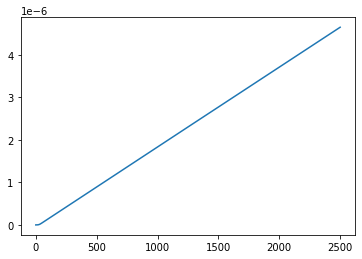

In [44]:
from matplotlib import pyplot as plt
from random import randint
s_output2400 = []
for h in range(total_step+1):
    s_output2400.append(s_output[2400][h][0])
time_list = list(range(total_step+1))
# グラフの描画
plt.plot(time_list, s_output2400)
plt.show()